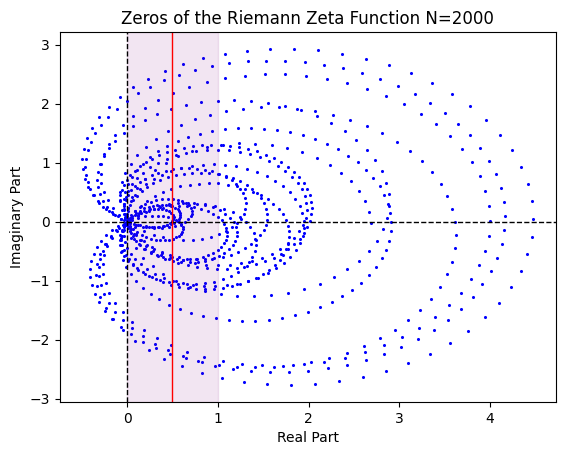

KeyboardInterrupt: ignored

In [ ]:
# Riemann
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from mpmath import *
import time
import os
import requests
from google.colab import drive
import imageio
import pandas as pd
from IPython.display import clear_output

# Mount Google Drive
drive.mount('/content/drive')

# Create a folder in the root directory
folder_path = "/content/drive/My Drive/Riemann-Zeta-Function"
os.makedirs(folder_path, exist_ok=True)

# Create a folder for the images
image_folder = "/content/drive/My Drive/Riemann-Zeta-Function/riemann_zeta_zeros_frames"
os.makedirs(image_folder, exist_ok=True)

# Filväg för bildramarna
image_file_path = os.path.join(image_folder, 'riemann_zeta_zeros_frame_latest.png')


# Läs in det senaste värdet för N om filen finns
file_path = os.path.join(folder_path, 'riemann_zeta_zeros_table.csv')

# Read the latest value from CSV-file as DataFrame with pandas
if os.path.exists(file_path) and os.path.getsize(file_path) > 0:
    # Läs in CSV-filen som en DataFrame med pandas
    df = pd.read_csv(file_path)

    # Hämta det senaste värdet av N
    N = df.shape[0]  # Antalet rader i DataFrame är det senaste värdet av N
else:
    df = pd.DataFrame(columns=['Real', 'Imaginary'])
    N = 0

# Set the number of continuous time steps
T = 100

# Calculate the time step size
if N == 0:
    N = 1

dt = 1.0 * T / N
tt = np.linspace(0.0, N * dt, N + 1000)

# Generate a time vector
t = np.linspace(0.0, N * dt, N + 1)

# Initialize the arrays to store the real and imaginary parts of the zeros
re_z = np.zeros(1000)
im_z = np.zeros(1000)


# Skapa en tom DataFrame för att spara real- och imaginärdelarna
columns = ['Real', 'Imaginary']
df = pd.DataFrame(columns=columns)

# Initialize the file to store the steps
# file = open(file_path, 'a')

# Initialize the animation figure and axes
fig, ax = plt.subplots(figsize=(10, 10), frameon=False)

# Set the axes limits
ax.set_xlim([-2, 6])
ax.set_ylim([-3, 3])

# Remove the upper and right axes
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')

# Set the tick labels size
ax.tick_params(labelsize=16)

# Add a text label
plt.gcf().text(0.6, 0.15, '', fontsize=22)

# Print a message to the console
print('Starting the animation...')

# Skapa den första tomma bilden
plt.savefig(image_file_path)

# Start the animation loop
while True:

    # Clear the previous plot
    plt.clf()

    # Calculate the Riemann zeta function at each point in the time vector
    for i in range(N, min(N + 1000, len(tt))):

        # Create a copy of the z variable
        new_z = zeta(0.5 + tt[i] * j)

        # Append the real and imaginary parts of z to the re_z and im_z lists
        re_z[i % 1000] = float(new_z.real)
        im_z[i % 1000] = float(new_z.imag)

        # Uppdatera variabeln N
        N += 1

        # # Break the loop if we have reached the number choosen
        # if N >= 1000:
        #   break

    # Spara animeringsramen innan du ritar på figuren
        # filename = 'riemann_zeta_zeros_frame_latest.png'
        # file_path = os.path.join(image_folder, filename)
    plt.savefig(image_file_path)

    # Lägg till nya värden i DataFrame
    df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))

        # # Write the values to the file
        # with open(file_path, 'a') as file:
        #   # for i in range(len(re_z)):
        #     file.write('{}, {}\n'.format(re_z[i % 1000], im_z[i % 1000]))

    # Plot the zeros with smaller blue dots
    plt.scatter(re_z, im_z, c='blue', marker='o', label='Zeros', s=1.5)

    # # Markera punkter som ligger på linjen s = 1/2 + t * i
    # t_value = 2 * tt[i] - 1
    # if np.isclose(t_value, int(t_value)):
    #     riemann_points.append((re_z[i % 1000], im_z[i % 1000]))  # Lägg till punkten i listan

    plt.xlabel('Real Part')
    plt.ylabel('Imaginary Part')
    plt.title(f'Zeros of the Riemann Zeta Function N={N}')

    # Add a horizontal line at x=0
    plt.axhline(y=0.0, color='black', linewidth=1, linestyle='--')

    # Add a vertical line at y=0
    plt.axvline(x=0.0, color='black', linewidth=1, linestyle='--')

    # Lägg till en lila markering för critical strip (mellan y=0 och y=1)
    plt.axvspan(1, 0, alpha=0.1, color='purple', label='Critical Strip')

    # Lägg till en röd linje för critical line (y=0.5)
    plt.axvline(x=0.5, color='red', linewidth=1, linestyle='-', label='Critical Line')

    # # Add red points where z hits the x-axis
    # for i in range(len(re_z)):
    #     if z.imag == 0.0:
    #         plt.scatter(re_z[i], im_z[i], color='red')

    # Sleep for a short interval
    time.sleep(0.01)

    clear_output(wait=True)
    plt.show()

    # Spara DataFrame till CSV-filen
    df.to_csv(file_path, index=False)

    # # Spara animeringsramen
    # plt.savefig(image_file_path)

    # # Skriv DataFrame till CSV-filen
    # if N > df.shape[0]:
    #   # df.to_csv(file_path, index=False)
    #   df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))

    # # Save the animation frame
    # filename = 'riemann_zeta_zeros_frame_latest.png'
    # file_path = os.path.join(image_folder, filename)
    # plt.savefig(file_path)

    # # Ladda in den senaste bilden när du fortsätter
    # try:
    #     image = imageio.imread(image_file_path)
    #     plt.imshow(image)
    # except FileNotFoundError:
    #     pass  # Filen finns inte, fortsätt utan att ladda in någon bild



    # # Ladda in den senaste bilden när du fortsätter
    # latest_frame = 'riemann_zeta_zeros_frame_latest.png'
    # file_path = os.path.join(image_folder, latest_frame)

    # # Kontrollera om filen finns innan du försöker ladda den
    # if os.path.exists(file_path):
    #   image = imageio.imread(file_path)
    #   plt.imshow(image)
    # else:
    #   print(f"File not found: {file_path}")


file.close()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Starting the animation...


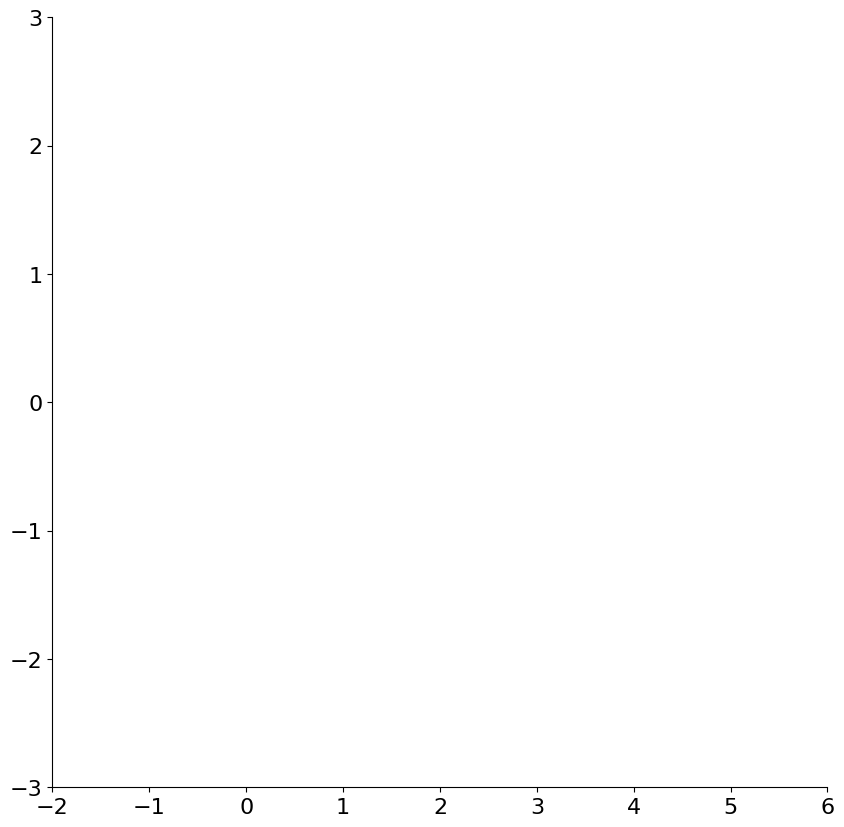

<Figure size 640x480 with 0 Axes>

/usr/local/lib/python3.10/dist-packages/matplotlib/animation.py:884: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from mpmath import *
import time
import os
from google.colab import drive
import imageio
import pandas as pd
from IPython.display import clear_output

# Mount Google Drive
drive.mount('/content/drive')

# Skapa en mapp i rotkatalogen
folder_path = "/content/drive/My Drive/Riemann-Zeta-Function"
os.makedirs(folder_path, exist_ok=True)

# Skapa en mapp för bilderna
image_folder = "/content/drive/My Drive/Riemann-Zeta-Function/riemann_zeta_zeros_frames"
os.makedirs(image_folder, exist_ok=True)

# Filväg för bildramarna
image_file_path = os.path.join(image_folder, 'riemann_zeta_zeros_frame_latest.png')

# Läs in det senaste värdet för N om filen finns
file_path = os.path.join(folder_path, 'riemann_zeta_zeros_table.csv')

# Läs in det senaste värdet från CSV-filen som en DataFrame med pandas
if os.path.exists(file_path) and os.path.getsize(file_path) > 0:
    # Läs in CSV-filen som en DataFrame med pandas
    df = pd.read_csv(file_path)

    # Hämta det senaste värdet av N
    N = df.shape[0]  # Antalet rader i DataFrame är det senaste värdet av N
else:
    df = pd.DataFrame(columns=['Real', 'Imaginary'])
    N = 0

# Skapa en tom DataFrame för att spara real- och imaginärdelarna
columns = ['Real', 'Imaginary']
df = pd.DataFrame(columns=columns)

# Set the number of continuous time steps
T = 100

# Calculate the time step size
if N == 0:
    N = 1

dt = 1.0 * T / N
tt = np.linspace(0.0, N * dt, N + 1000)

# Generate a time vector
t = np.linspace(0.0, N * dt, N + 1)

# Initialize the arrays to store the real and imaginary parts of the zeros
re_z = np.zeros(1000)
im_z = np.zeros(1000)

# Initialize the animation figure and axes
fig, ax = plt.subplots(figsize=(10, 10), frameon=False)

# Set the axes limits
ax.set_xlim([-2, 6])
ax.set_ylim([-3, 3])

# Remove the upper and right axes
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')

# Set the tick labels size
ax.tick_params(labelsize=16)

# Add a text label
plt.gcf().text(0.6, 0.15, '', fontsize=22)

# Print a message to the console
print('Starting the animation...')

# Skapa den första tomma bilden
plt.savefig(image_file_path)

# Definiera funktionen som uppdaterar figuren i varje steg
def update(frame):
    global N, df, re_z, im_z

    # Clear the previous plot
    plt.clf()

    # Calculate the Riemann zeta function at each point in the time vector
    for i in range(N, min(N + 1000, len(tt))):
        # Create a copy of the z variable
        new_z = zeta(0.5 + tt[i] * j)

        # Append the real and imaginary parts of z to the re_z and im_z lists
        re_z[i % 1000] = float(new_z.real)
        im_z[i % 1000] = float(new_z.imag)

        # Uppdatera variabeln N
        N += 1

    # Lägg till nya värden i DataFrame
    df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))

    # Plot the zeros with smaller blue dots
    plt.scatter(re_z, im_z, c='blue', marker='o', label='Zeros', s=1.5)

    # # Markera punkter som ligger på linjen s = 1/2 + t * i
    # t_value = 2 * tt[i] - 1
    # if np.isclose(t_value, int(t_value)):
    #     riemann_points.append((re_z[i % 1000], im_z[i % 1000]))  # Lägg till punkten i listan

    plt.xlabel('Real Part')
    plt.ylabel('Imaginary Part')
    plt.title(f'Zeros of the Riemann Zeta Function N={N}')

    # Add a horizontal line at x=0
    plt.axhline(y=0.0, color='black', linewidth=1, linestyle='--')

    # Add a vertical line at y=0
    plt.axvline(x=0.0, color='black', linewidth=1, linestyle='--')

    # Lägg till en lila markering för critical strip (mellan y=0 och y=1)
    plt.axvspan(1, 0, alpha=0.1, color='purple', label='Critical Strip')

    # Lägg till en röd linje för critical line (y=0.5)
    plt.axvline(x=0.5, color='red', linewidth=1, linestyle='-', label='Critical Line')

# Skapa en animation med FuncAnimation
ani = animation.FuncAnimation(fig, update, frames=100, interval=100)

# Visa animationen
plt.show()

# Spara den sista bilden
plt.savefig(image_file_path)

# Spara DataFrame till CSV-filen
df.to_csv(file_path, index=False)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Starting the animation...


<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


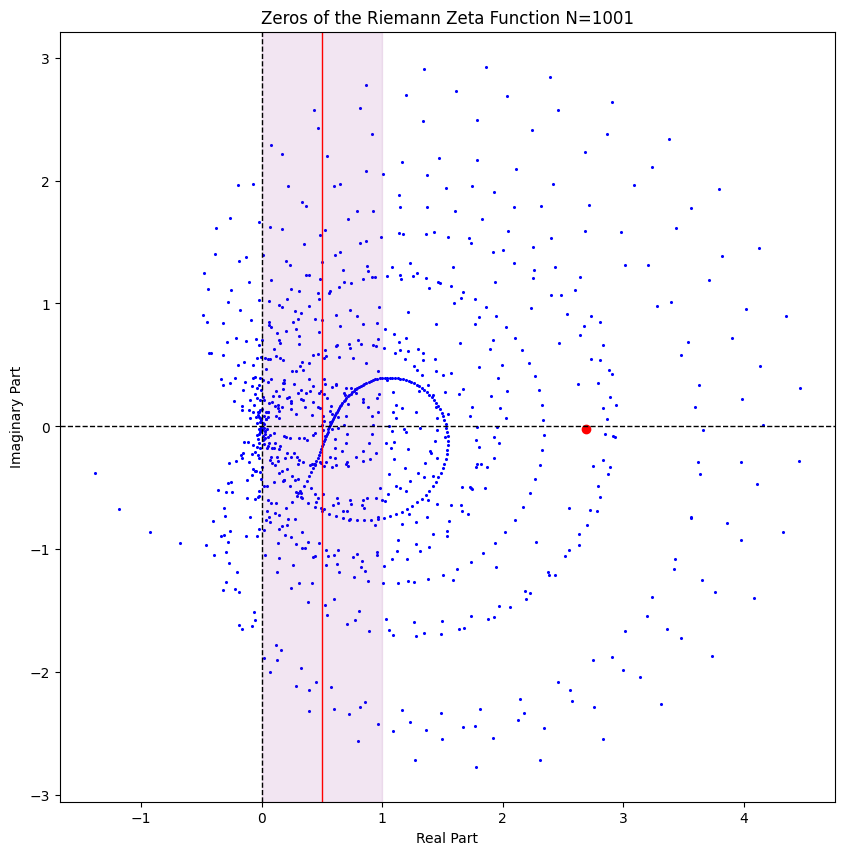

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


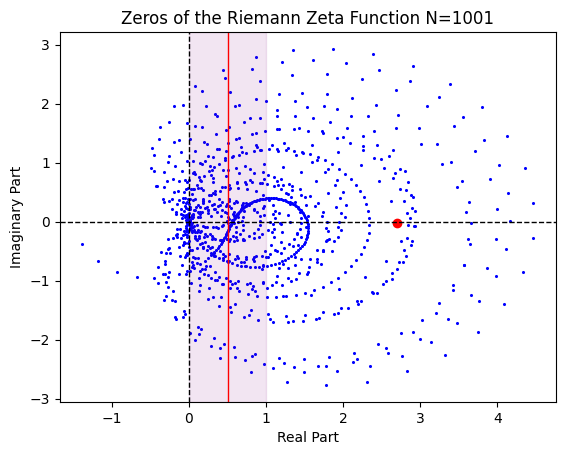

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


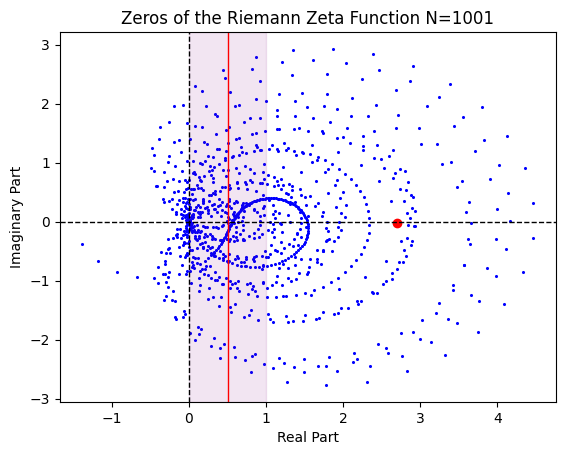

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


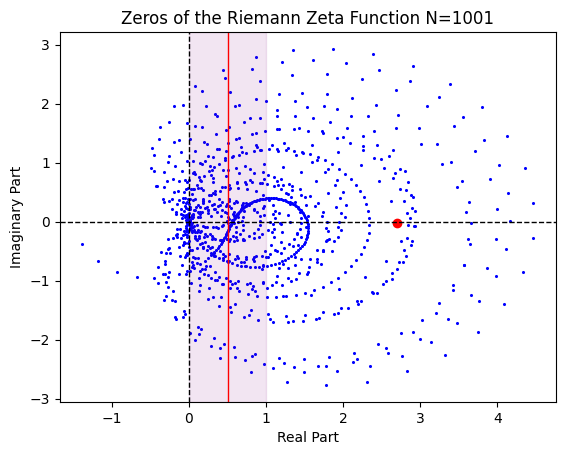

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


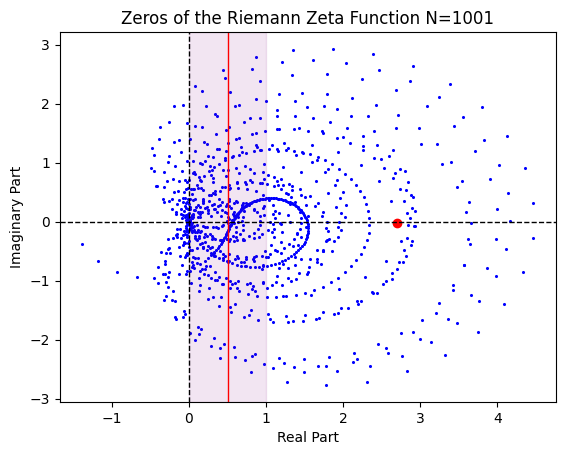

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


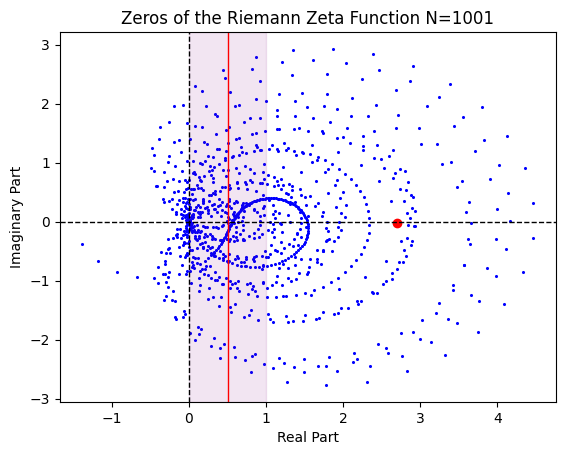

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


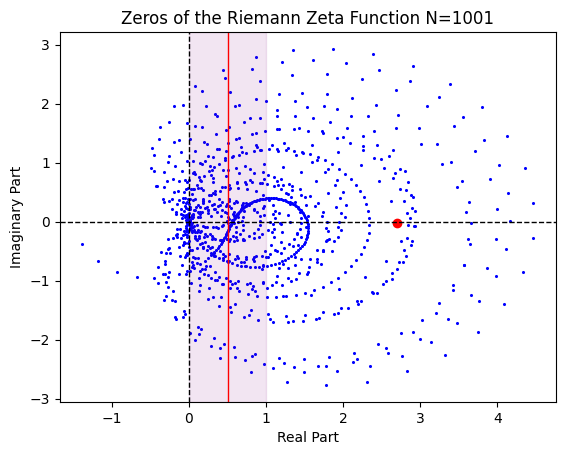

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


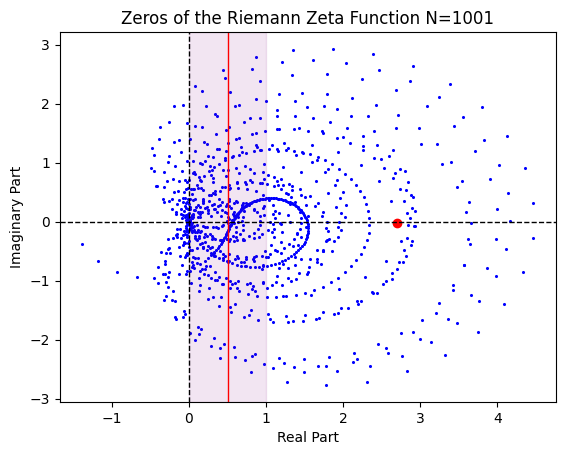

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


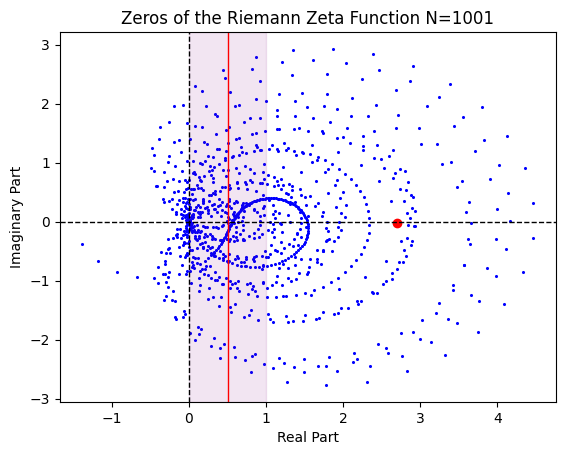

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


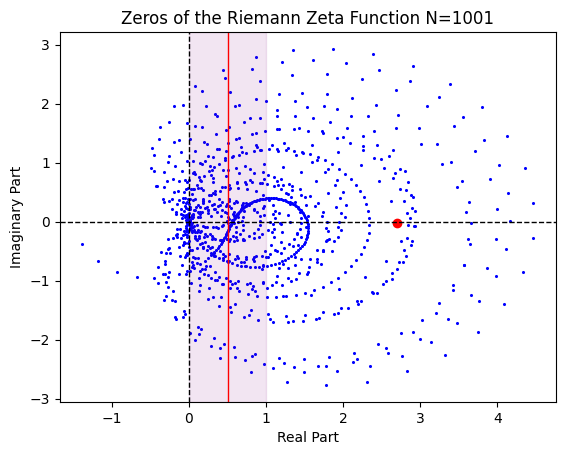

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


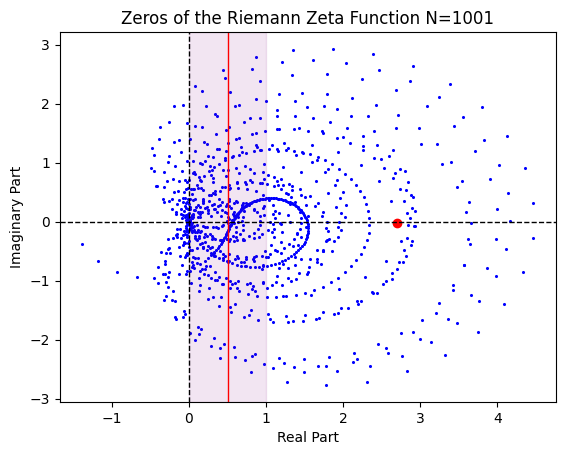

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


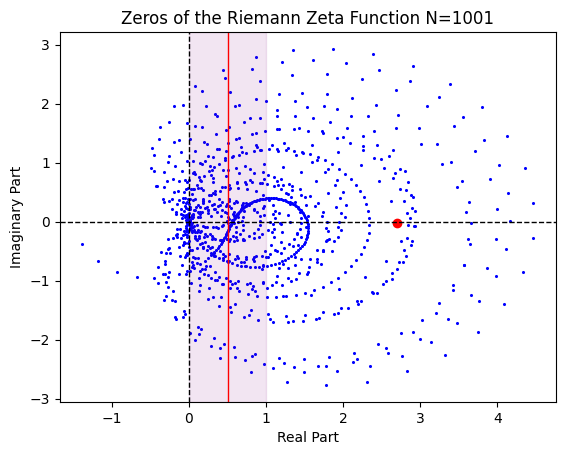

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


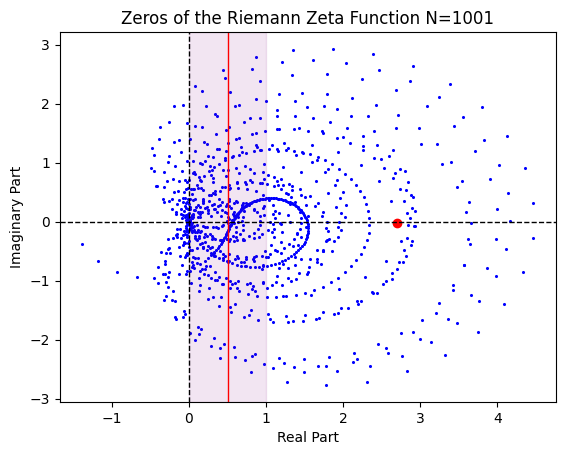

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


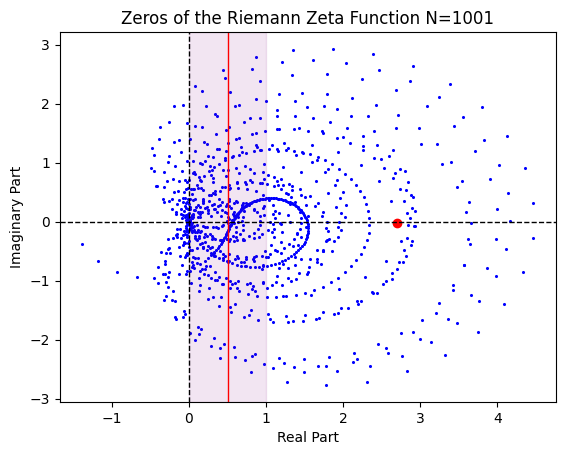

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


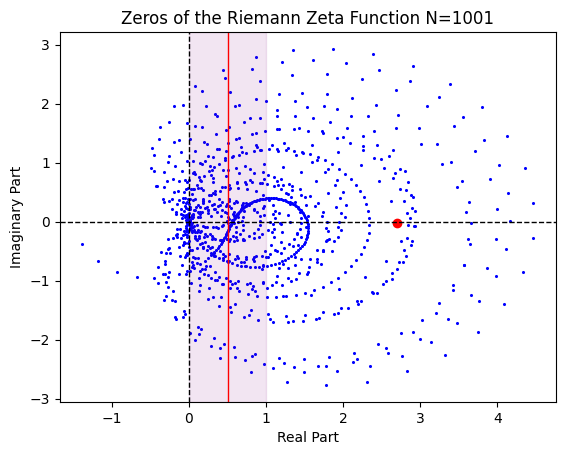

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


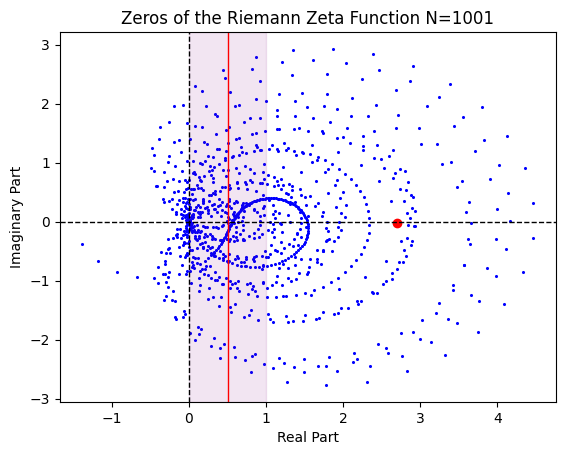

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


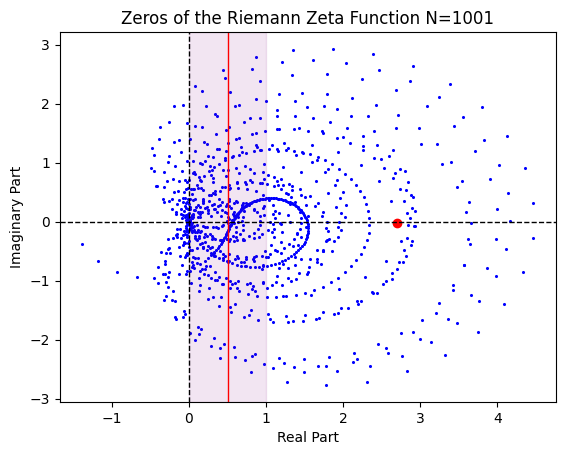

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


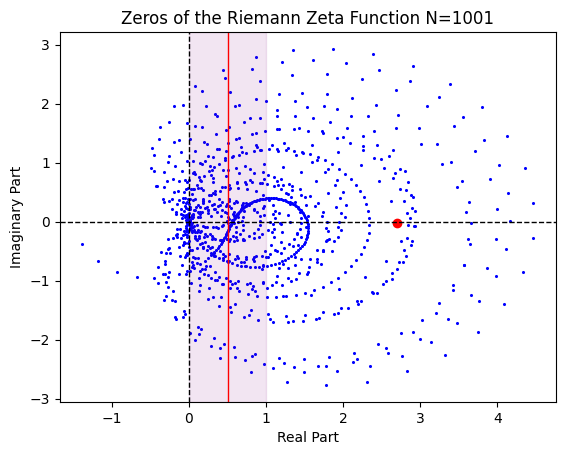

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


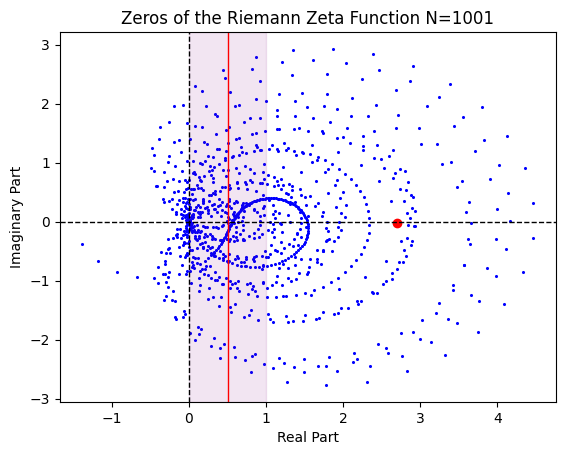

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


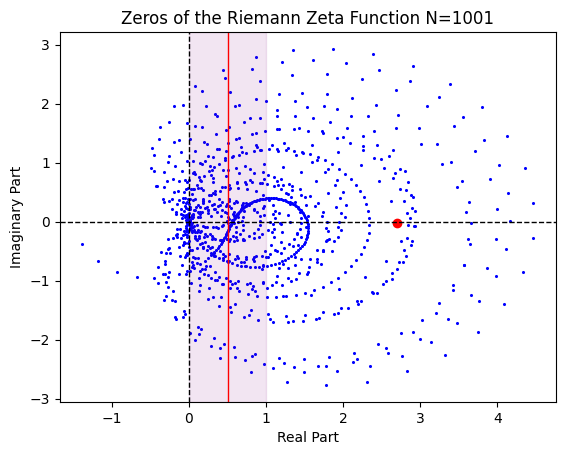

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


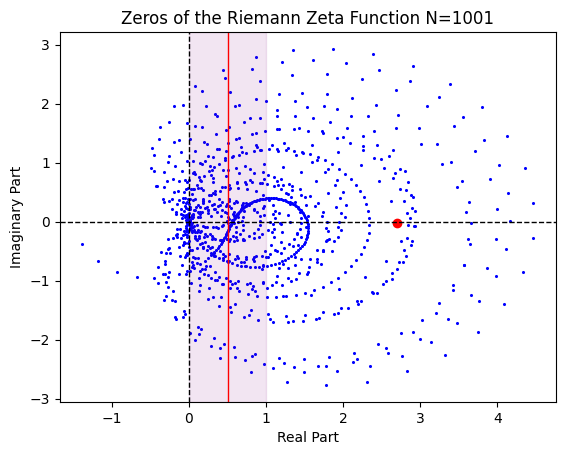

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


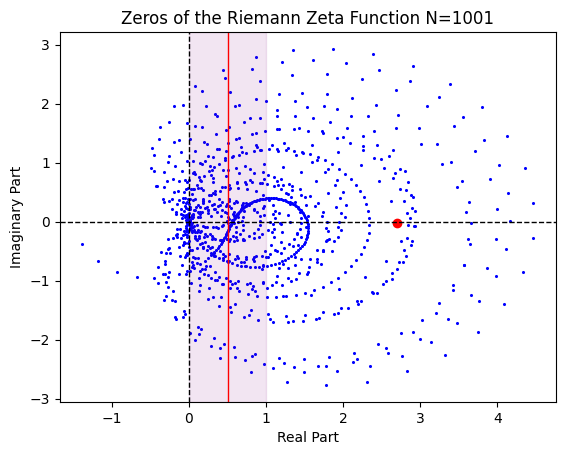

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


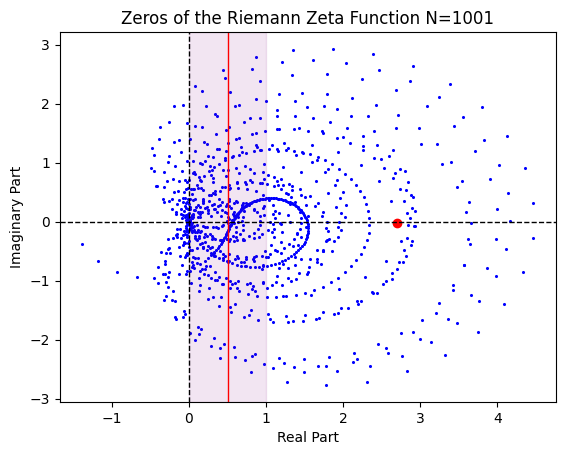

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


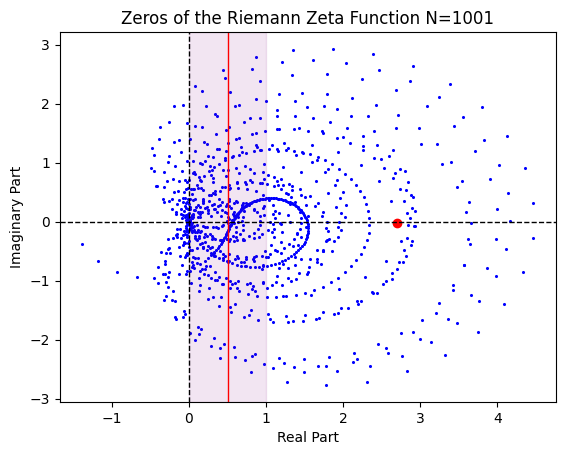

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


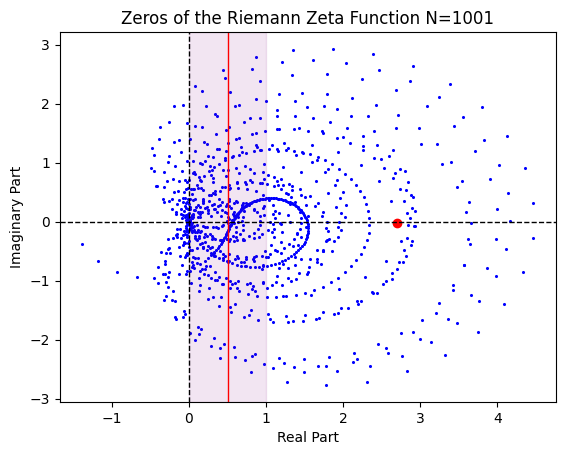

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


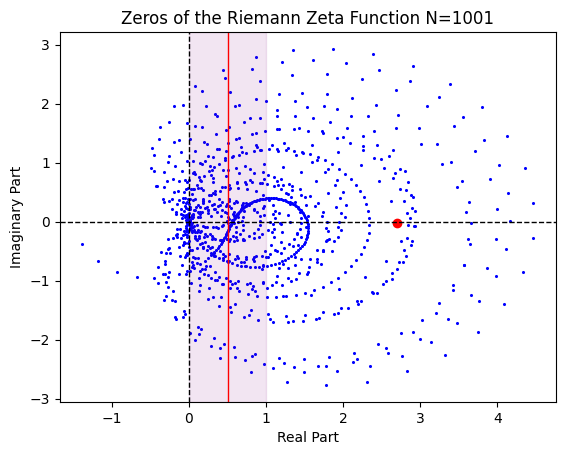

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


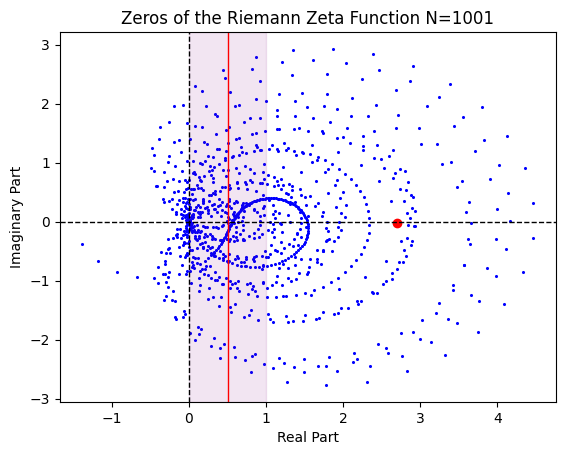

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


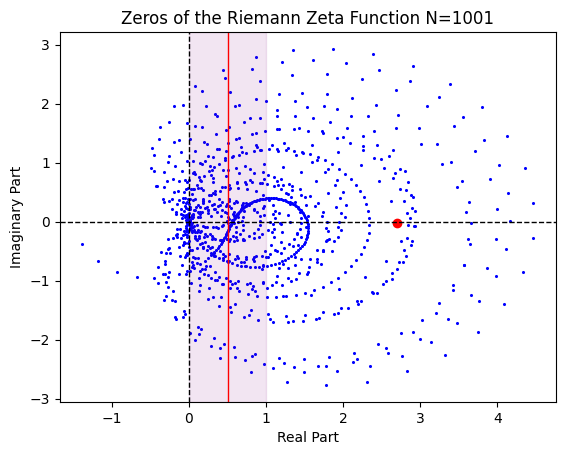

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


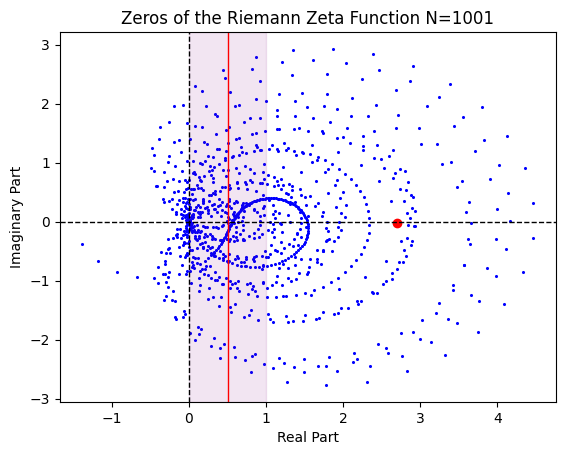

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


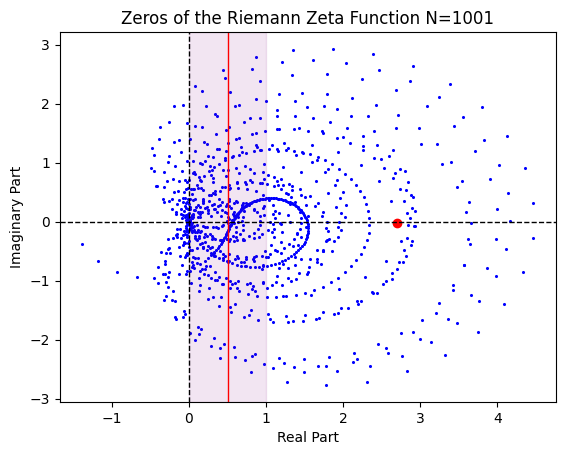

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


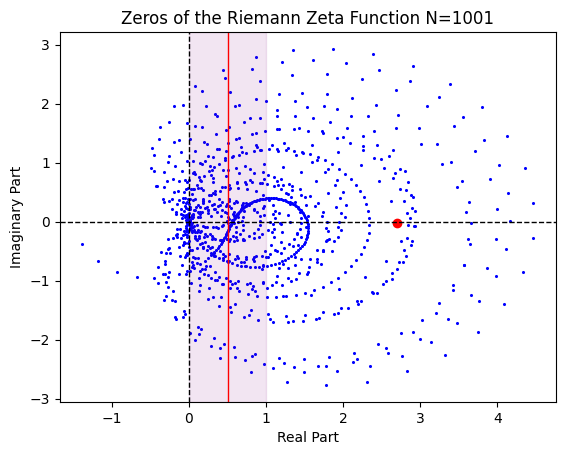

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


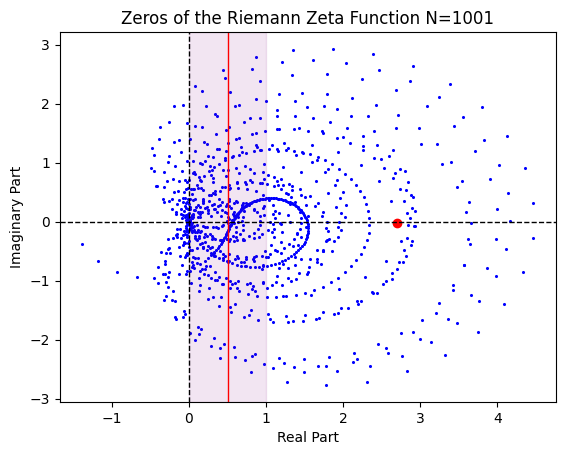

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


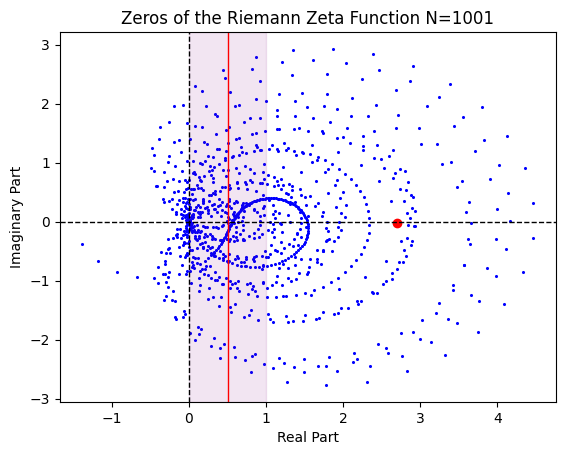

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


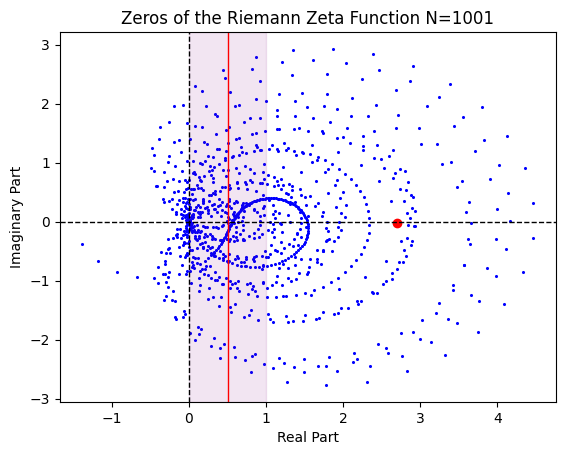

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


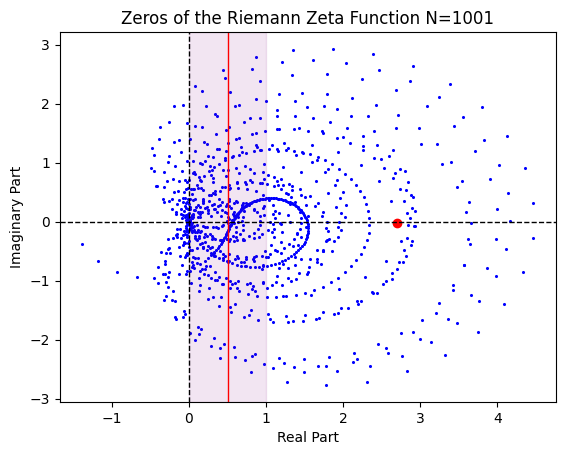

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


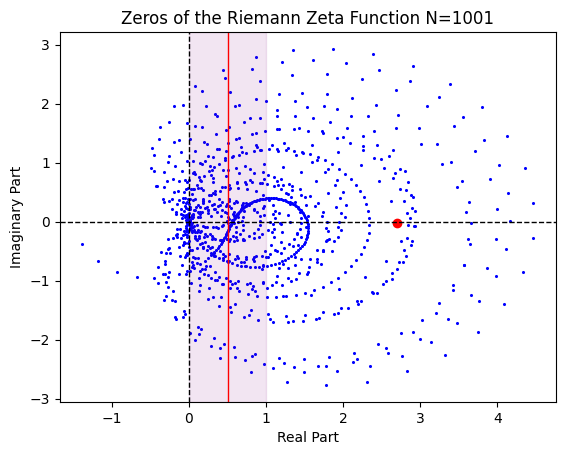

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


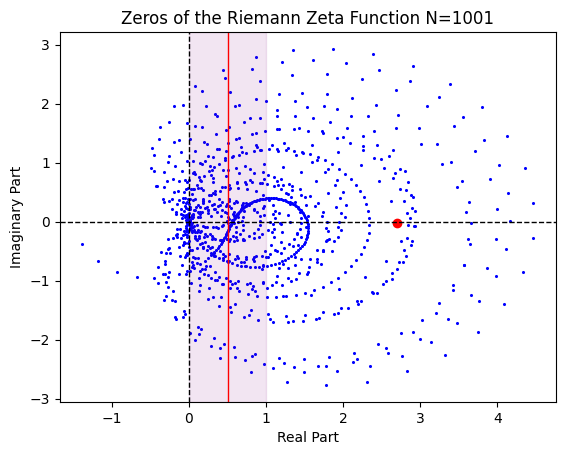

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


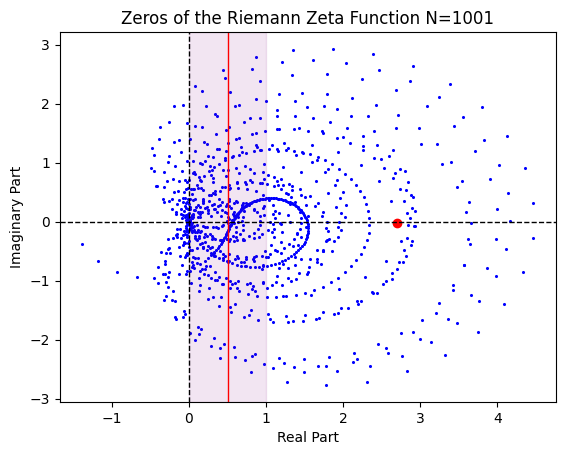

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


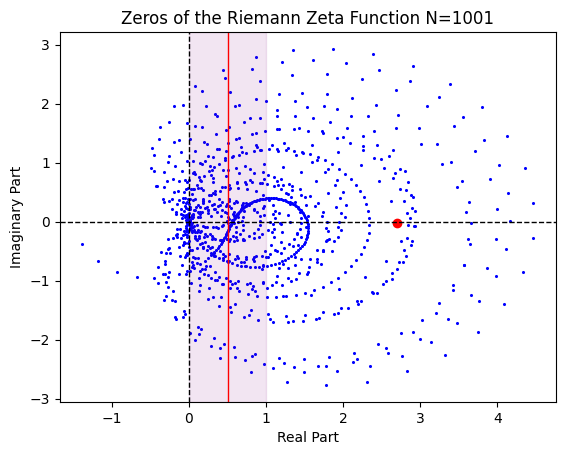

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


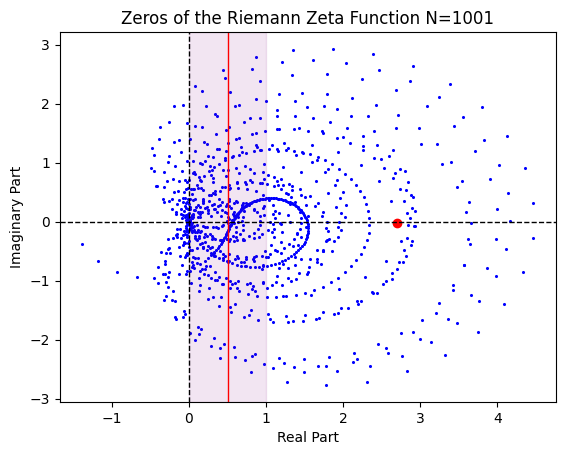

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


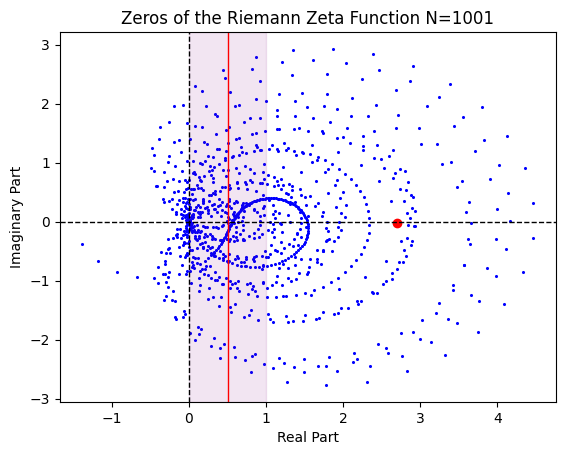

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


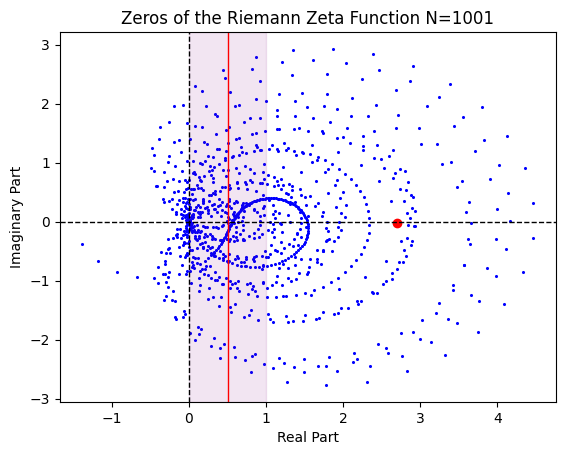

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


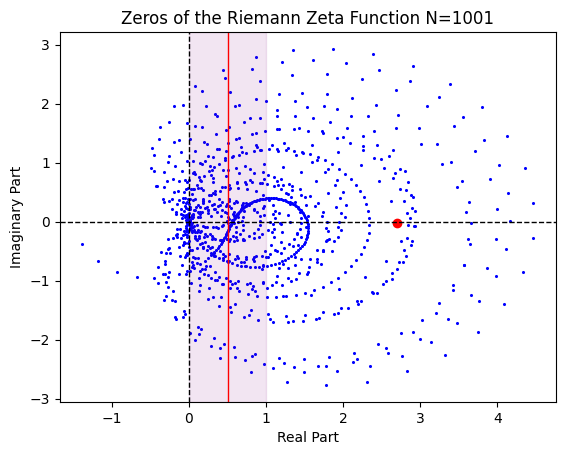

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


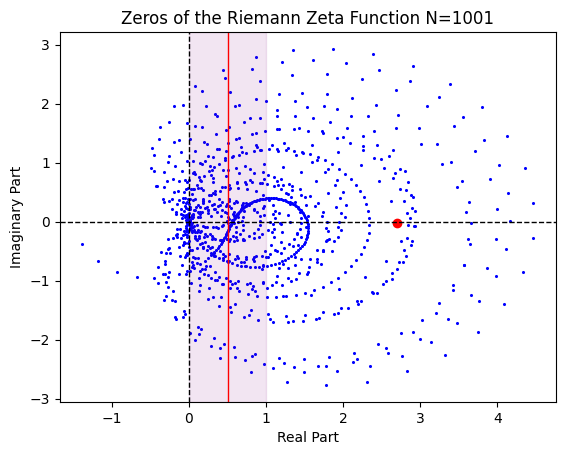

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


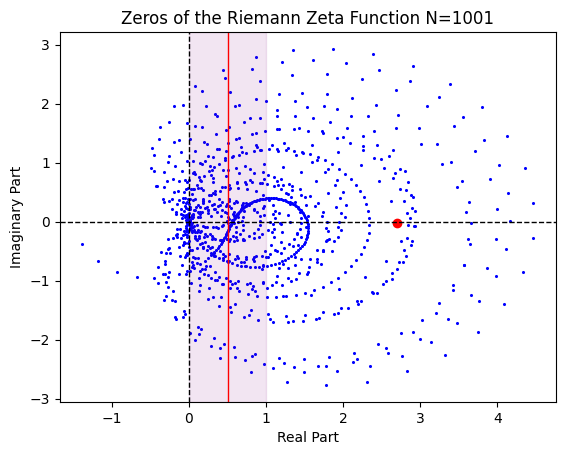

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


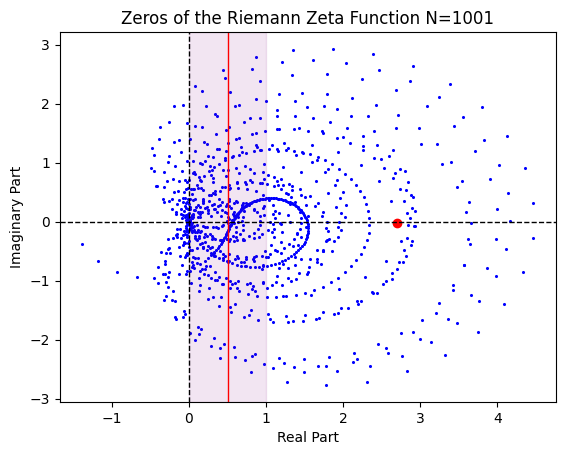

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


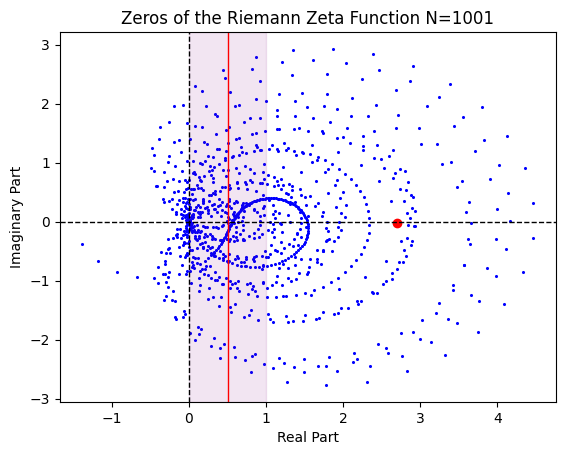

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


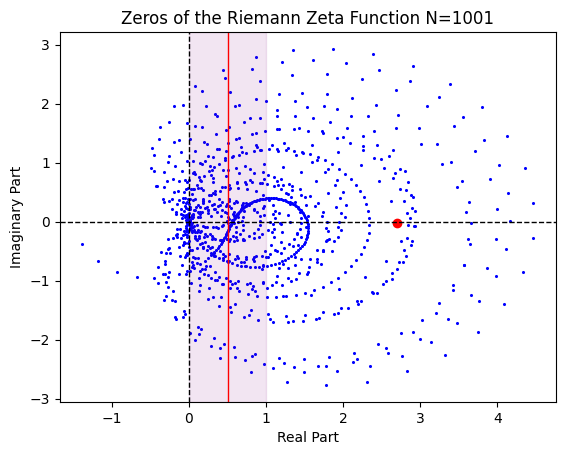

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


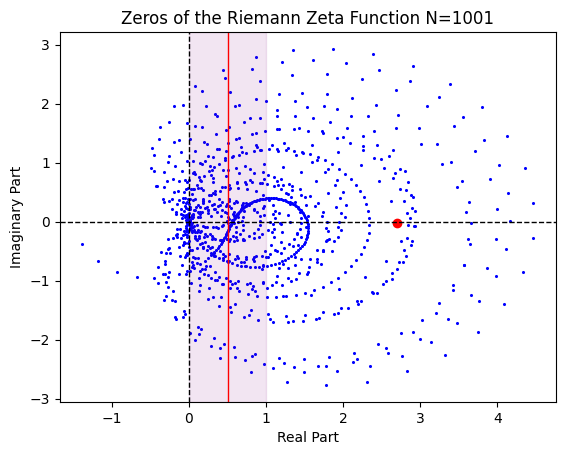

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


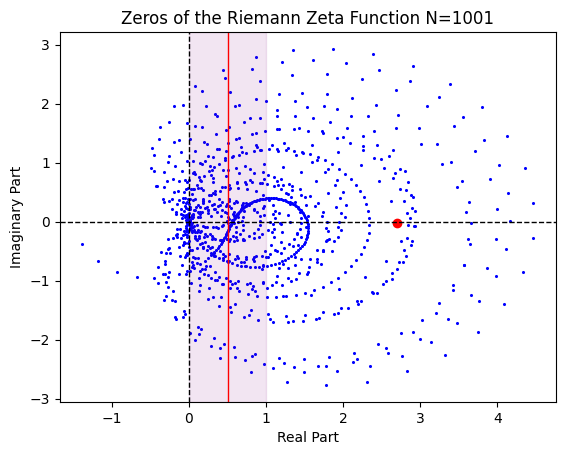

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


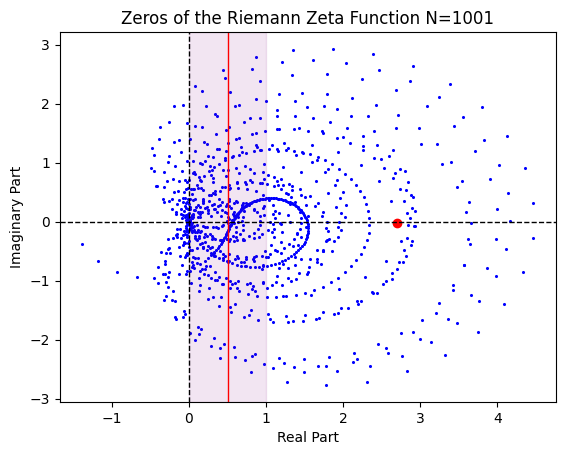

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


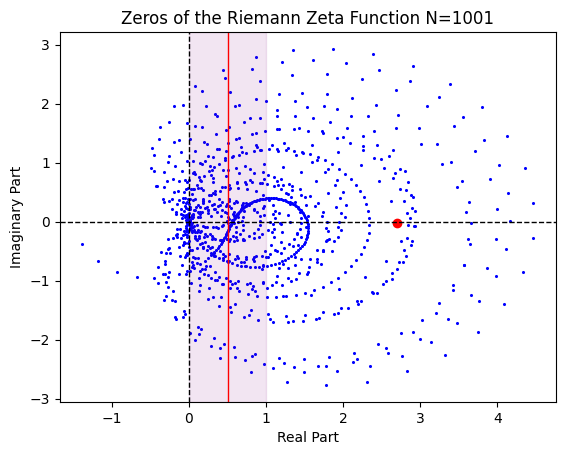

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


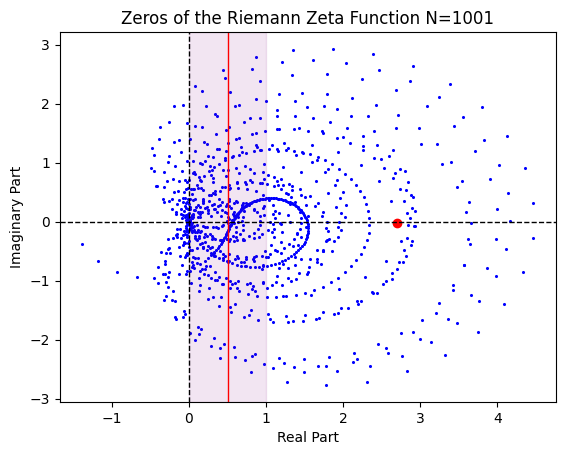

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


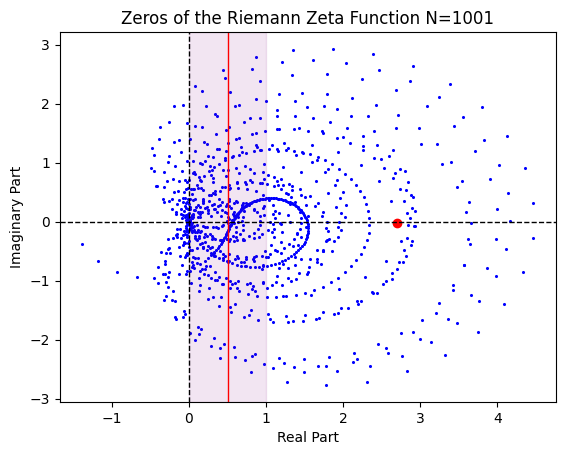

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


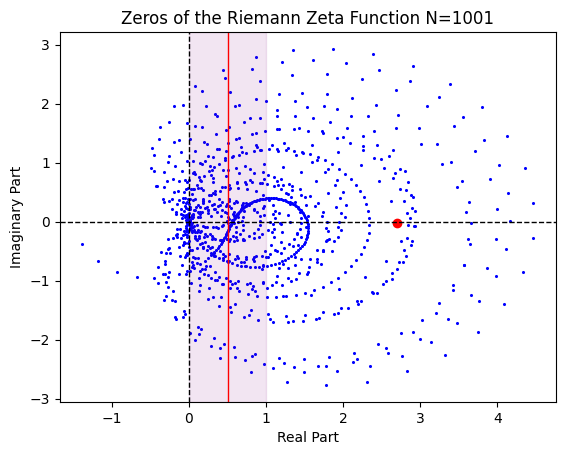

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


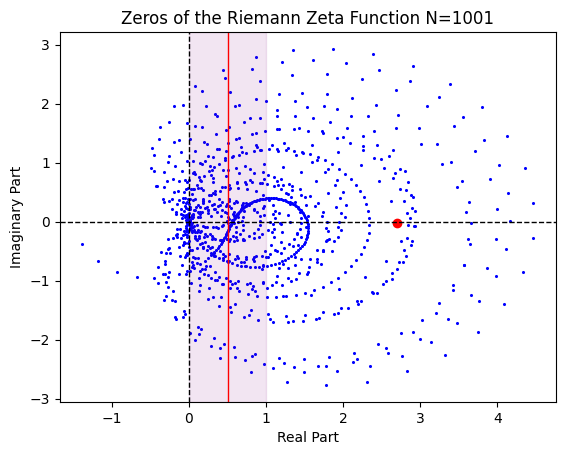

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


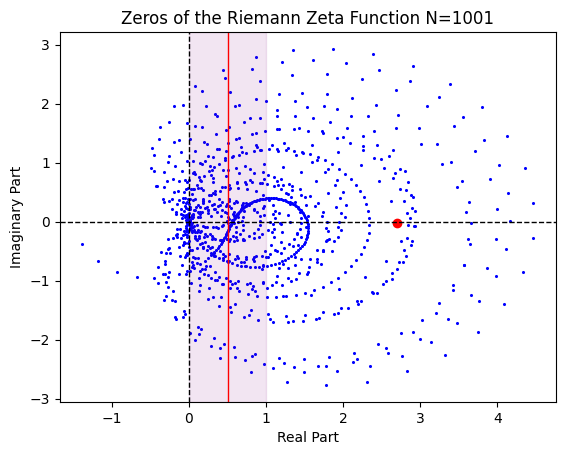

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


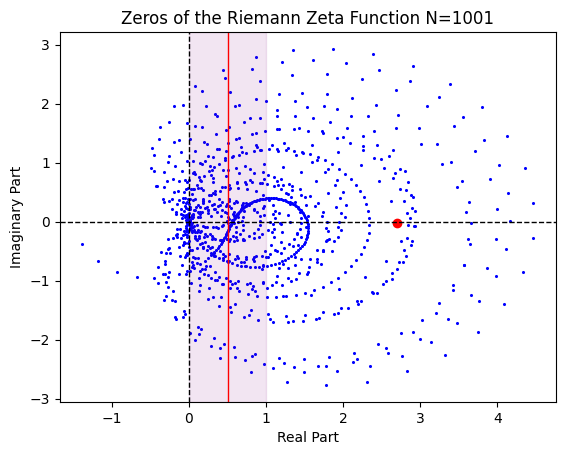

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


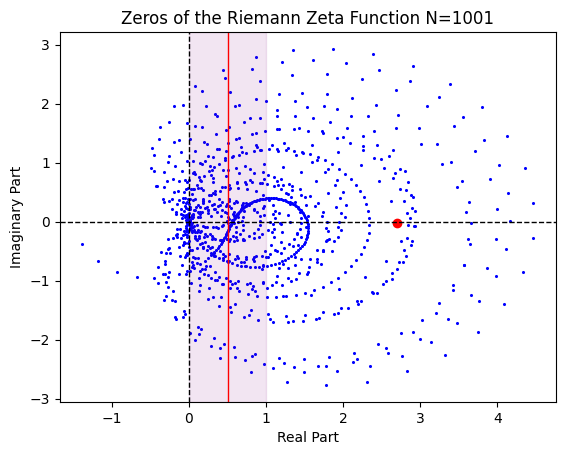

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


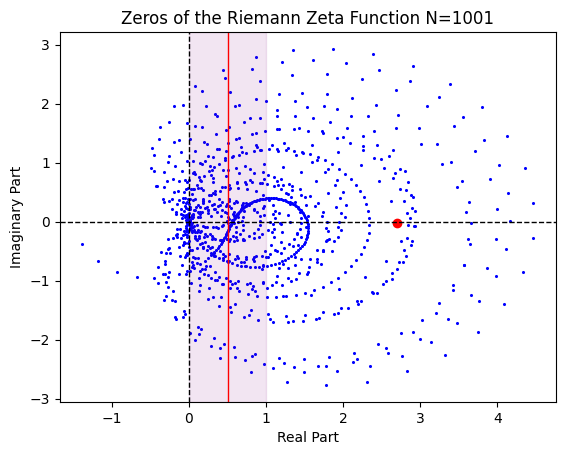

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


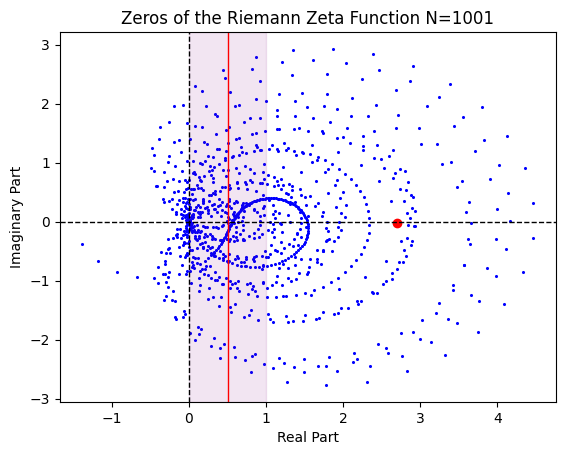

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


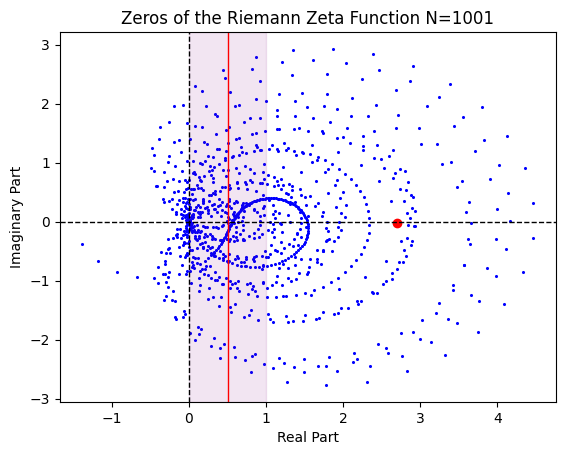

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


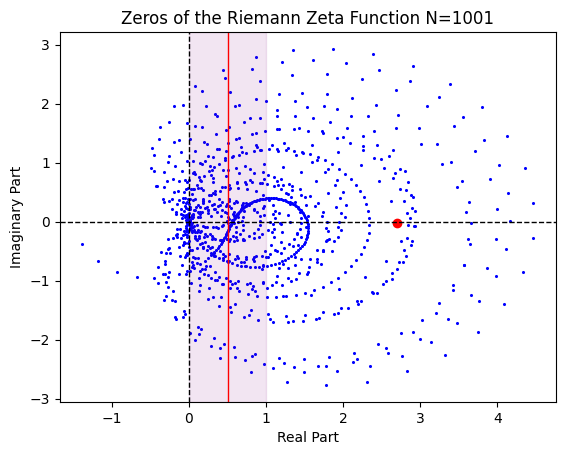

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


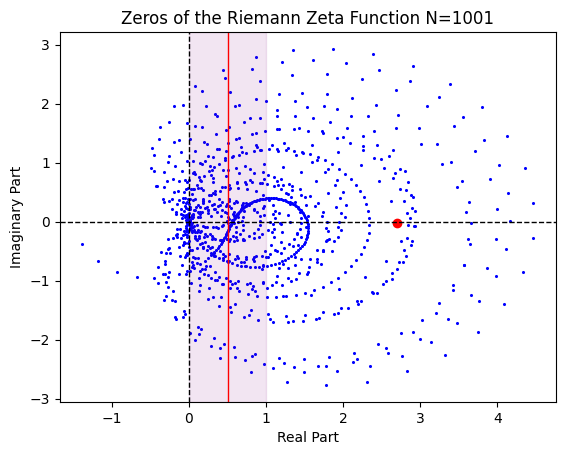

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


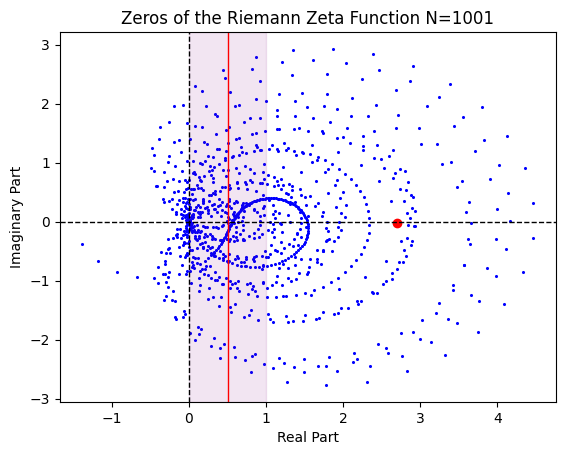

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


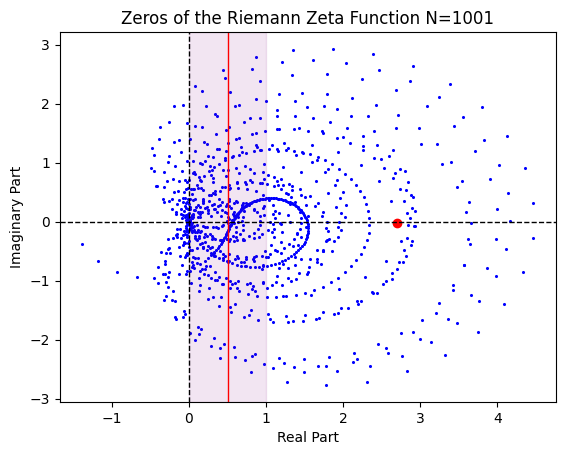

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


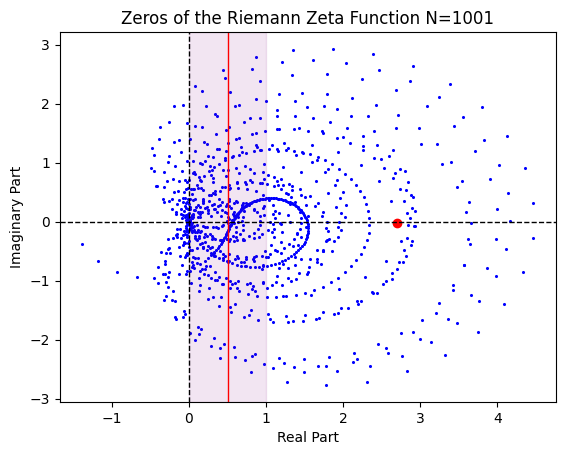

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


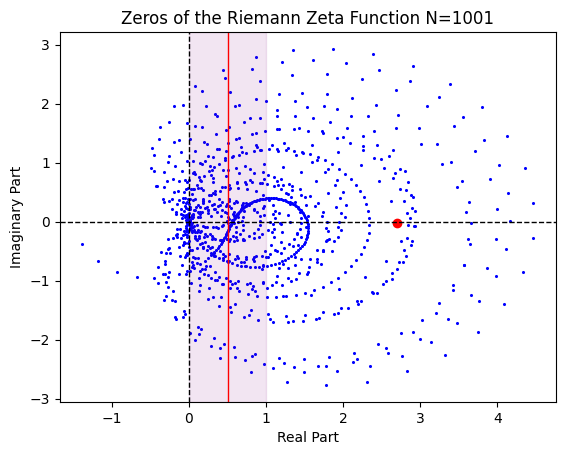

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


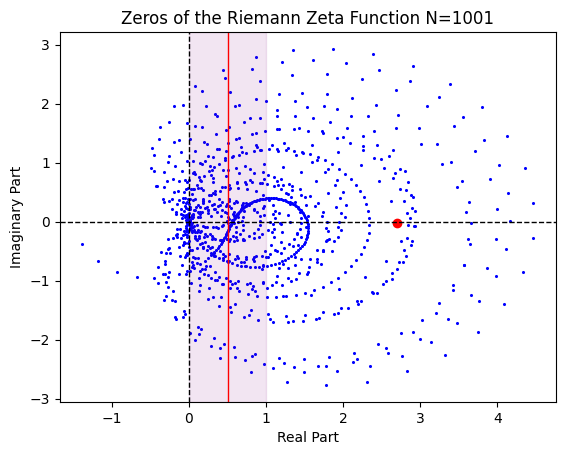

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


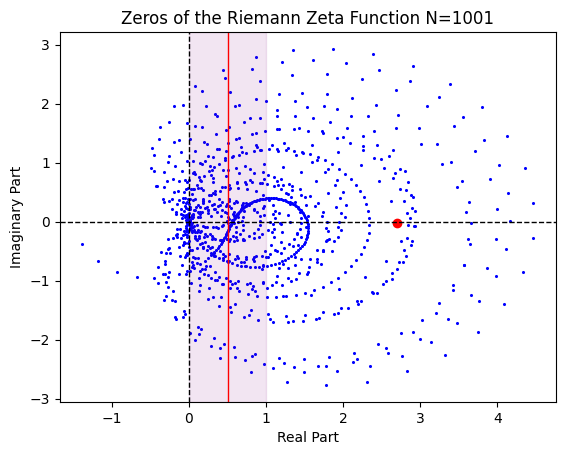

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


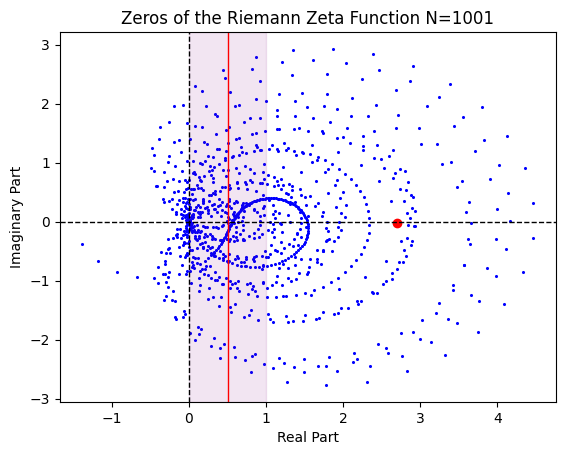

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


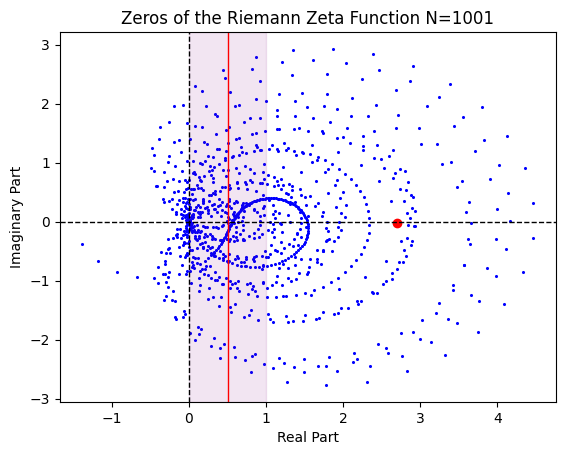

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


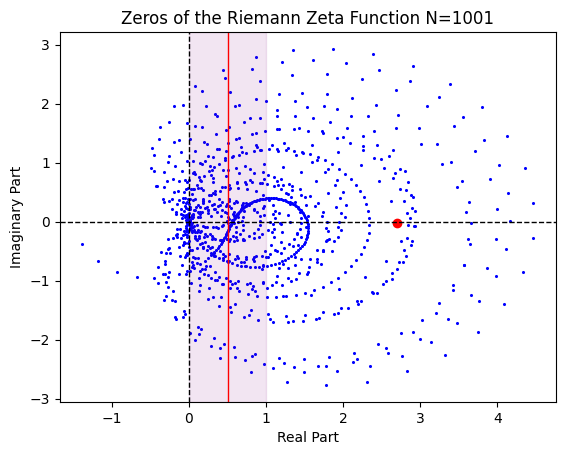

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


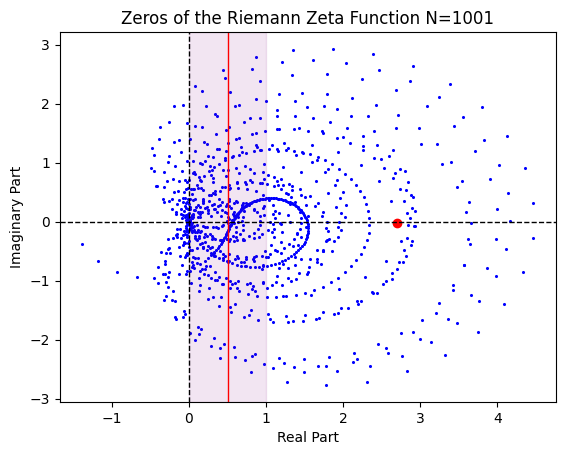

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


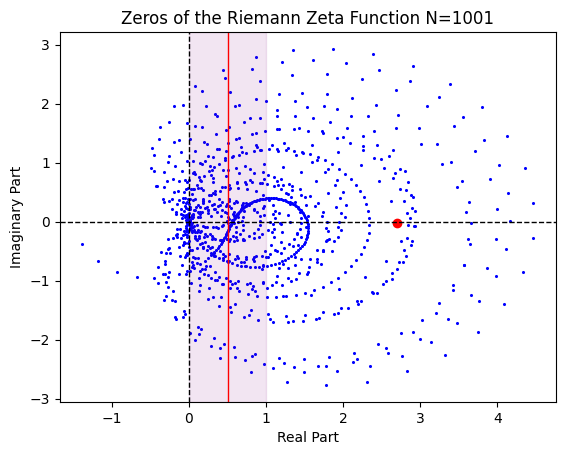

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


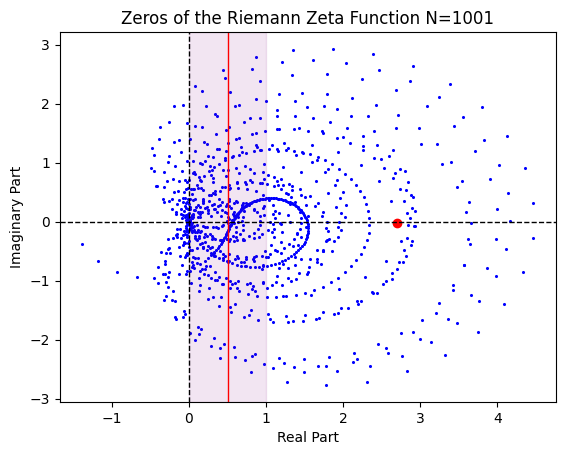

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


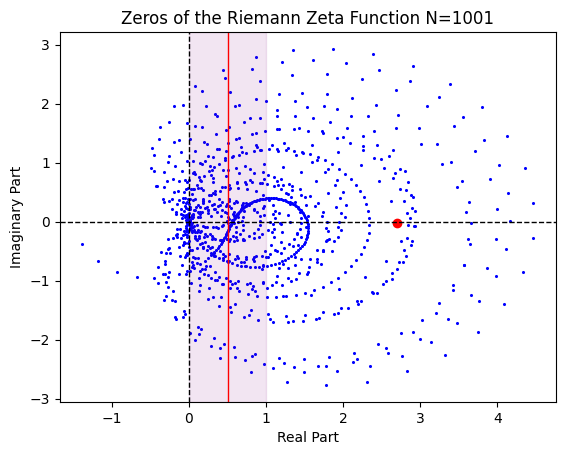

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


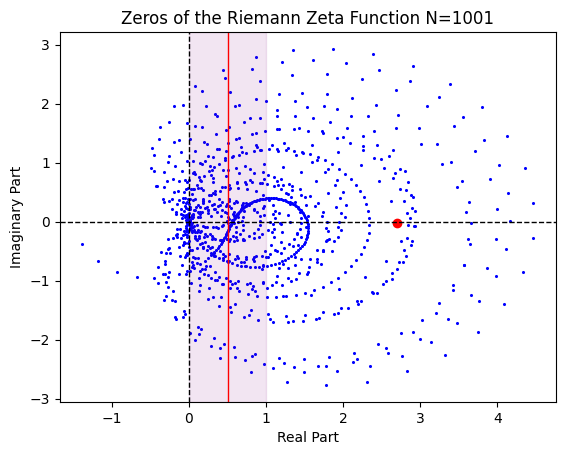

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


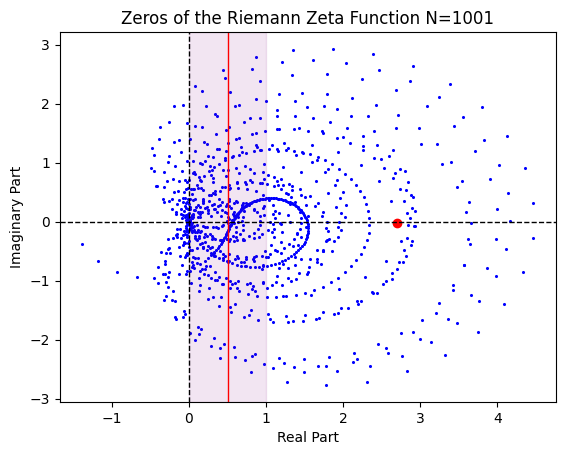

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


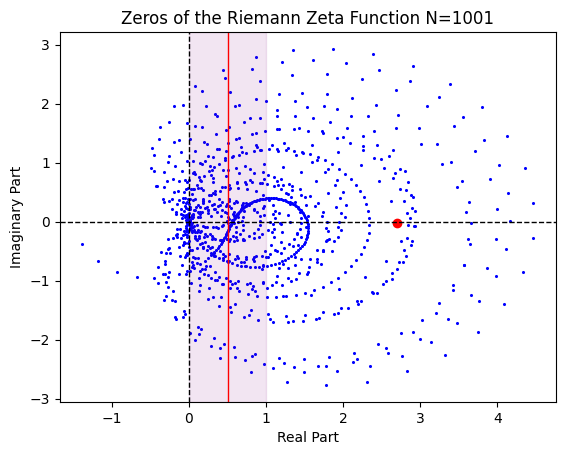

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


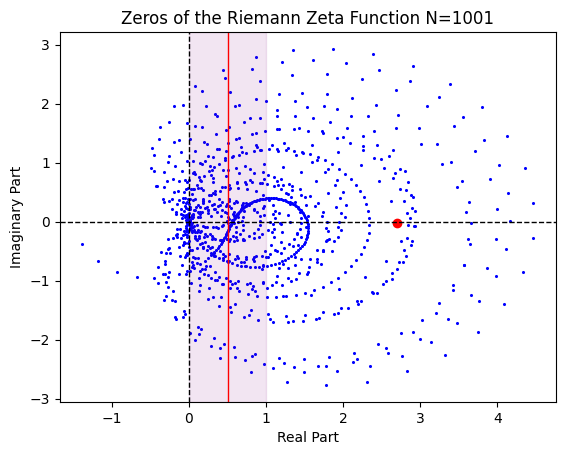

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


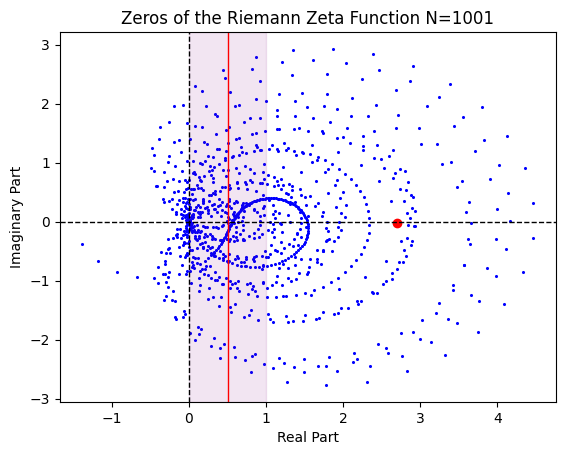

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


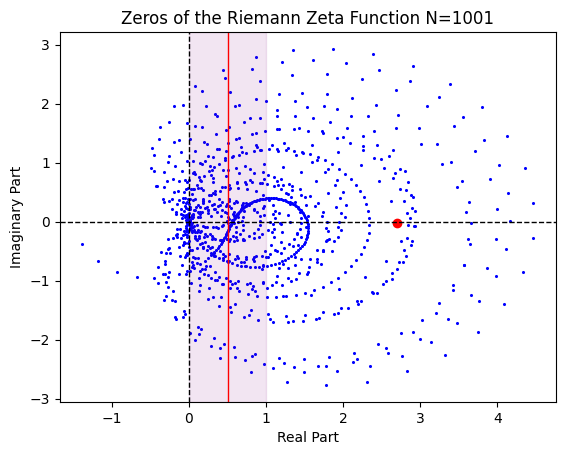

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


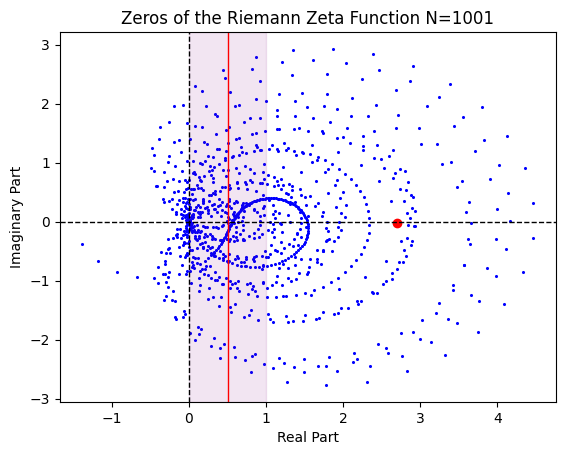

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


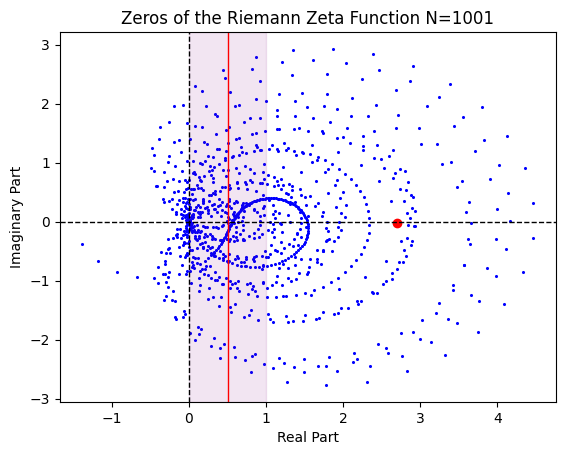

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


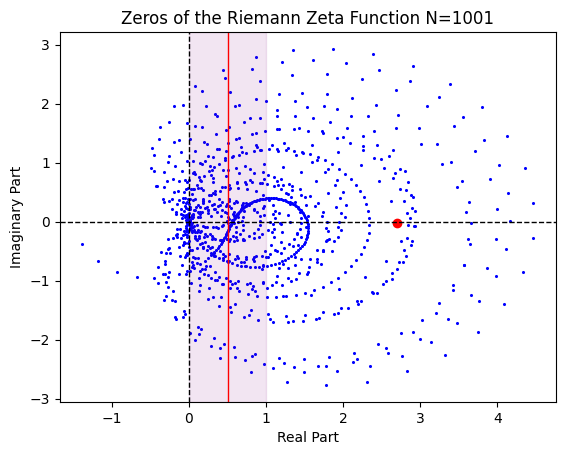

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


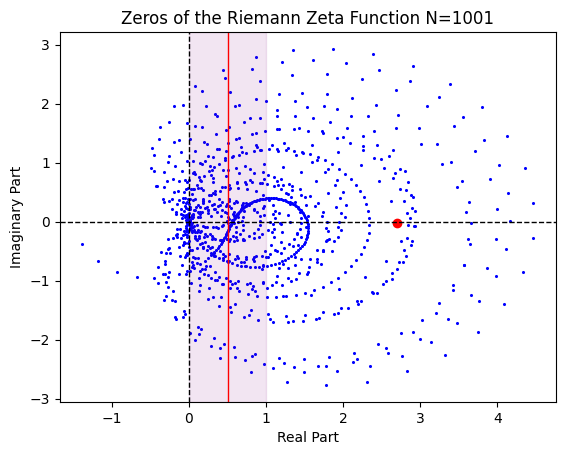

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


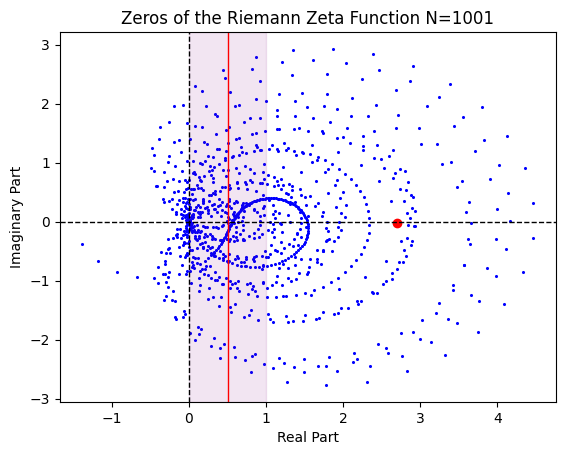

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


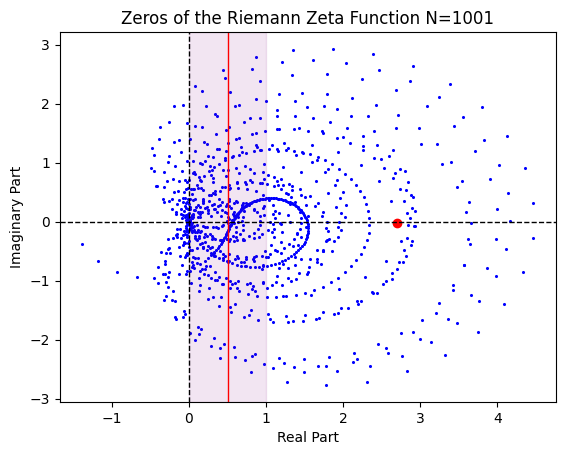

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


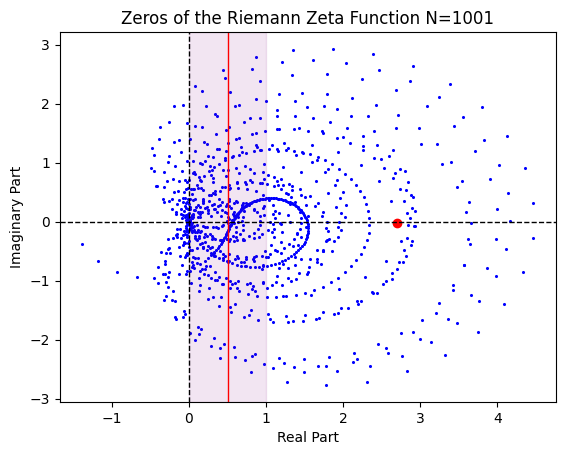

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


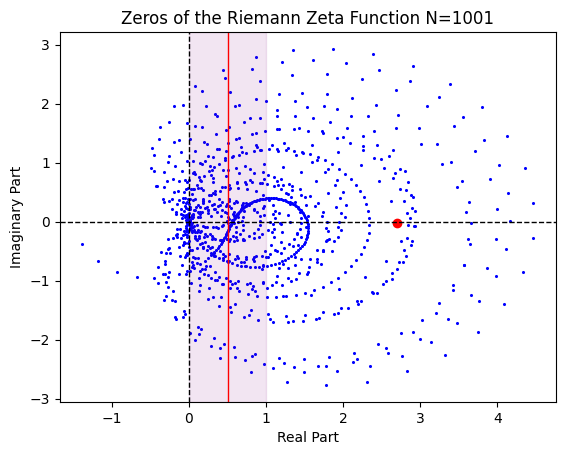

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


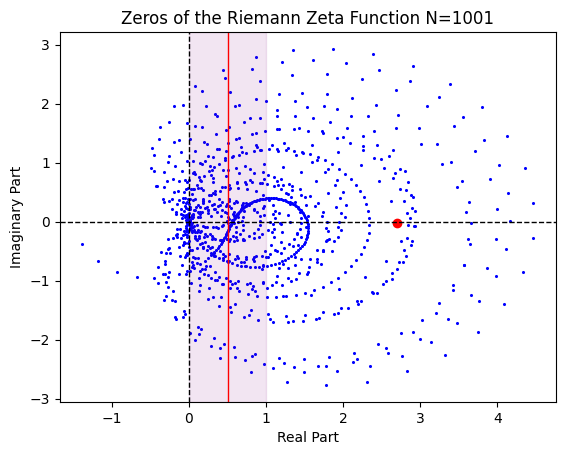

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


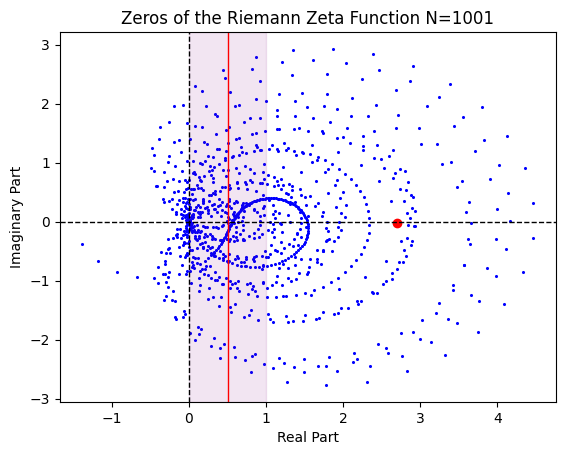

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


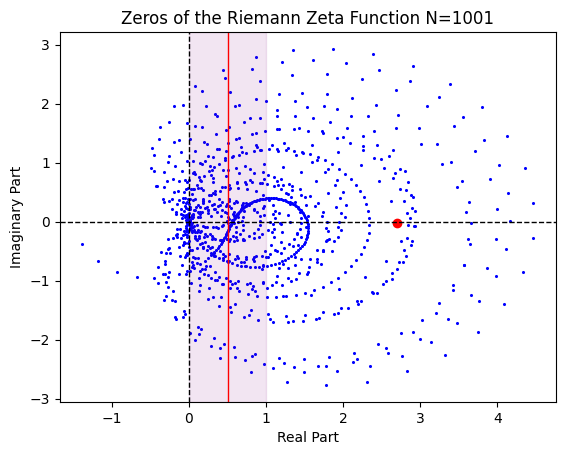

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


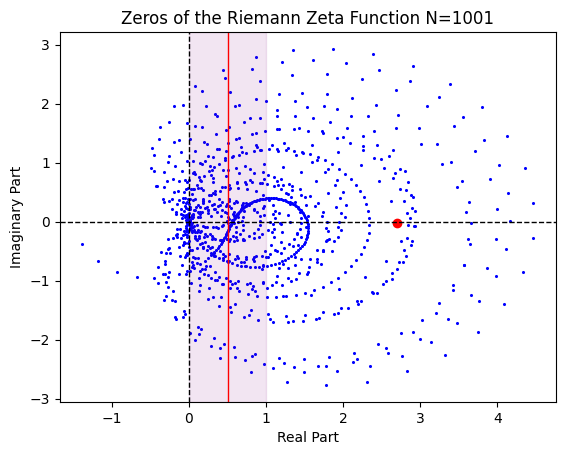

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


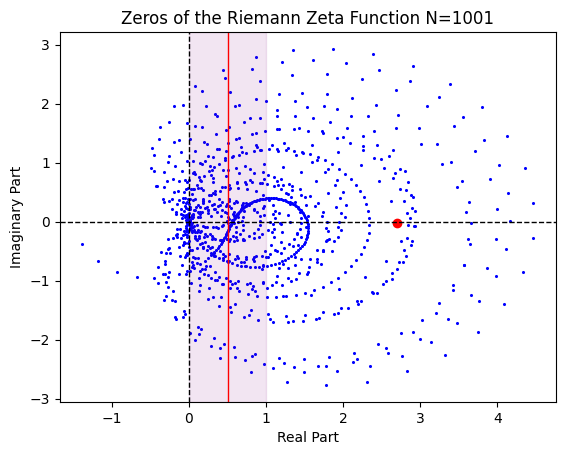

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


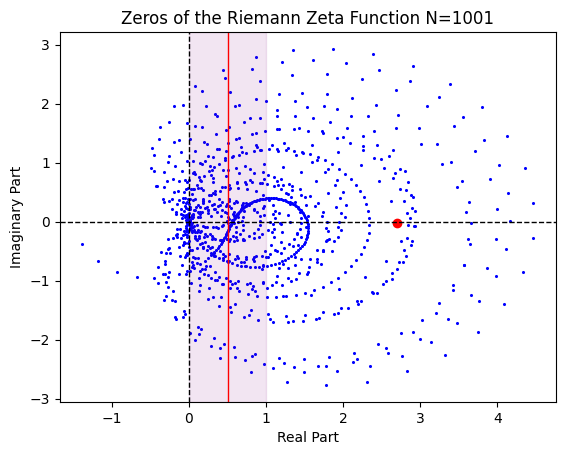

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


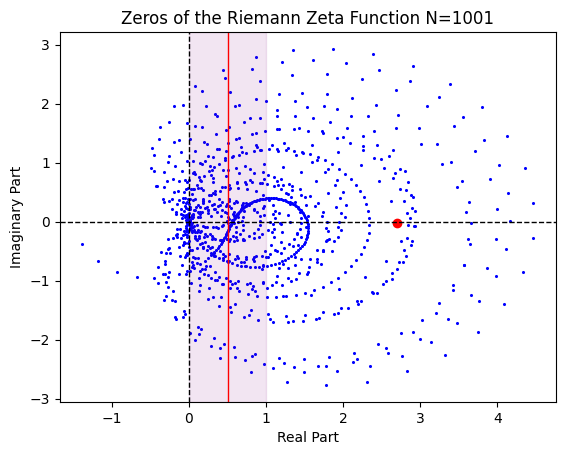

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


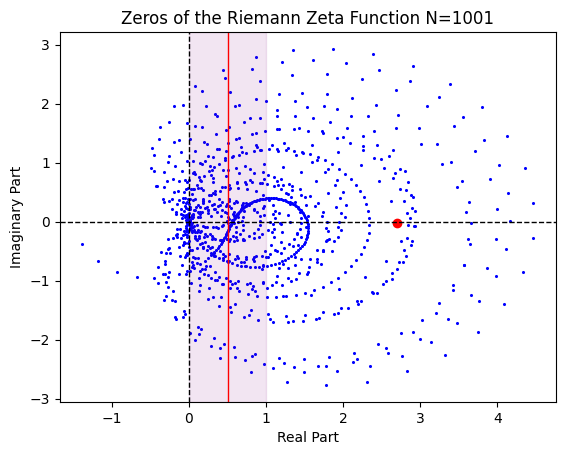

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


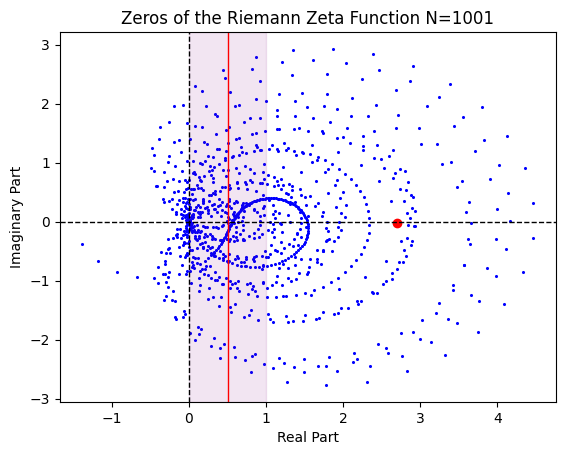

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


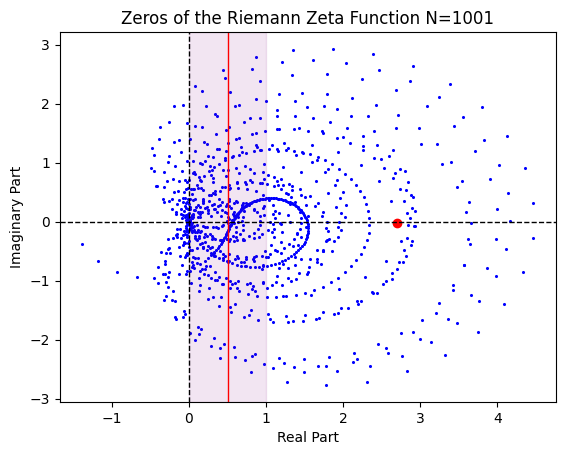

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


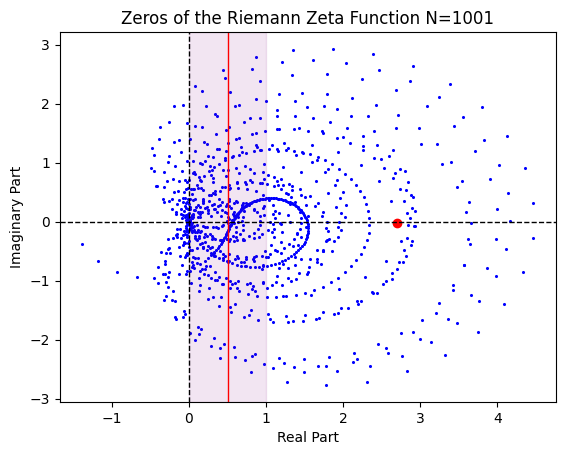

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


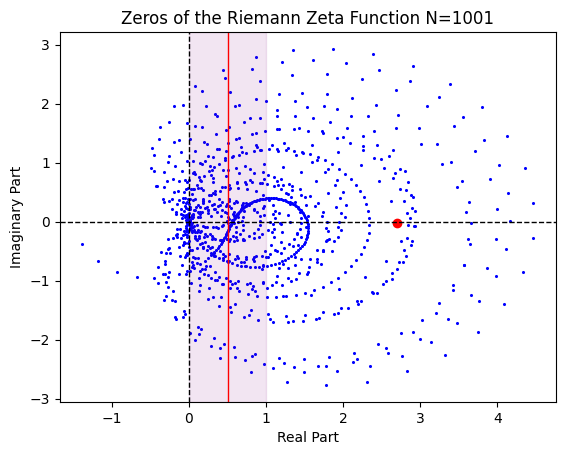

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


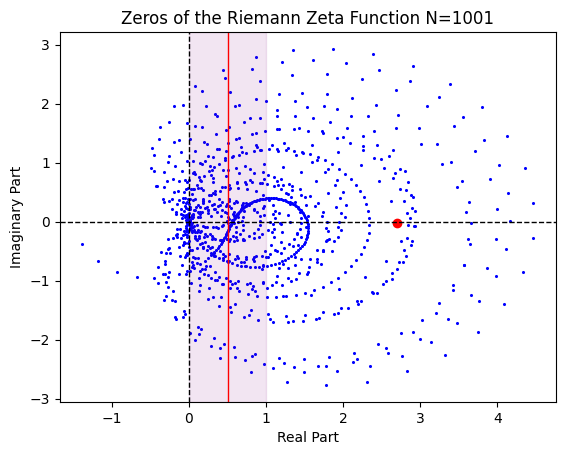

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


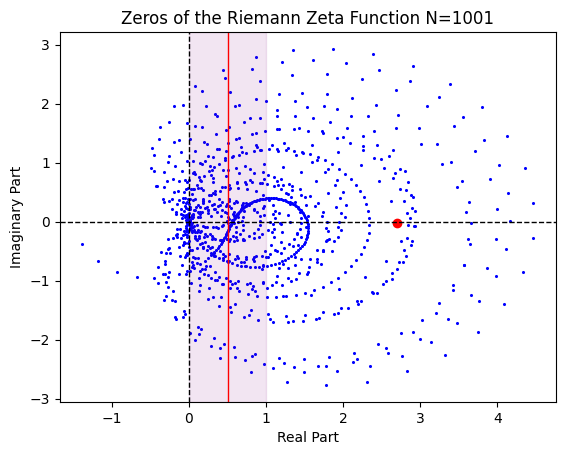

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


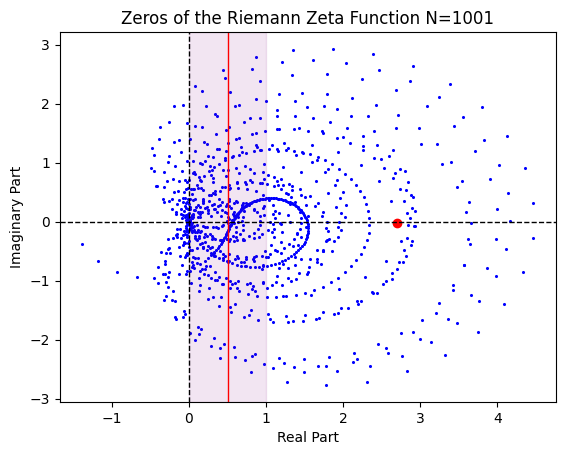

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


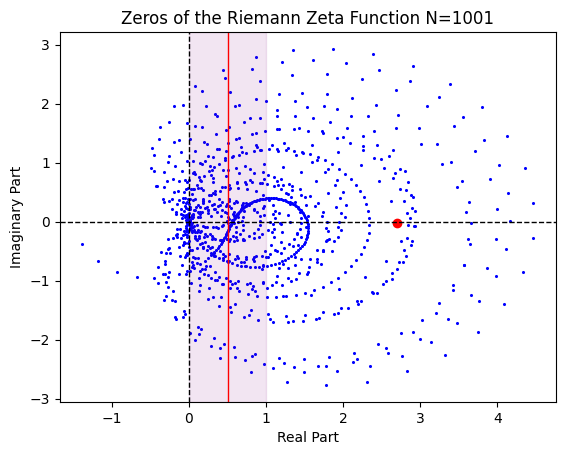

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


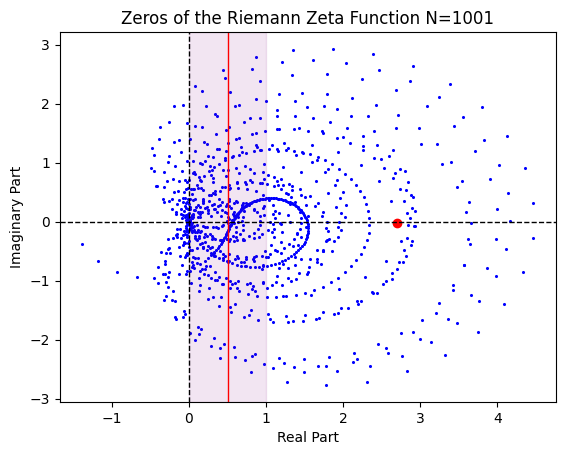

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


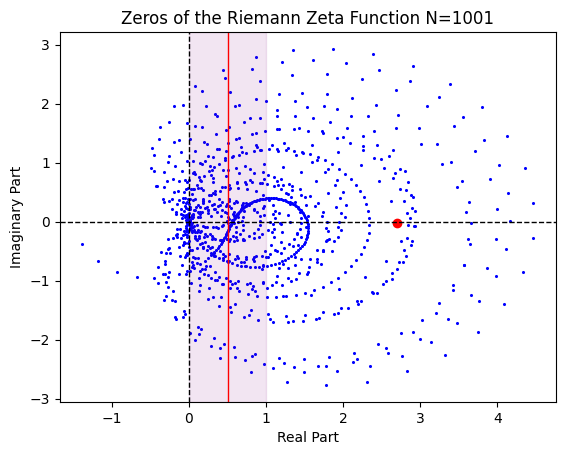

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


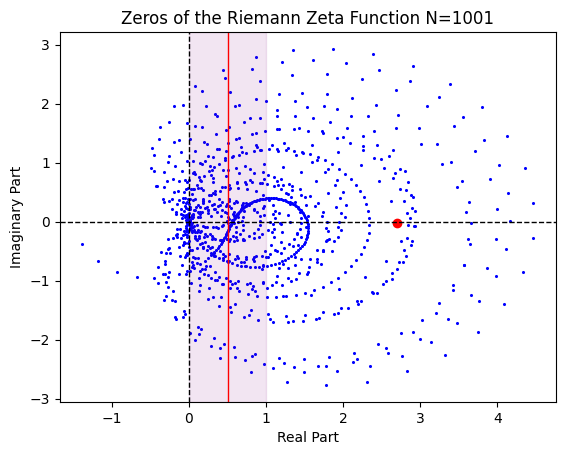

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


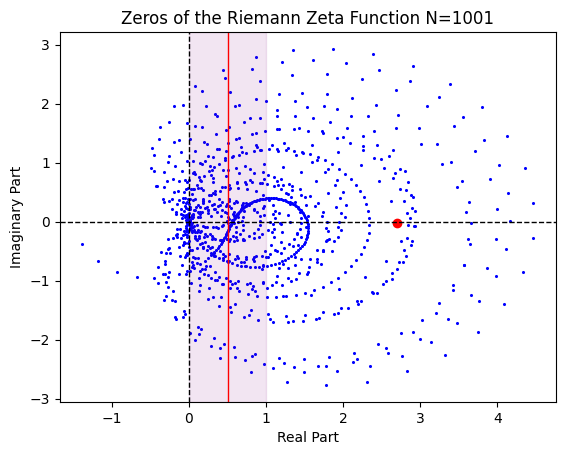

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


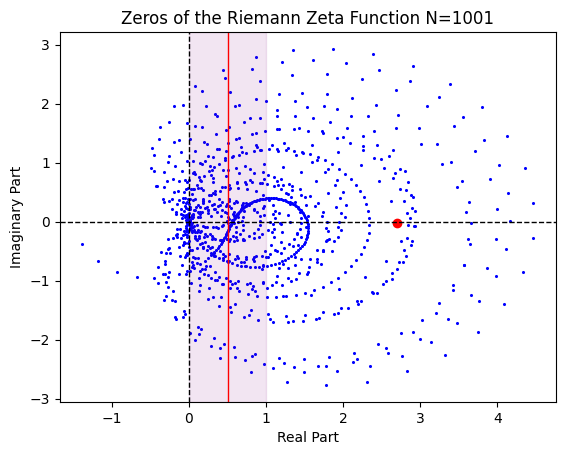

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


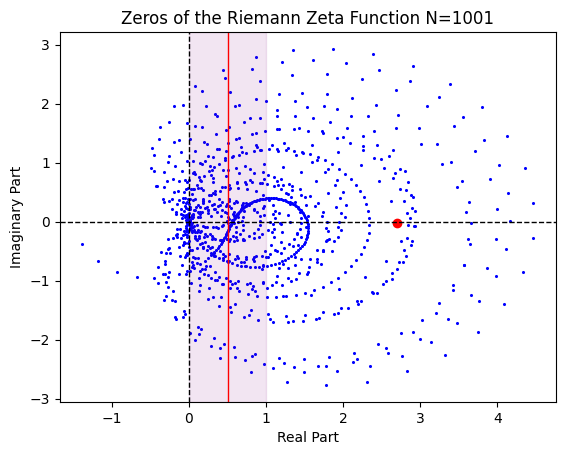

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


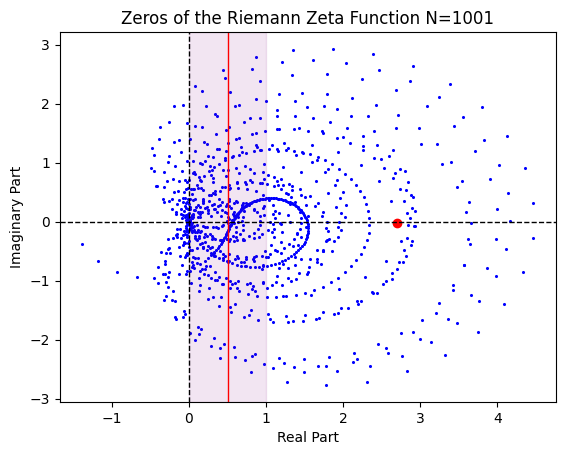

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


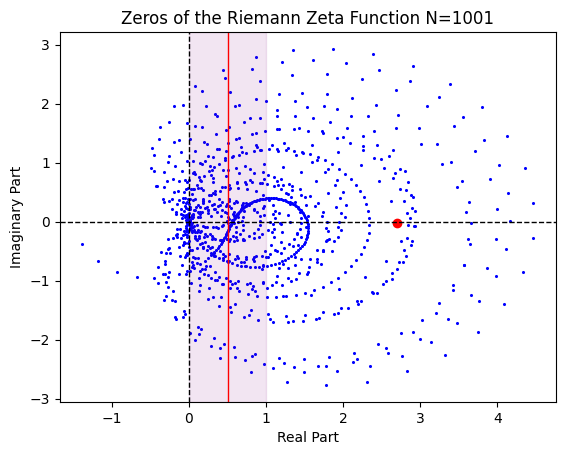

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


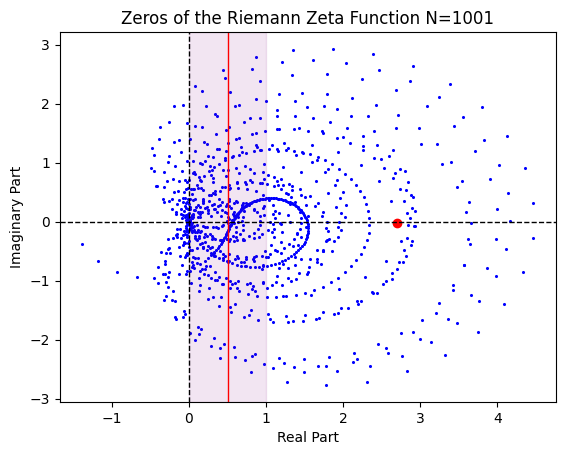

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


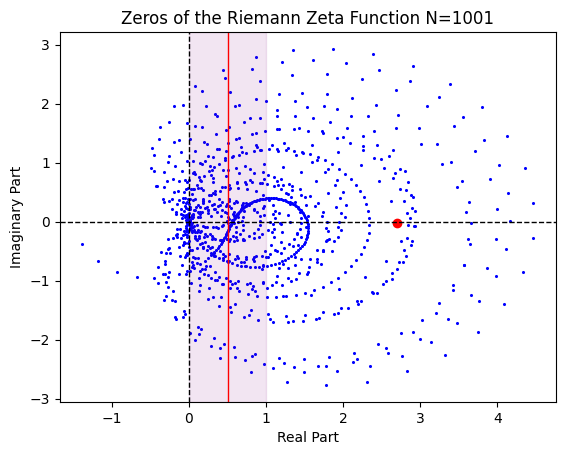

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


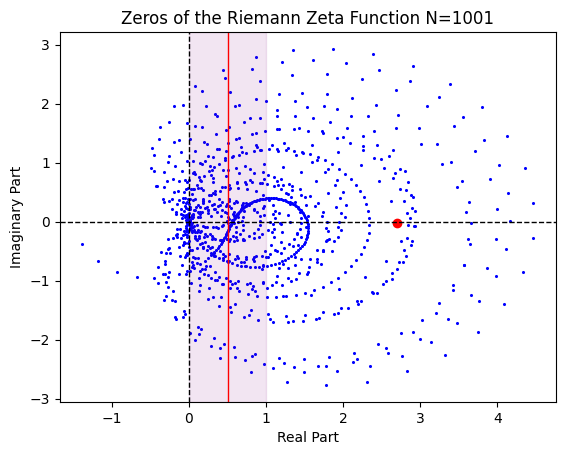

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


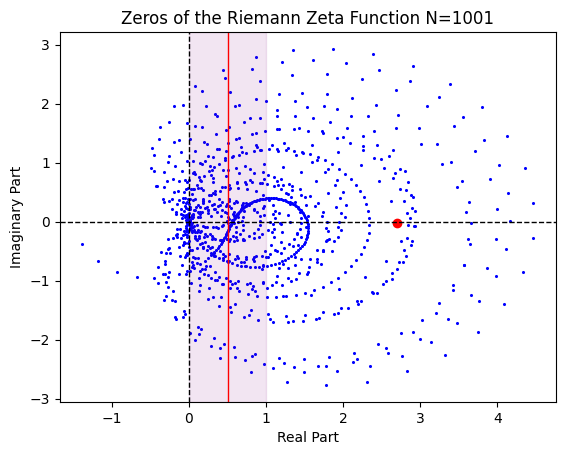

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


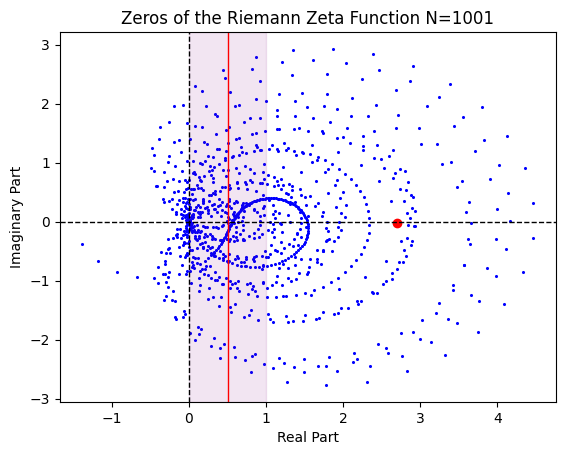

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


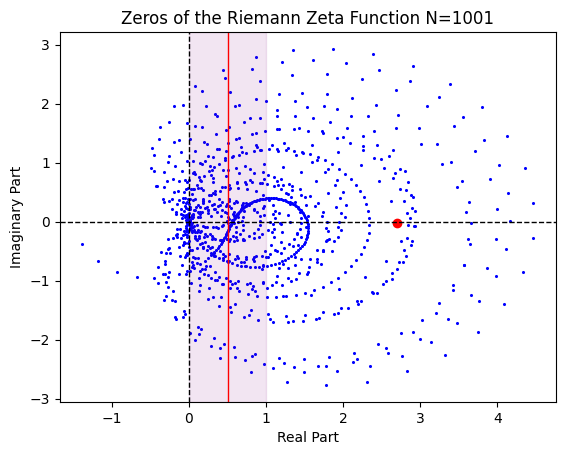

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


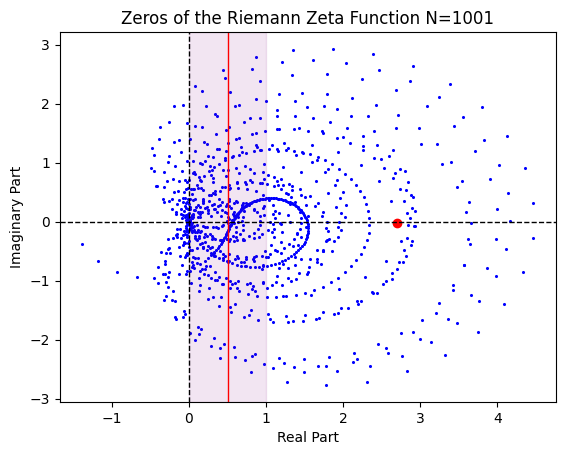

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


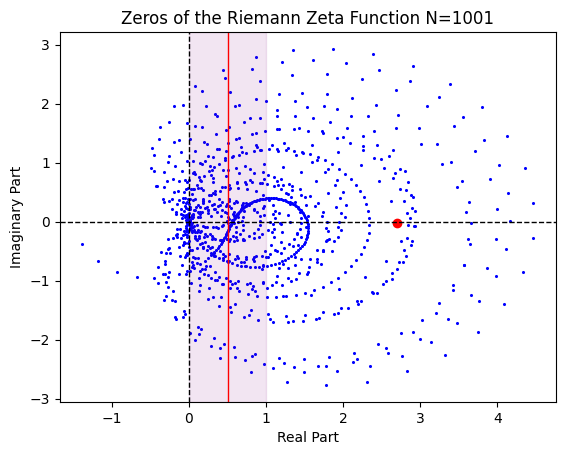

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


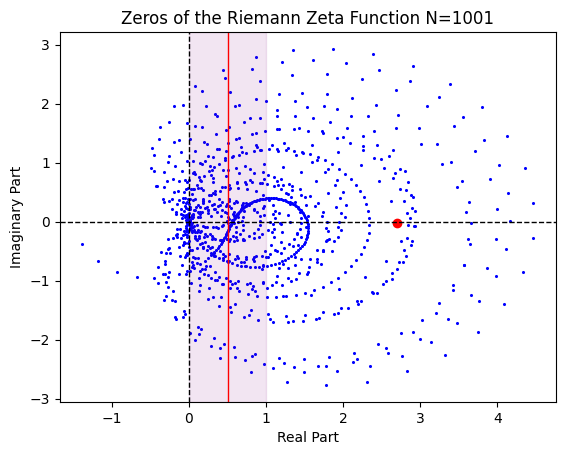

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


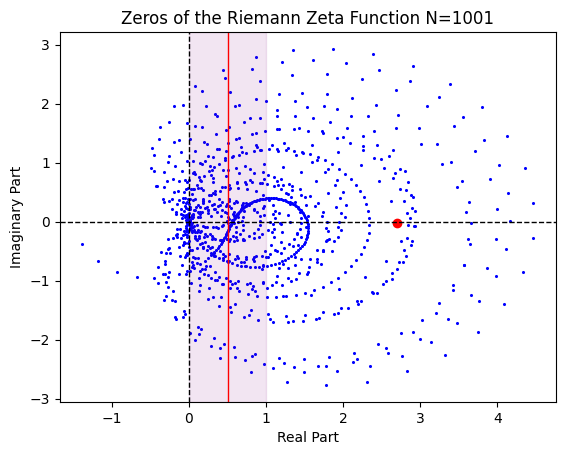

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


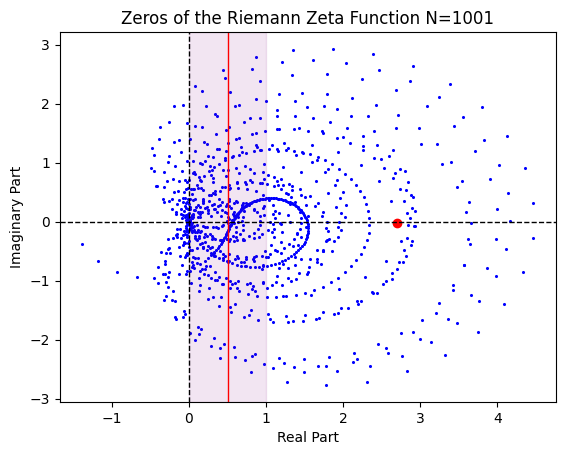

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


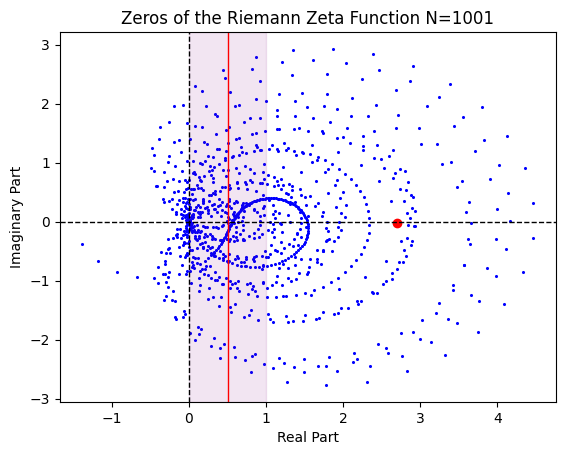

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


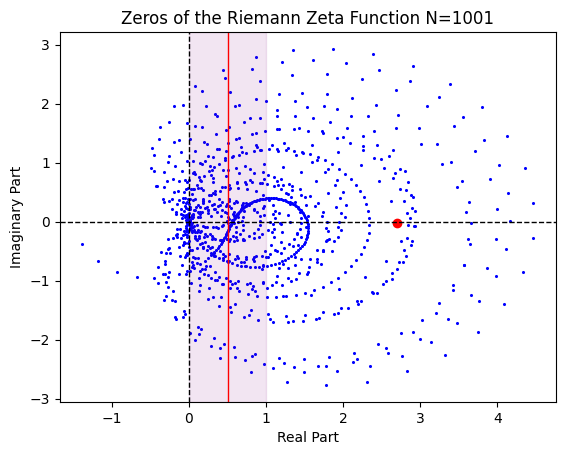

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


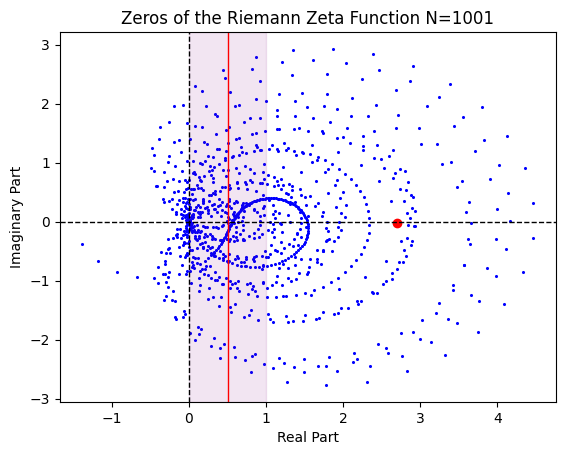

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


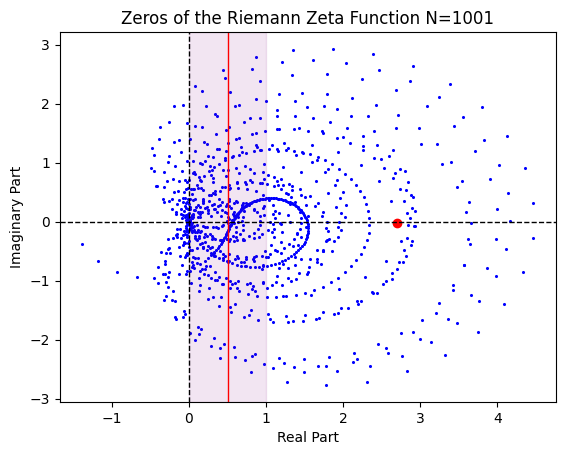

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


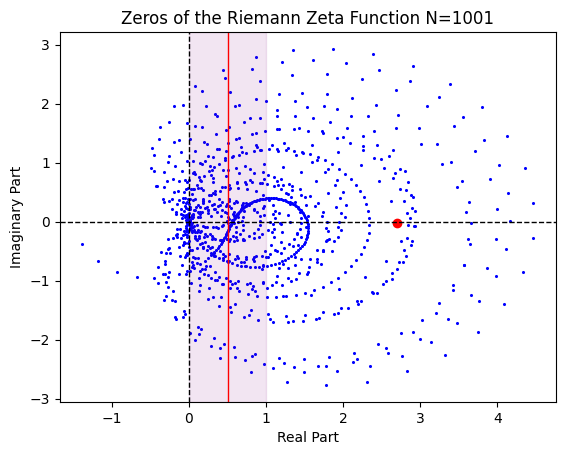

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


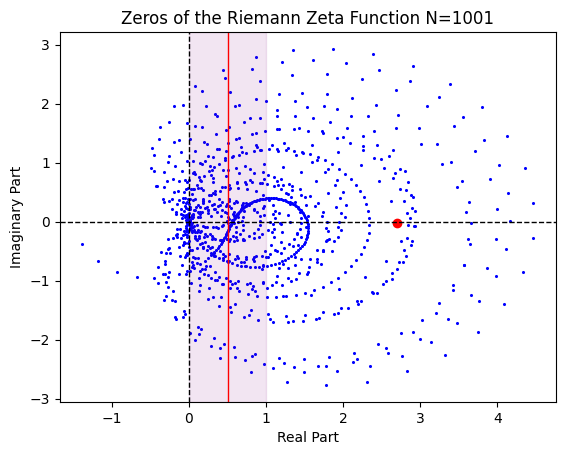

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


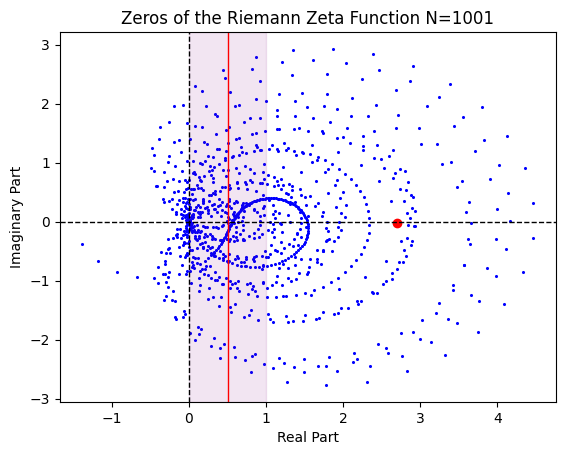

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


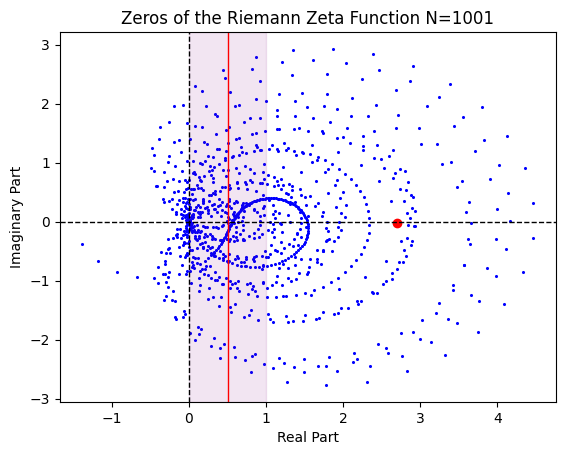

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


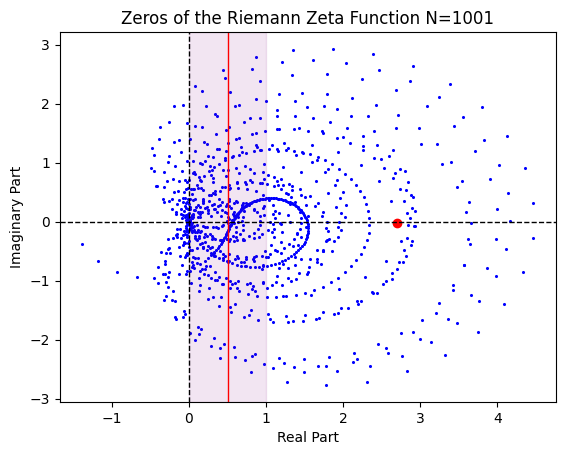

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


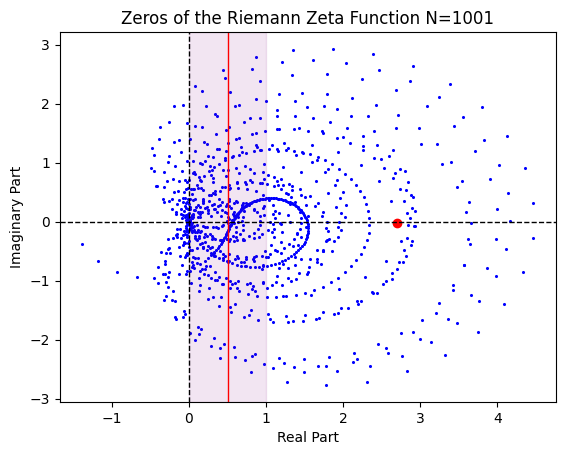

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


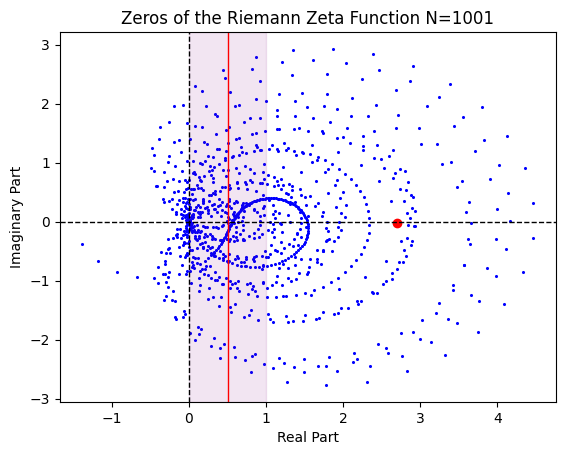

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


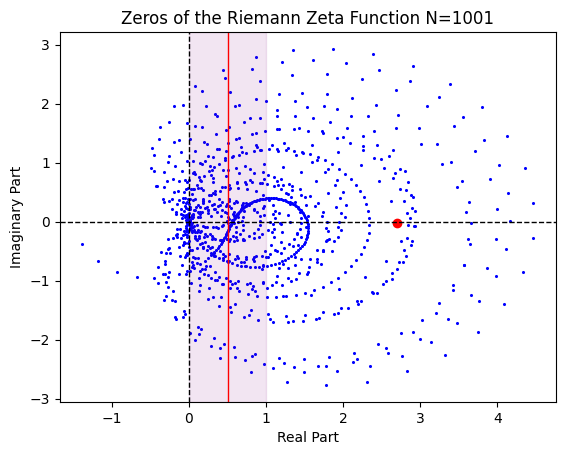

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


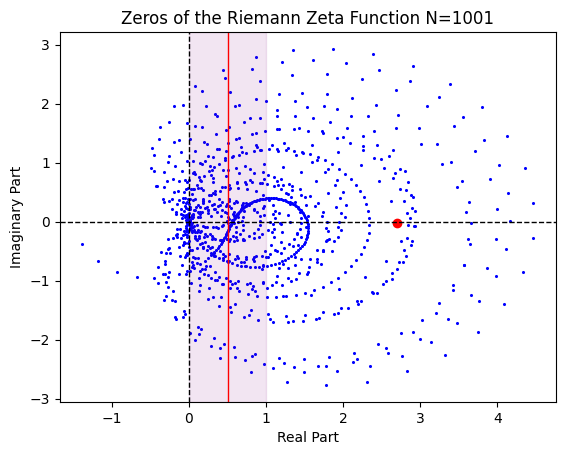

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


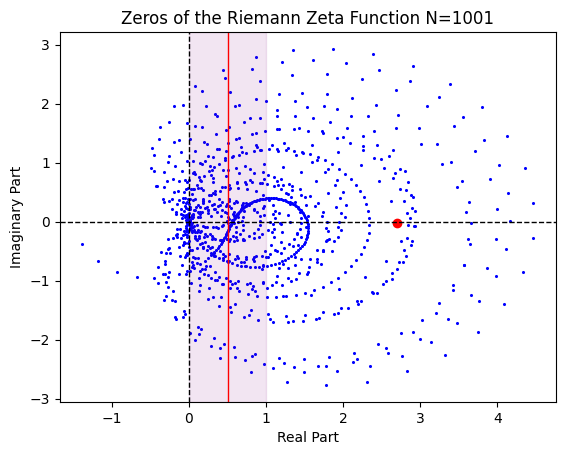

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


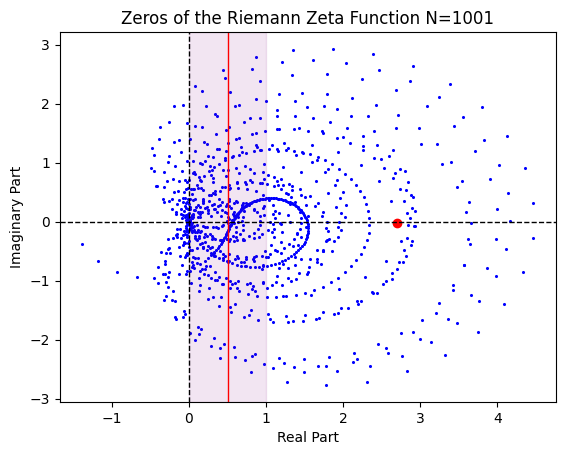

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


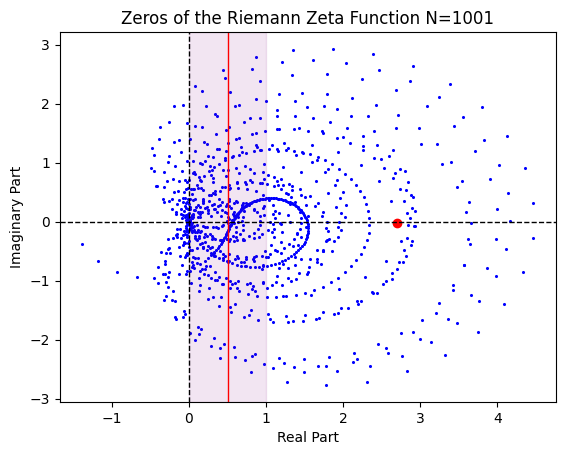

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


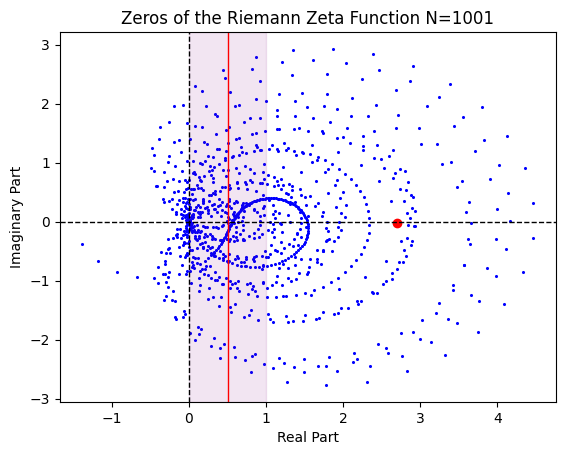

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


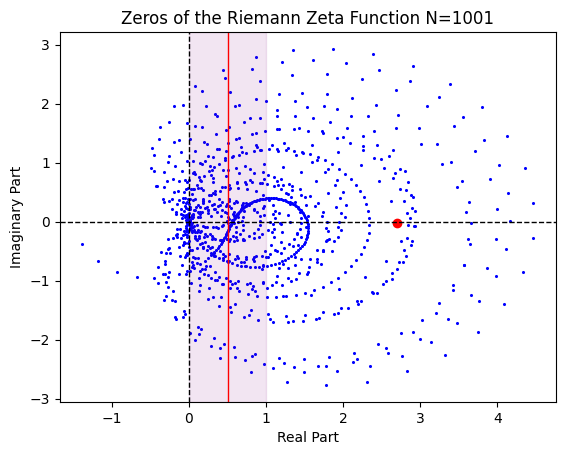

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


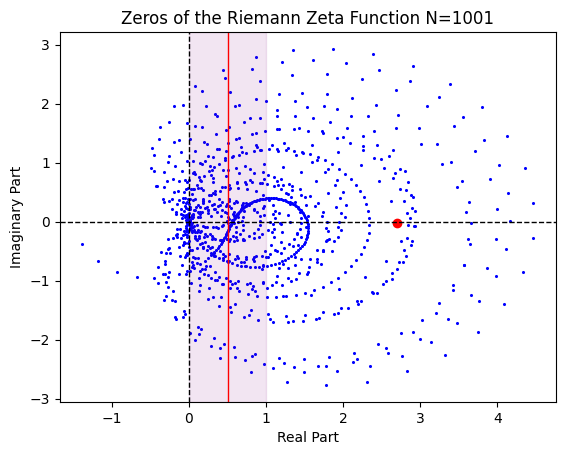

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


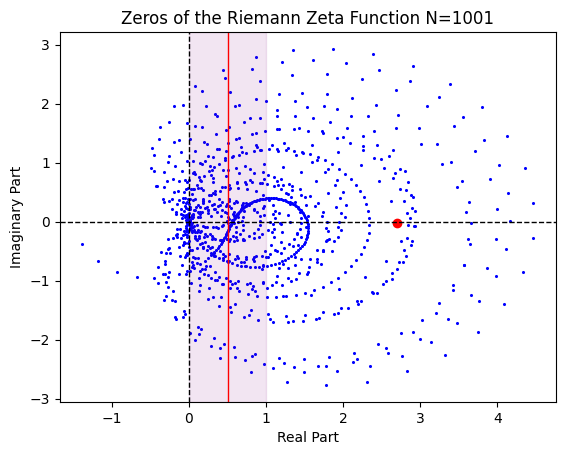

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


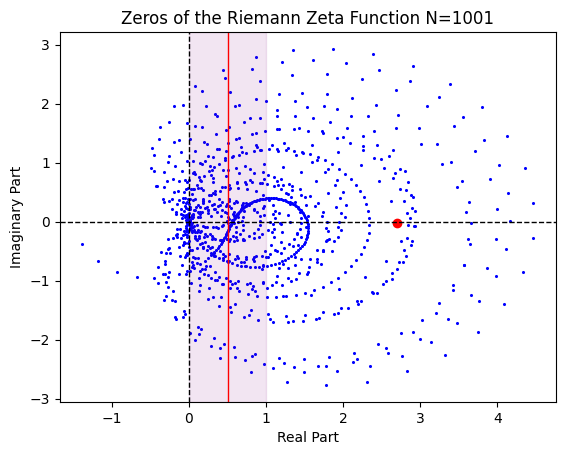

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


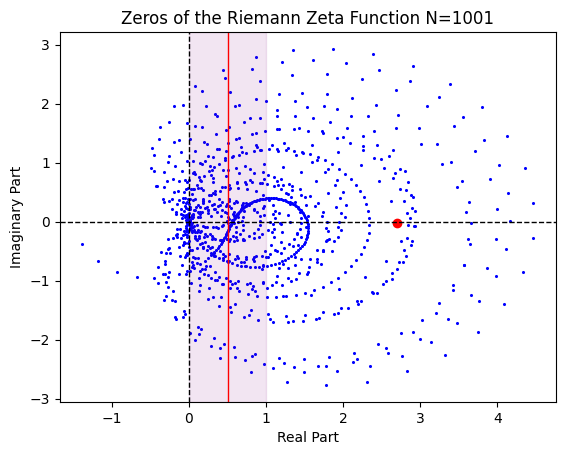

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


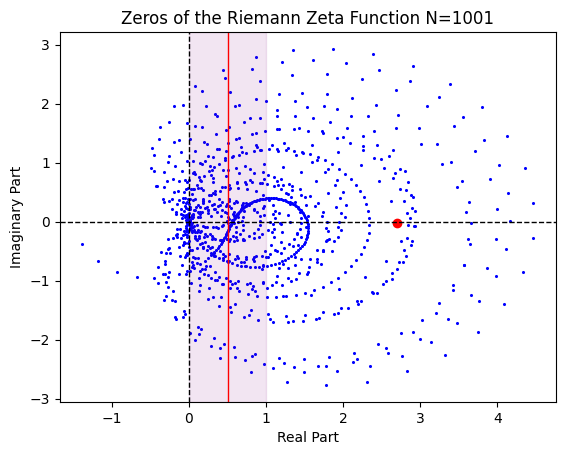

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


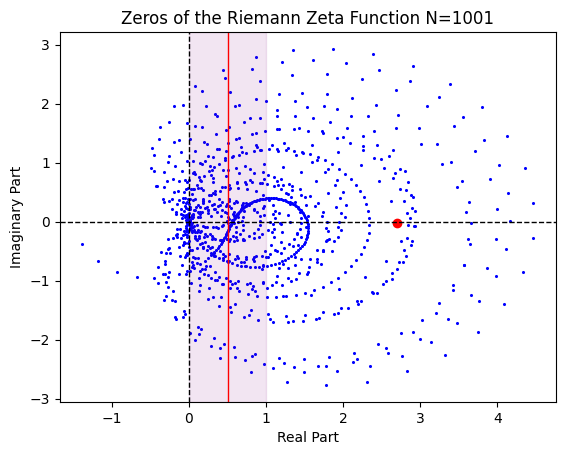

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


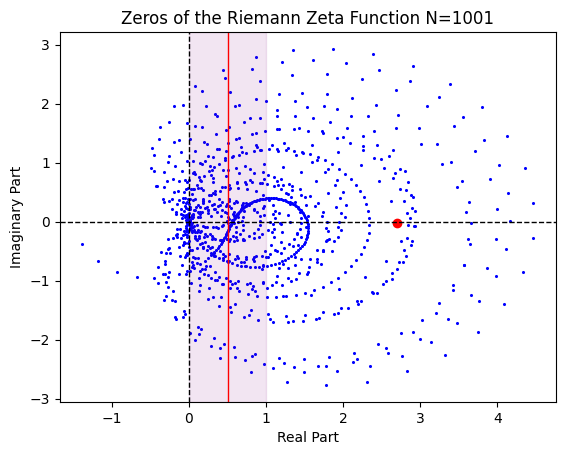

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


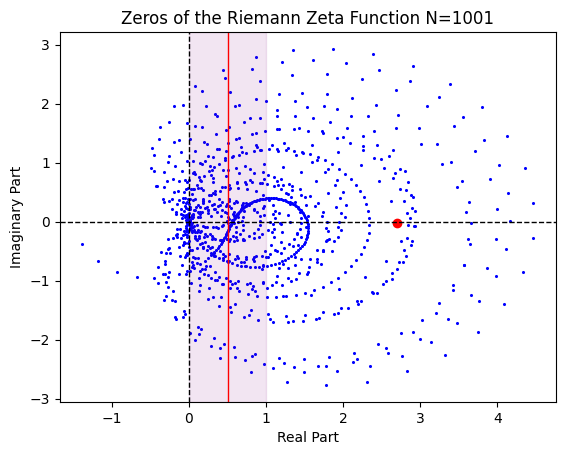

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


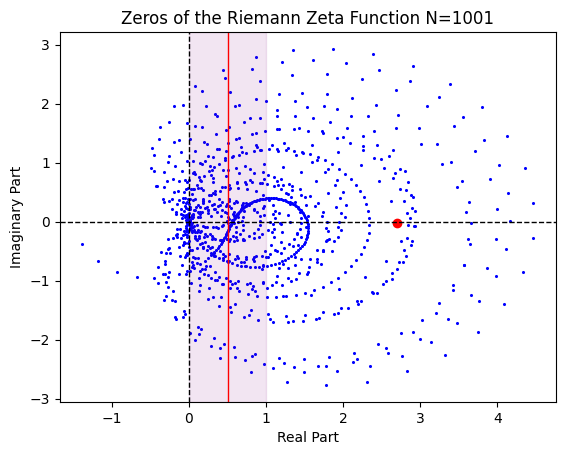

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


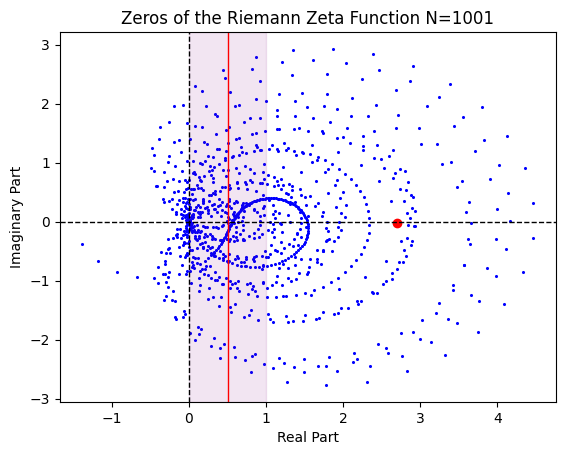

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


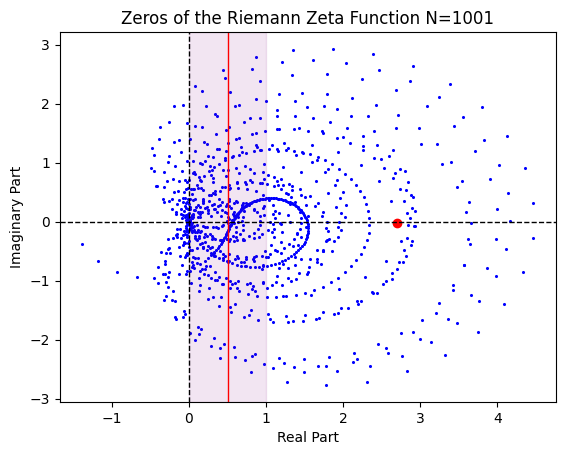

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


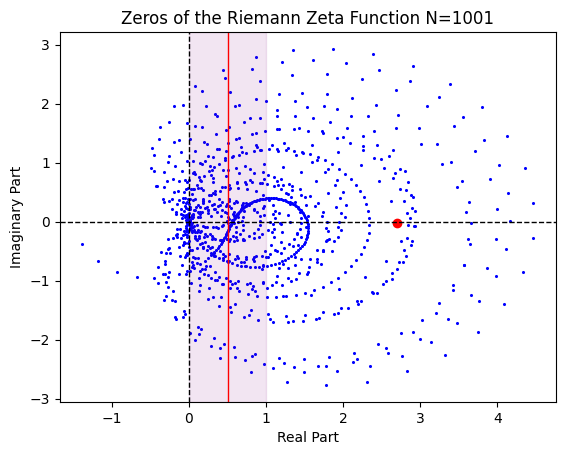

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


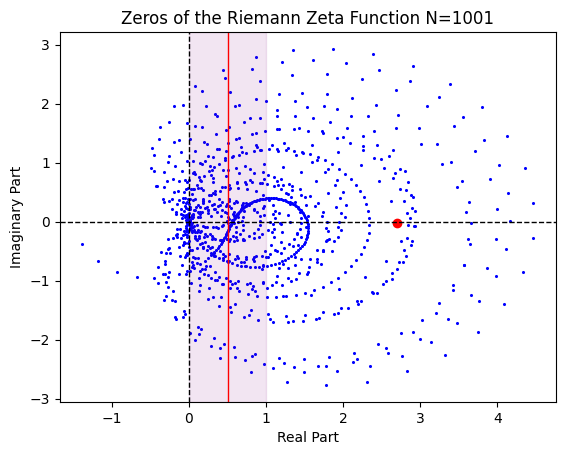

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


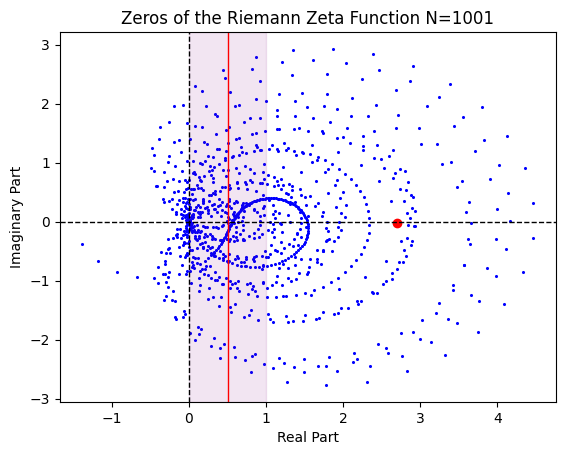

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


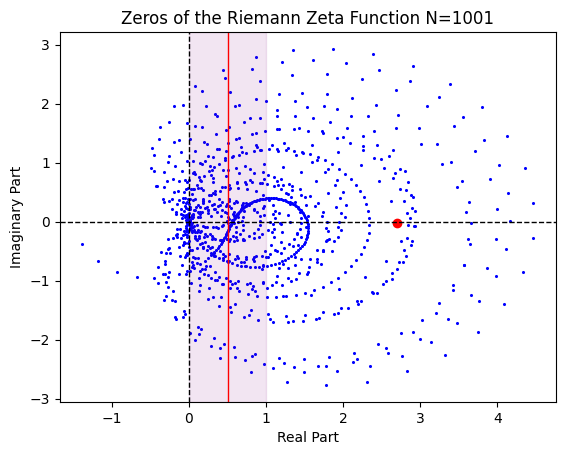

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


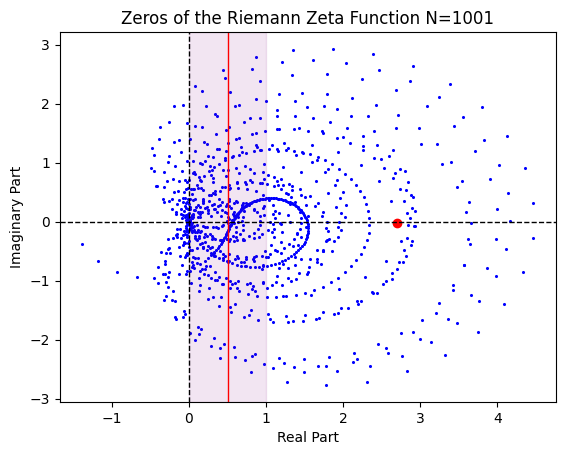

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


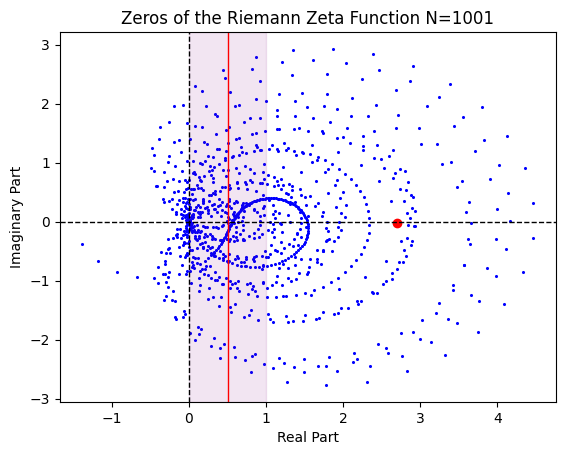

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


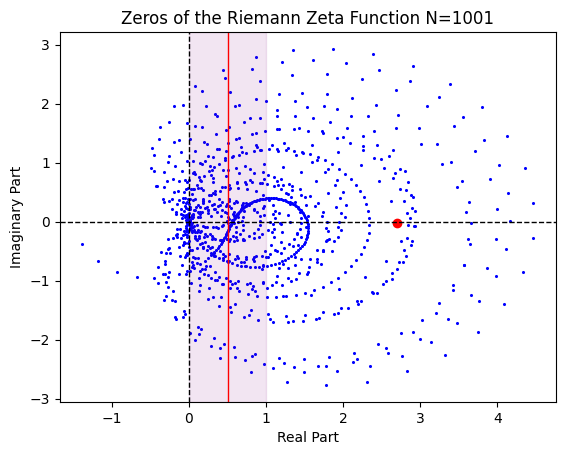

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


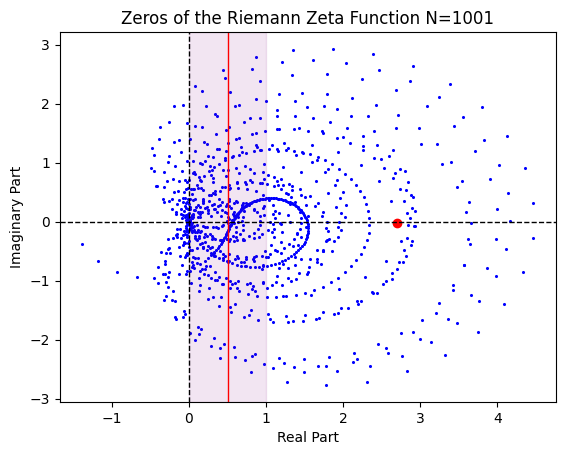

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


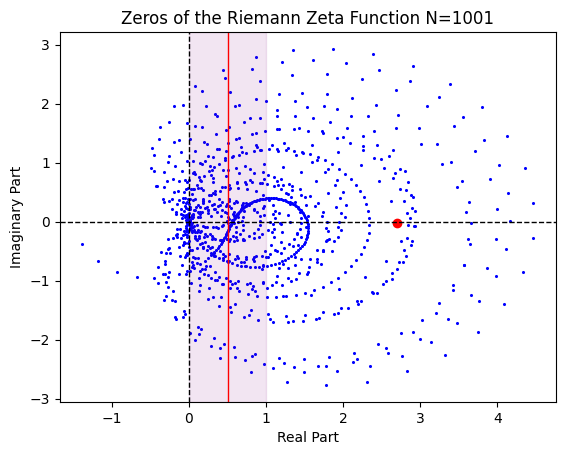

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


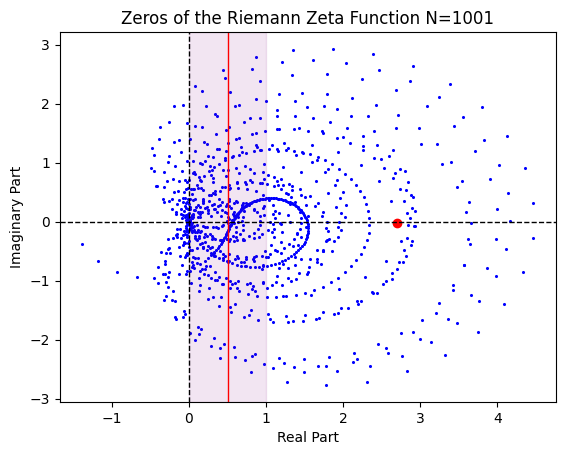

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


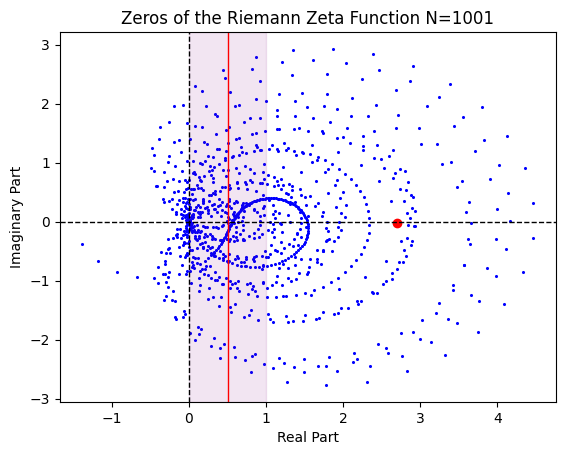

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


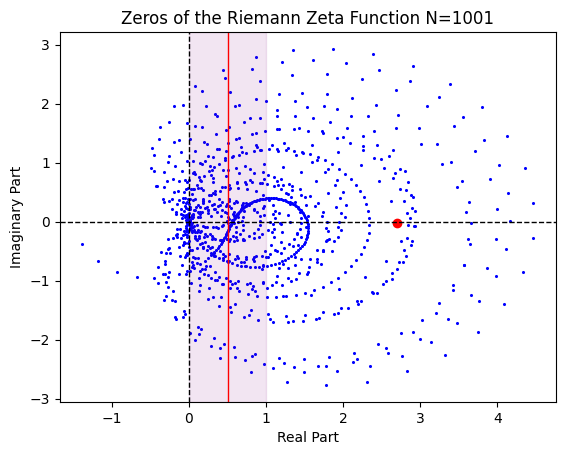

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


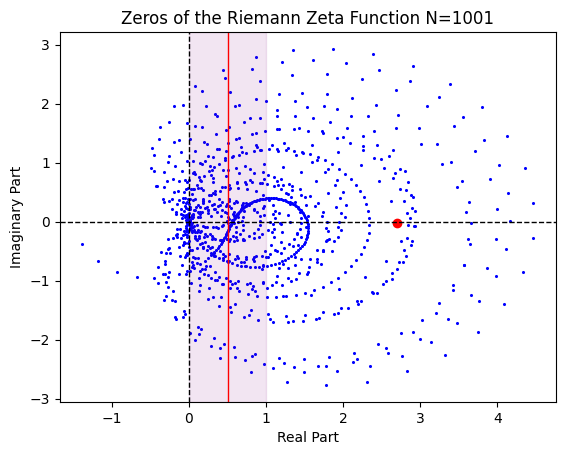

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


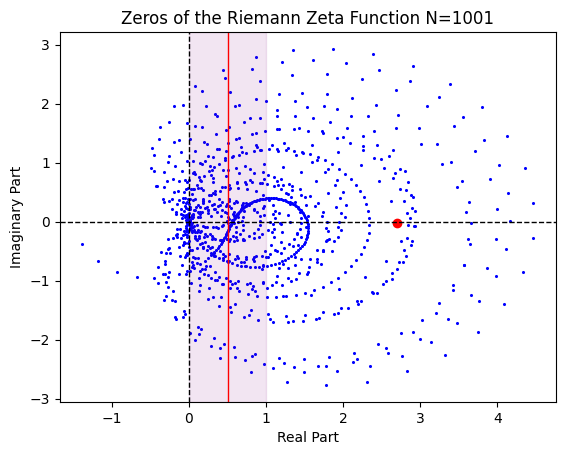

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


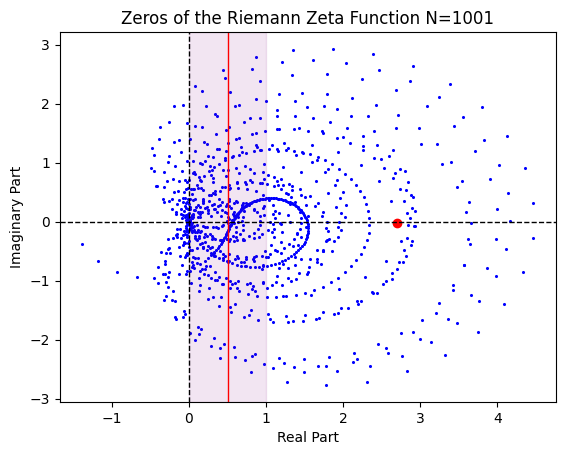

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


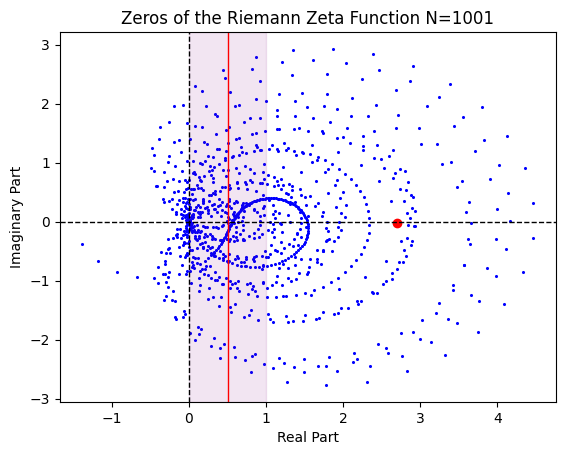

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


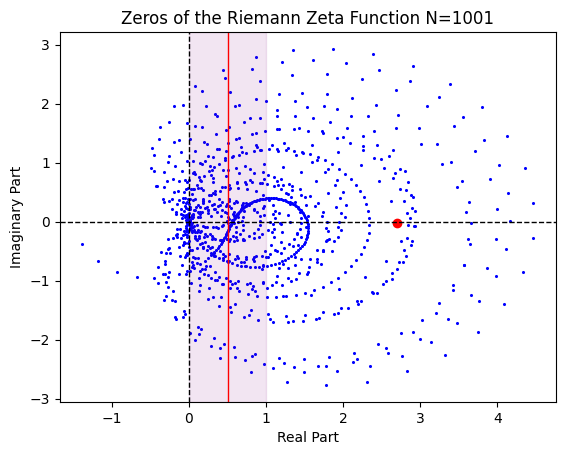

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


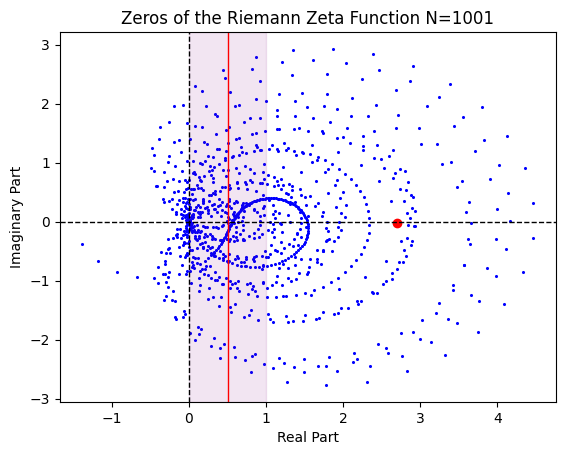

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


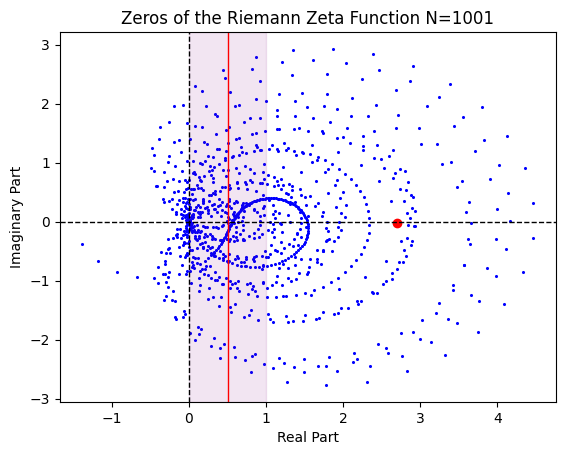

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


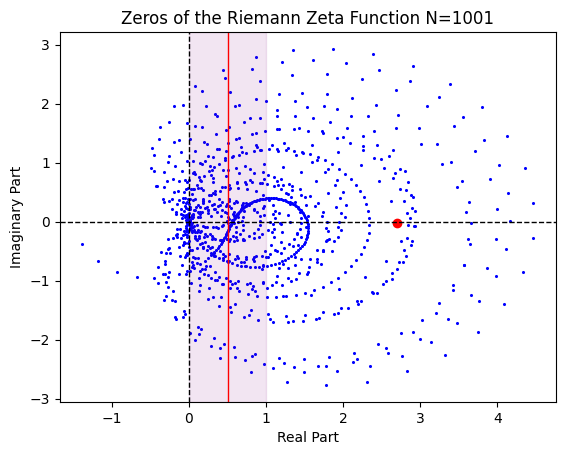

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


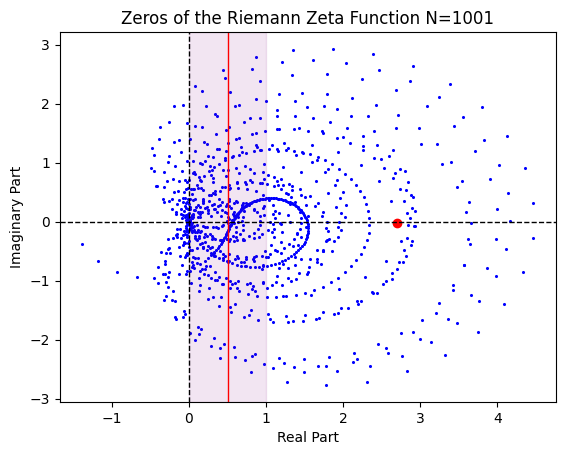

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


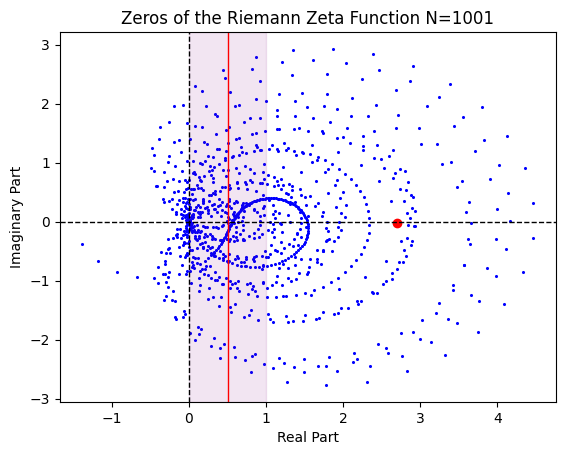

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


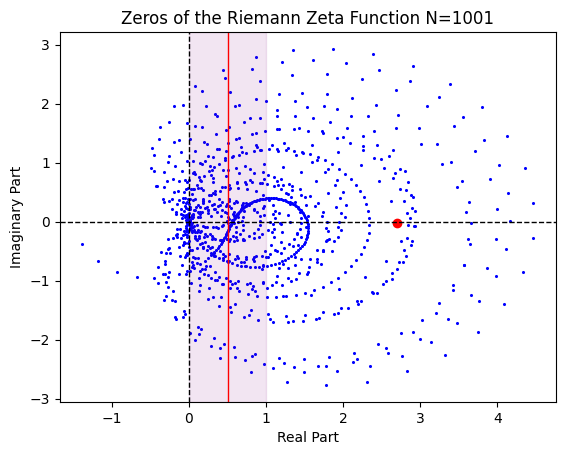

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


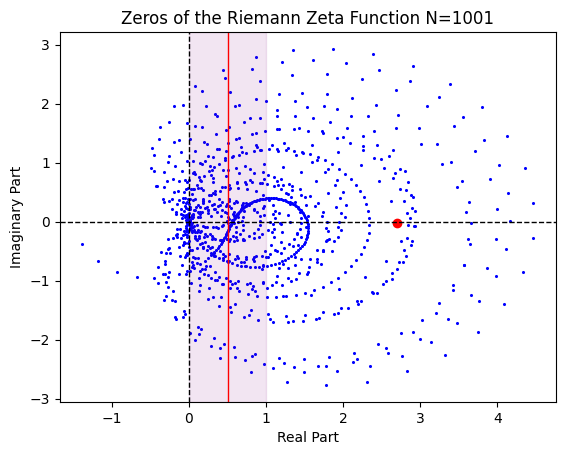

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


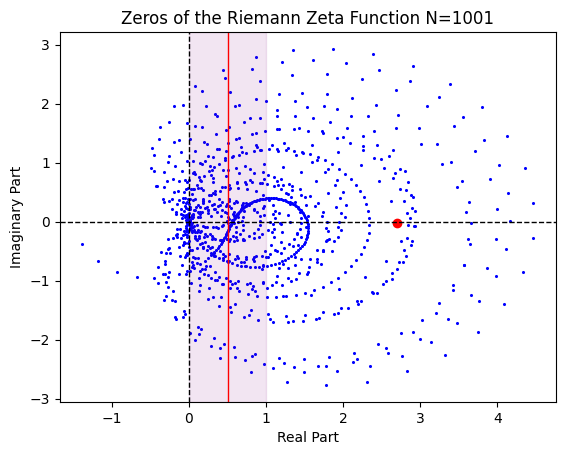

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


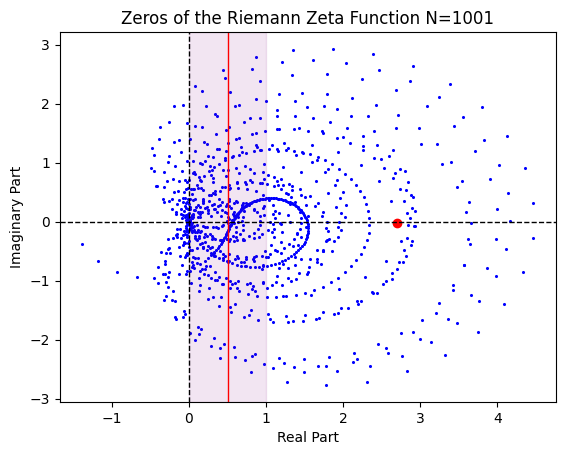

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


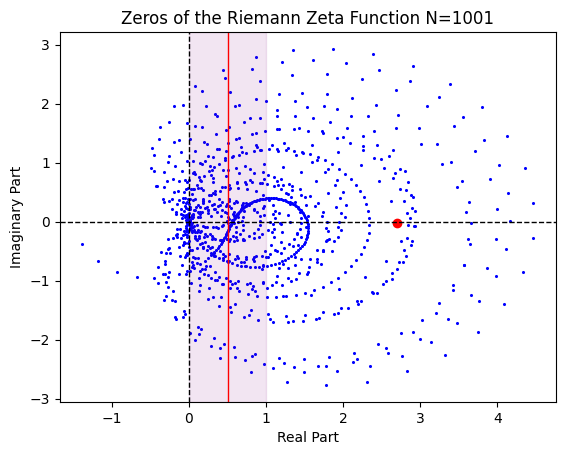

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


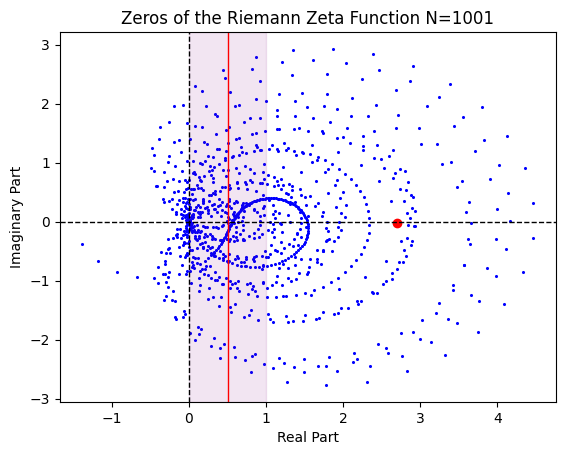

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


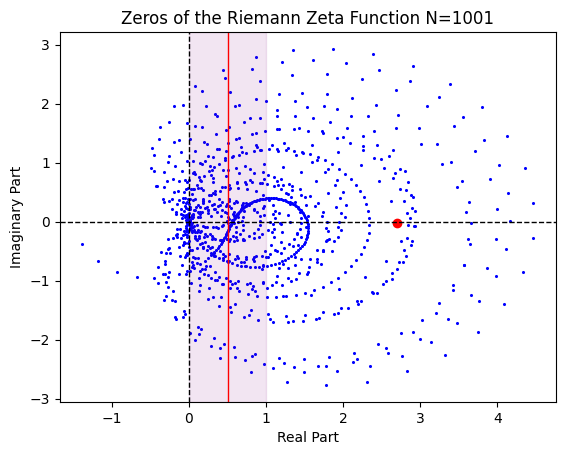

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


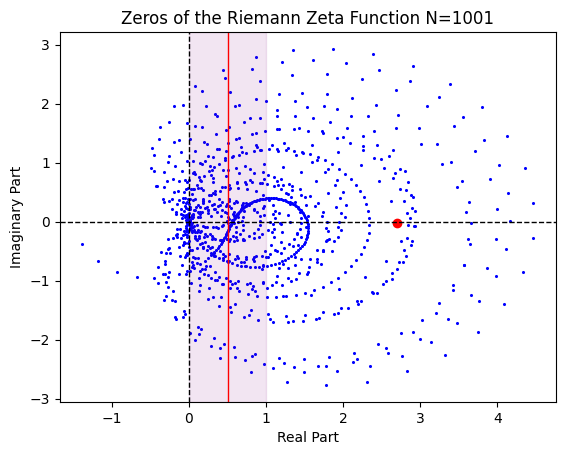

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


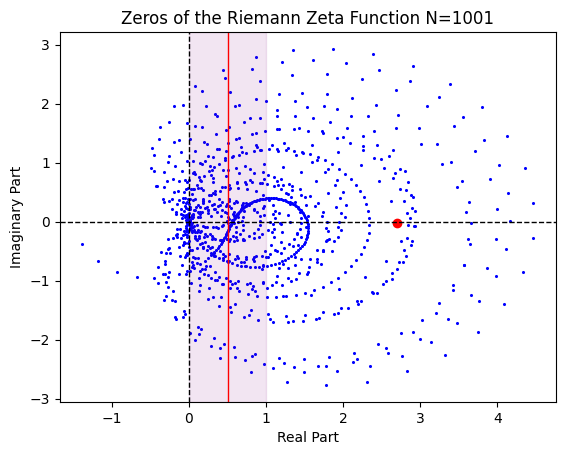

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


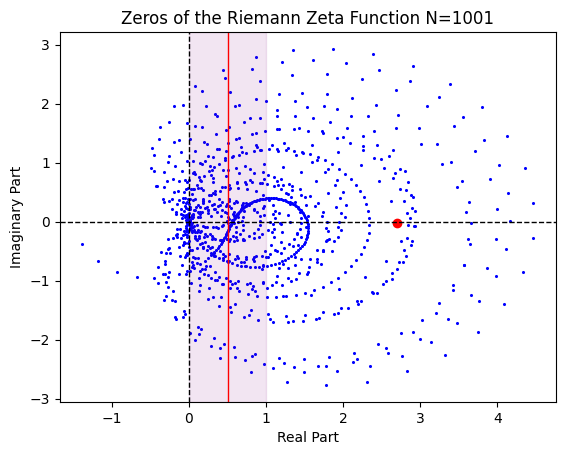

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


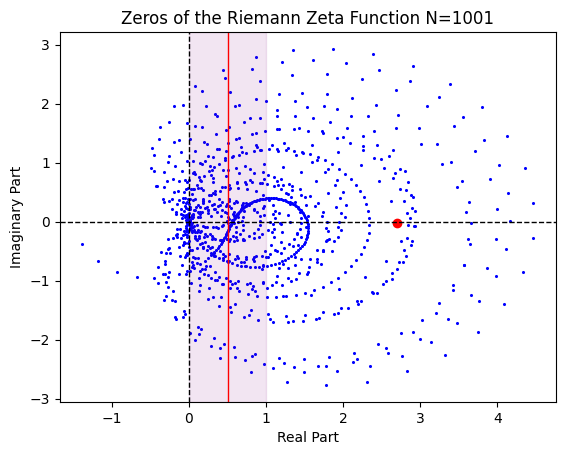

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


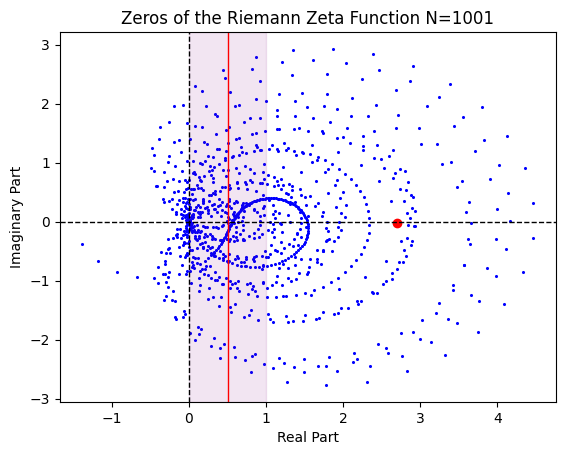

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


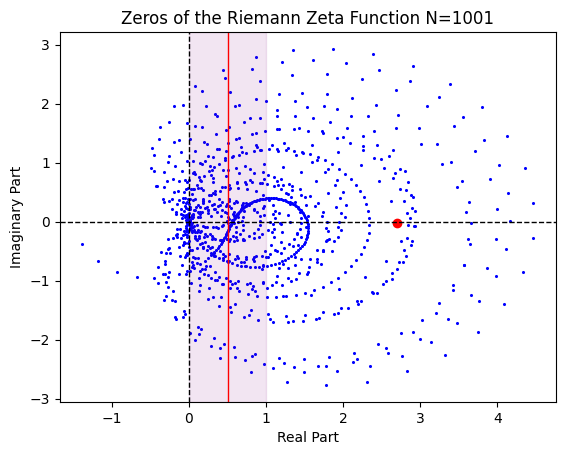

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


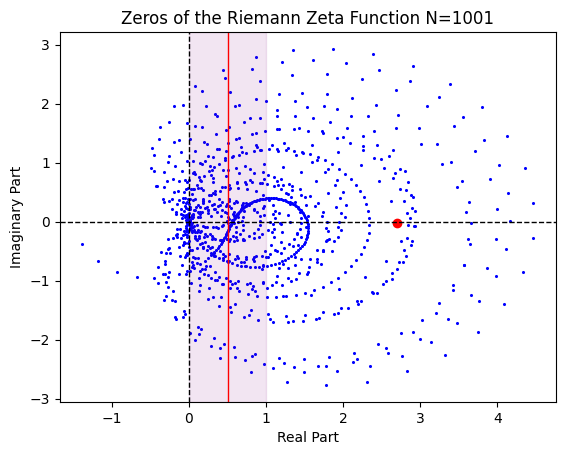

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


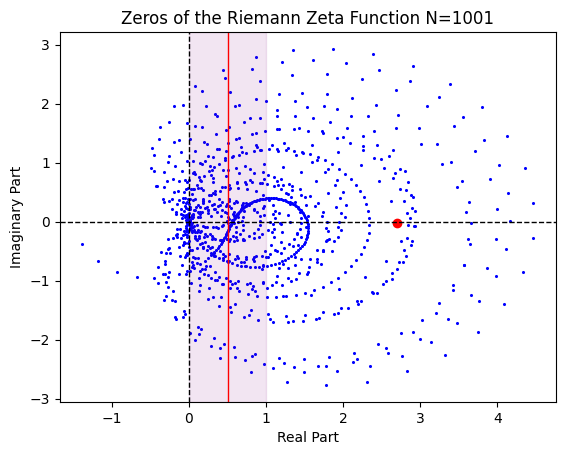

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


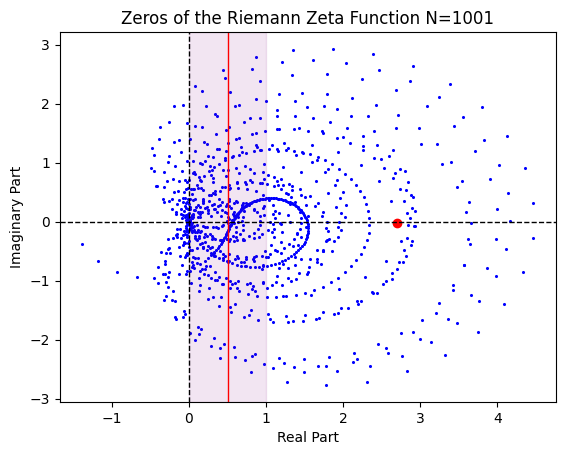

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


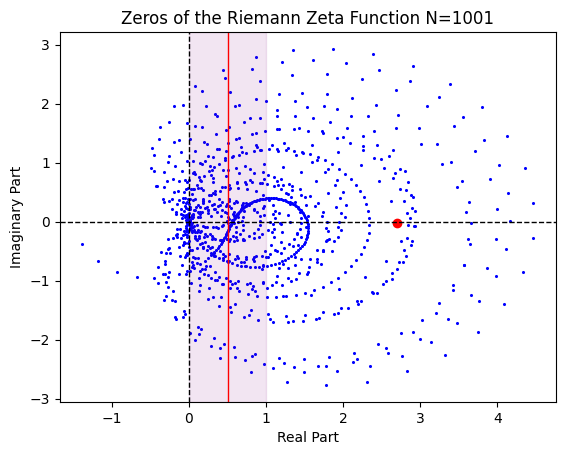

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


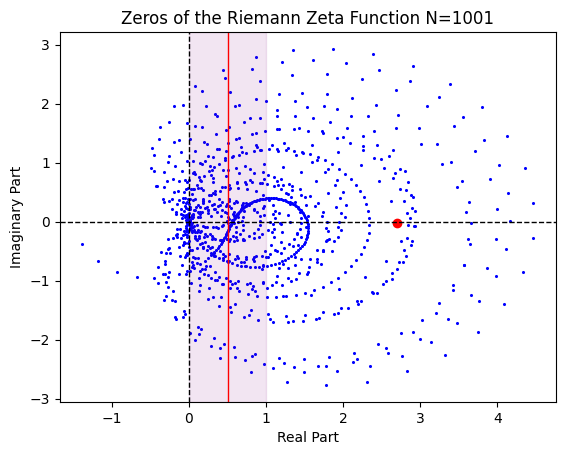

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


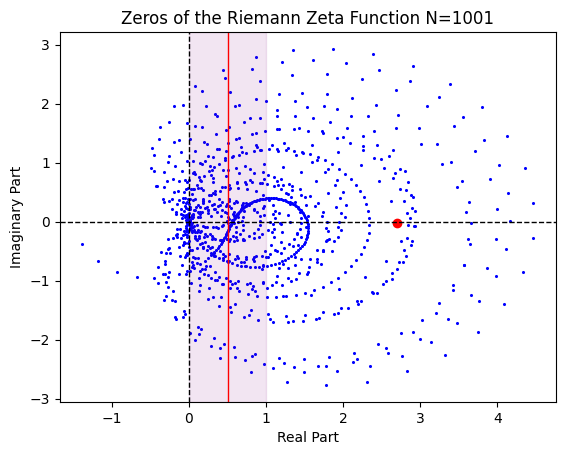

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


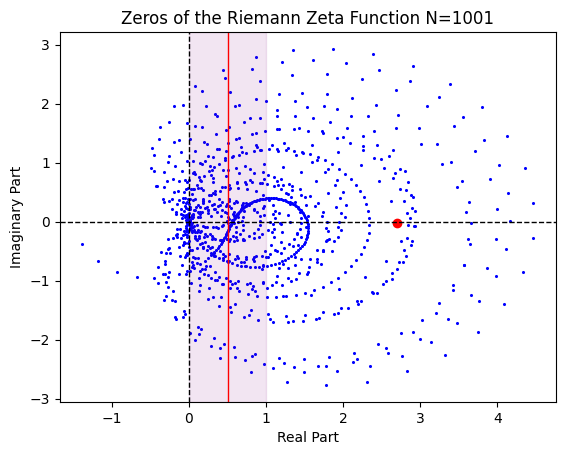

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


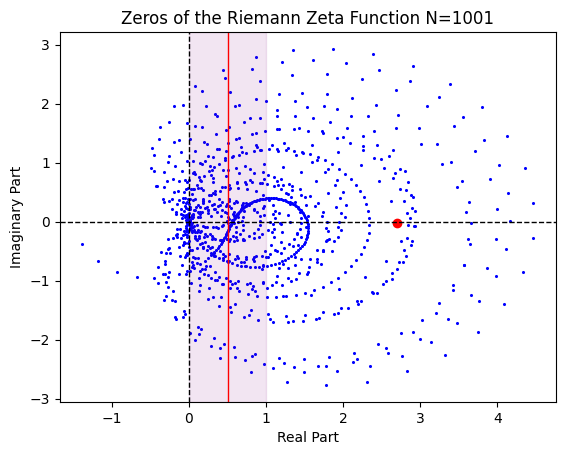

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


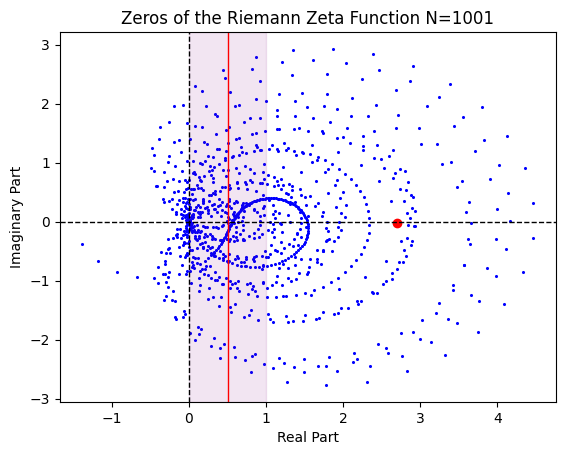

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


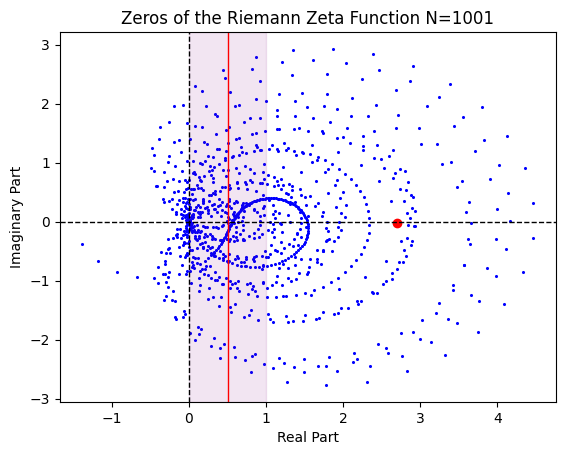

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


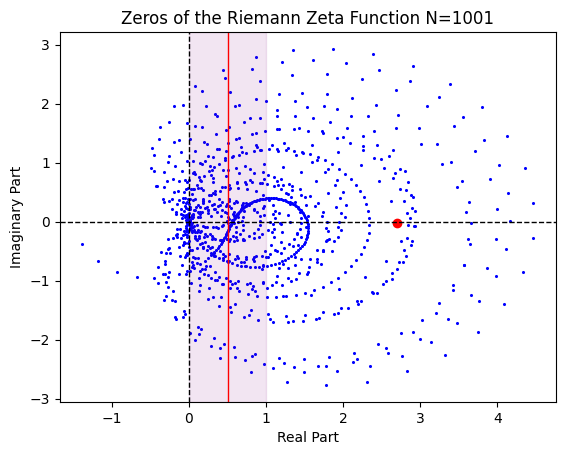

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


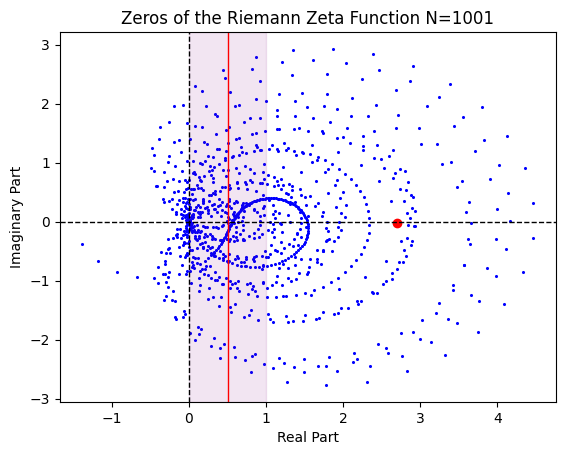

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


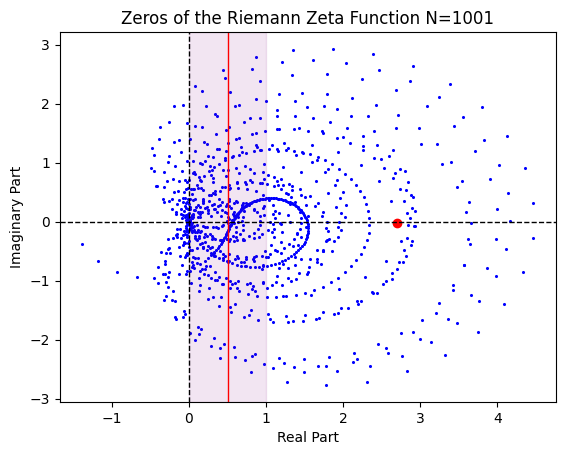

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


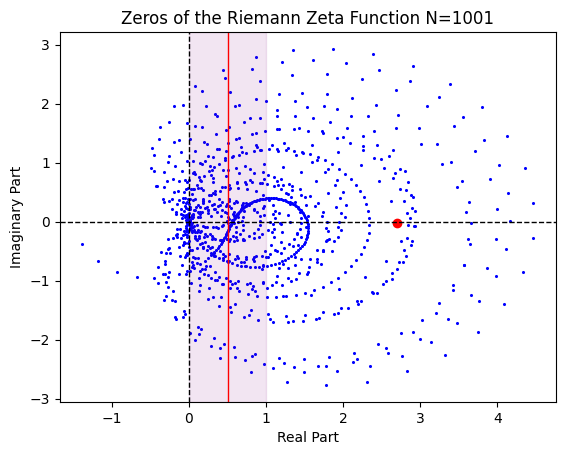

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


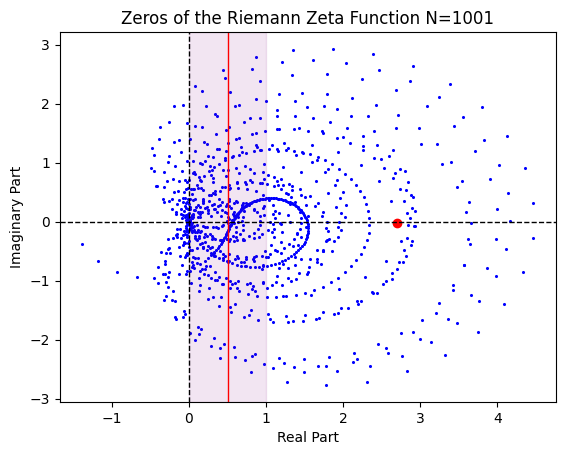

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


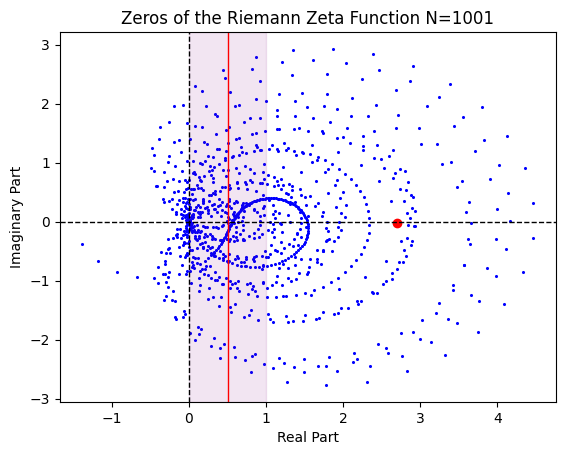

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


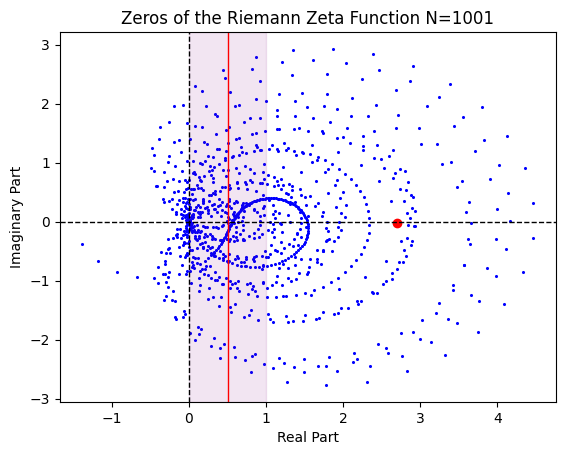

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


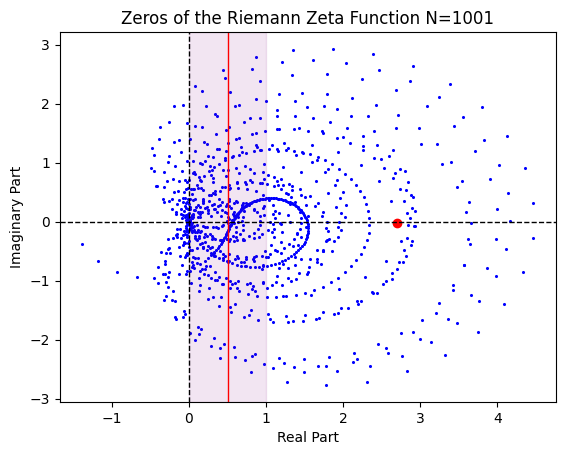

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


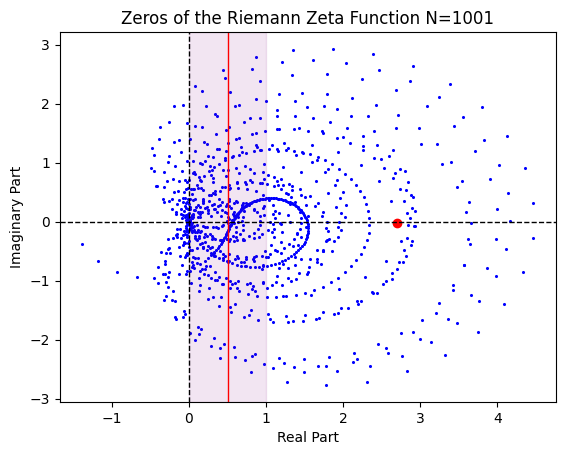

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


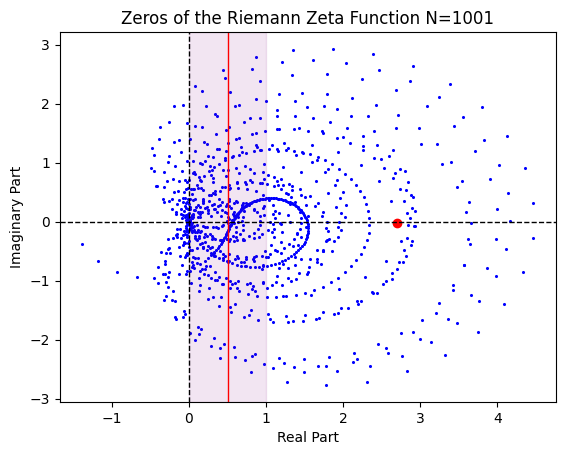

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


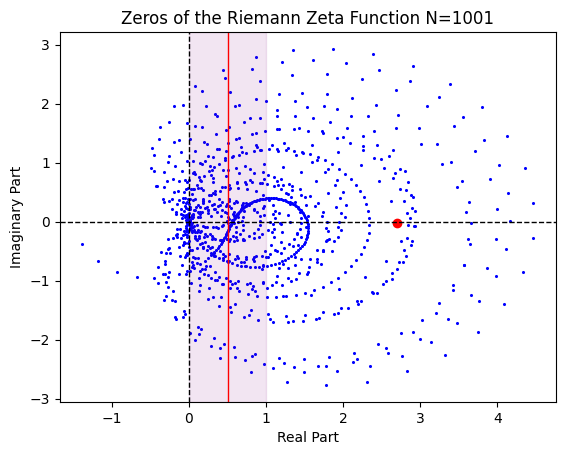

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


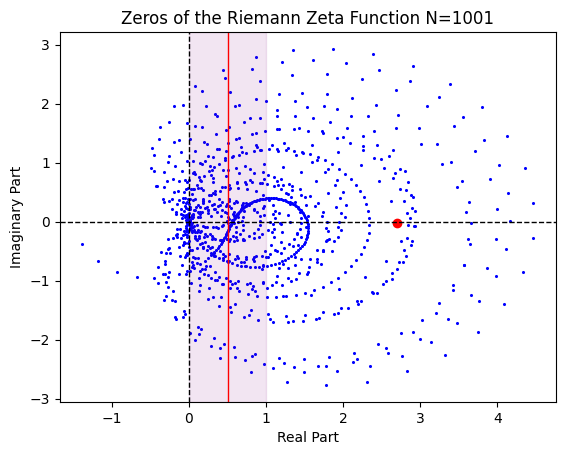

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


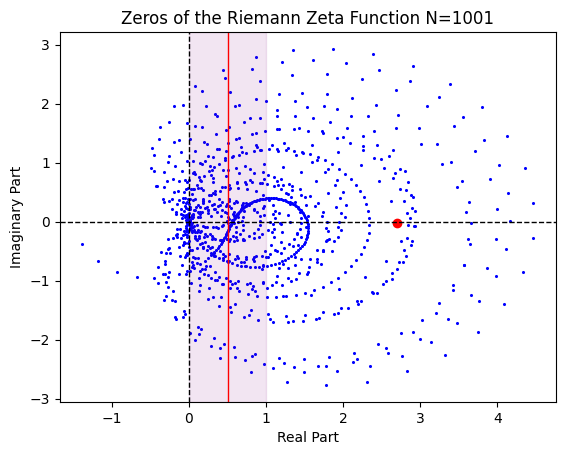

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


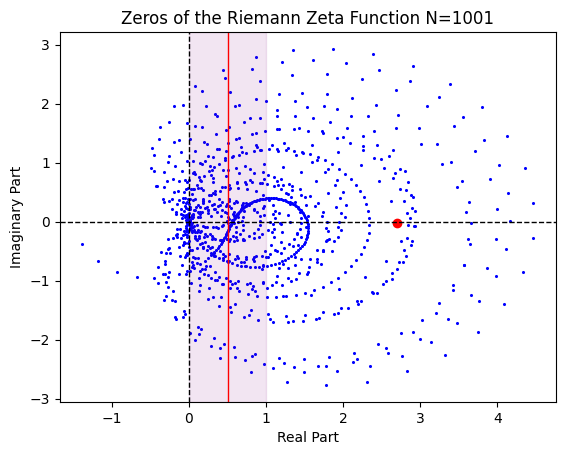

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


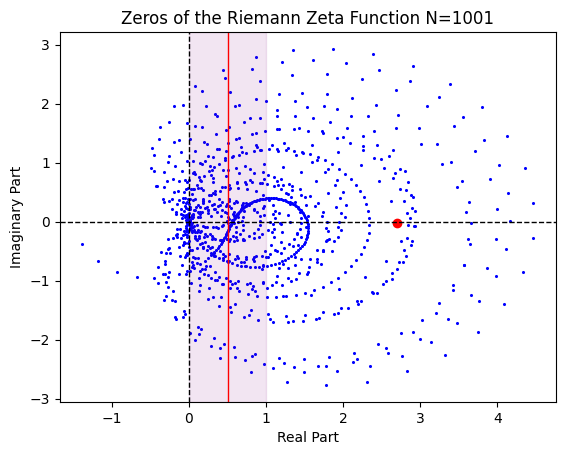

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


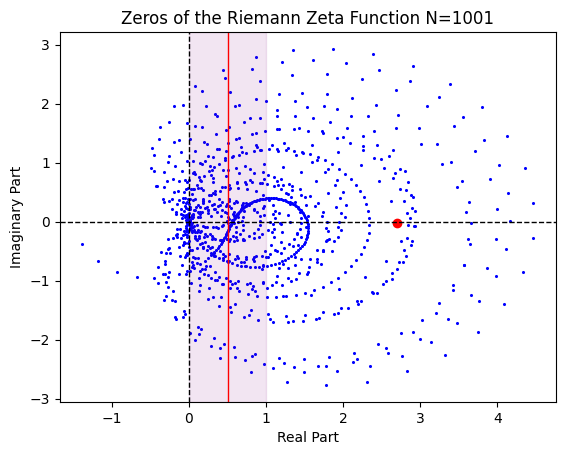

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


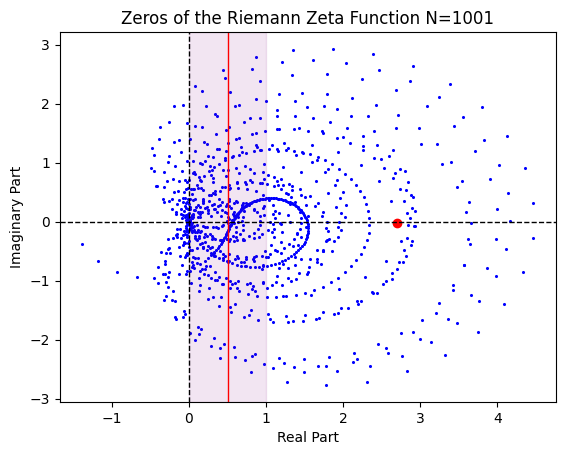

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


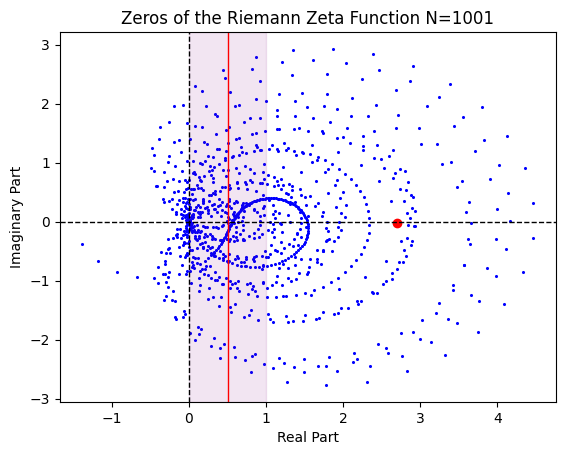

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


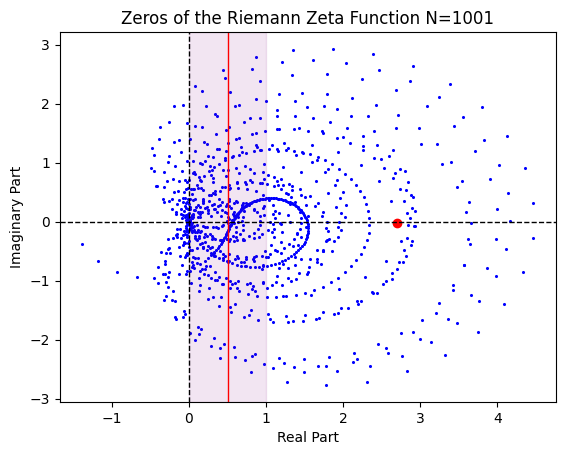

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


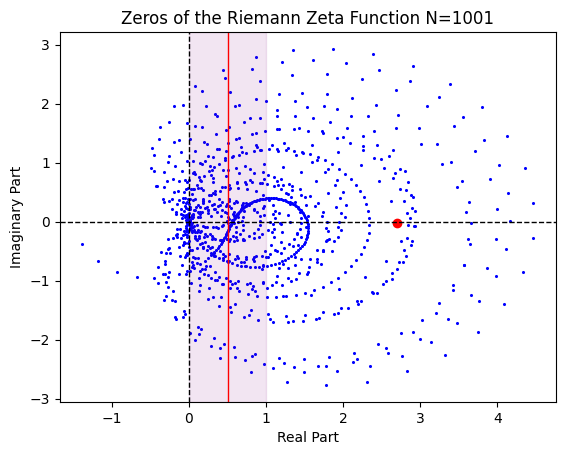

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


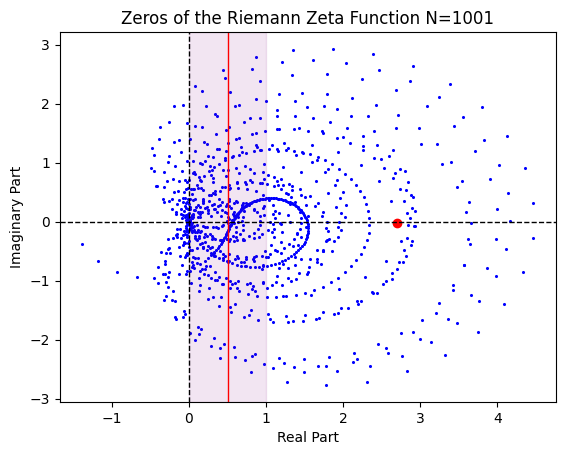

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


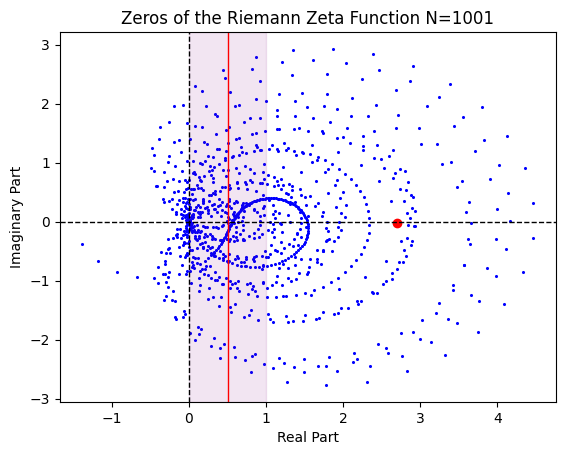

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


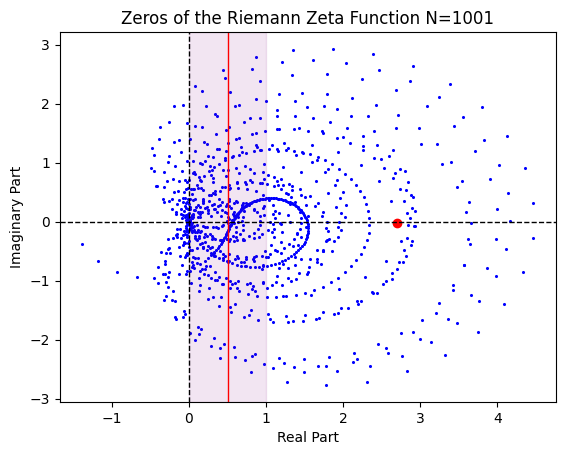

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


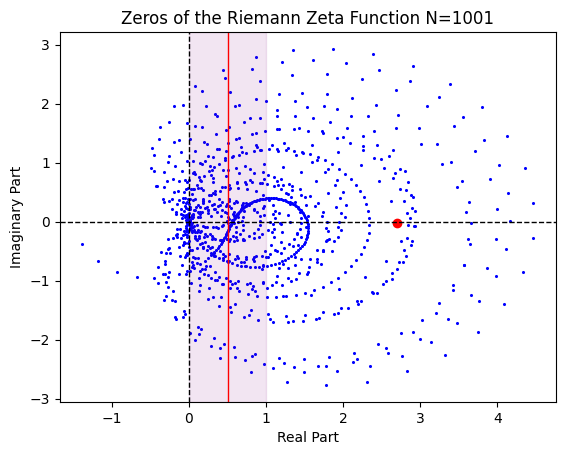

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


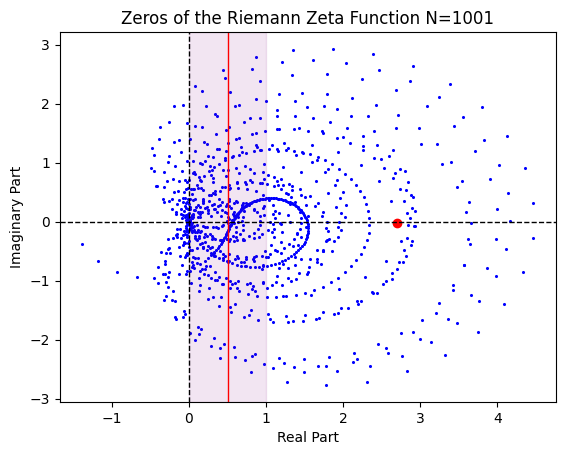

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


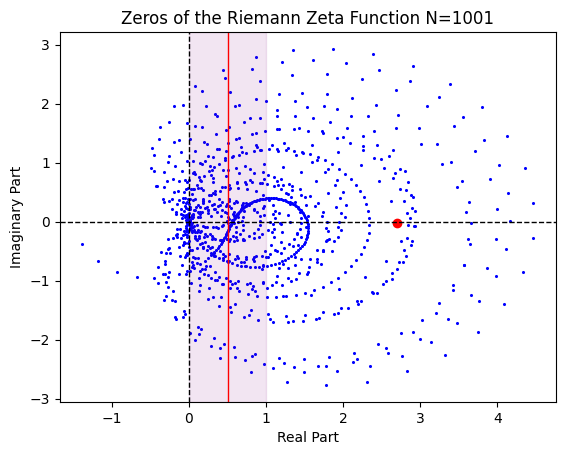

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


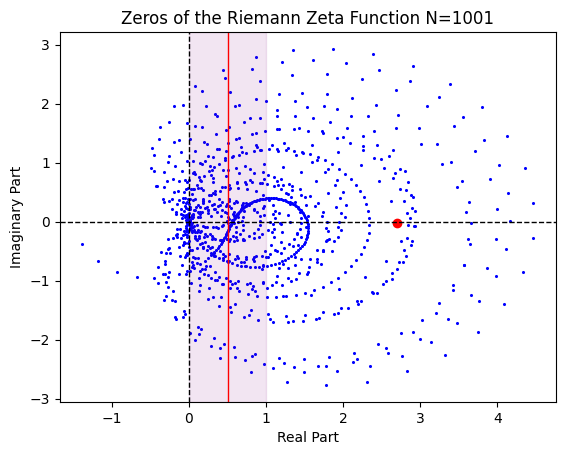

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


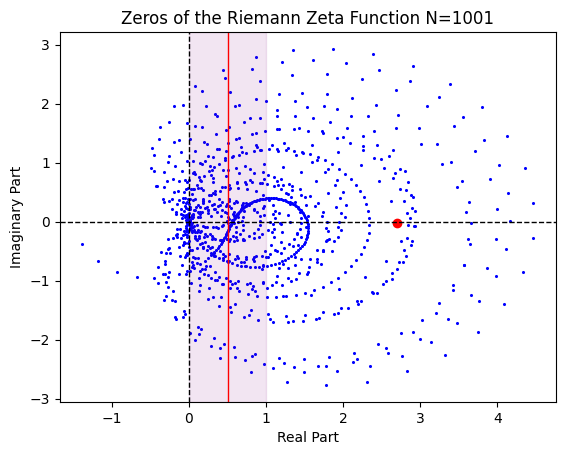

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


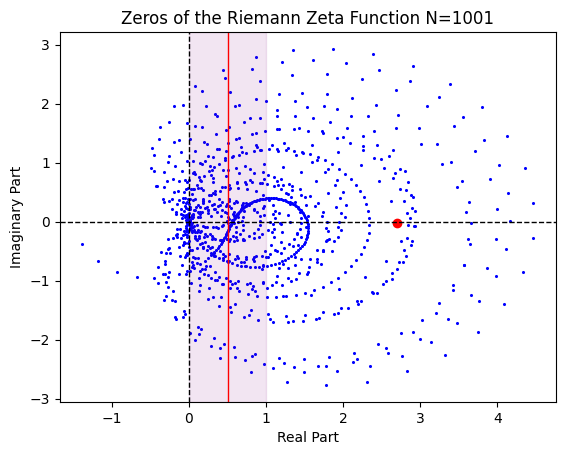

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


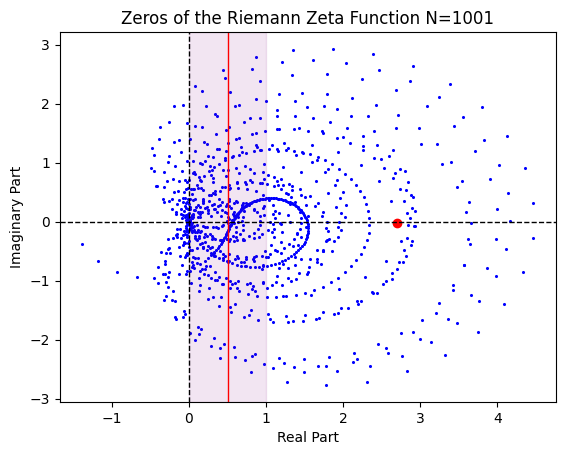

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


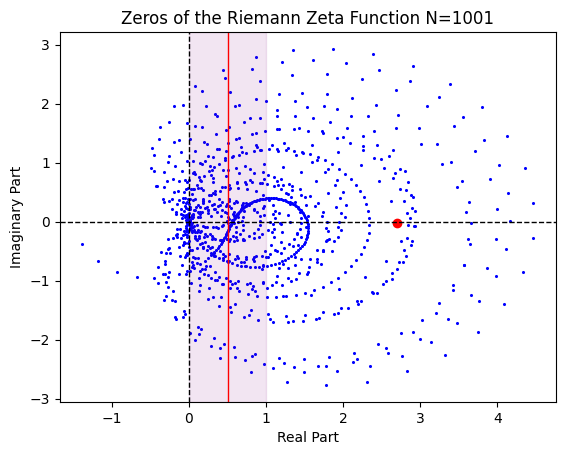

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


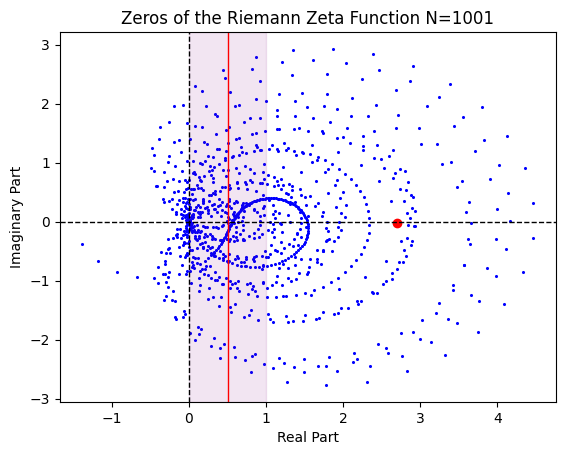

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


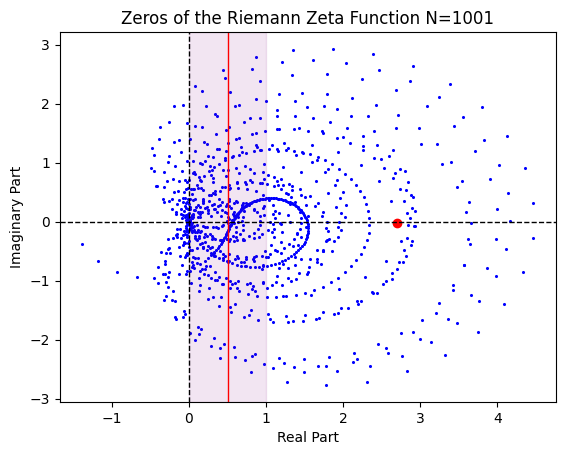

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


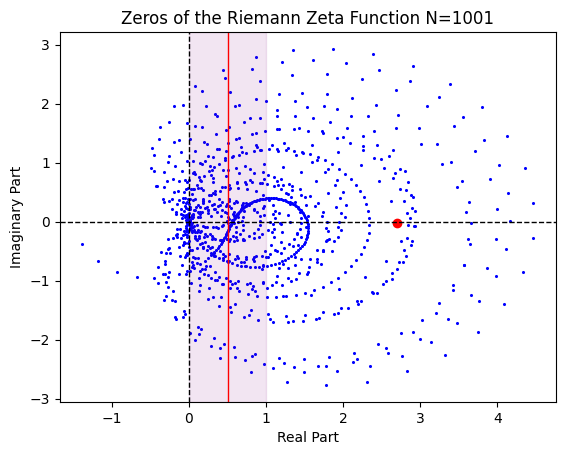

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


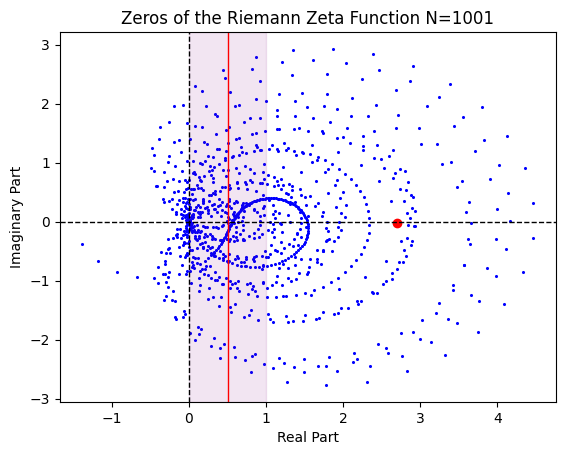

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


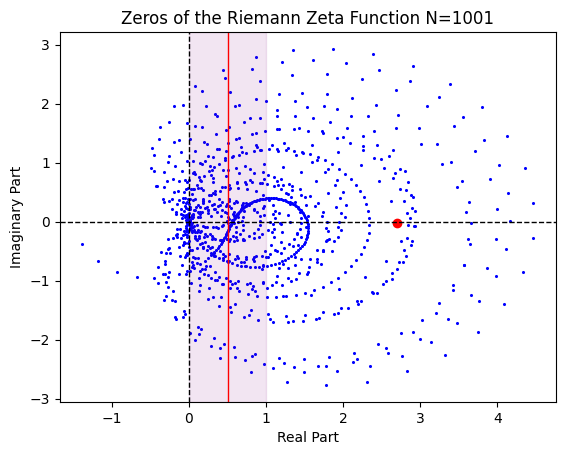

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


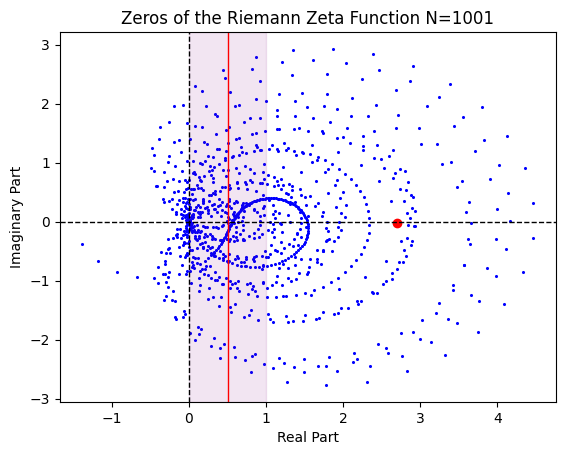

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


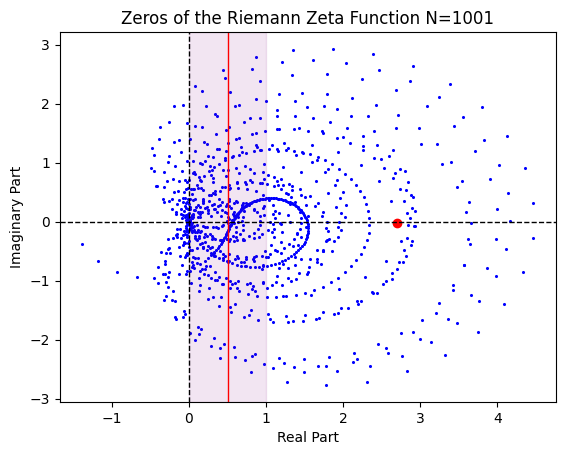

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


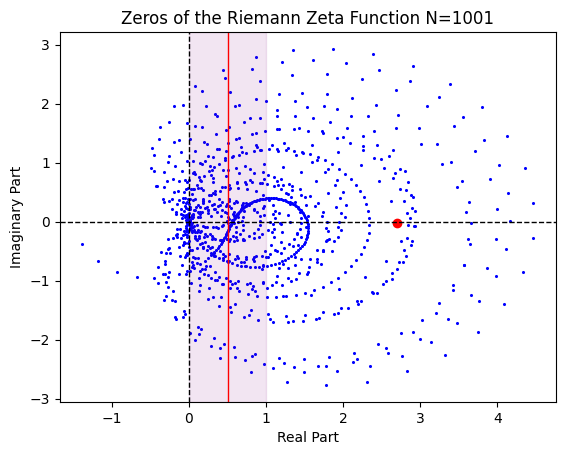

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


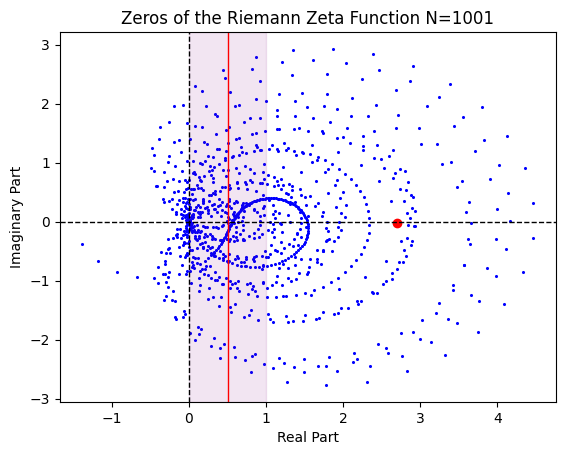

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


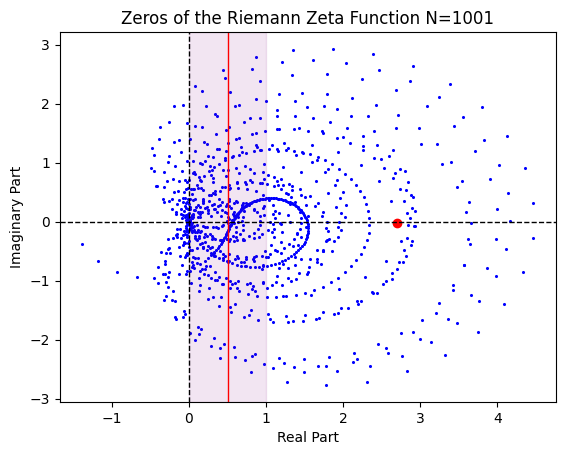

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


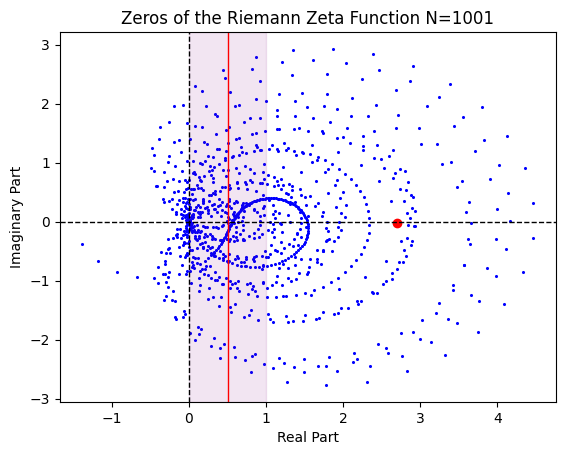

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


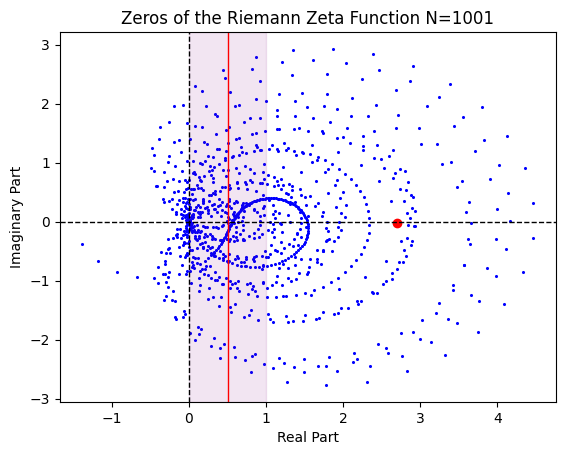

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


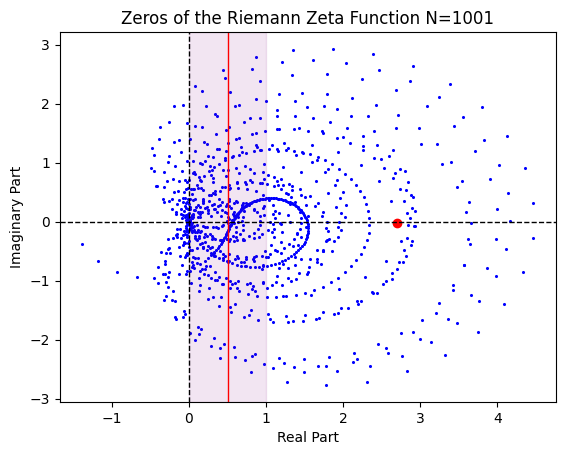

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


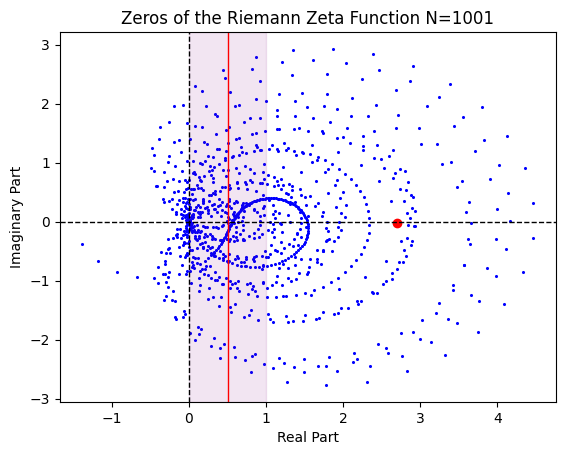

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


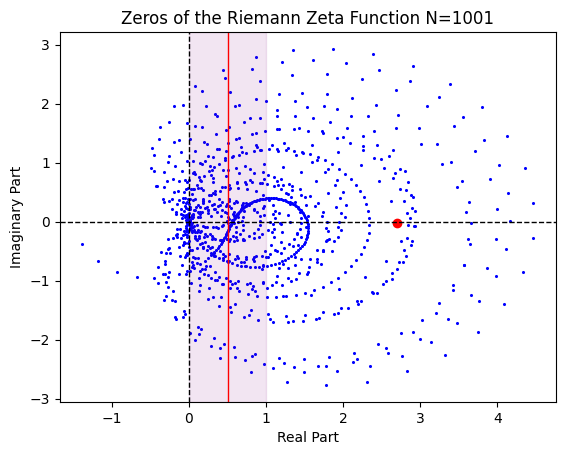

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


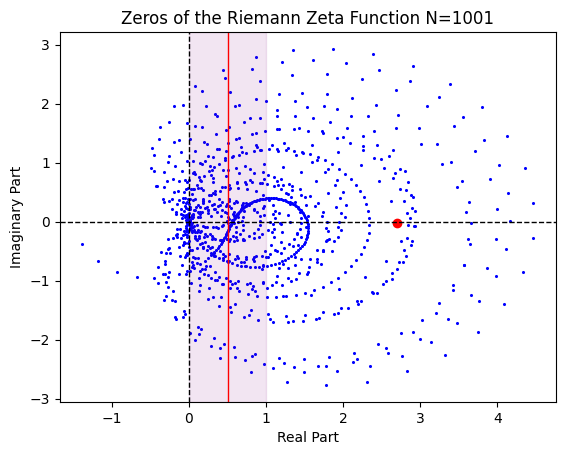

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


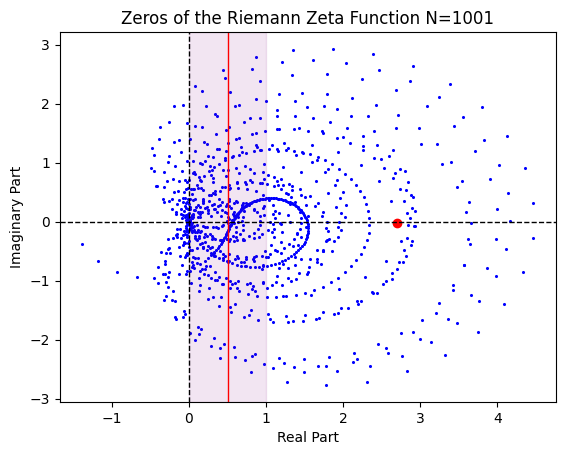

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


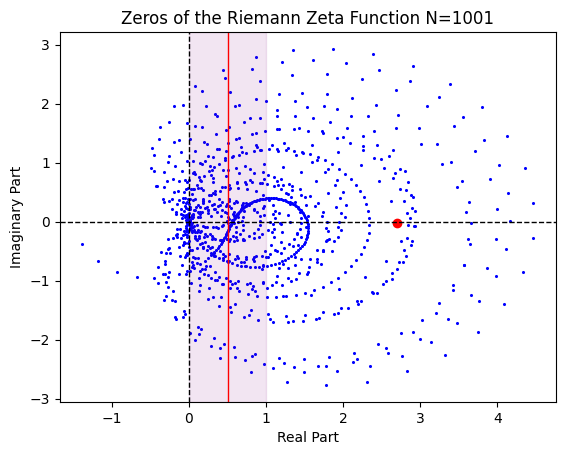

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


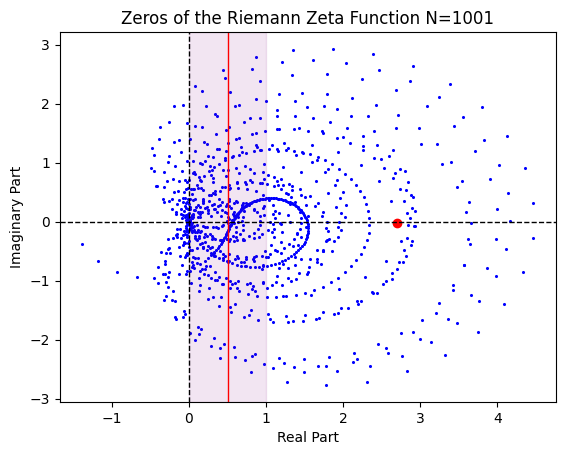

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


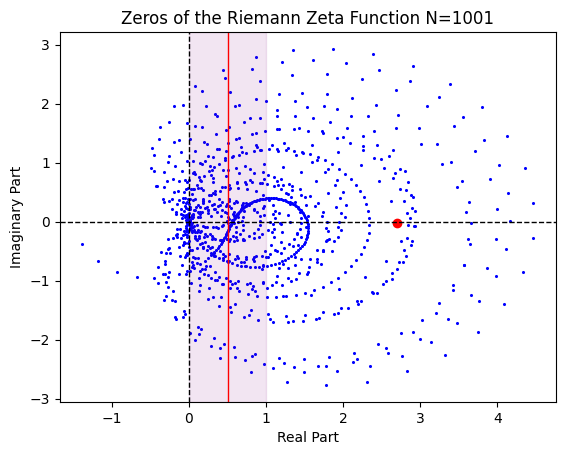

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


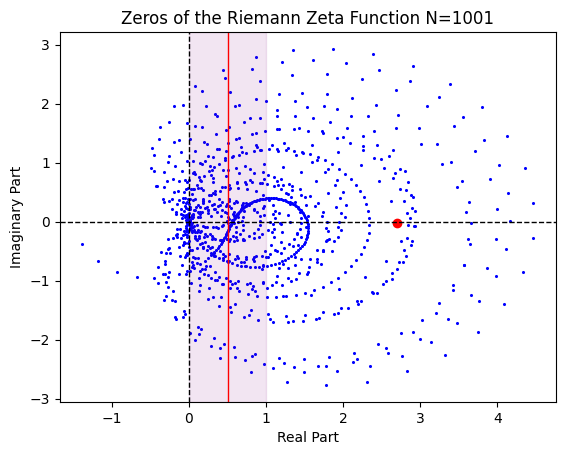

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


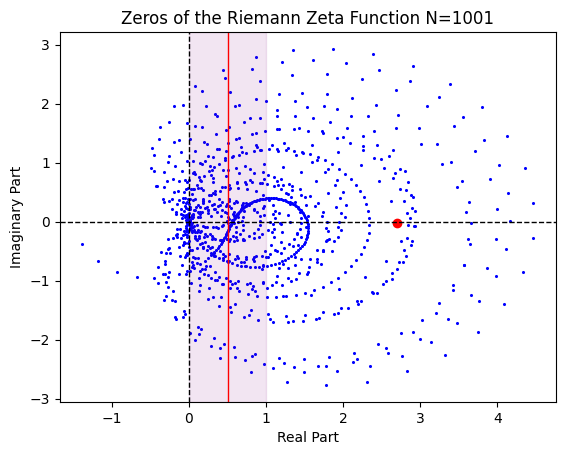

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


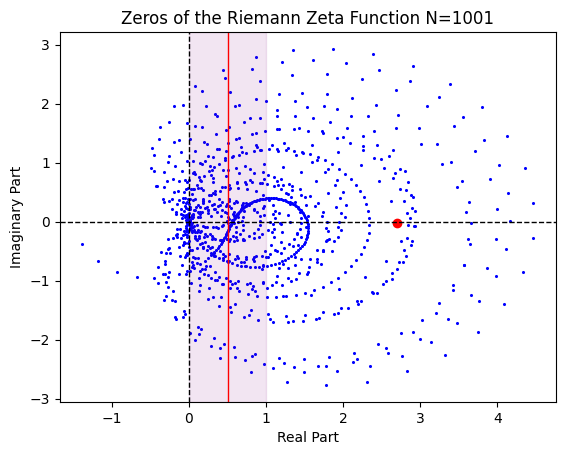

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


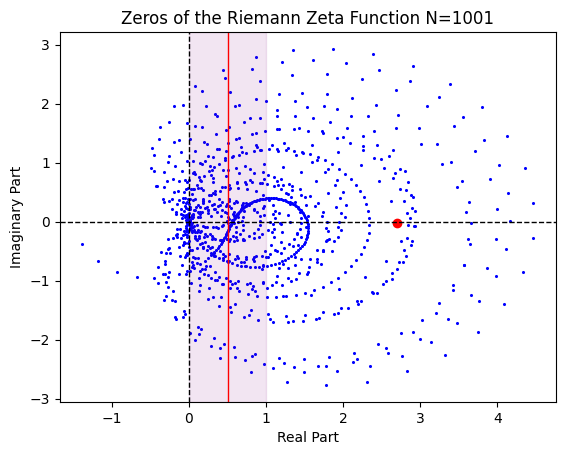

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


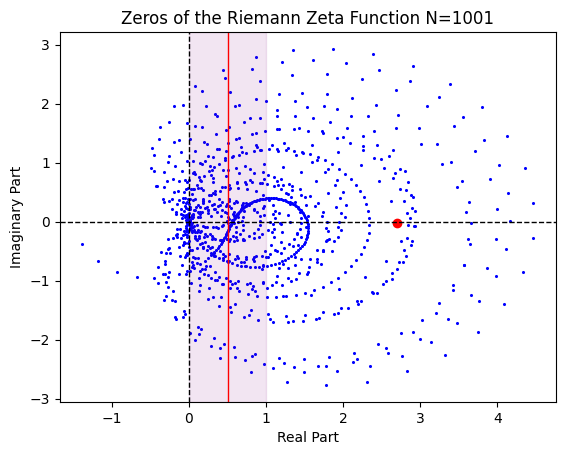

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


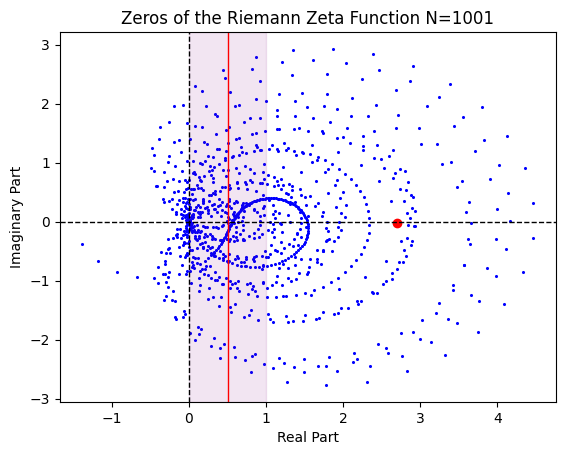

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


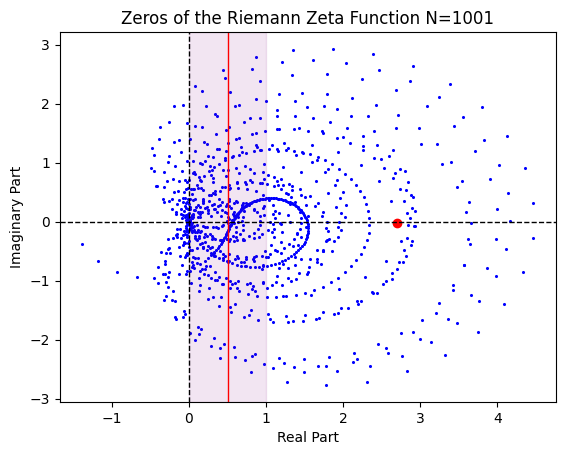

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


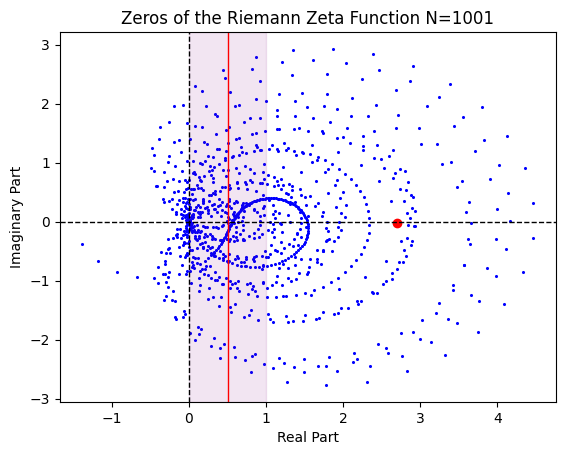

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


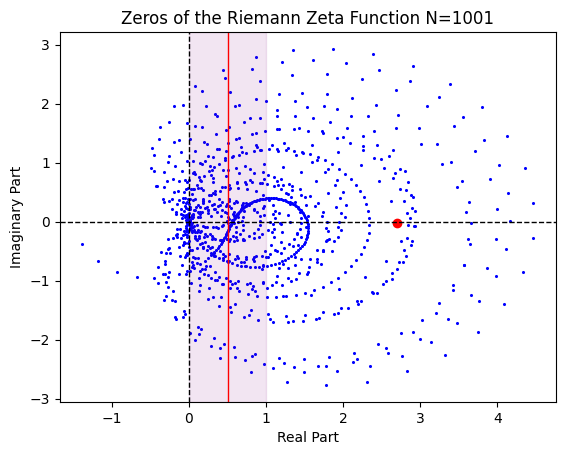

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


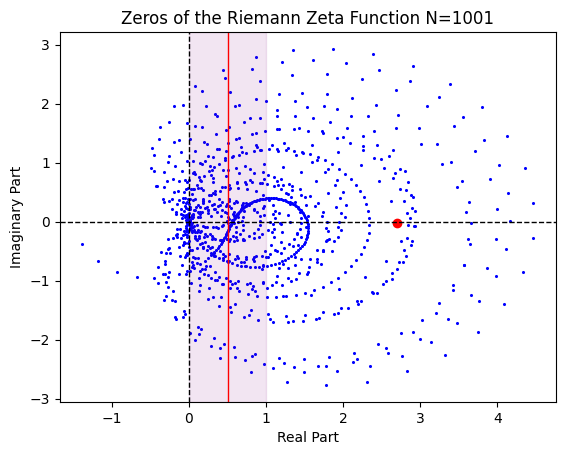

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


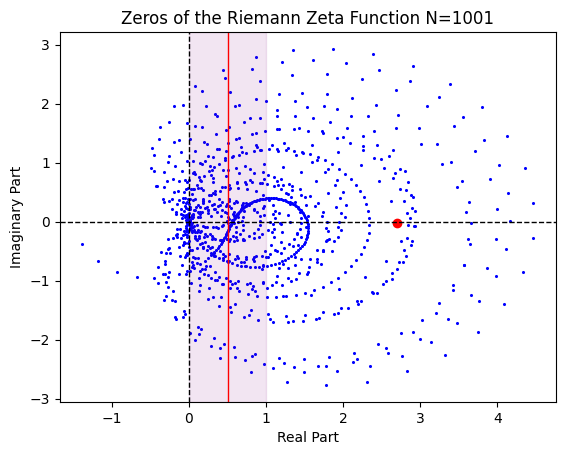

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


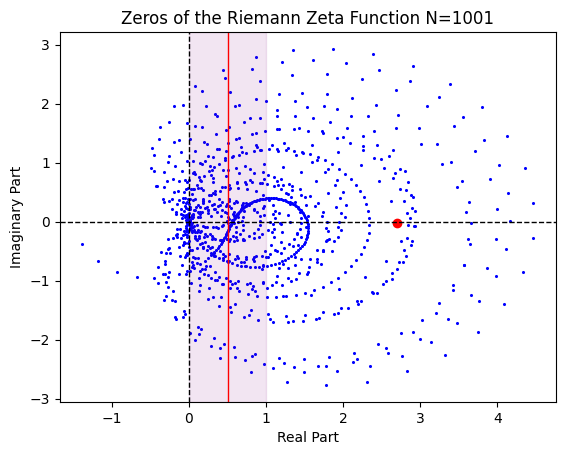

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


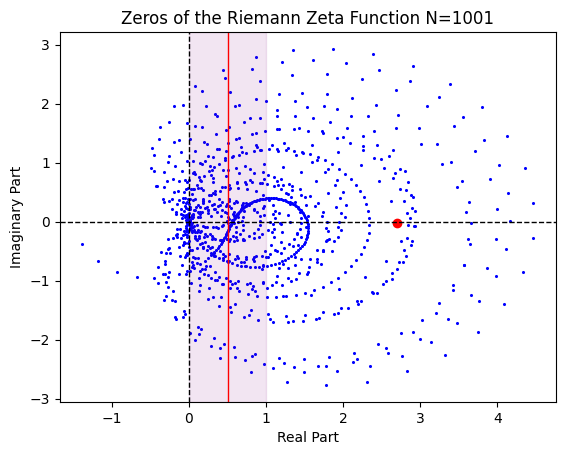

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


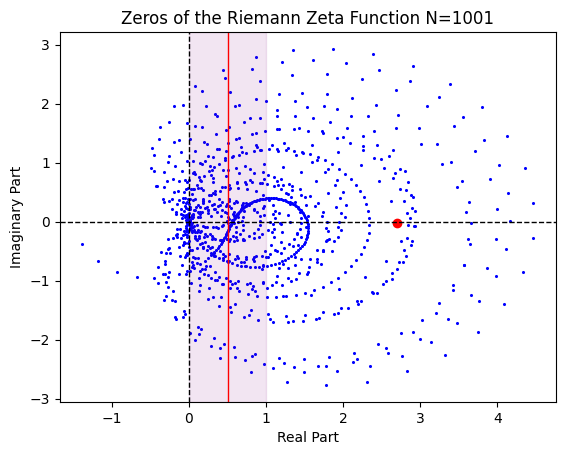

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


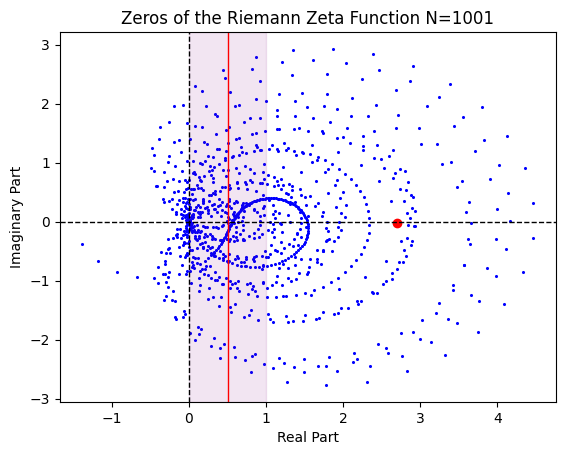

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


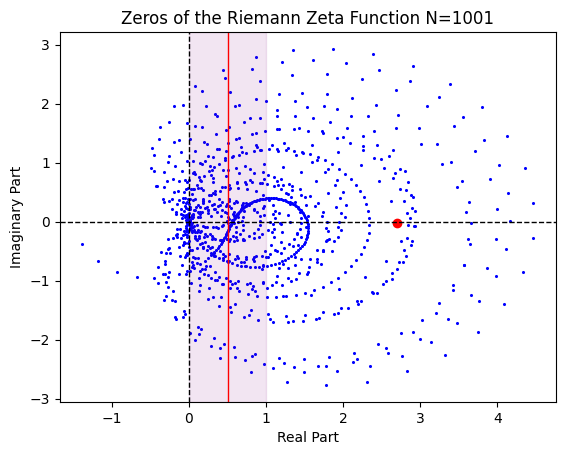

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


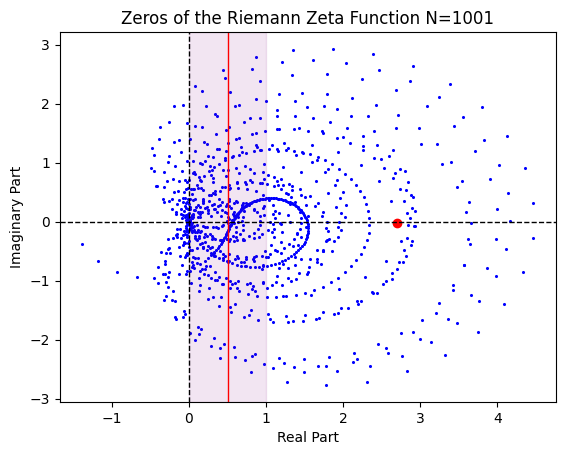

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


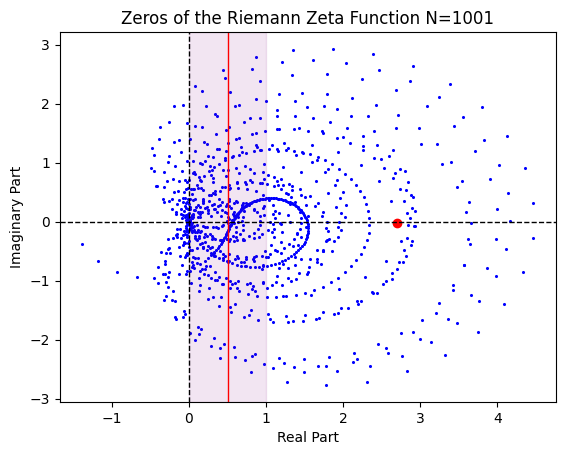

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


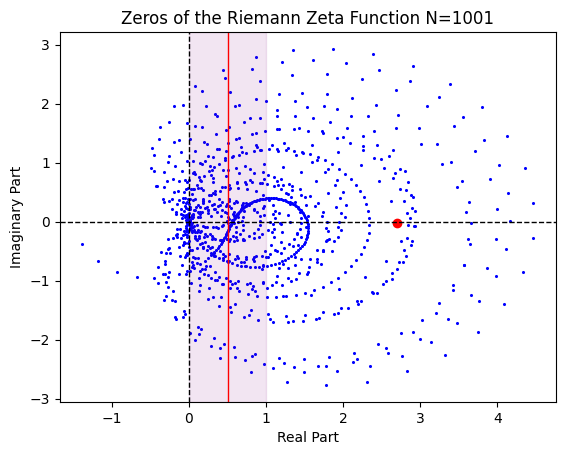

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


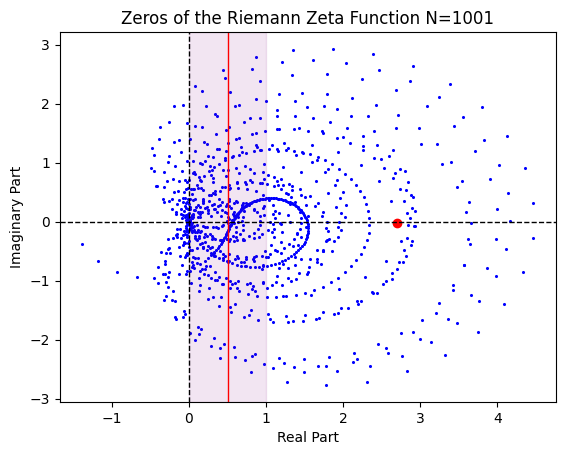

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


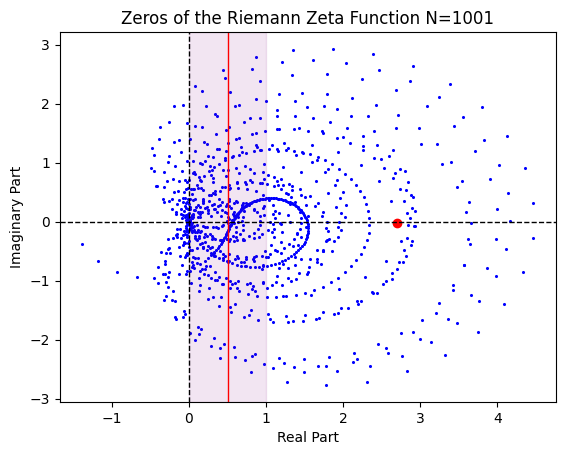

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


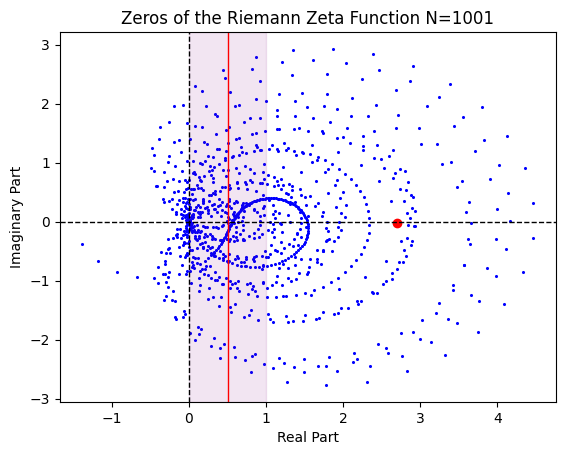

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


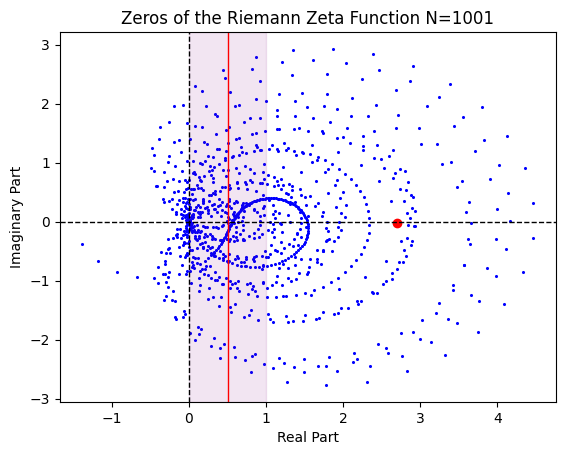

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


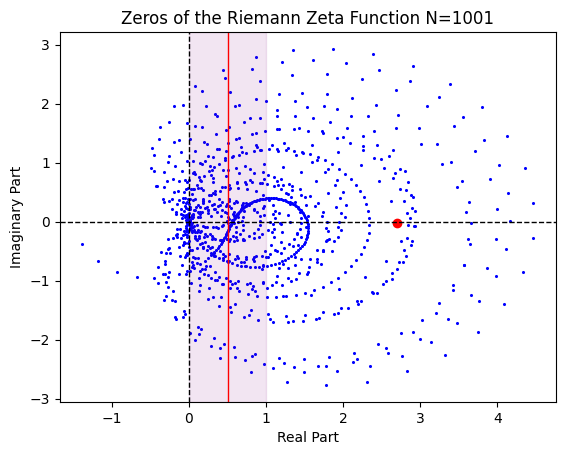

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


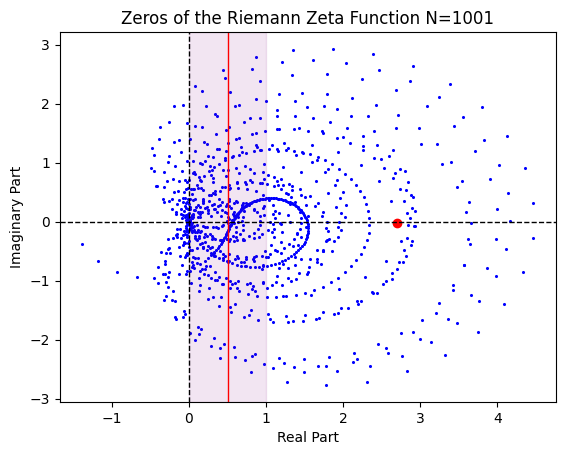

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


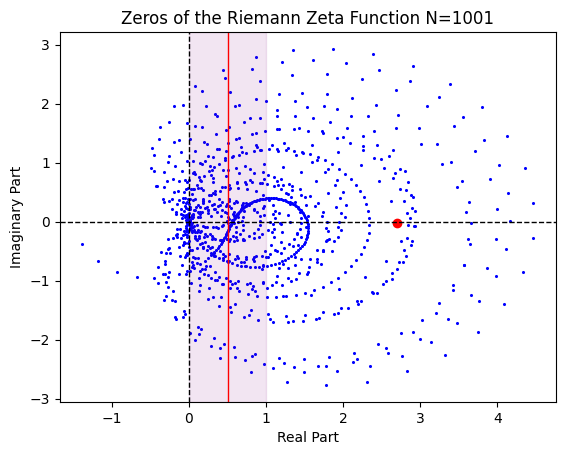

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


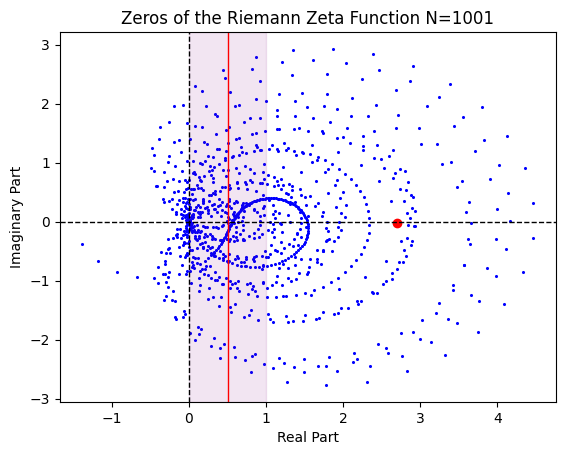

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


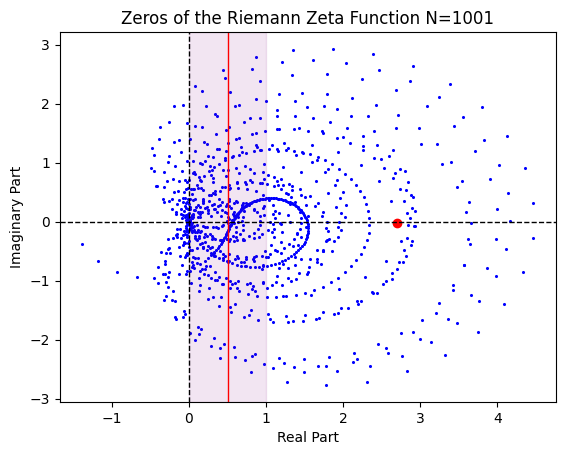

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


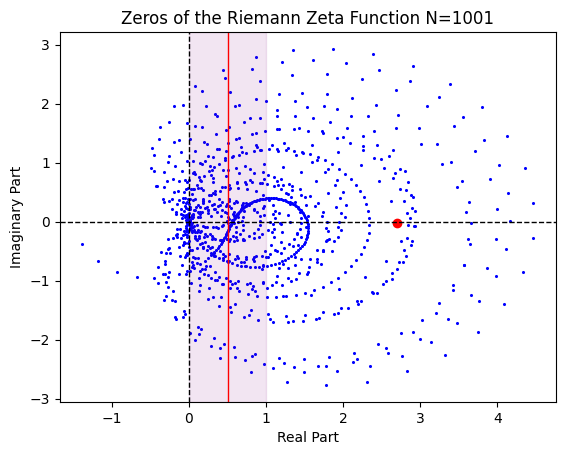

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


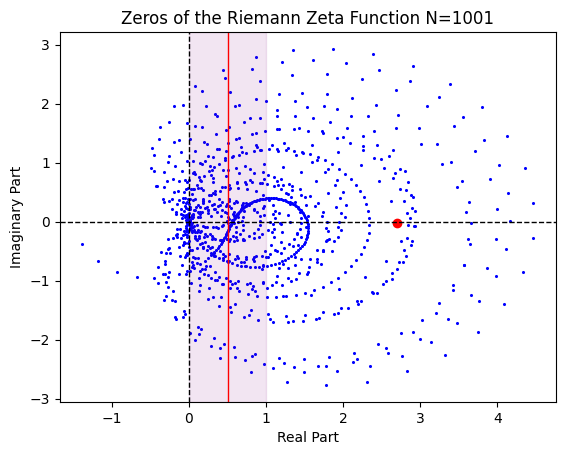

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


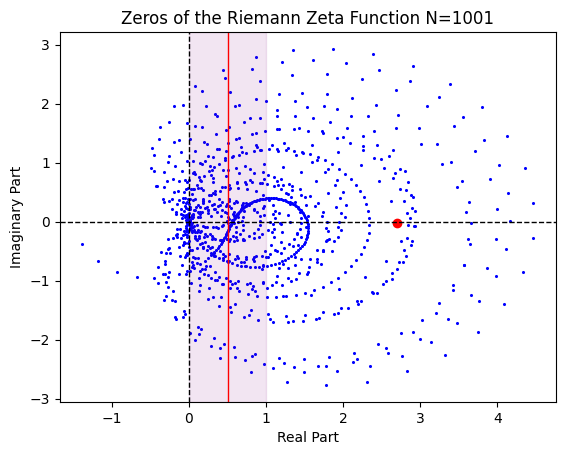

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


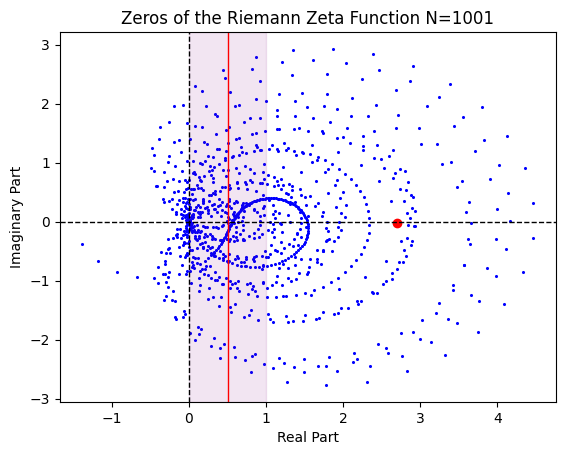

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


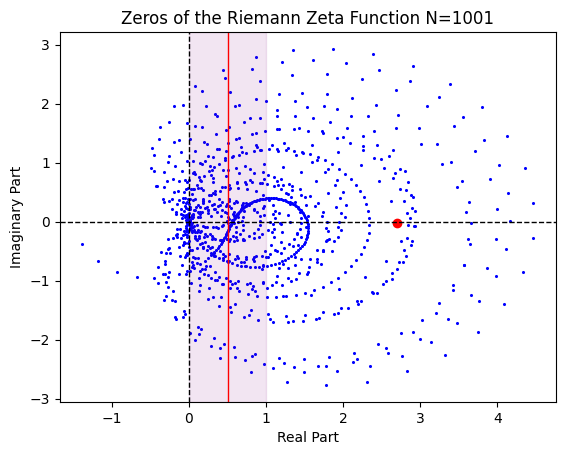

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


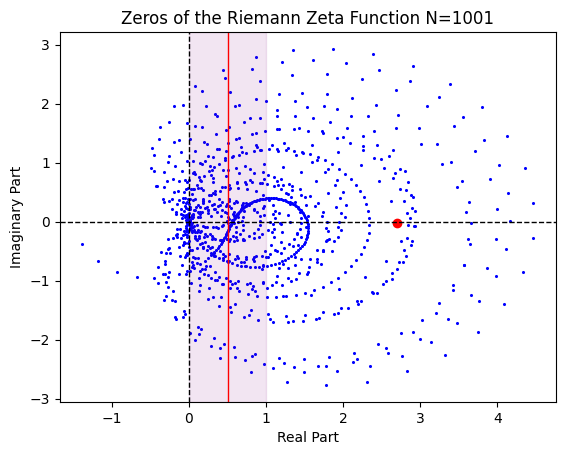

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


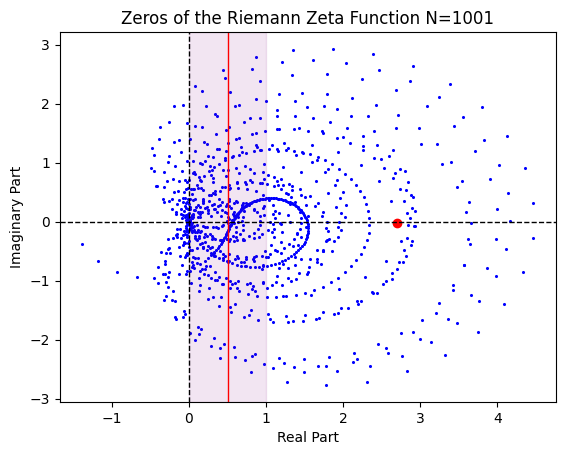

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


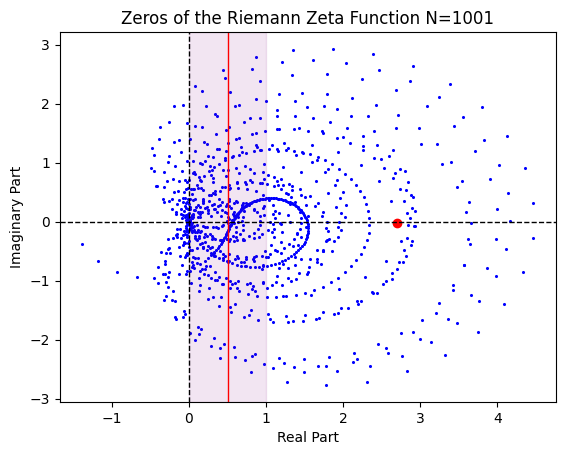

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


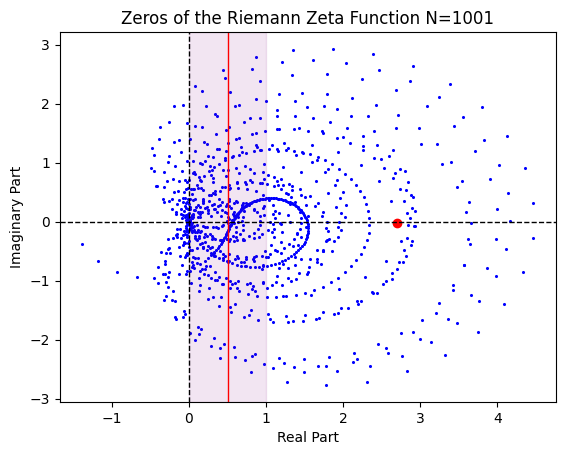

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


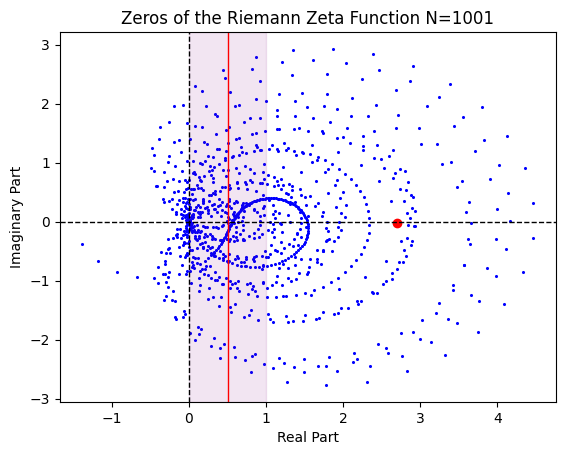

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


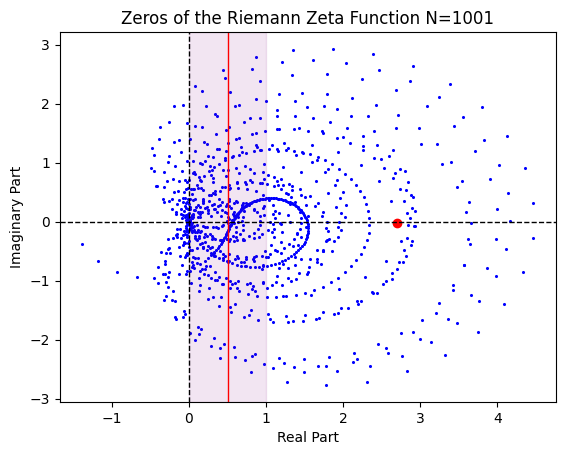

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


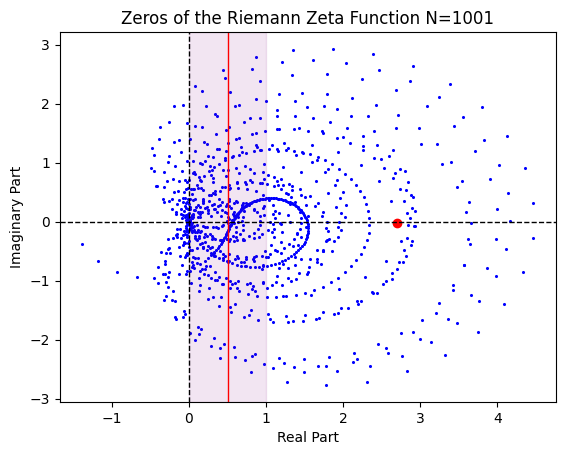

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


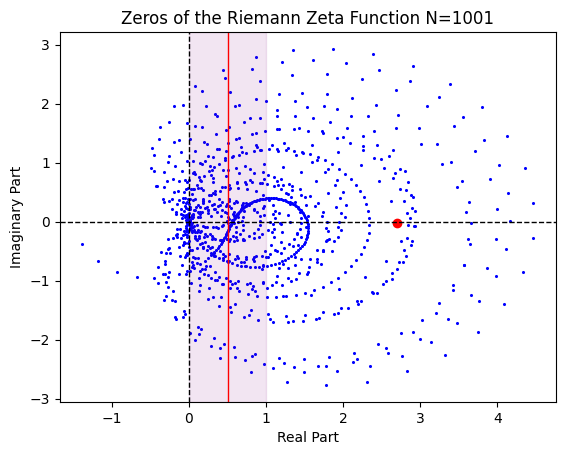

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


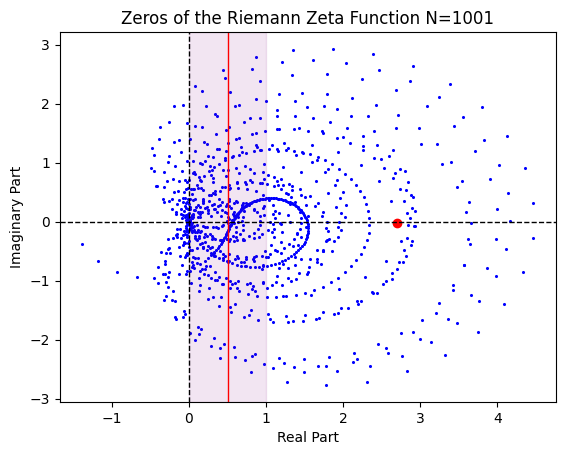

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


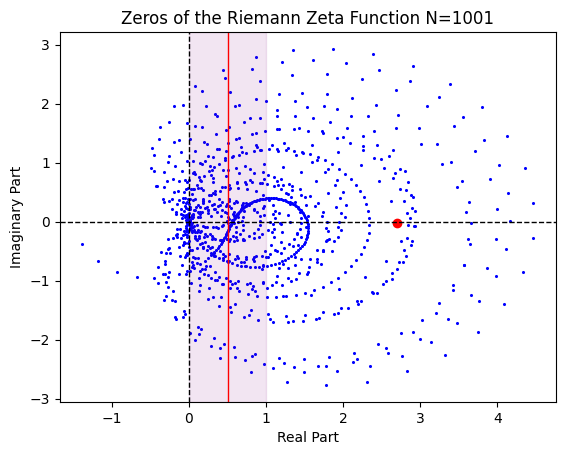

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


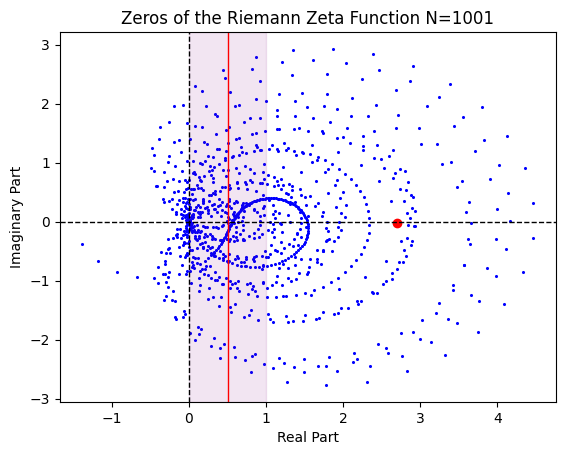

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


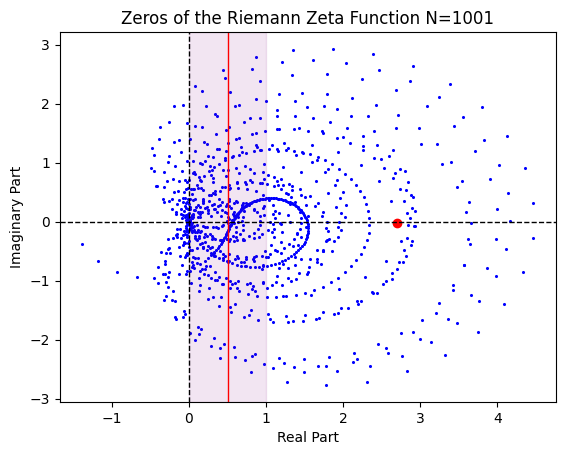

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


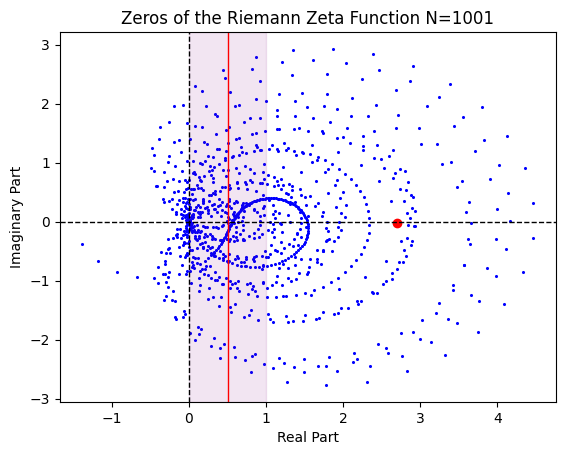

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


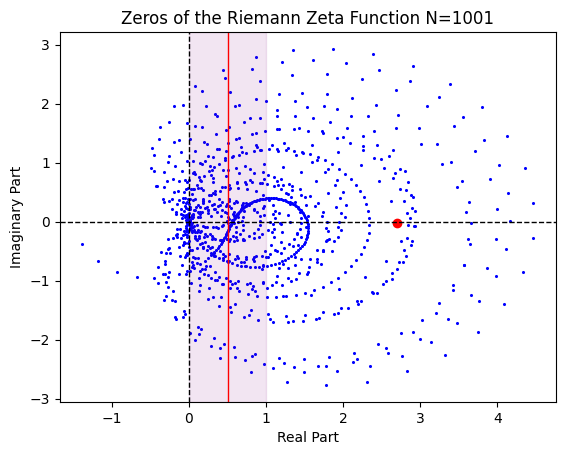

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


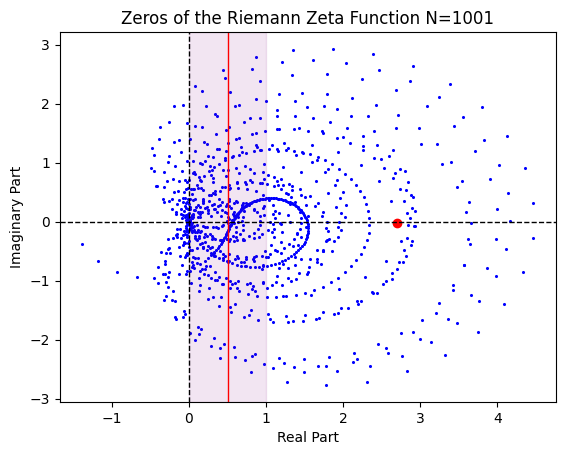

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


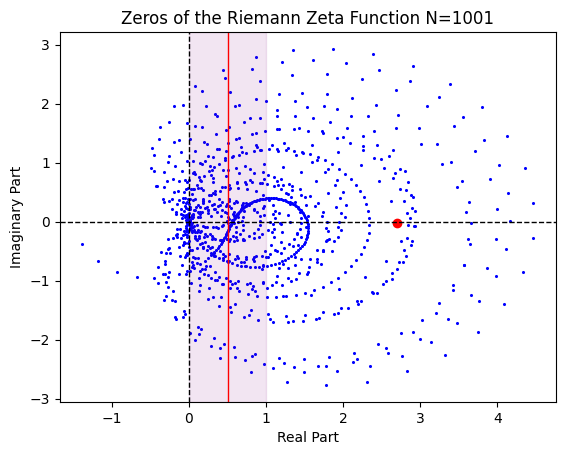

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


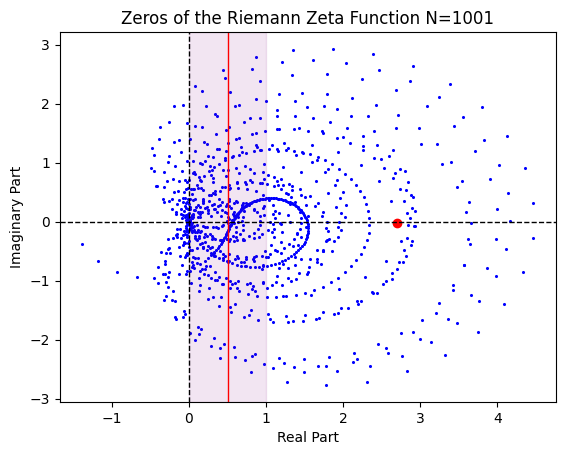

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


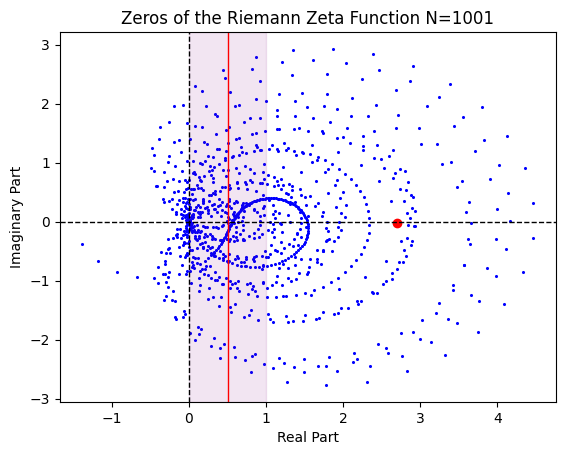

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


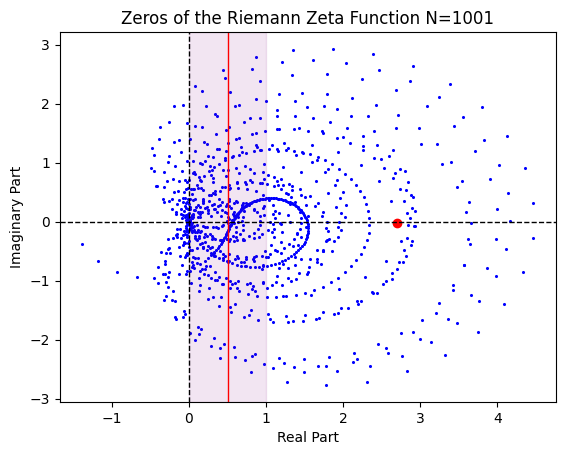

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


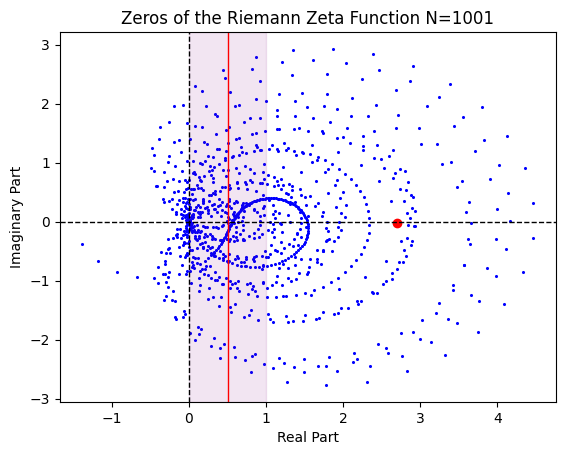

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


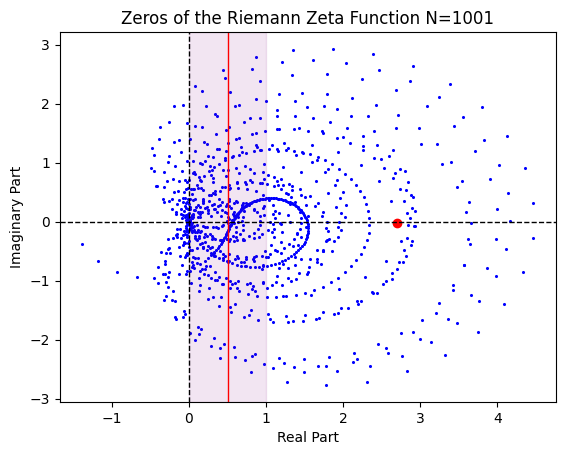

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


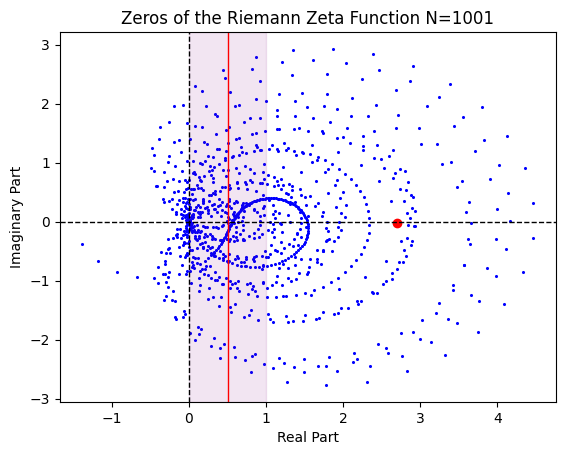

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


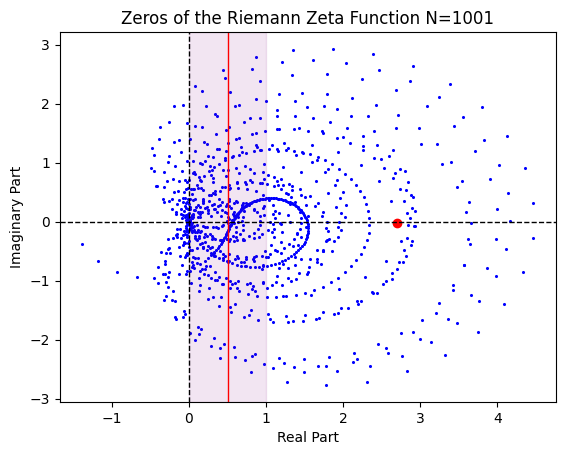

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


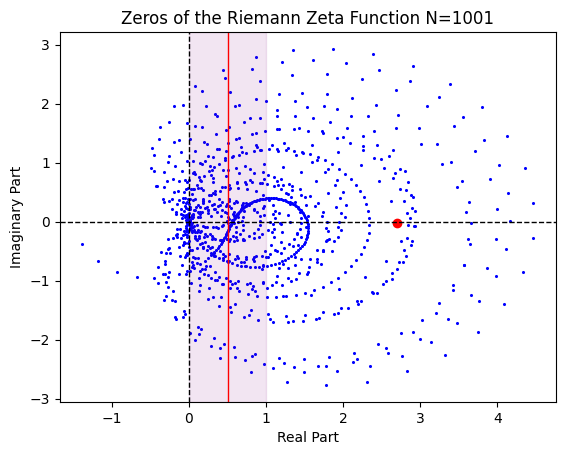

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


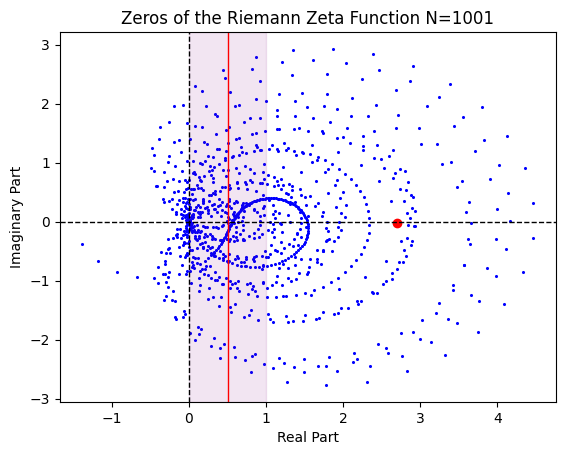

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


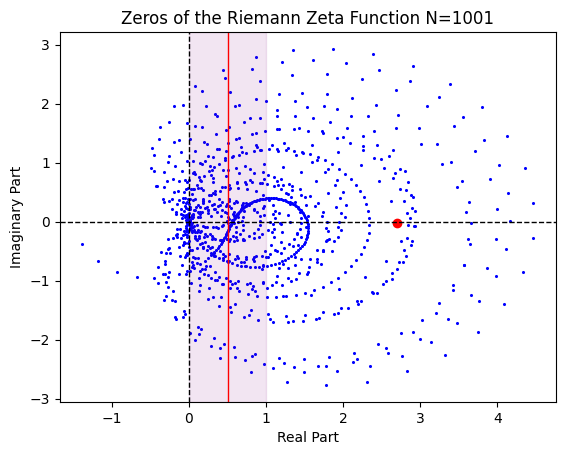

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


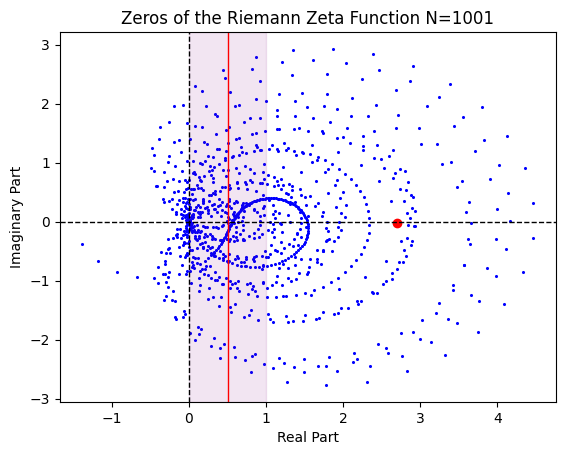

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


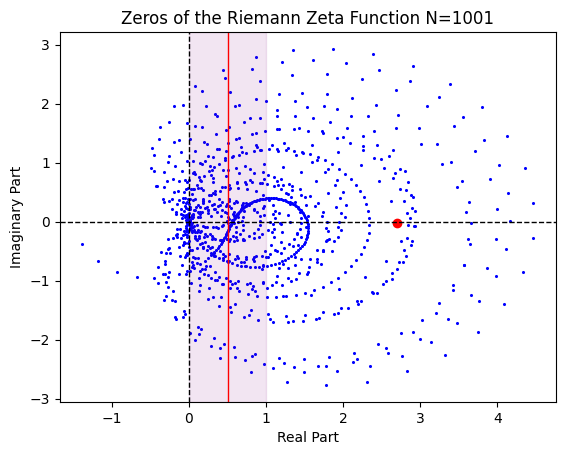

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


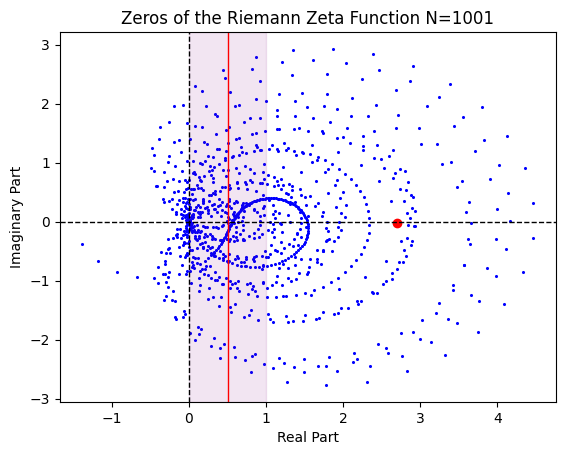

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


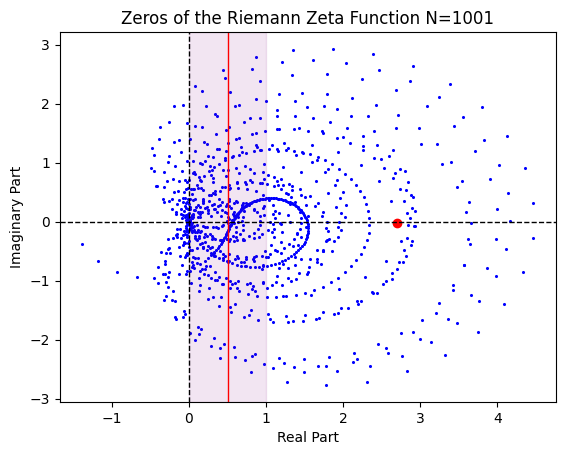

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


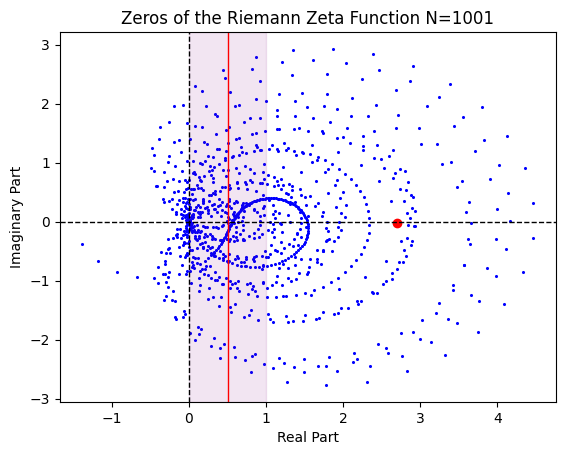

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


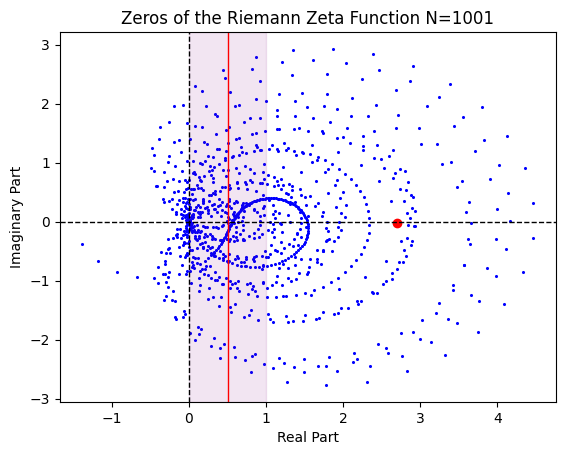

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


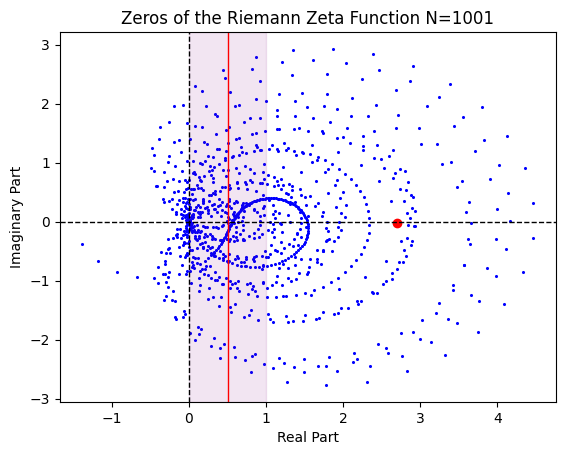

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


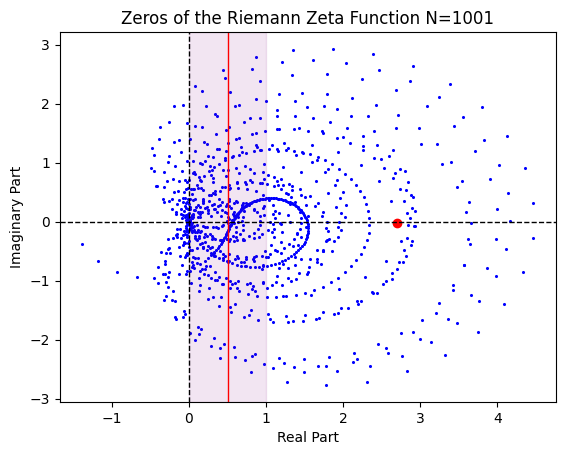

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


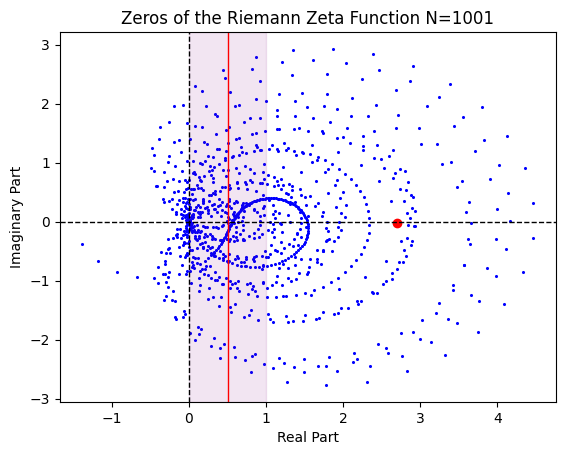

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


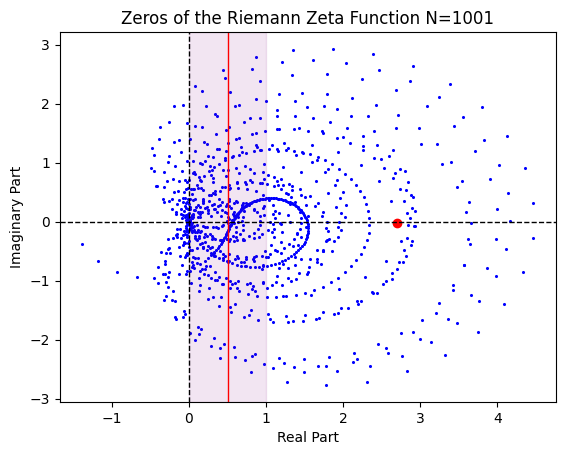

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


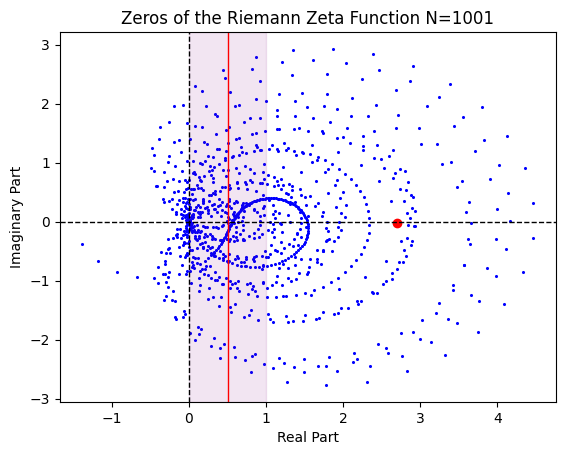

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


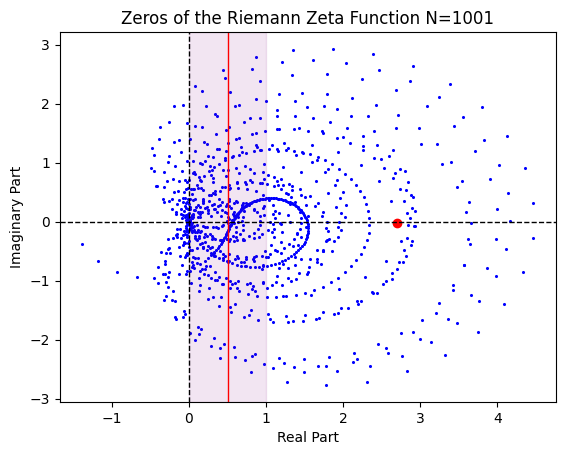

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


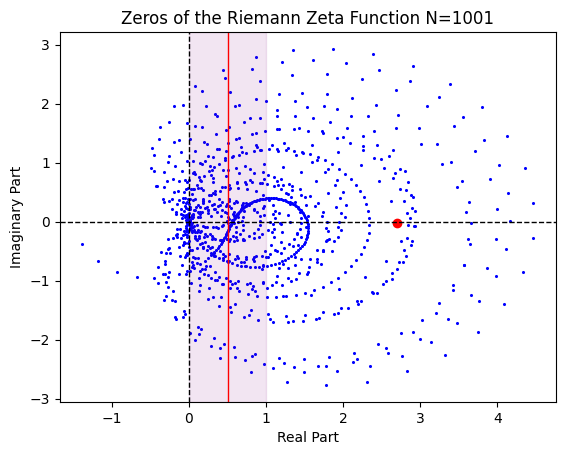

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


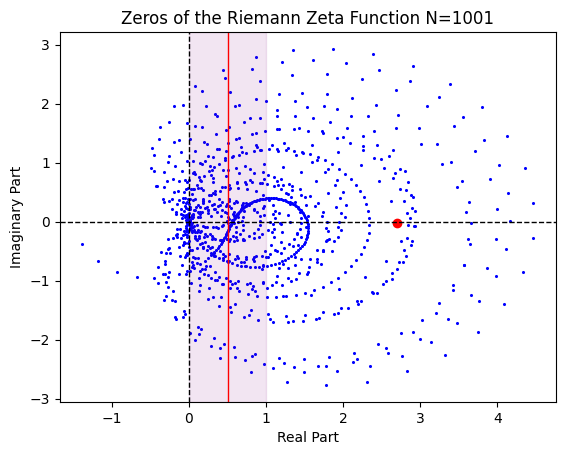

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


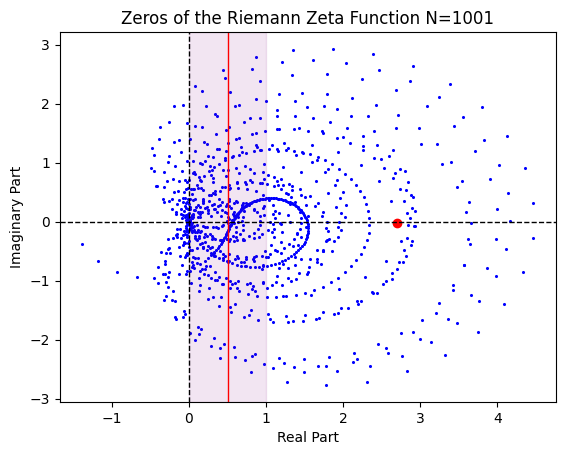

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


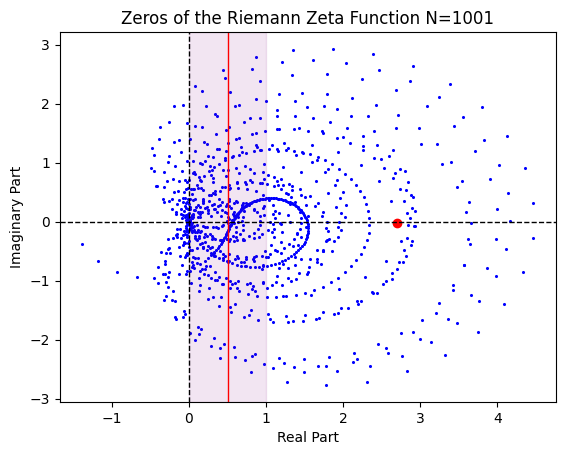

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


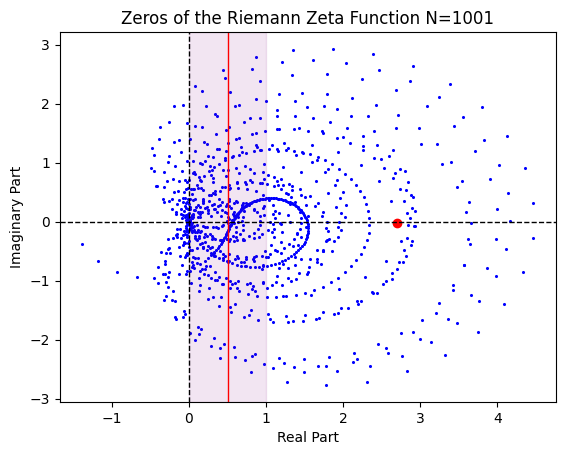

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


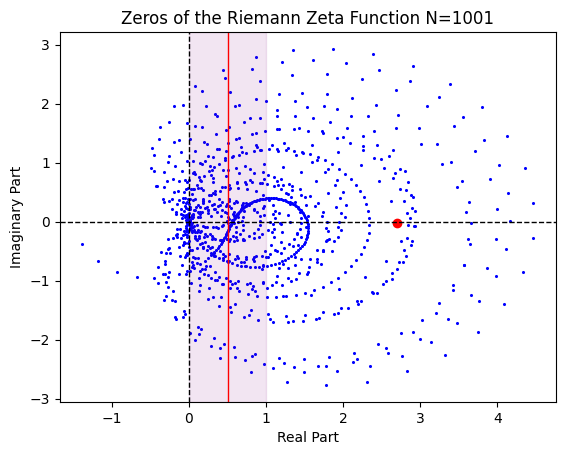

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


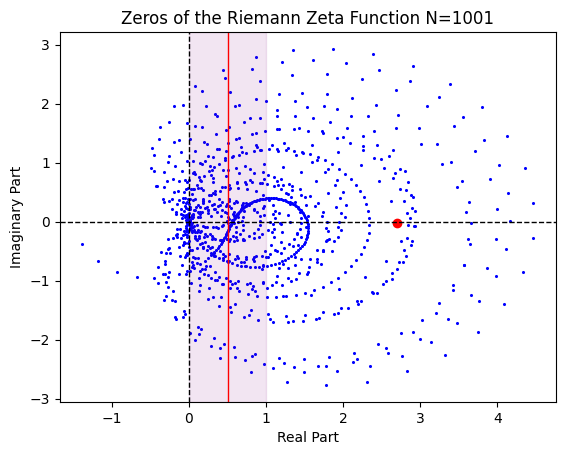

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


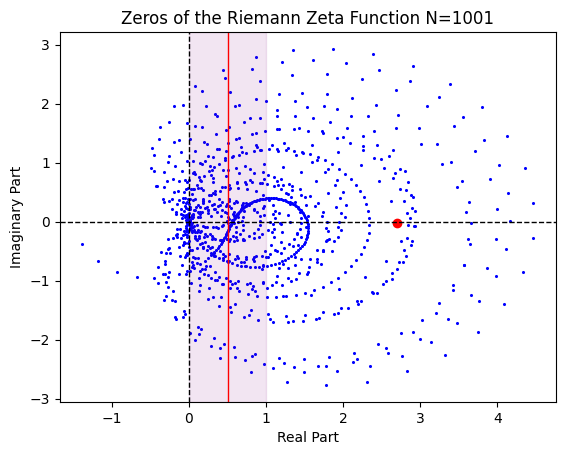

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


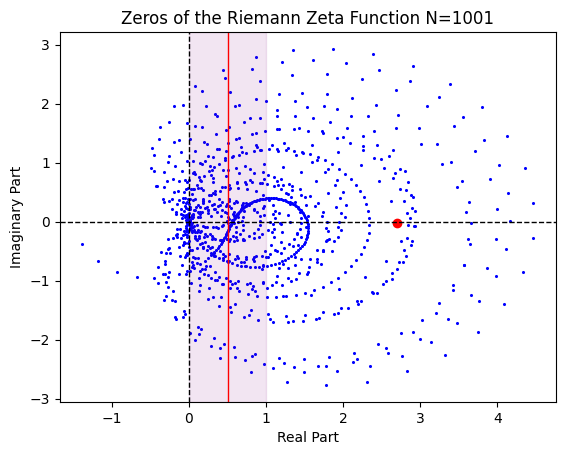

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


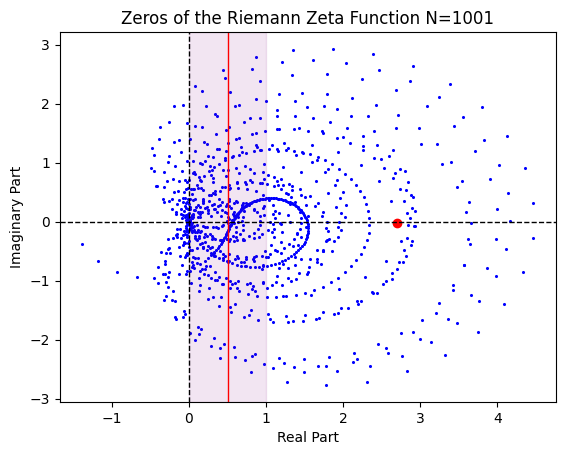

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


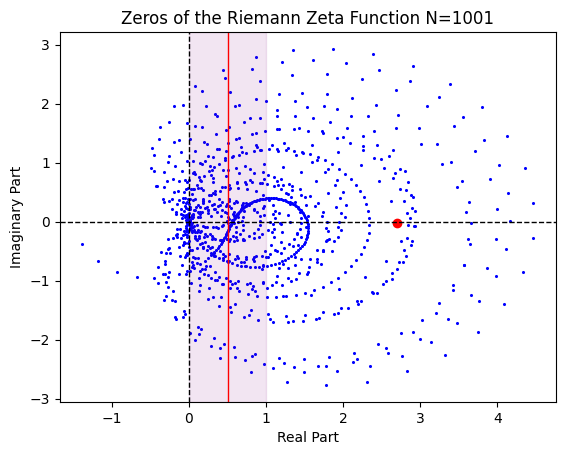

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


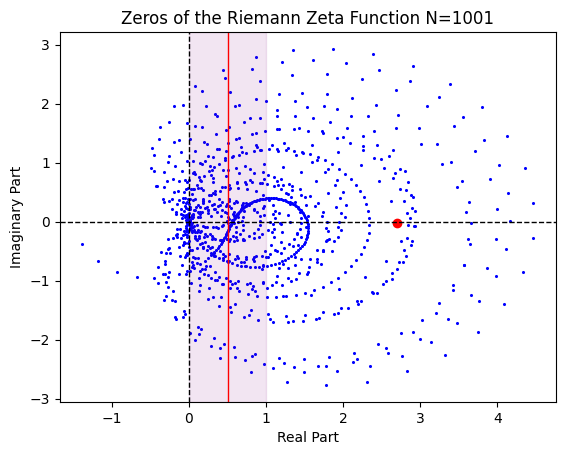

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


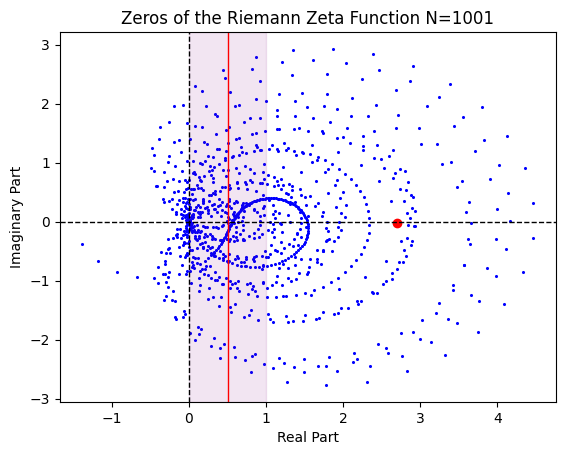

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


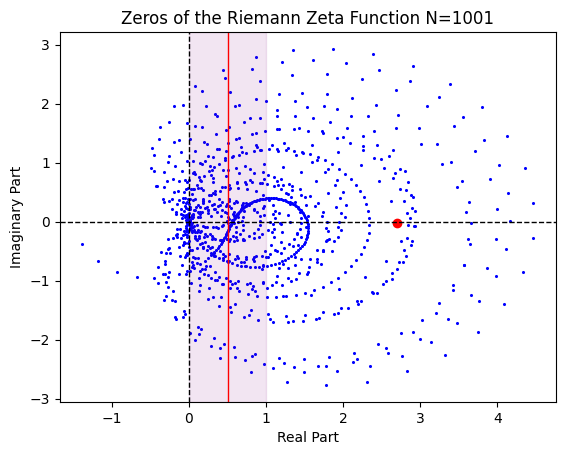

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


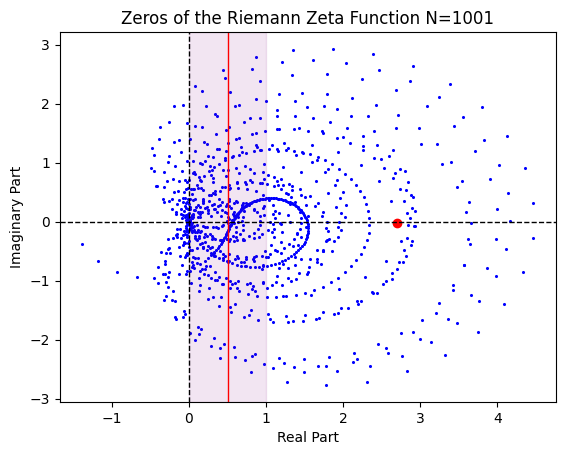

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


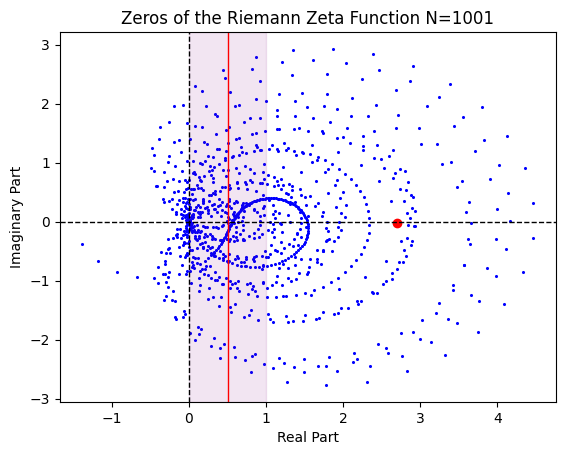

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


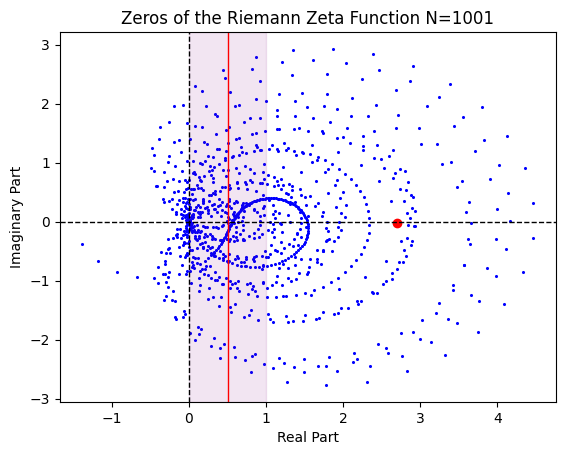

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


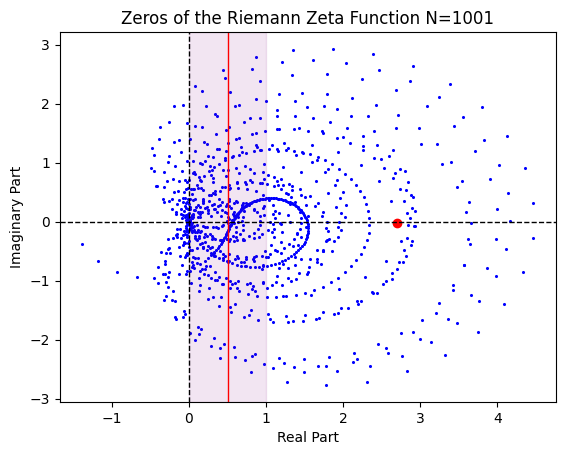

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


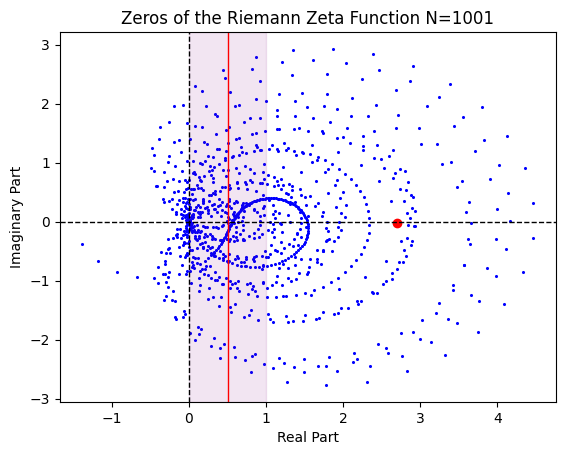

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


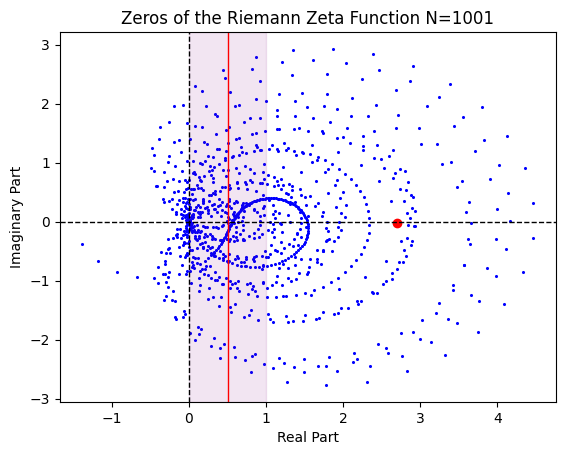

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


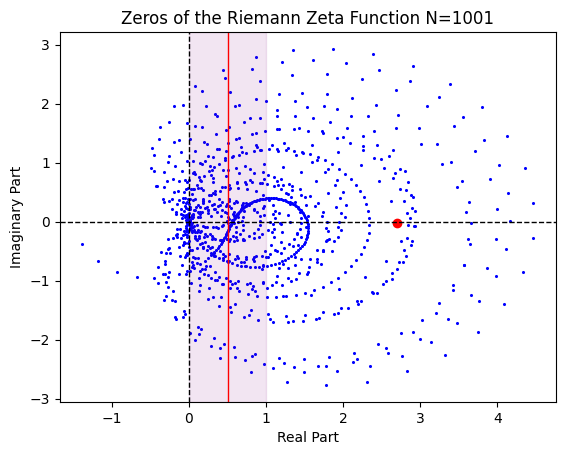

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


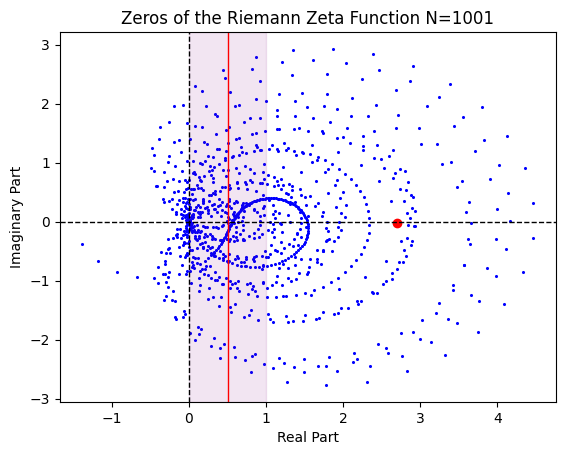

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


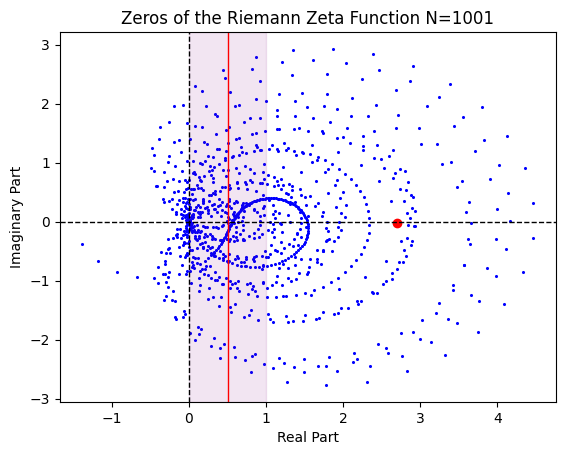

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


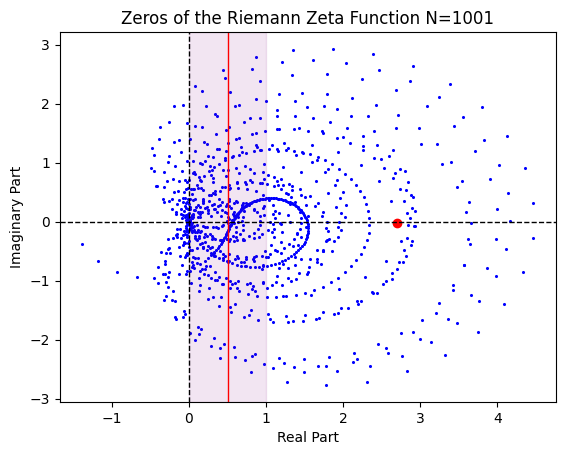

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


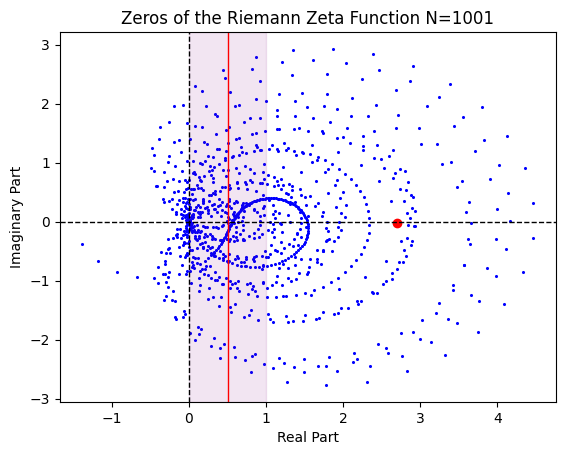

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


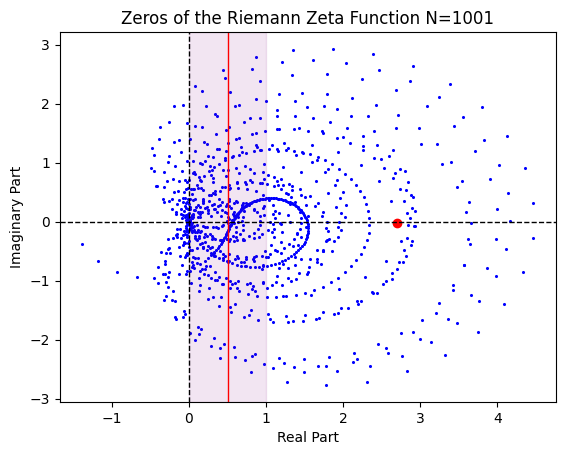

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


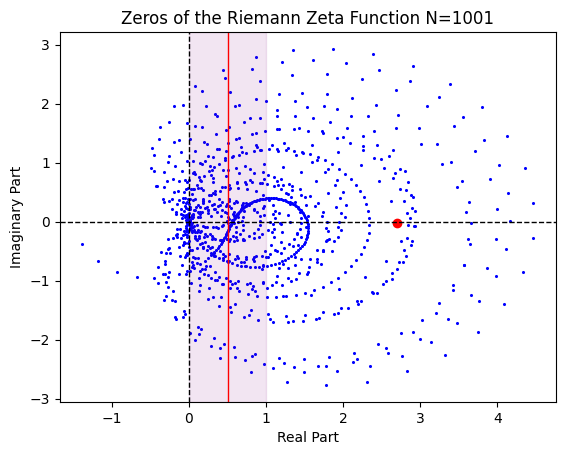

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


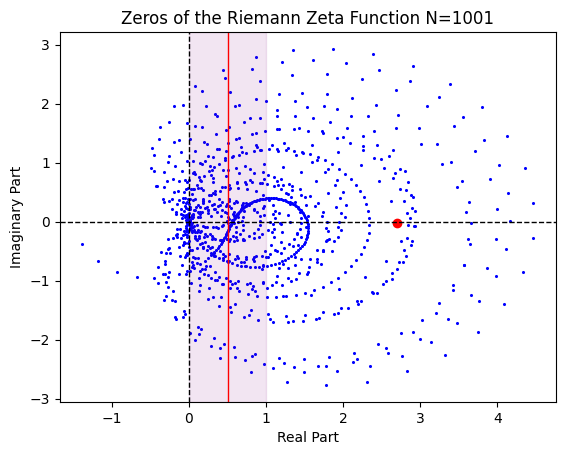

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


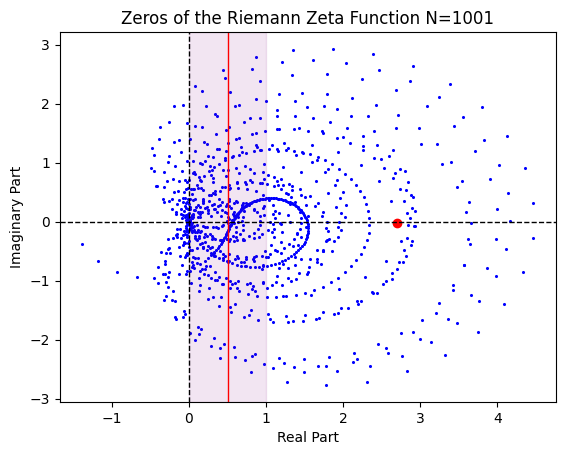

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


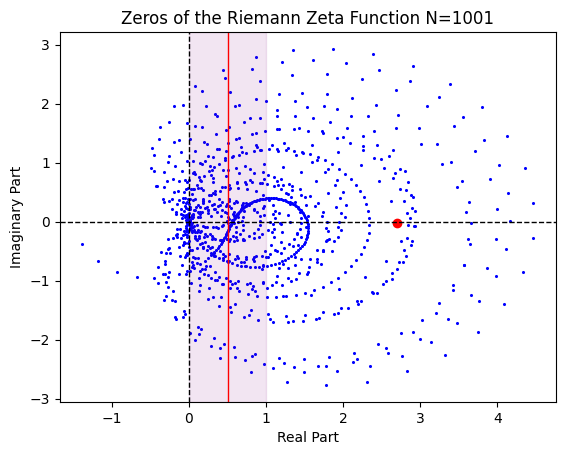

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


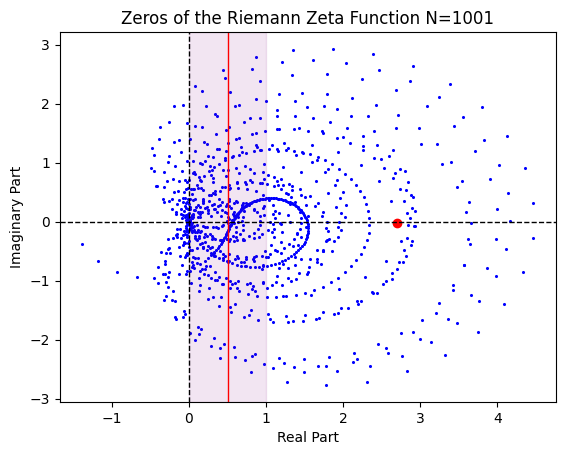

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


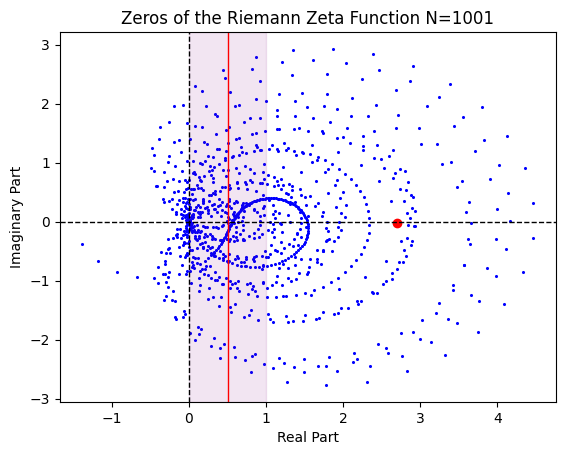

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


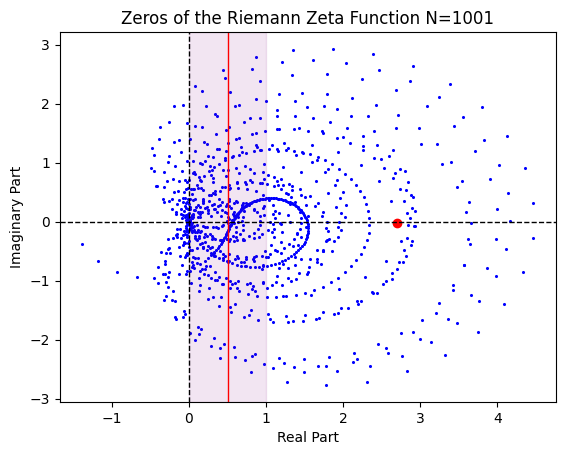

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


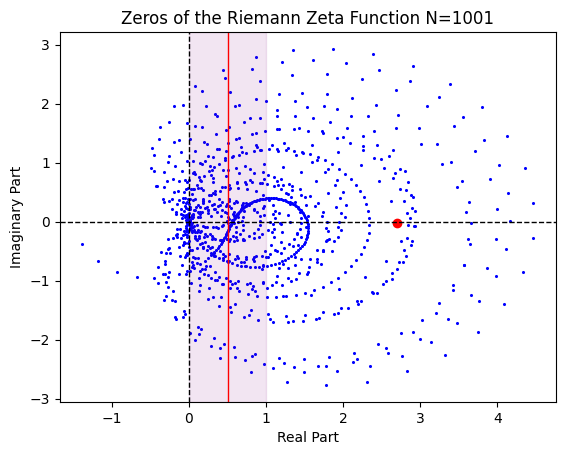

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


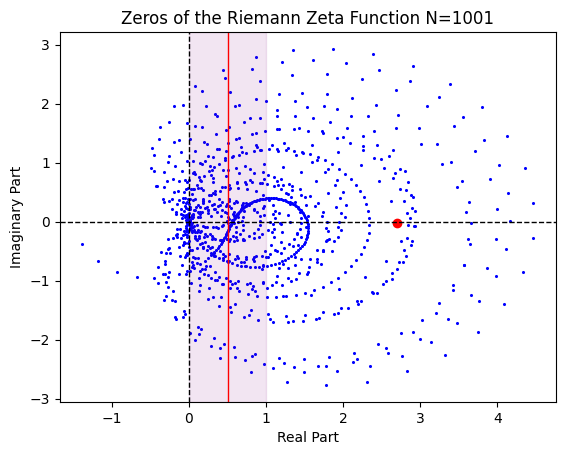

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


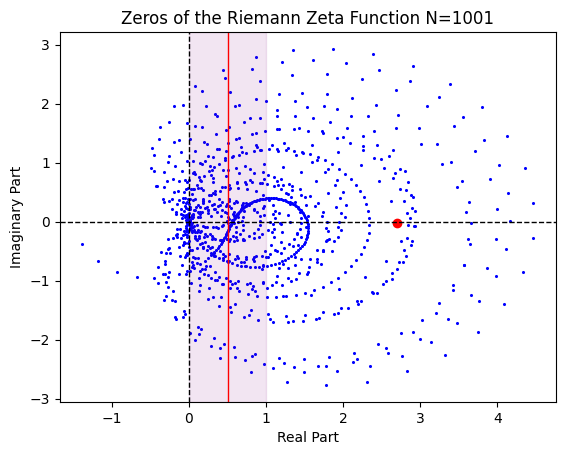

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


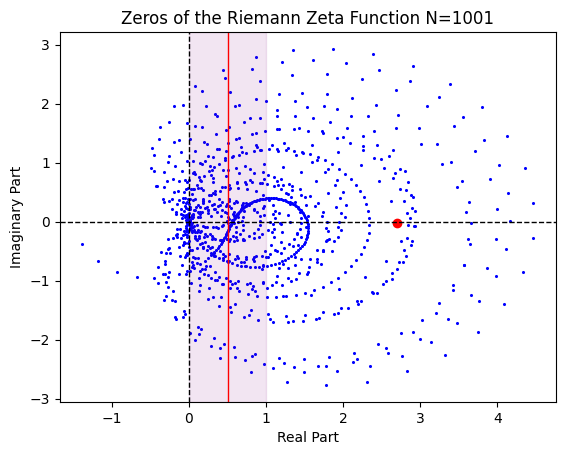

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


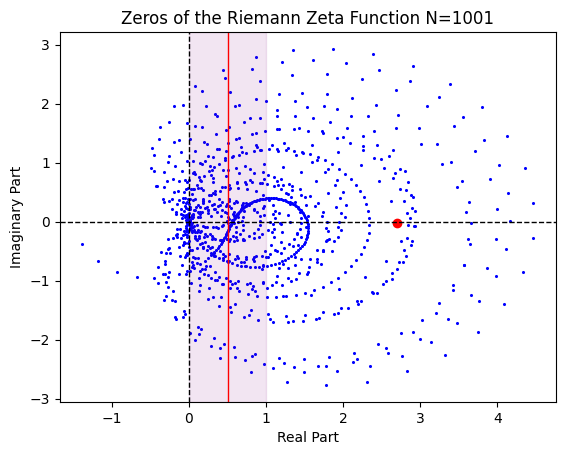

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


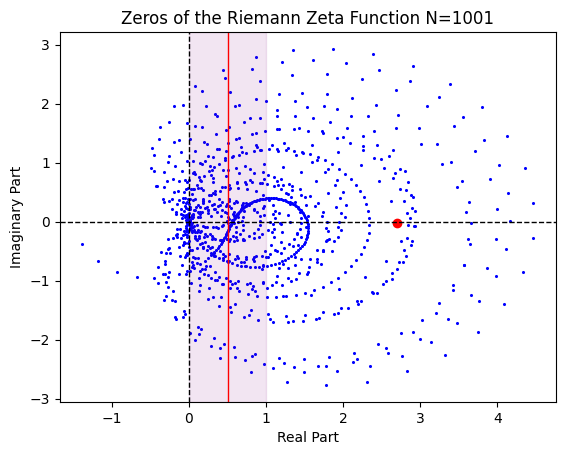

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


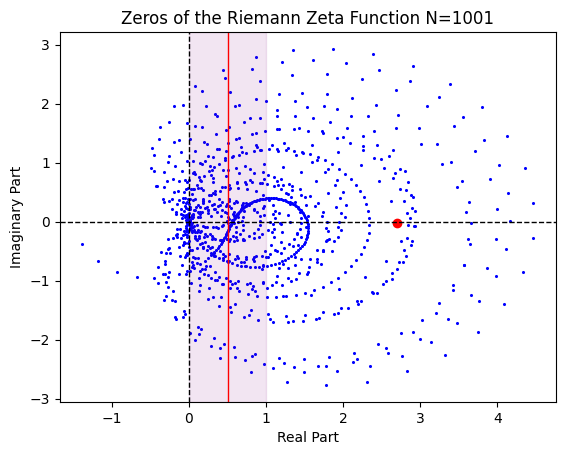

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


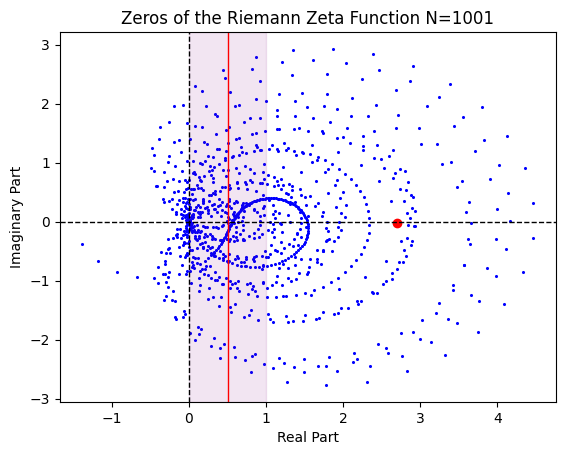

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


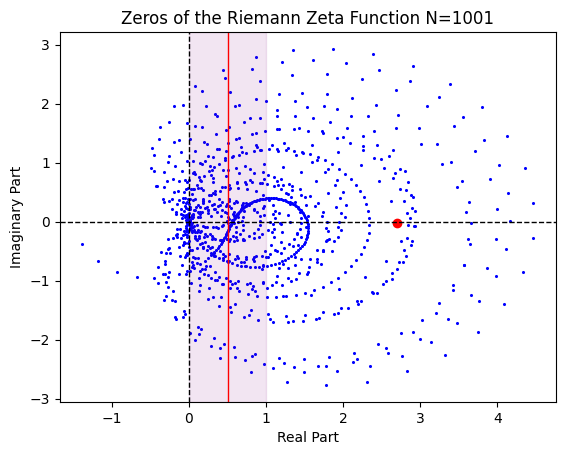

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


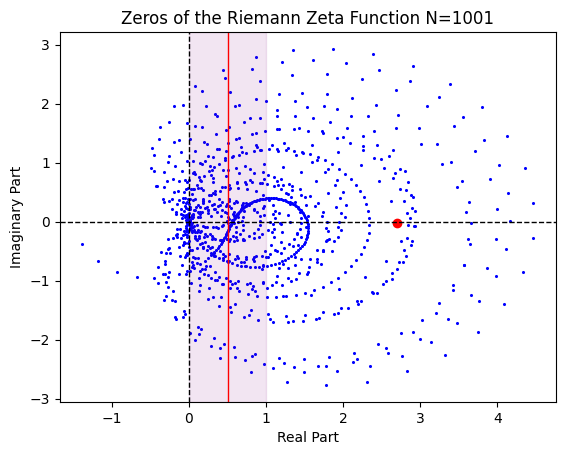

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


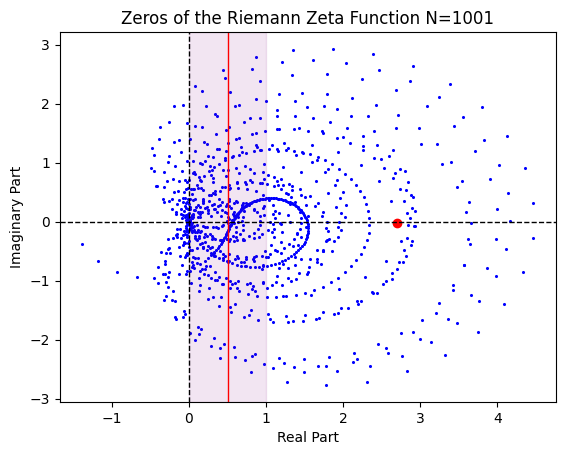

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


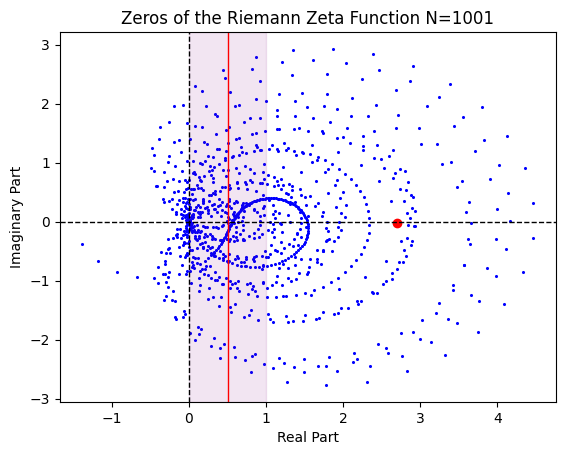

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


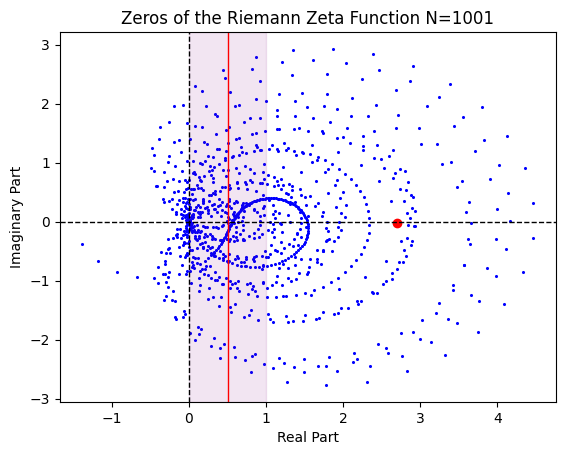

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


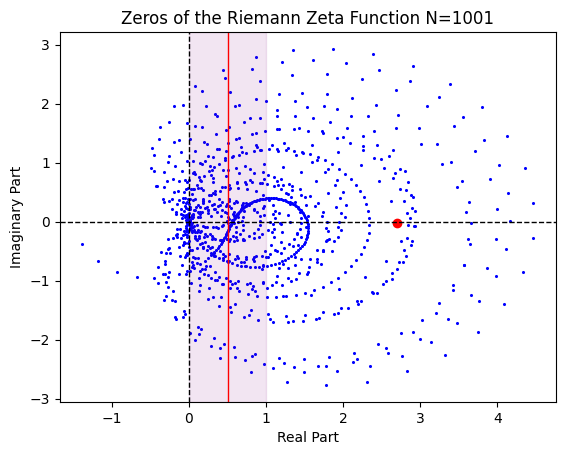

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


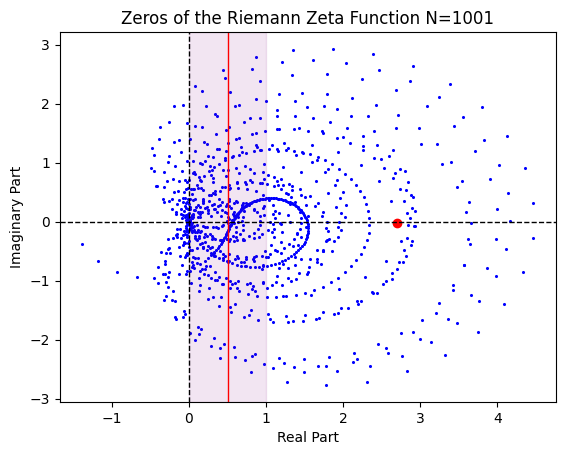

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


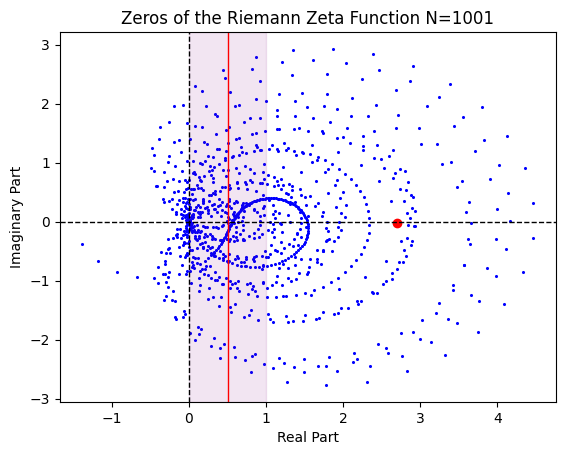

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


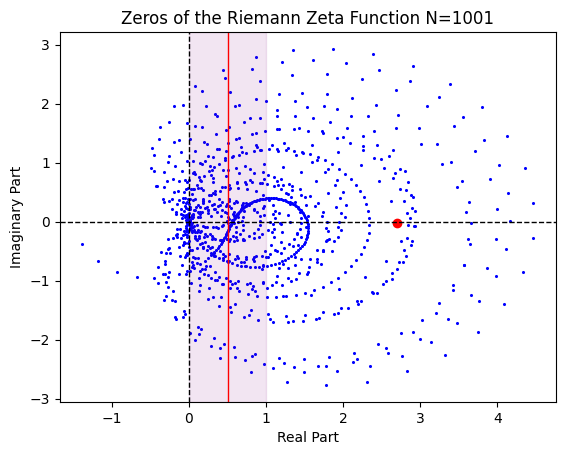

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


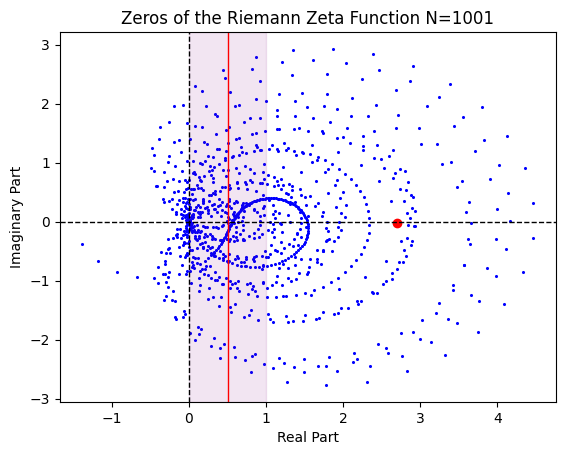

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


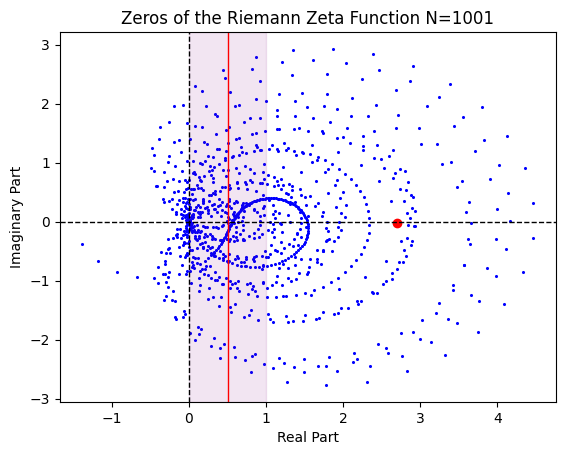

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


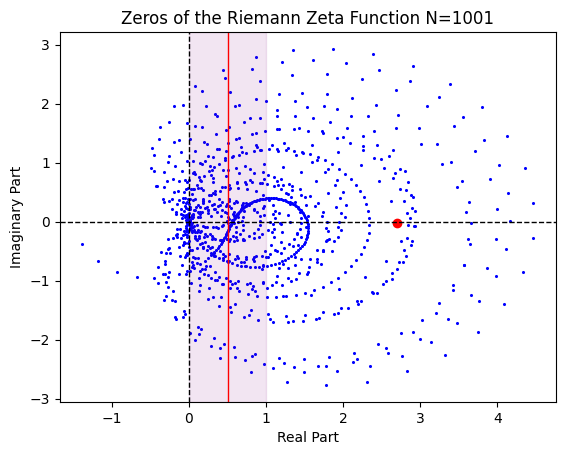

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


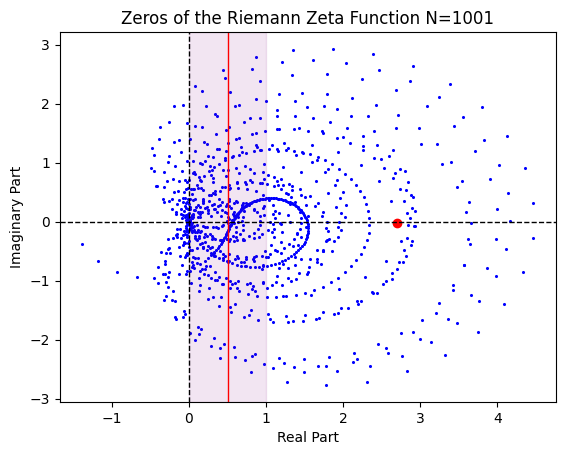

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


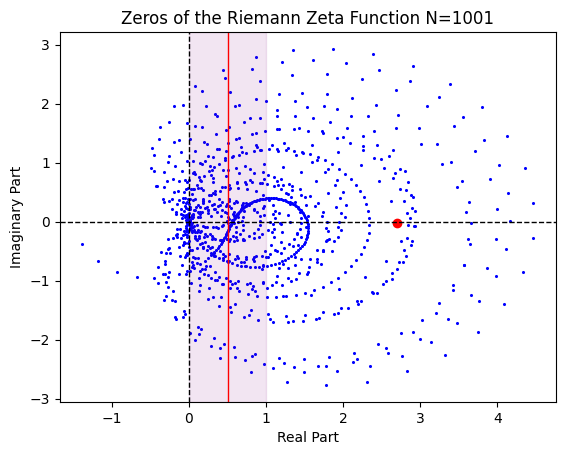

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


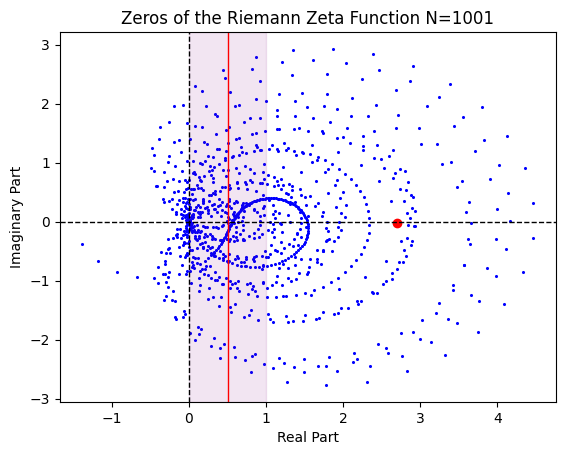

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


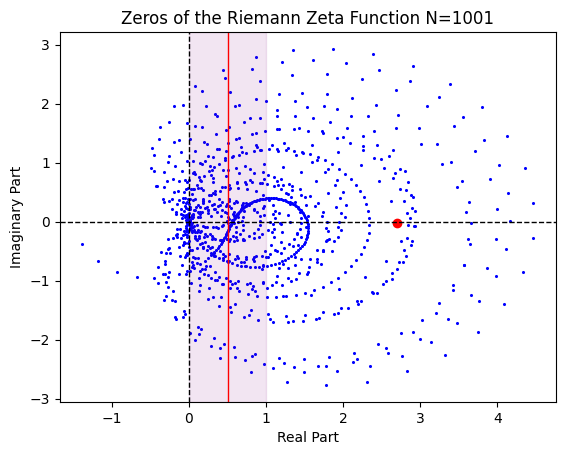

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


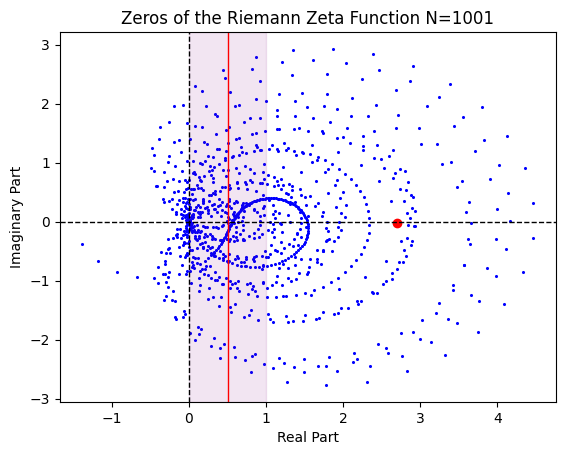

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


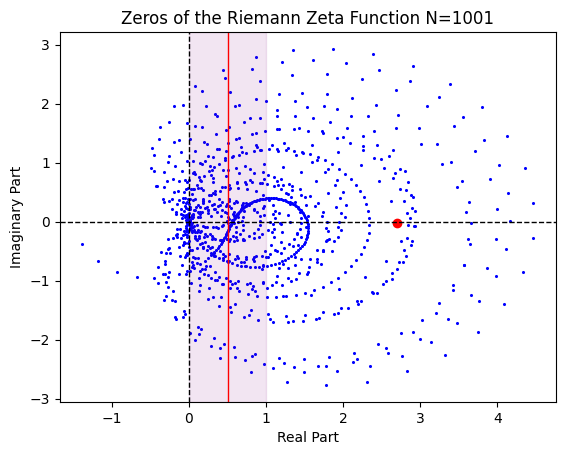

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


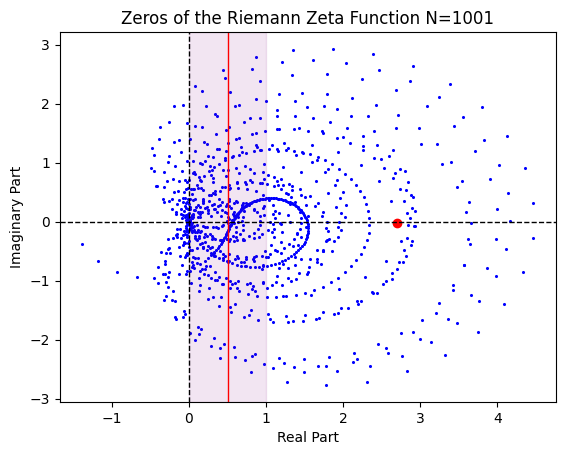

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


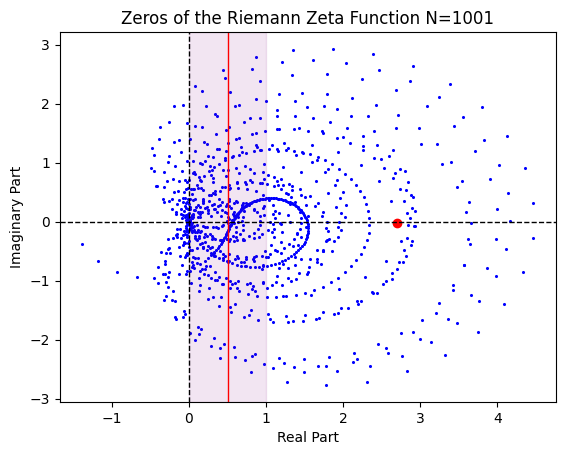

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


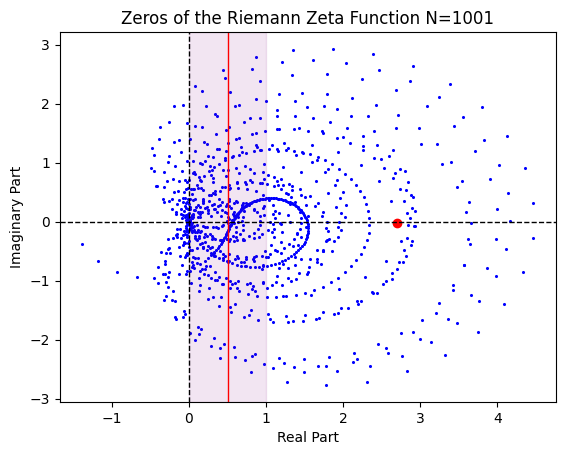

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


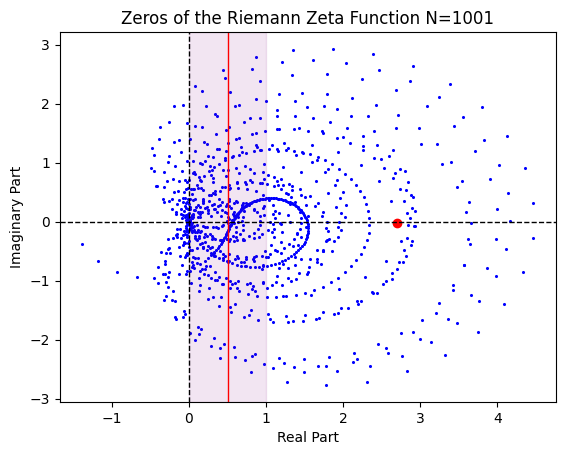

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


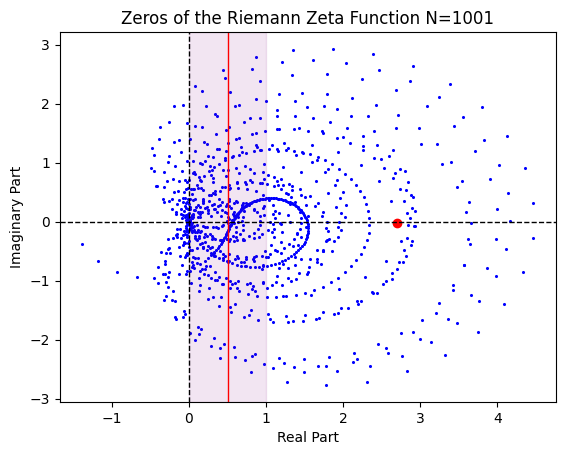

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


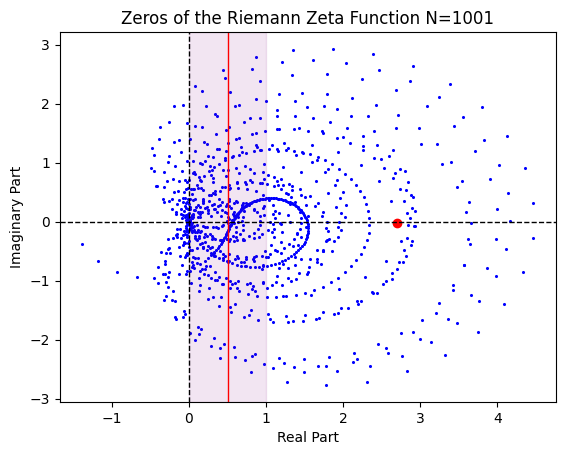

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


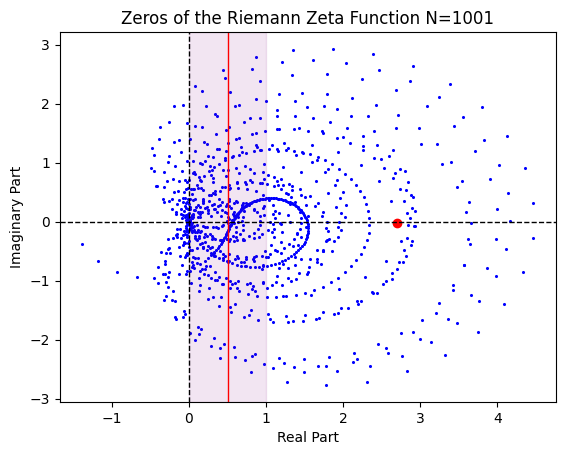

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


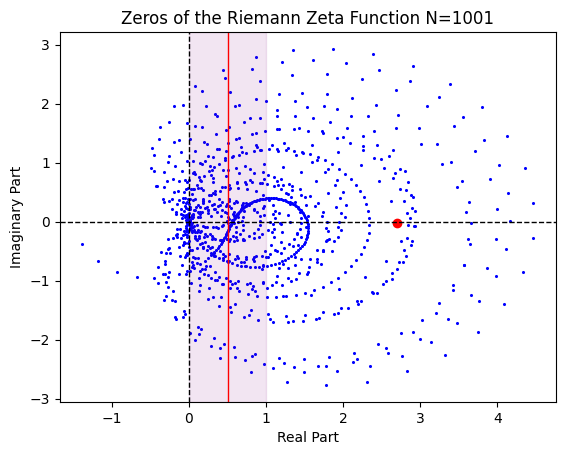

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


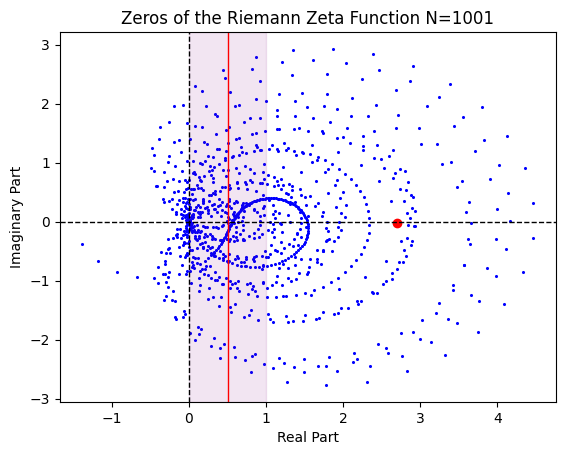

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


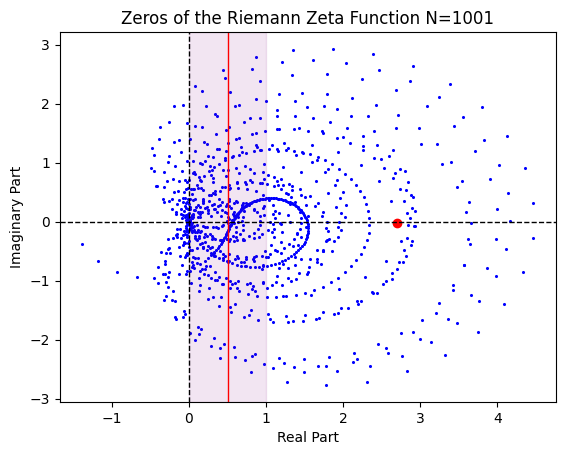

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


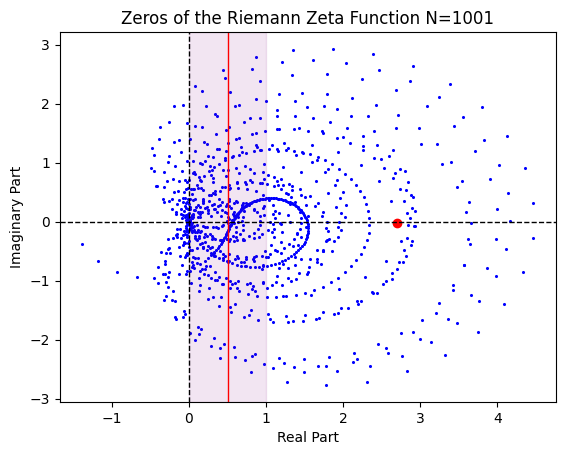

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


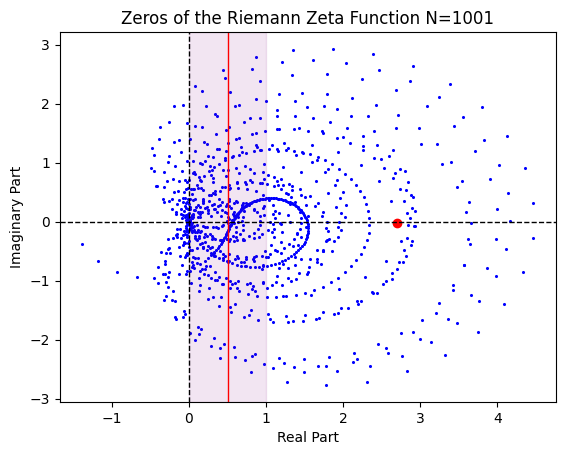

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


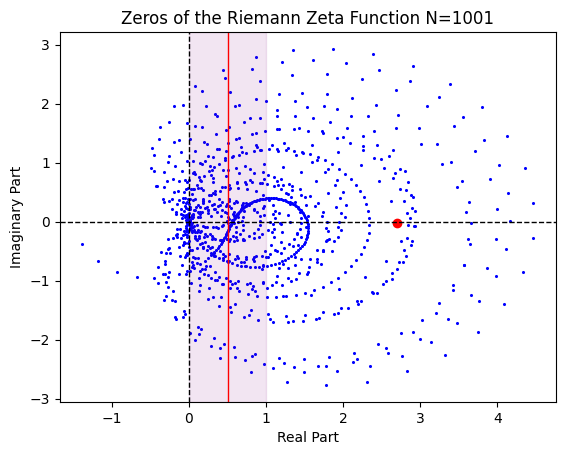

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


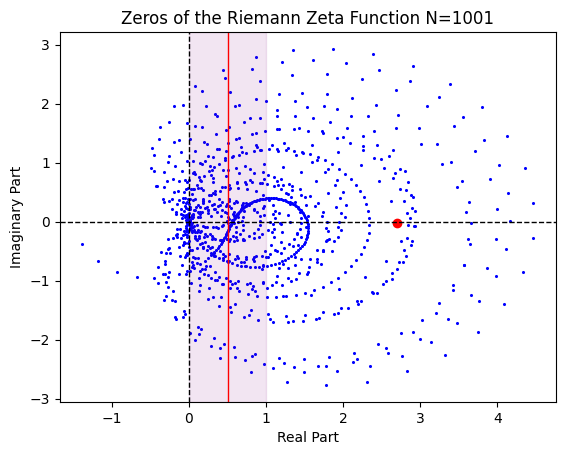

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


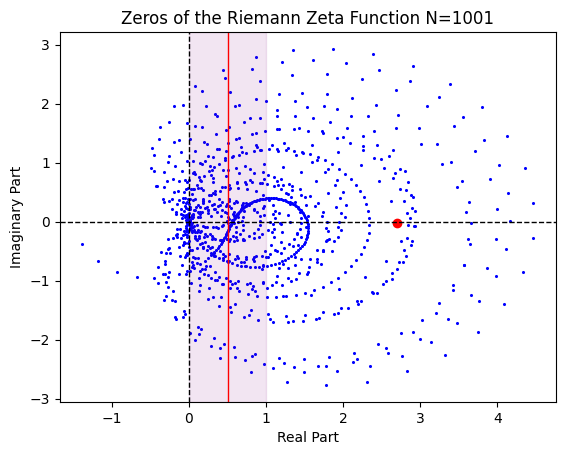

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


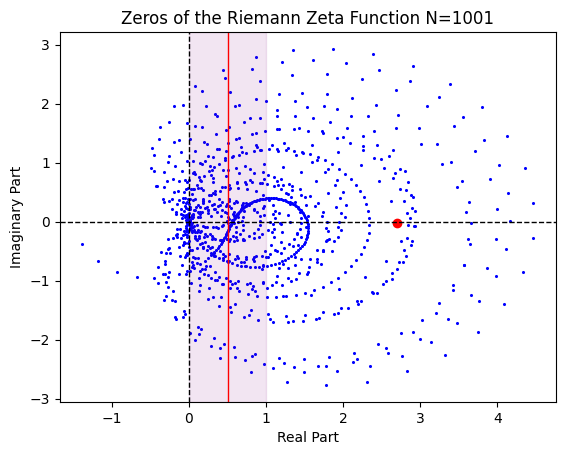

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


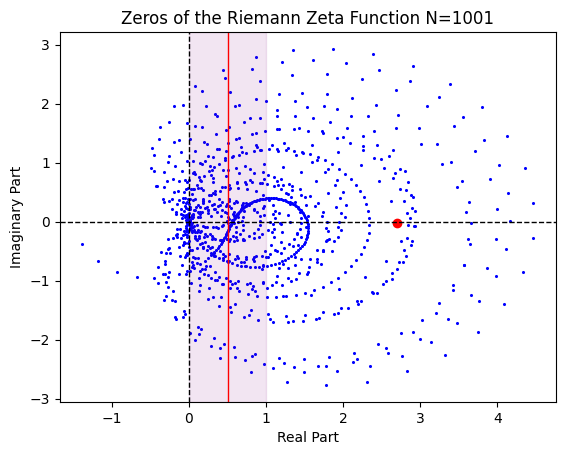

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


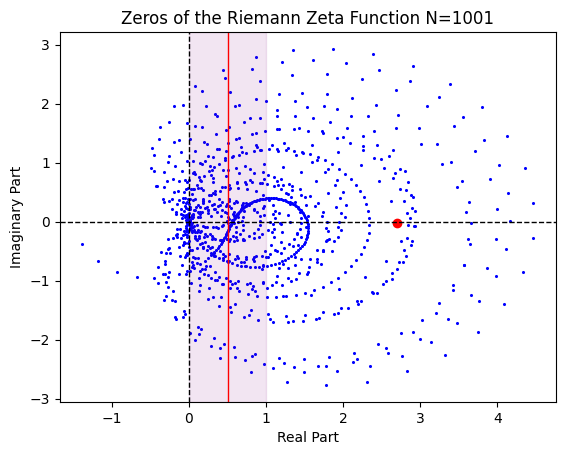

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


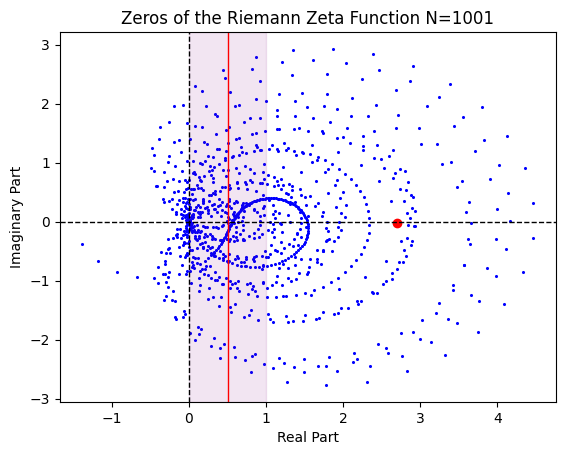

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


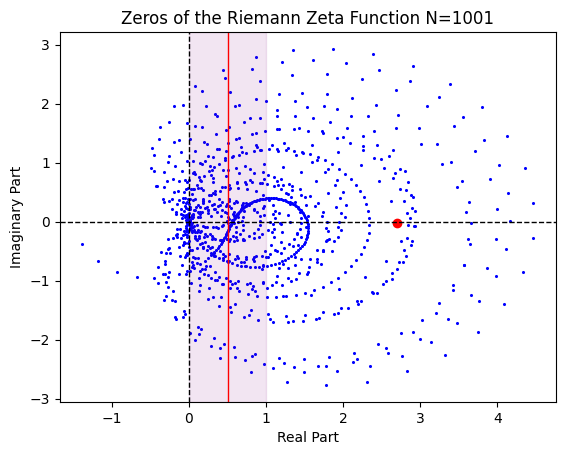

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


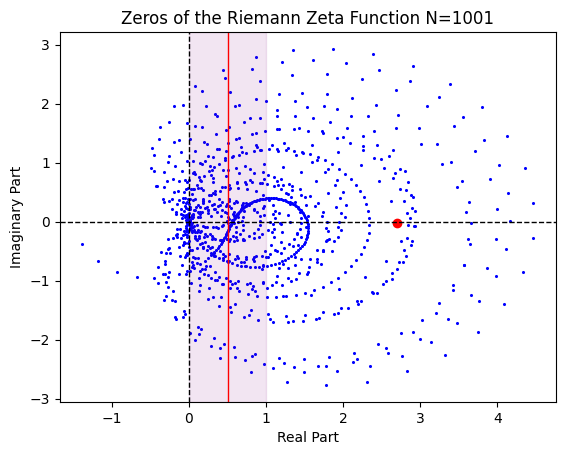

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


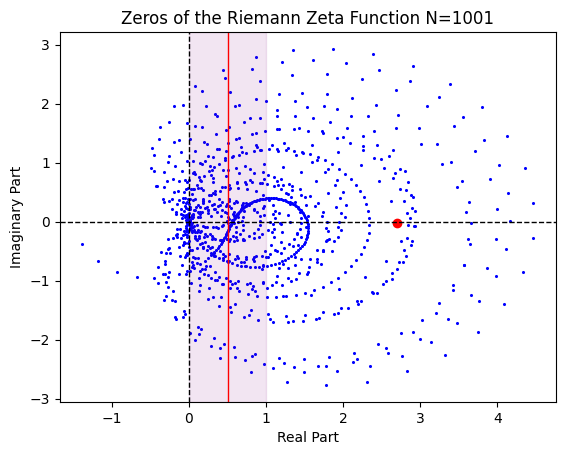

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


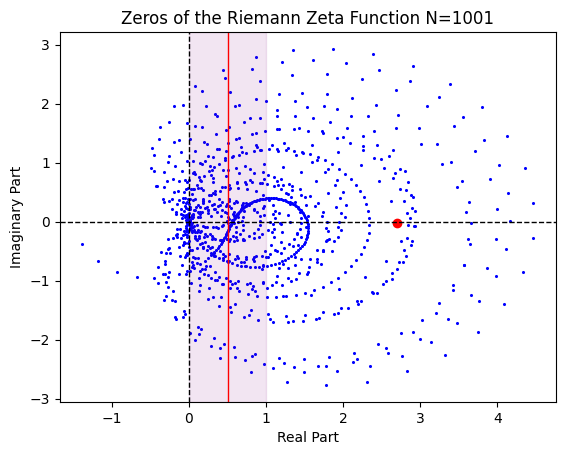

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


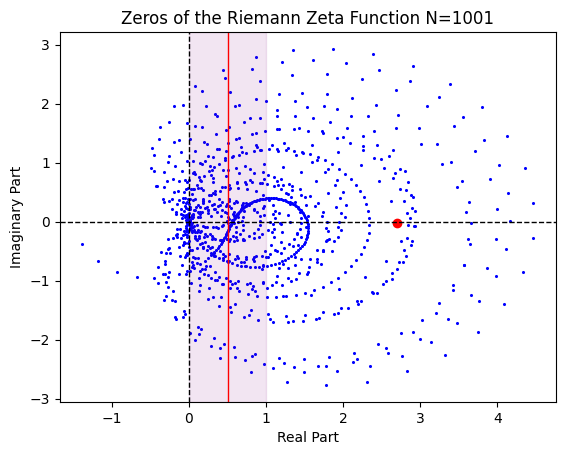

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


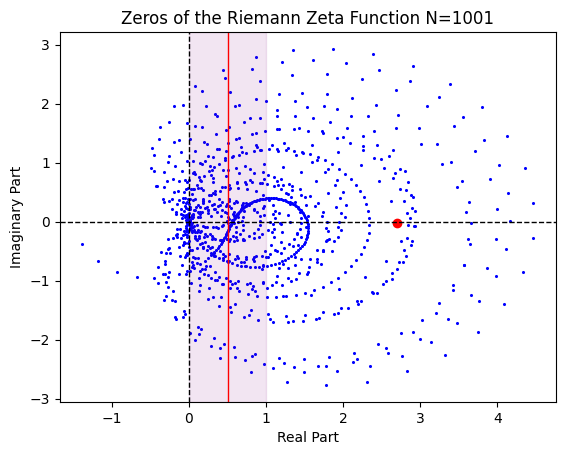

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


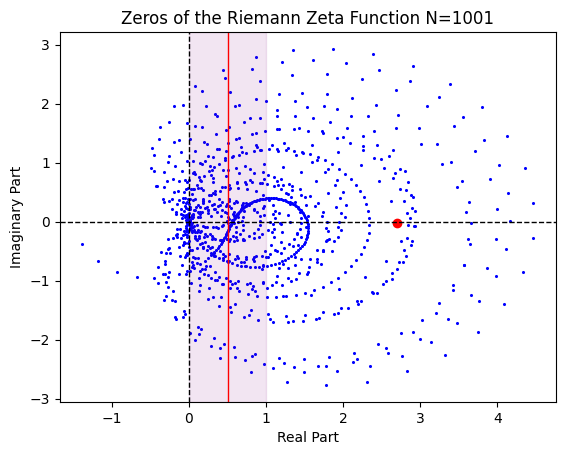

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


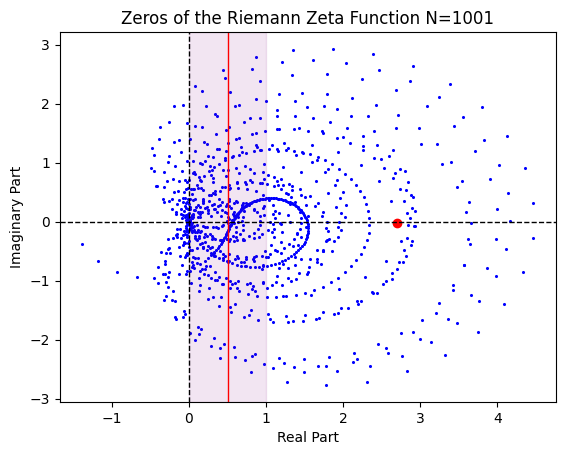

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


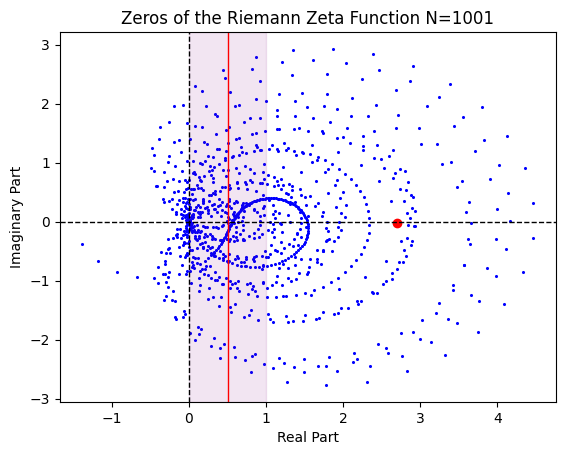

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


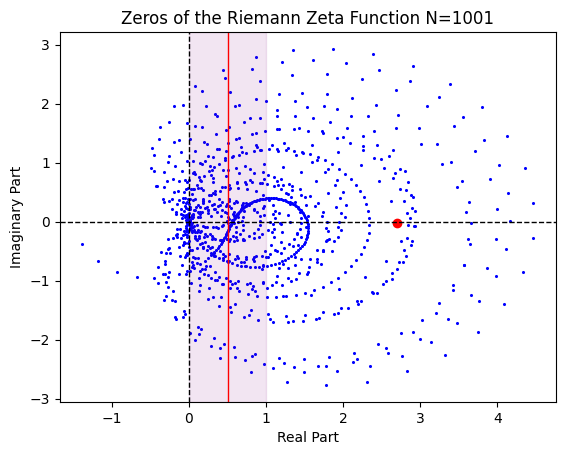

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


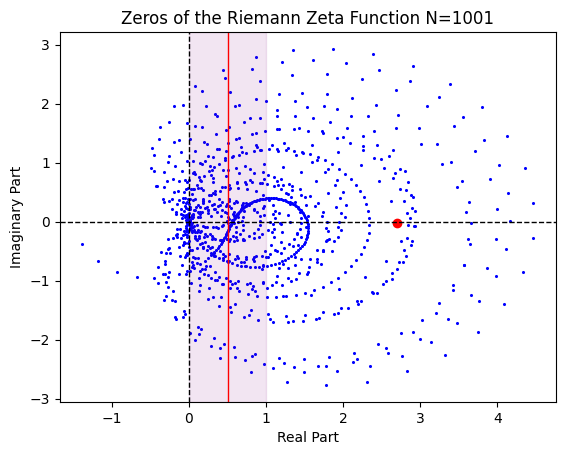

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


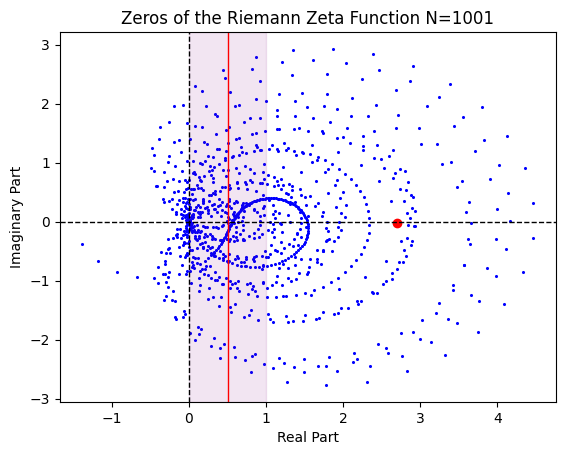

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


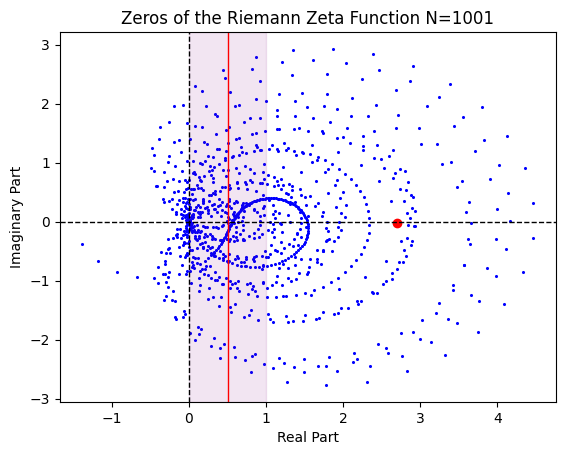

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


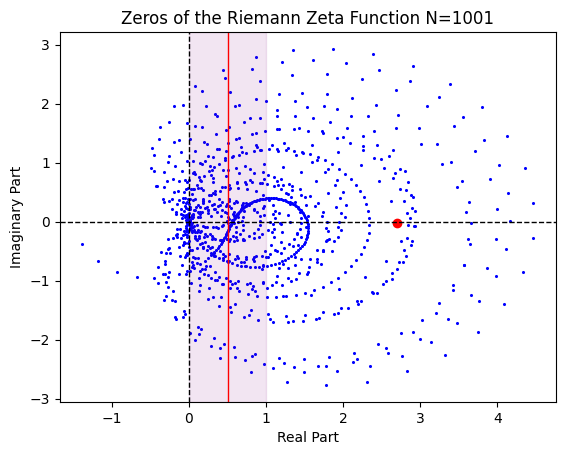

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


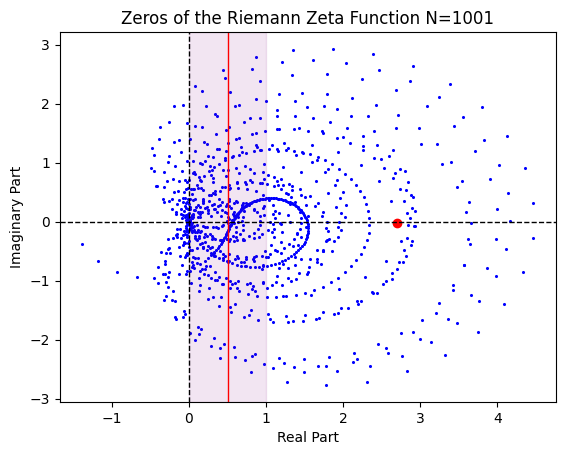

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


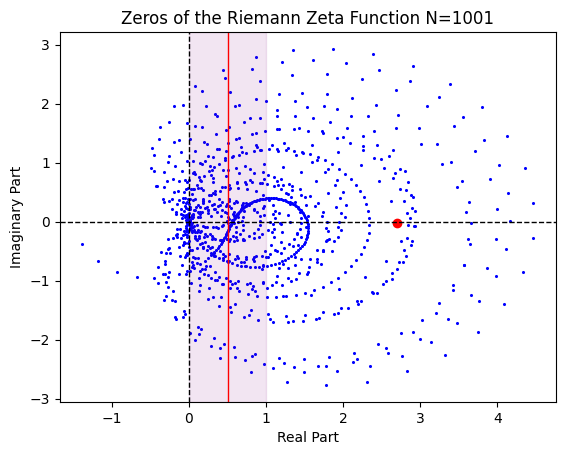

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


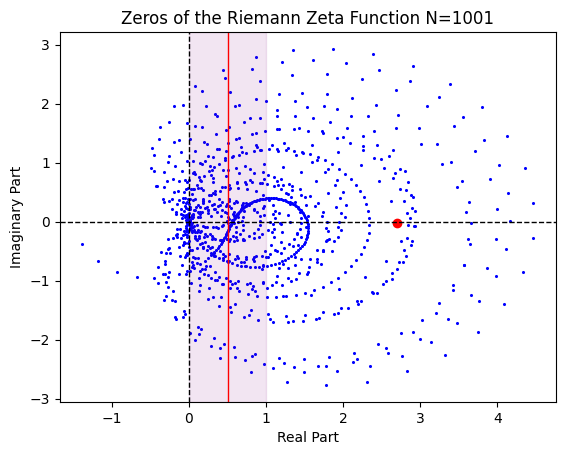

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


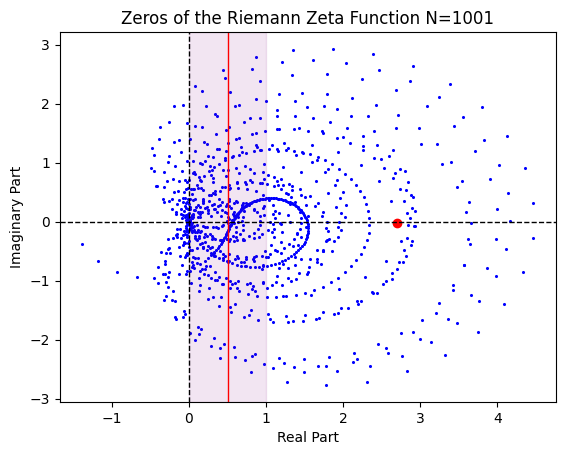

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


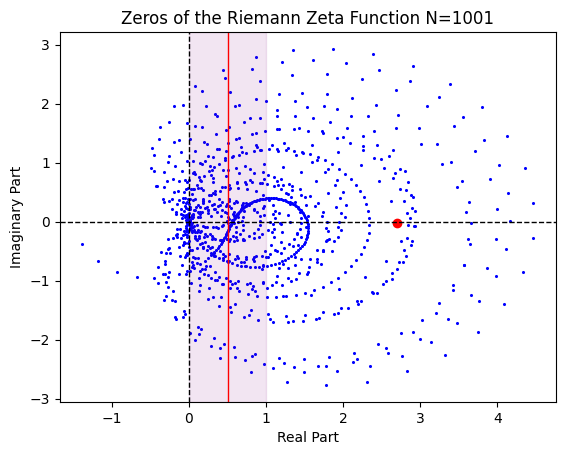

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


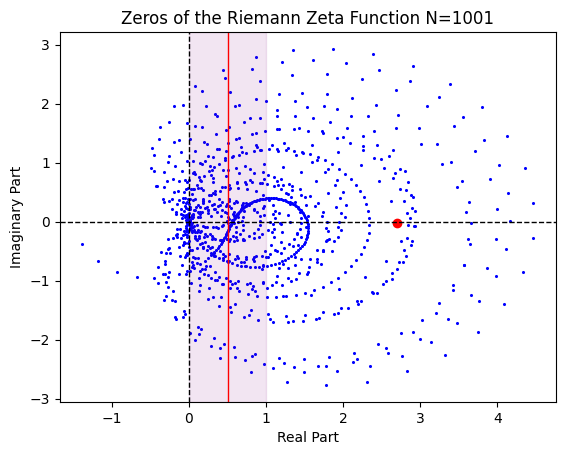

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


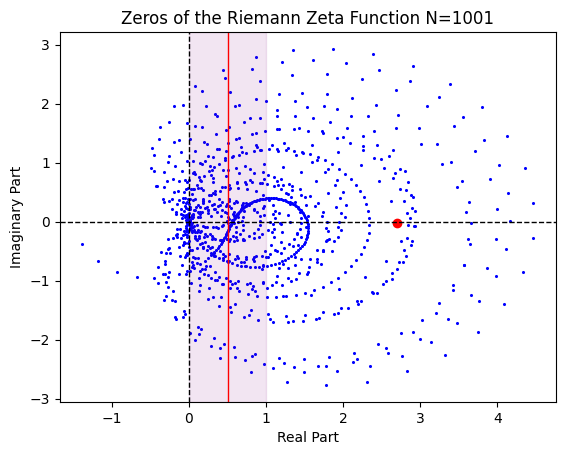

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


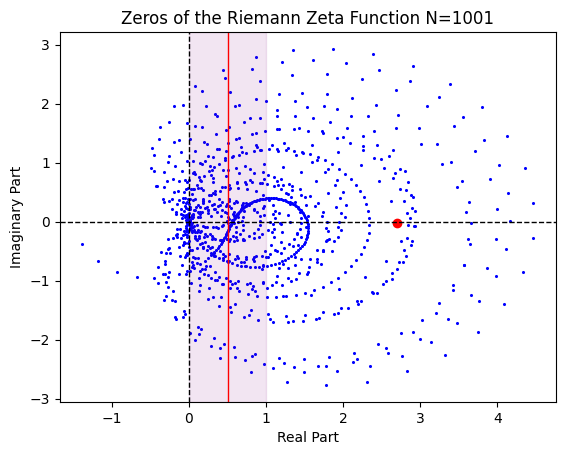

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


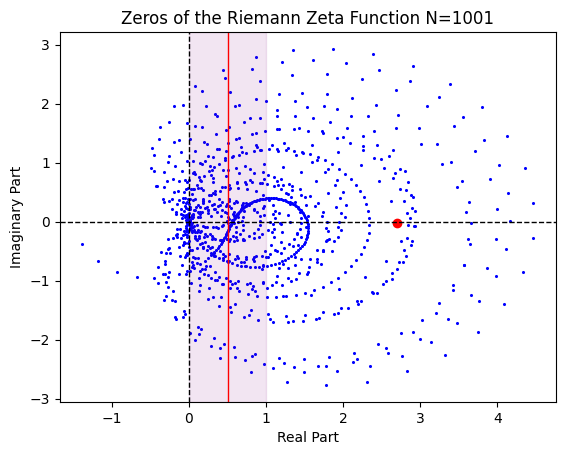

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


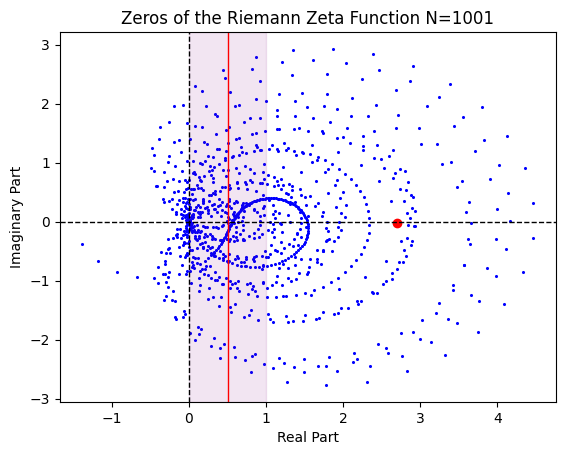

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


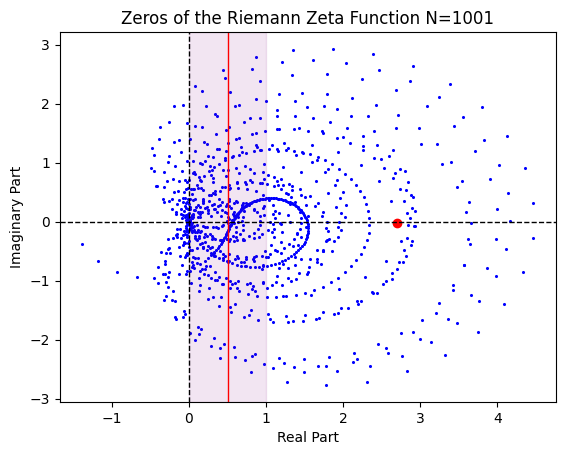

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


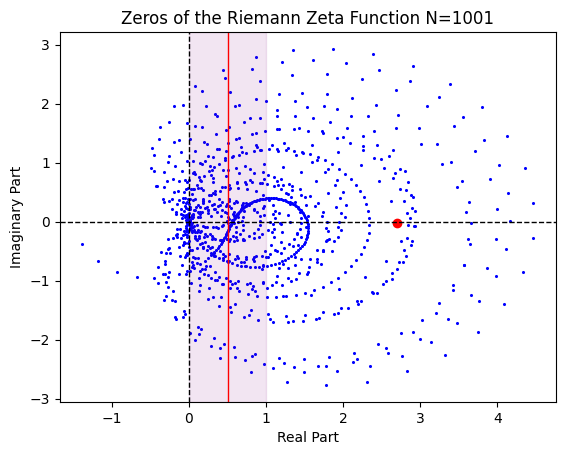

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


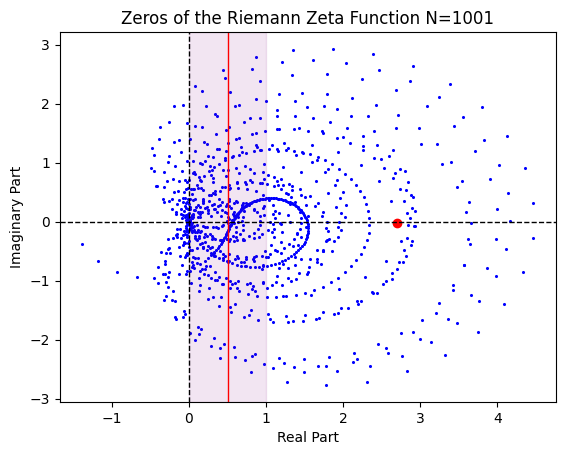

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


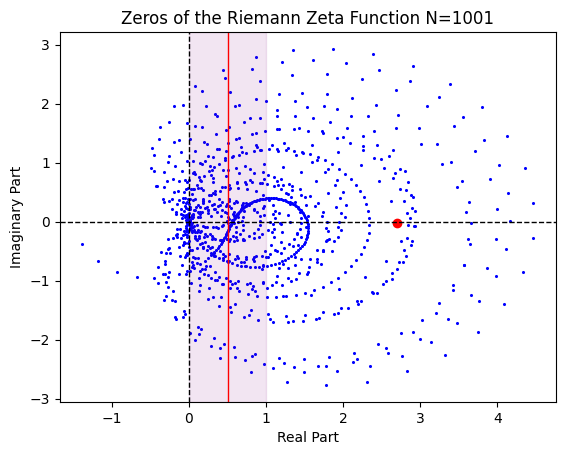

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


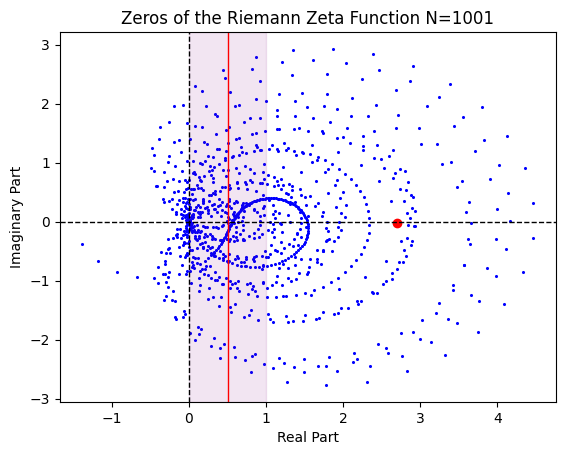

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


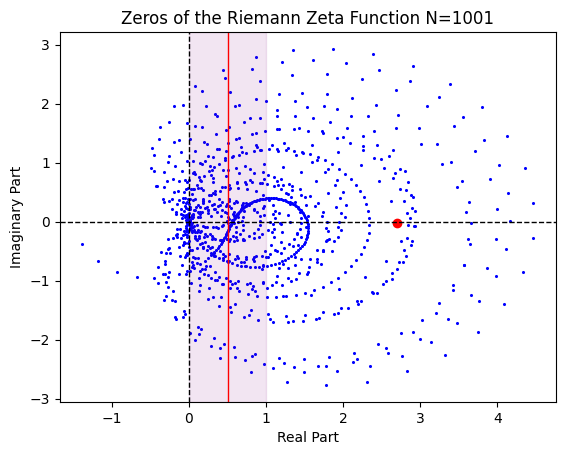

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


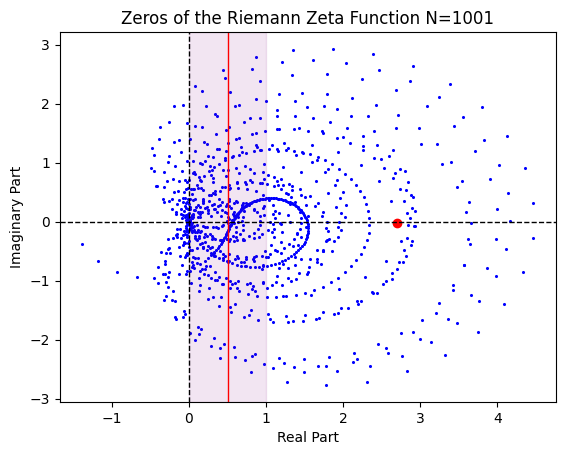

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


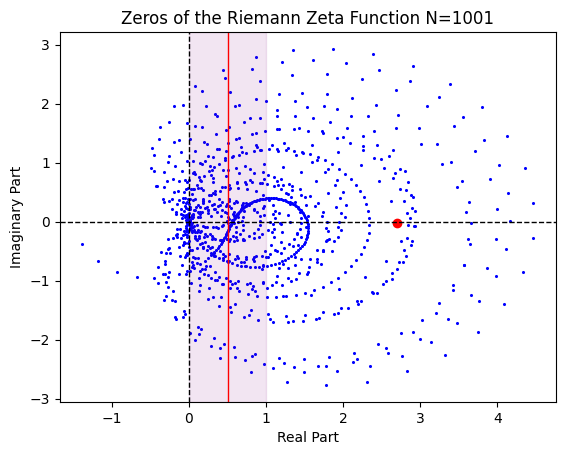

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


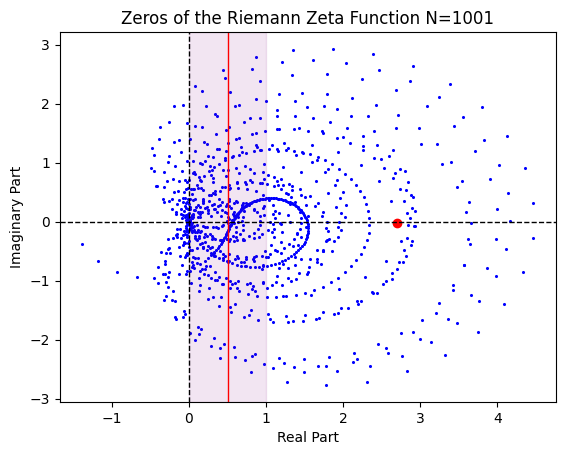

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


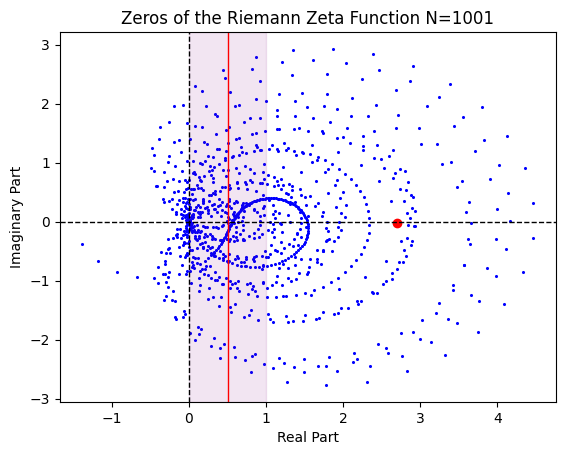

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


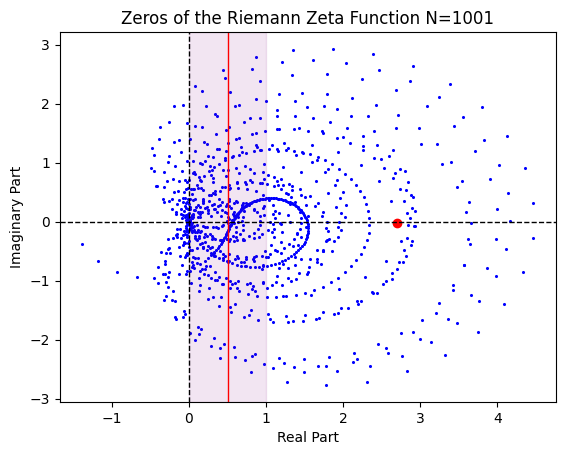

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


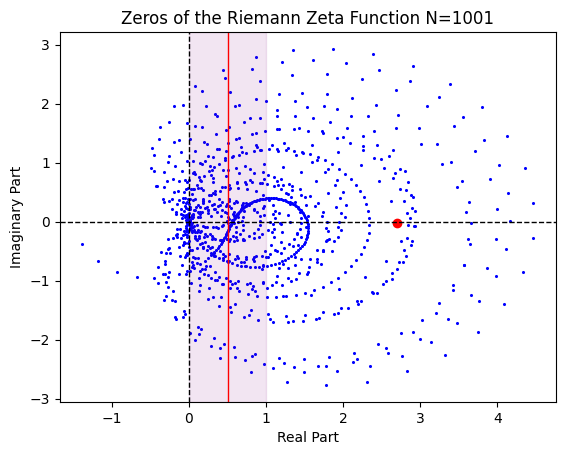

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


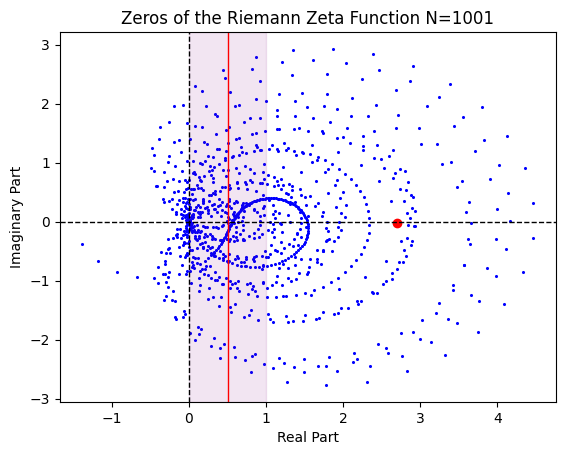

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


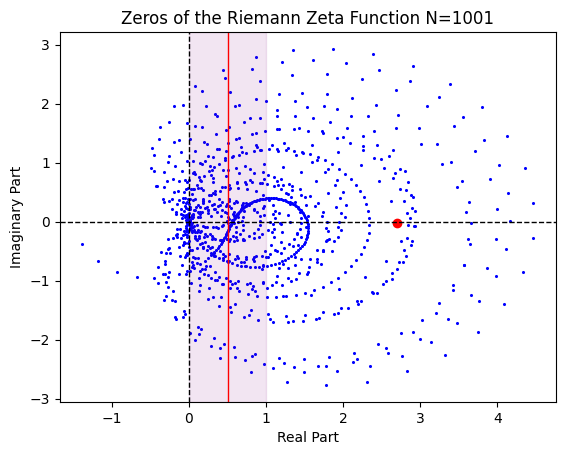

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


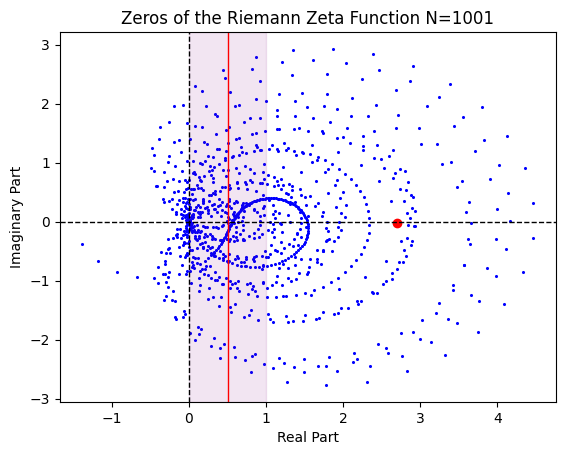

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


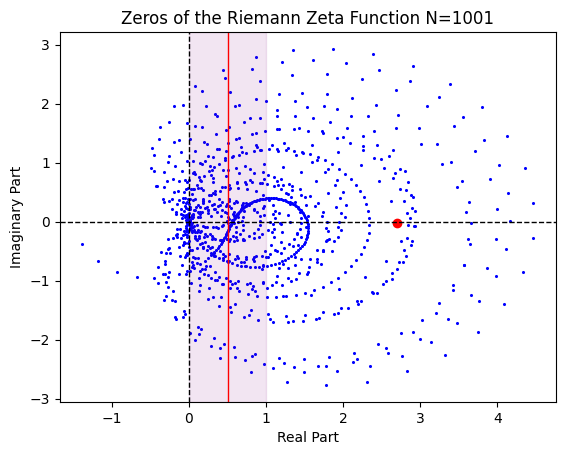

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


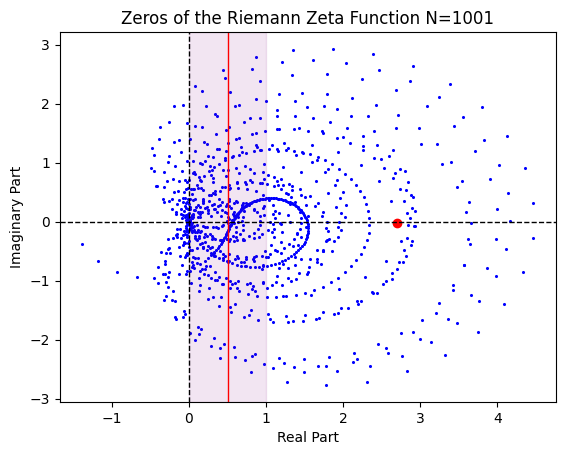

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


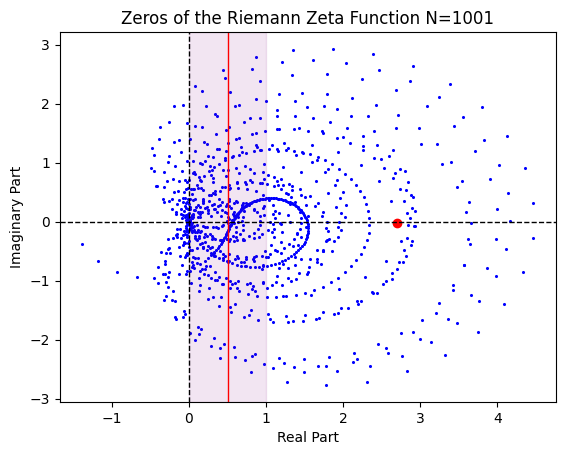

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


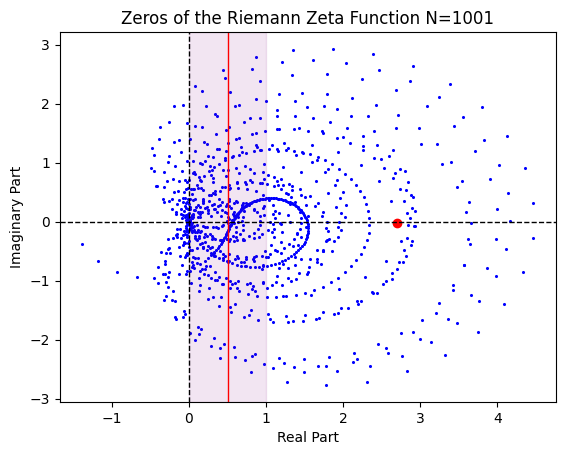

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


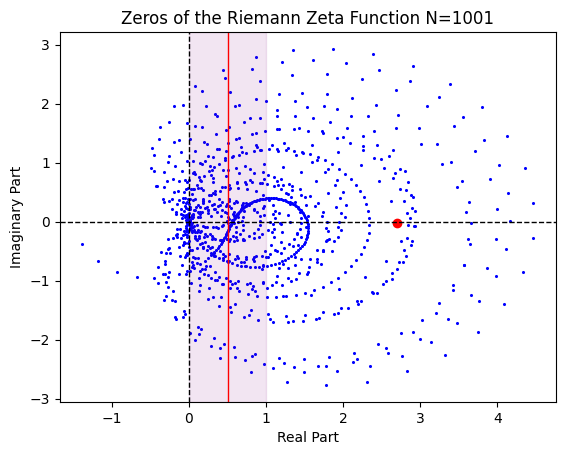

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


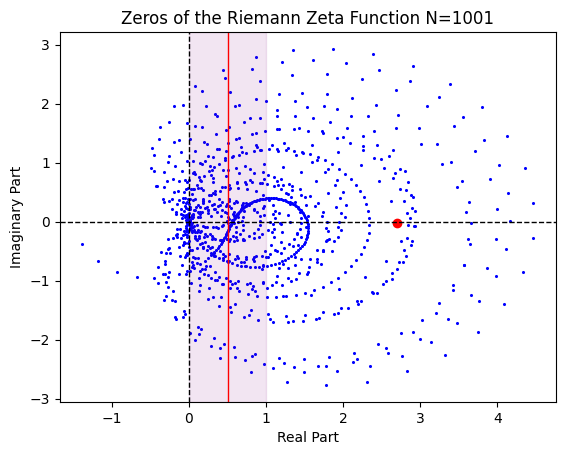

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


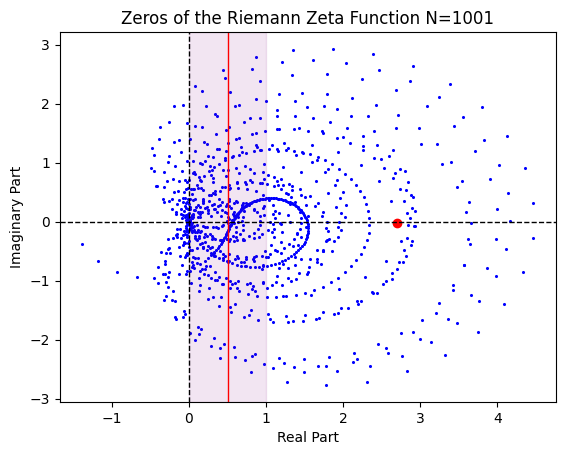

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


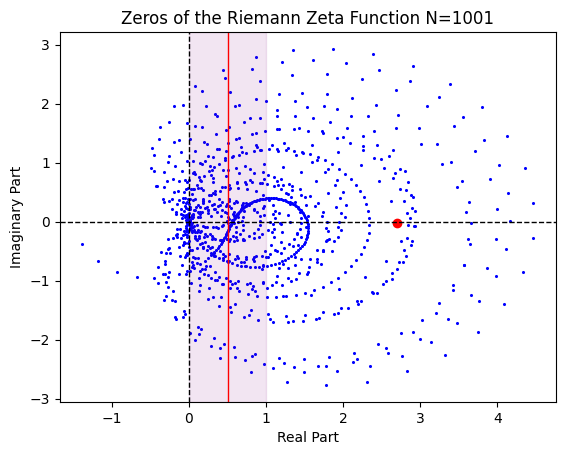

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


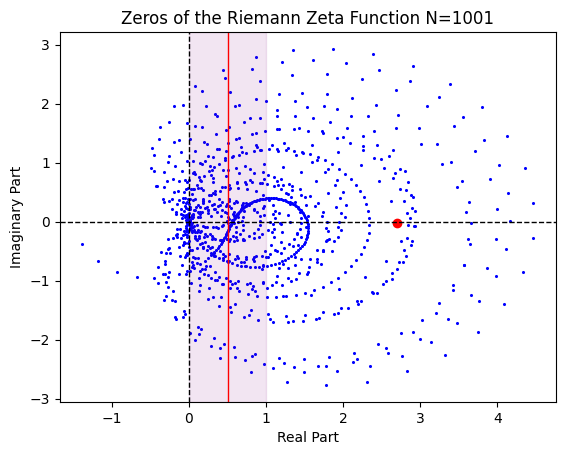

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


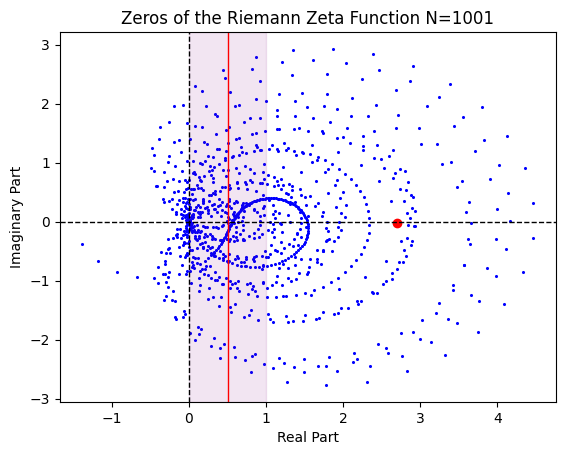

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


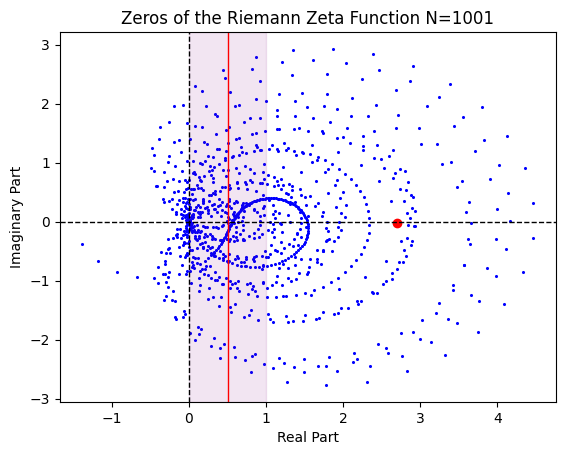

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


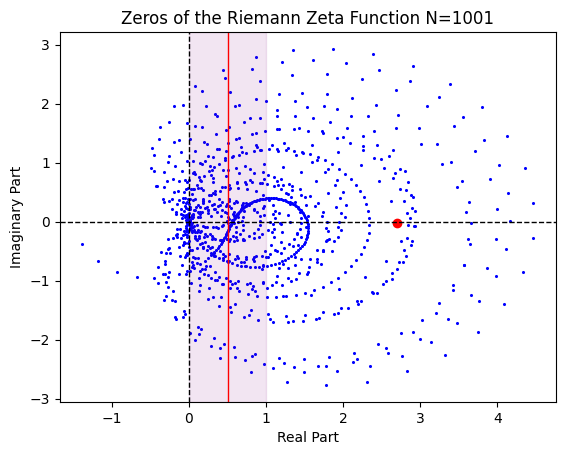

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


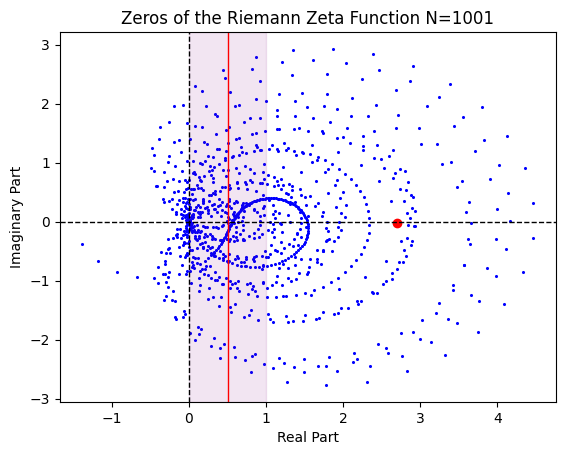

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


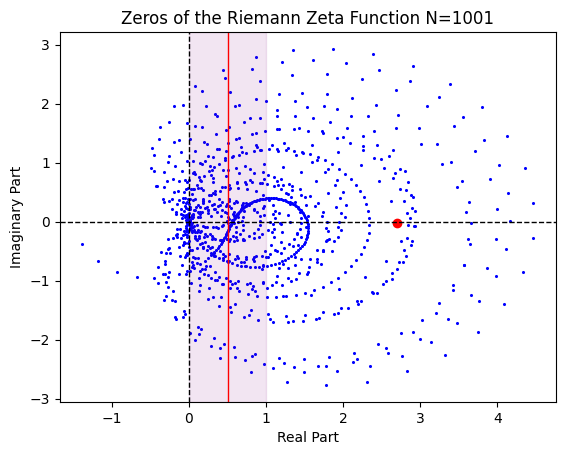

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


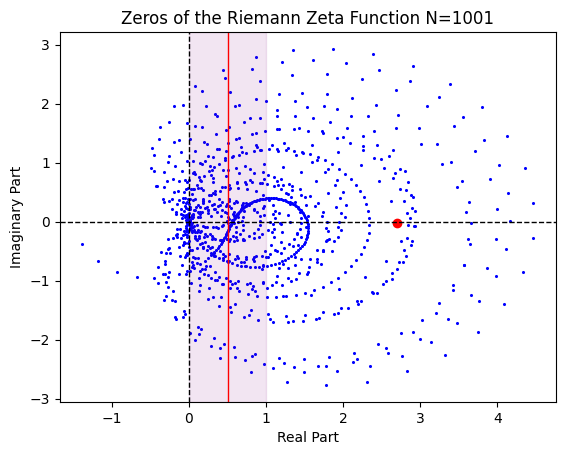

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


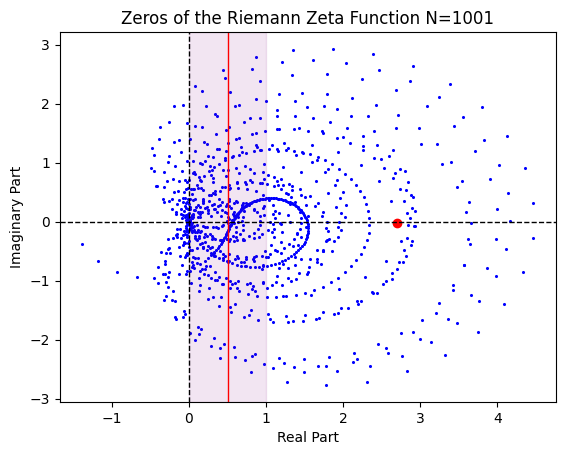

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


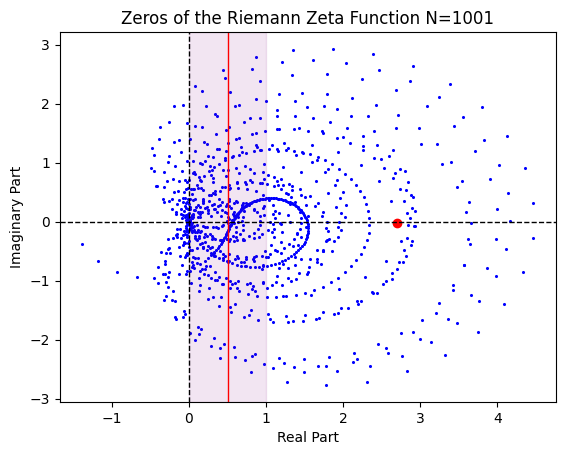

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


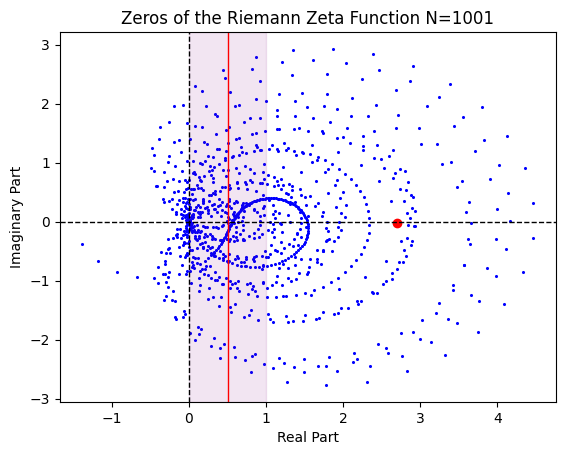

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


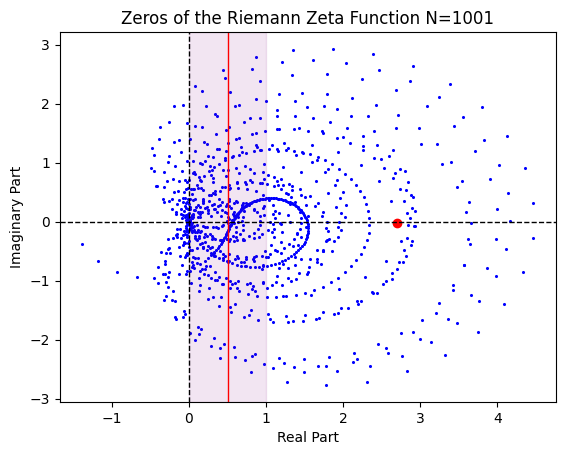

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


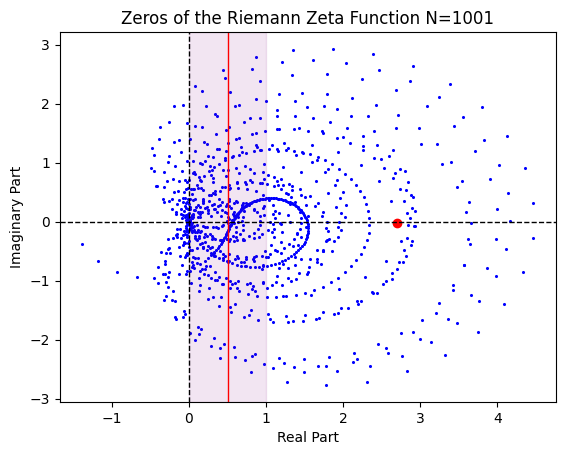

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


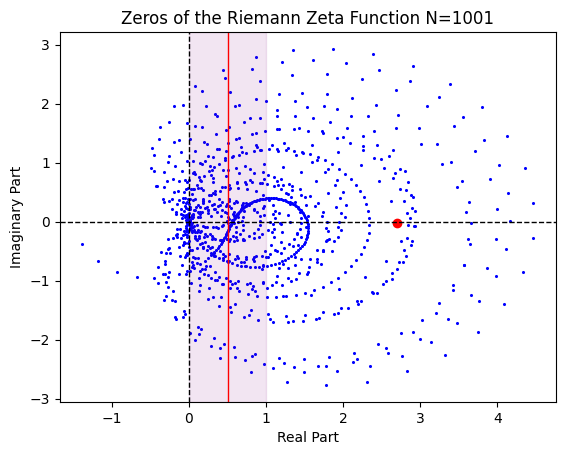

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


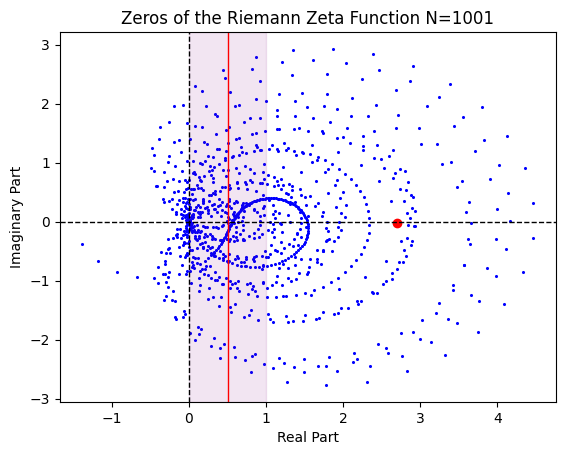

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


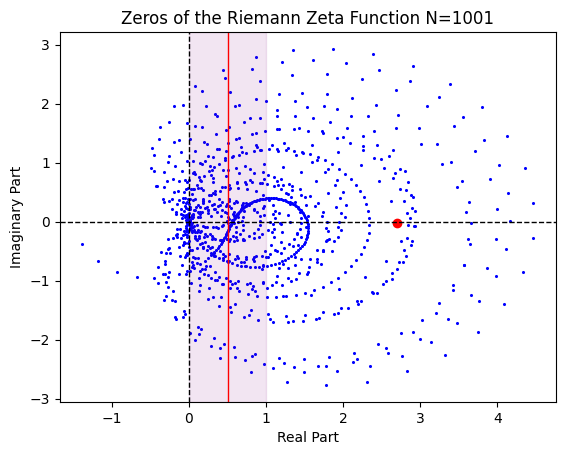

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


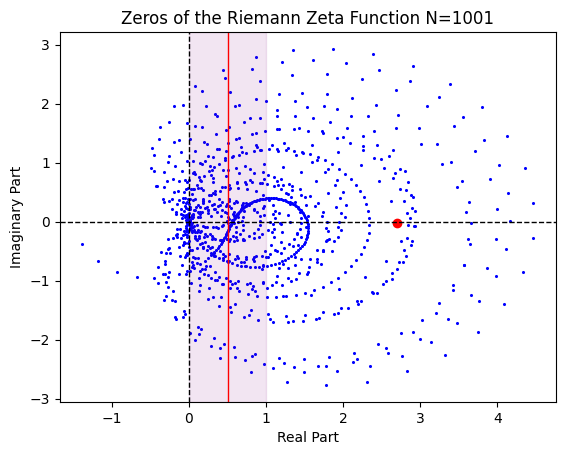

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


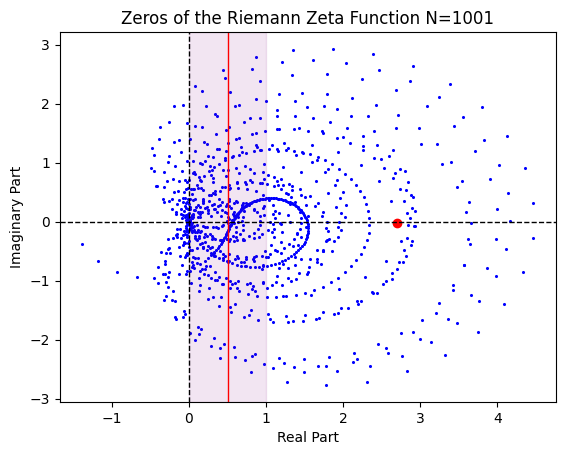

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


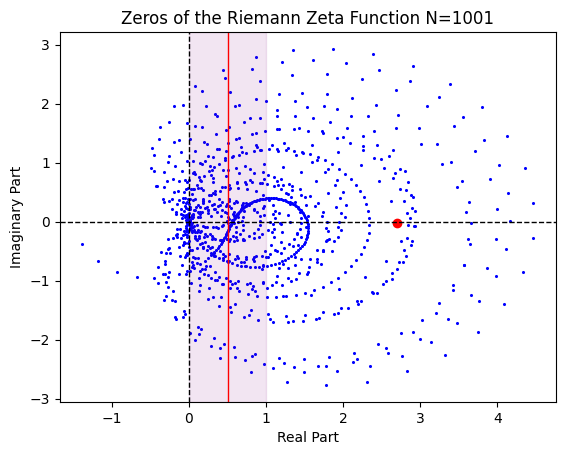

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


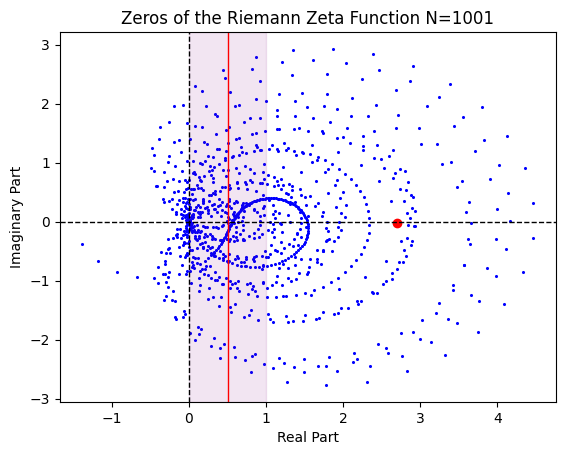

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


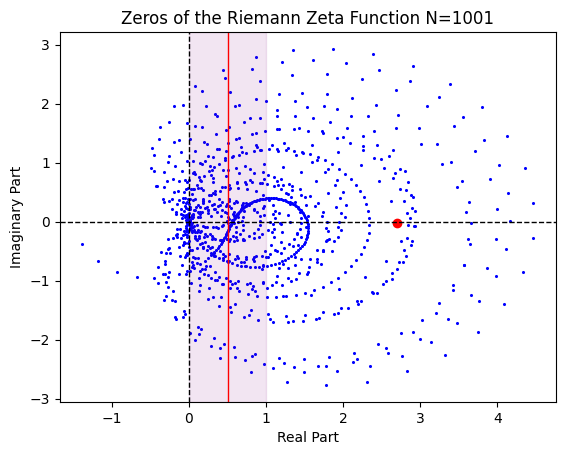

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


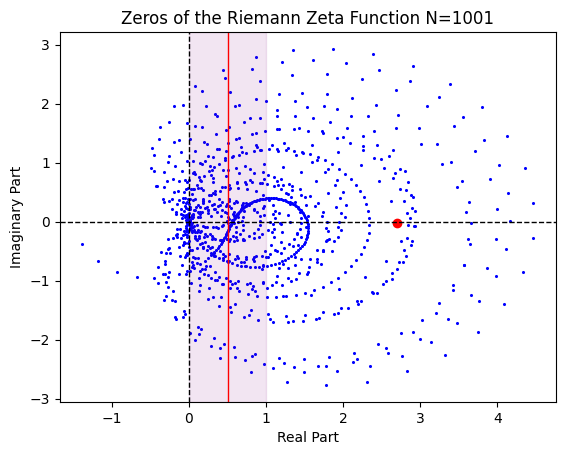

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


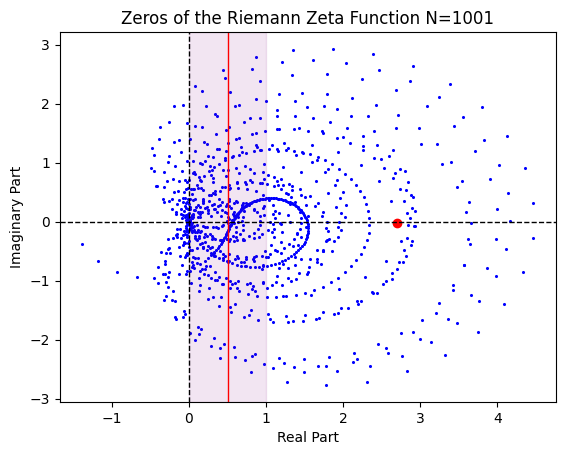

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


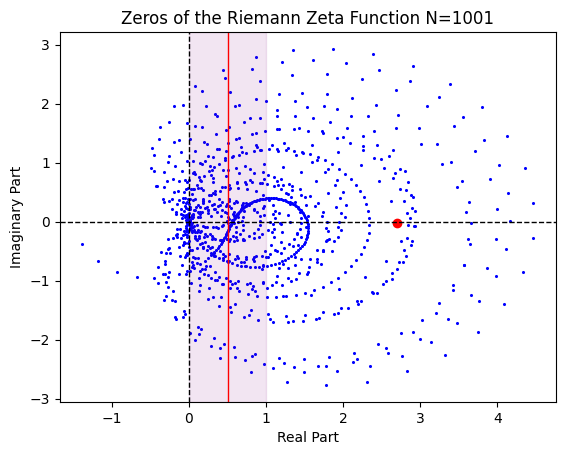

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


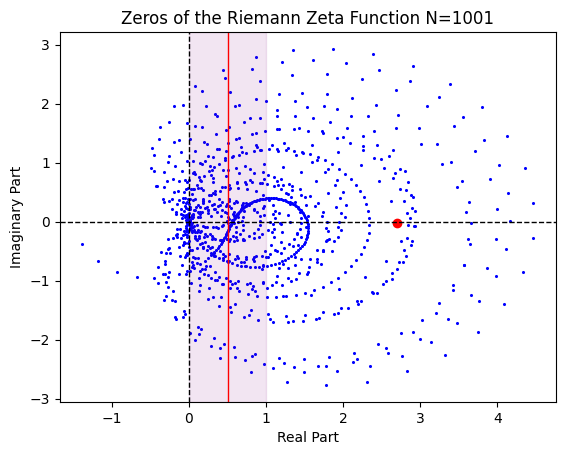

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


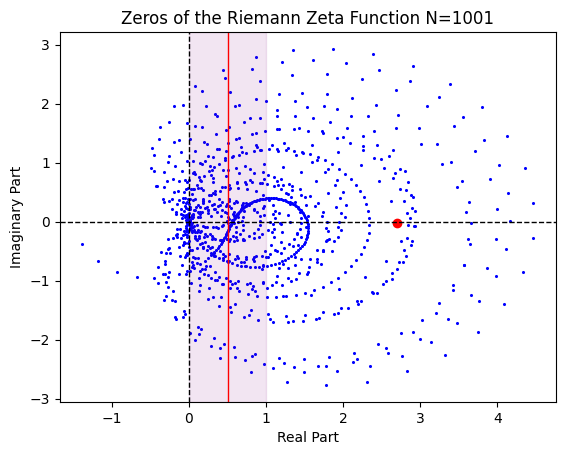

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


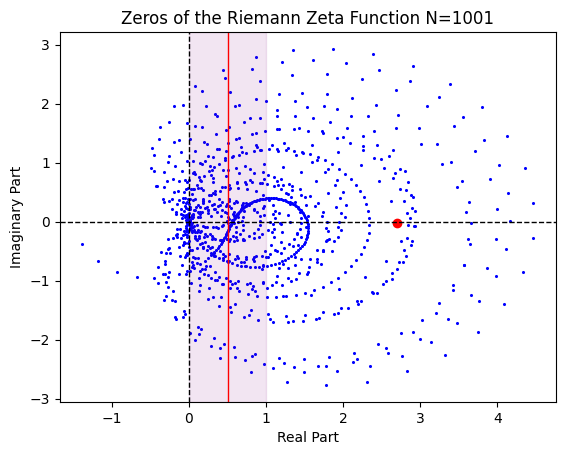

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


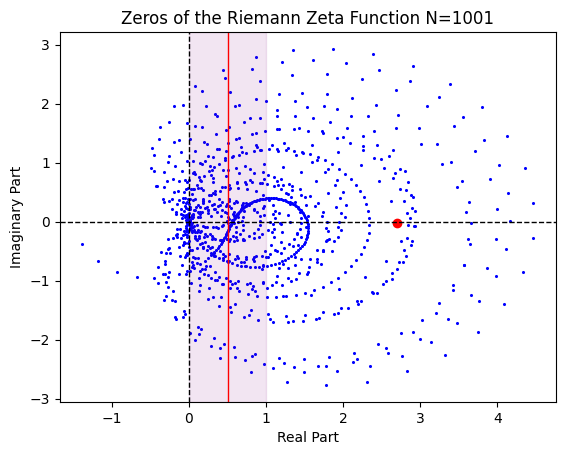

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


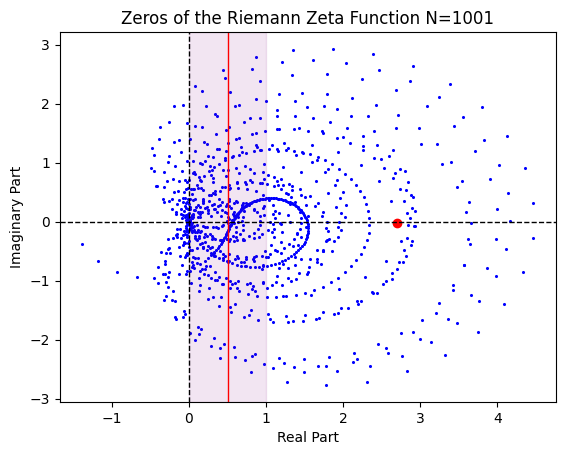

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


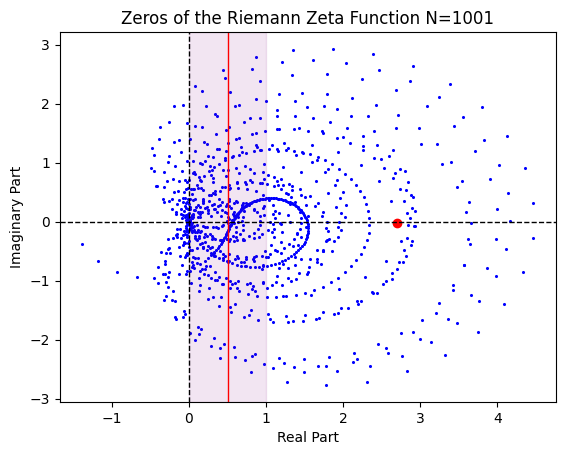

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


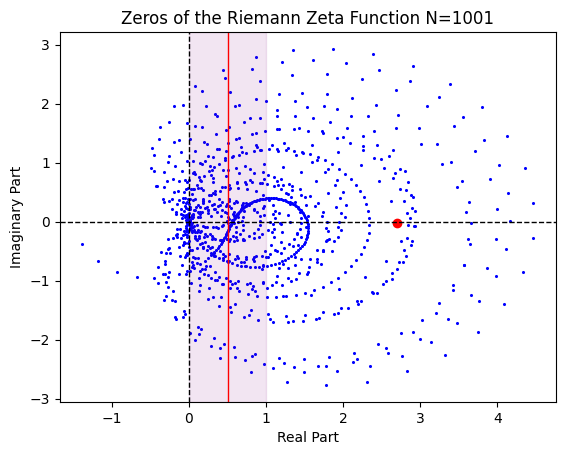

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


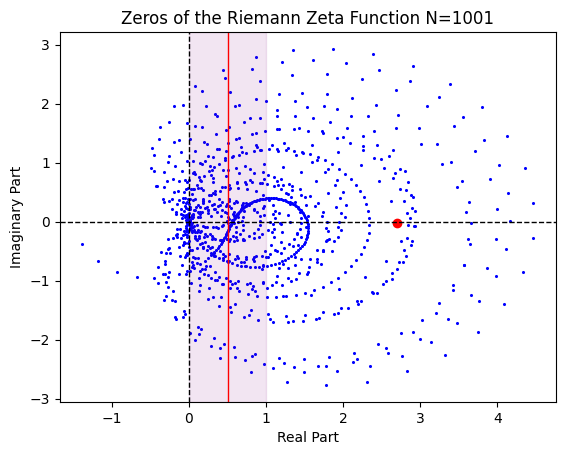

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


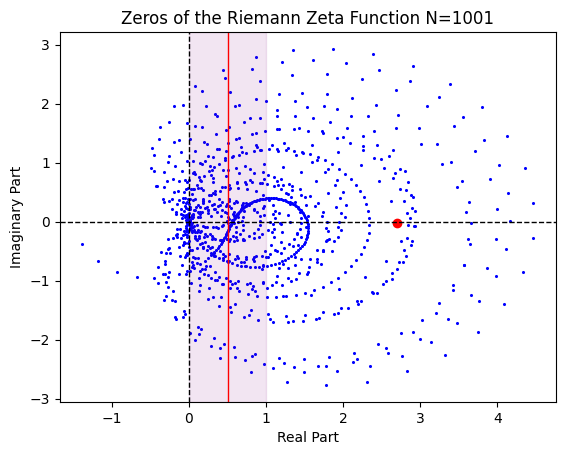

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


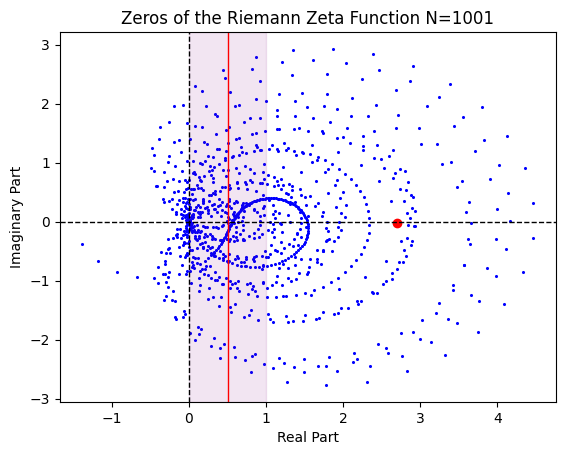

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


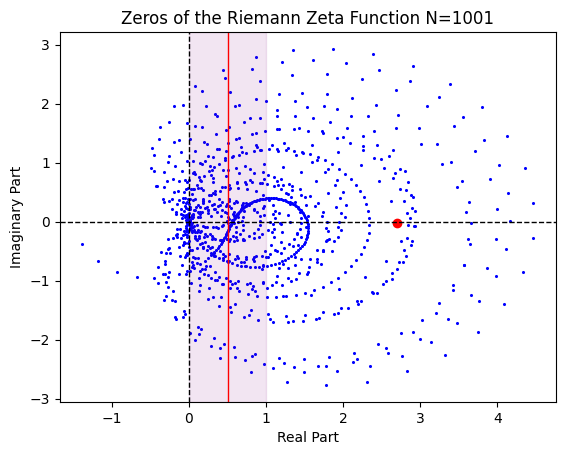

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


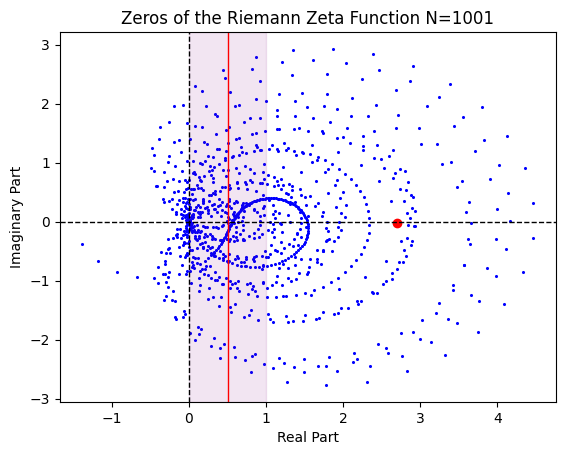

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


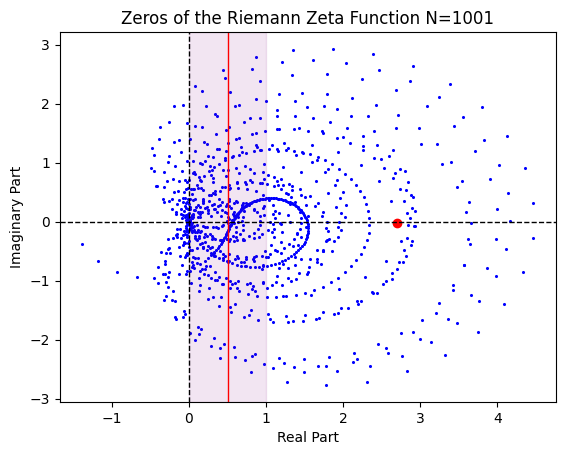

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


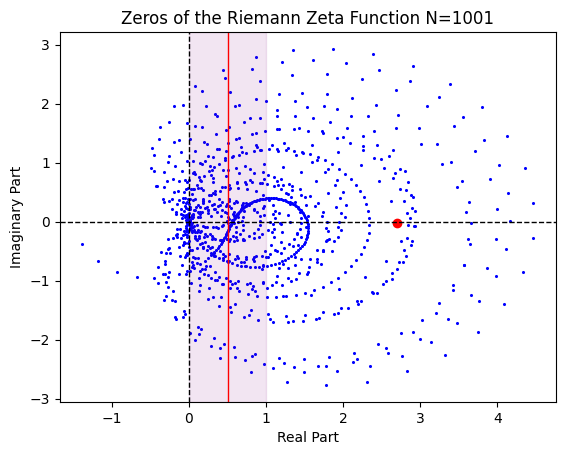

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


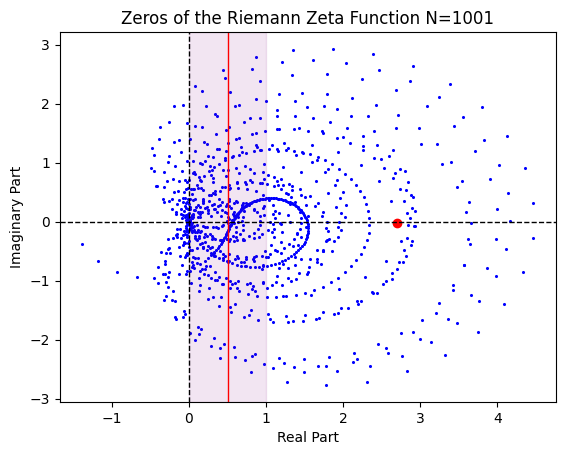

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


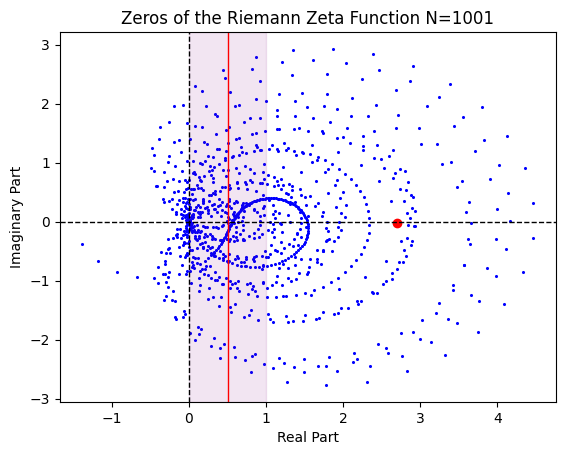

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


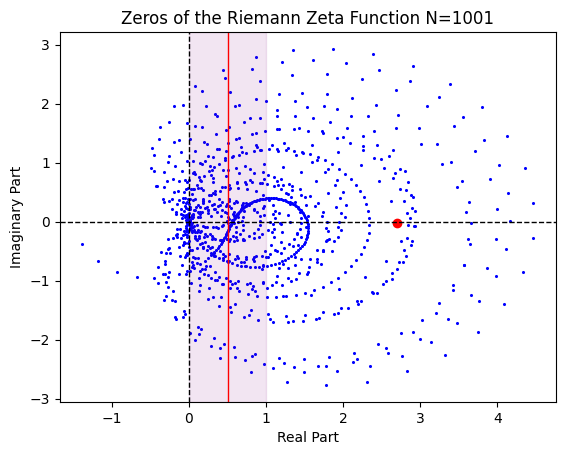

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


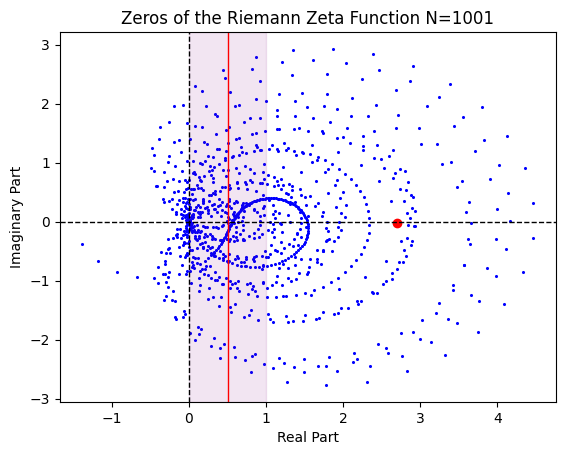

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


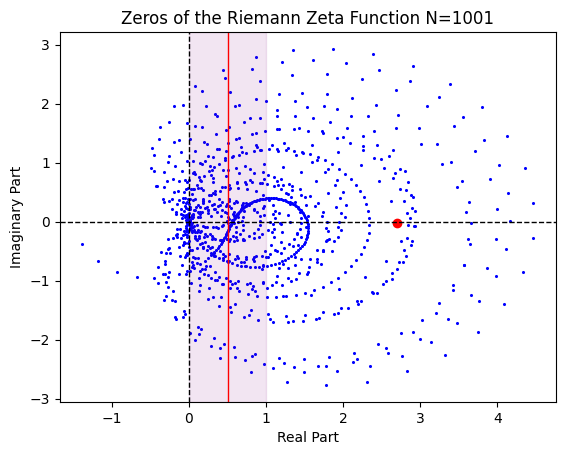

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


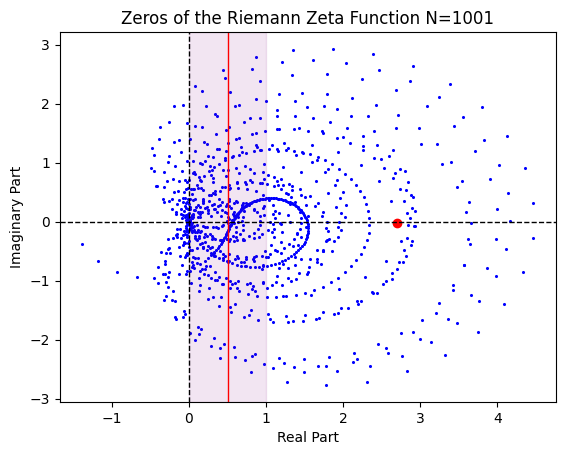

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


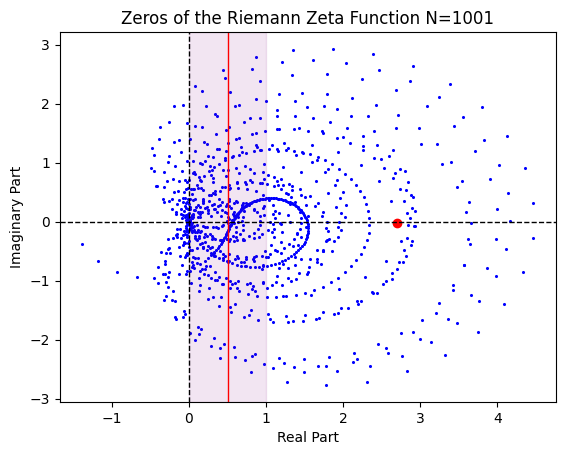

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


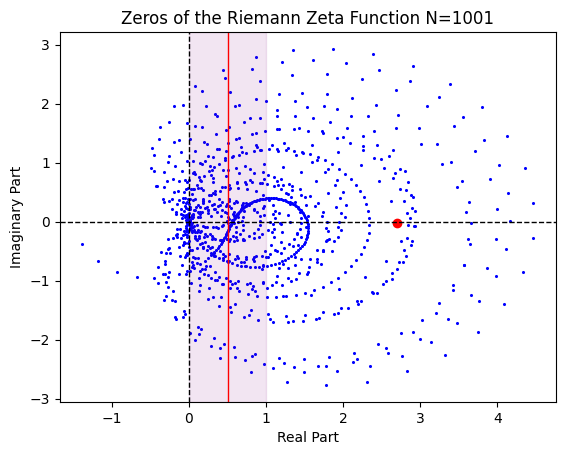

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


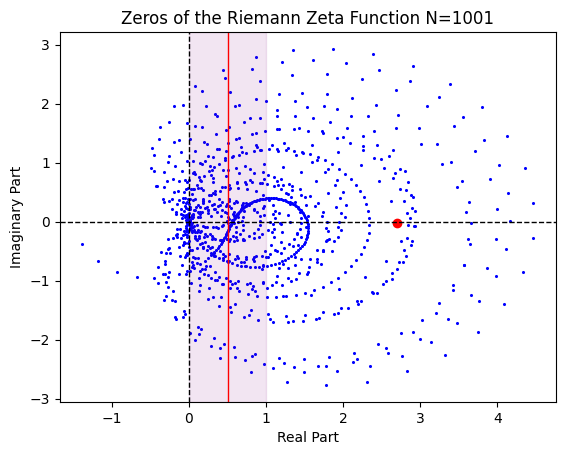

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


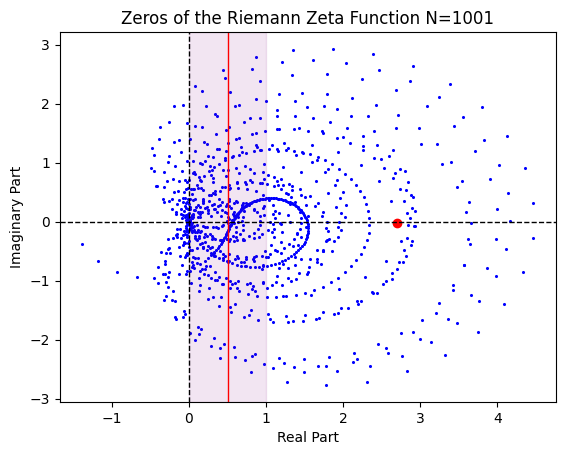

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


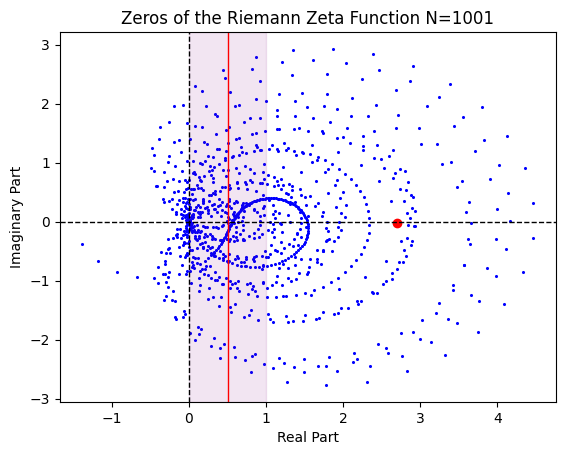

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


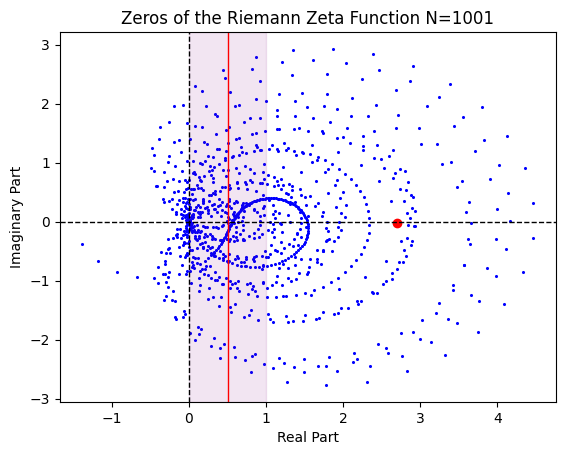

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


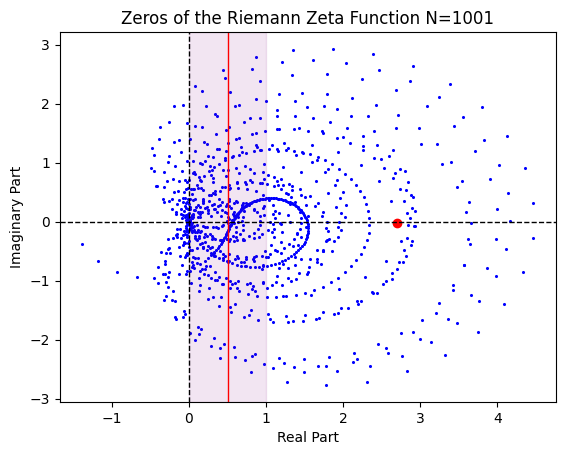

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


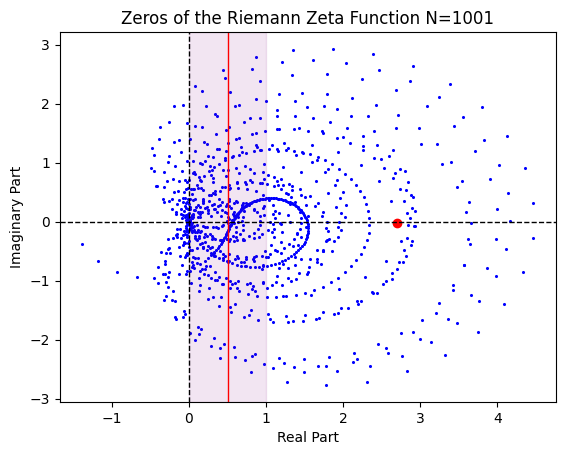

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


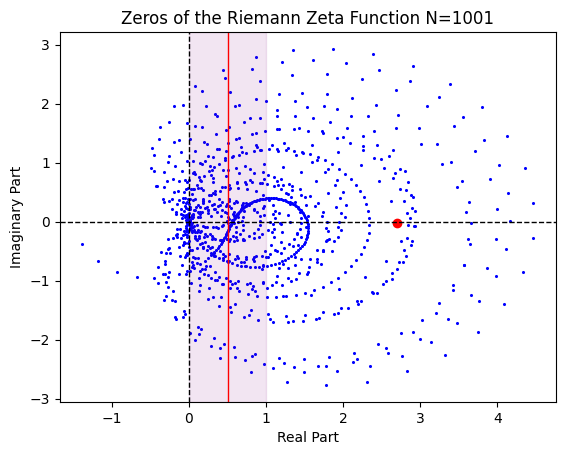

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


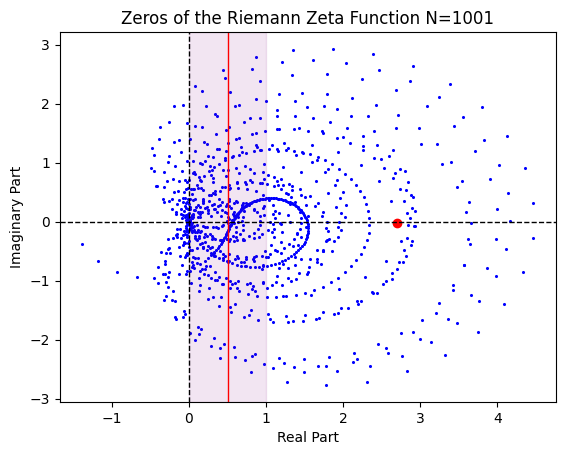

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


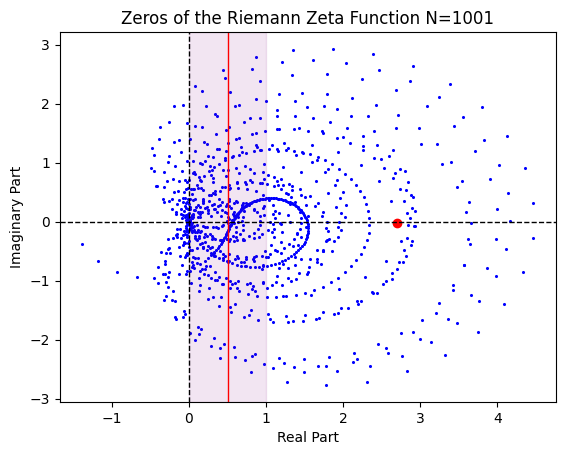

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


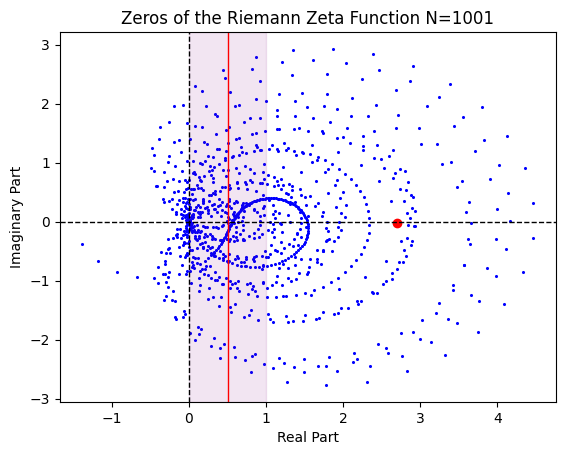

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


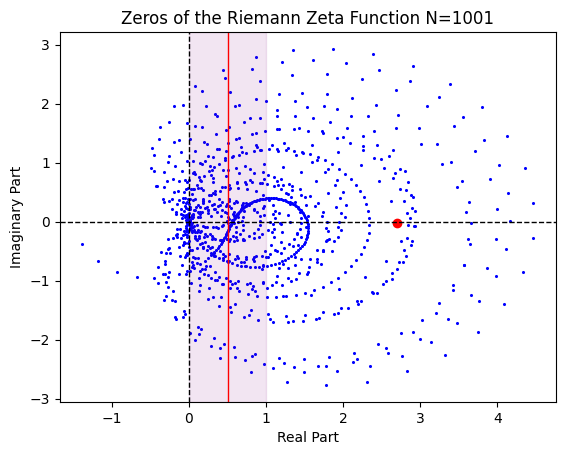

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


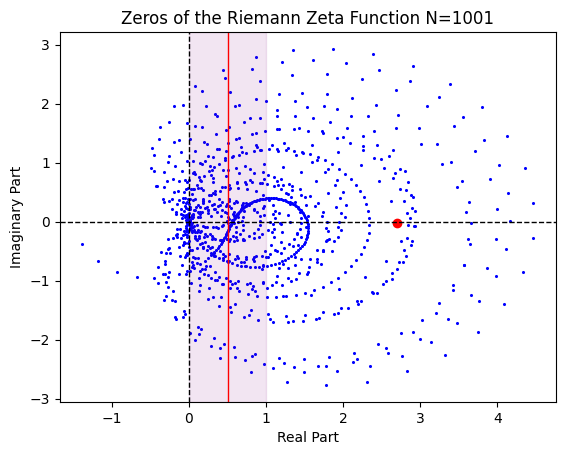

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


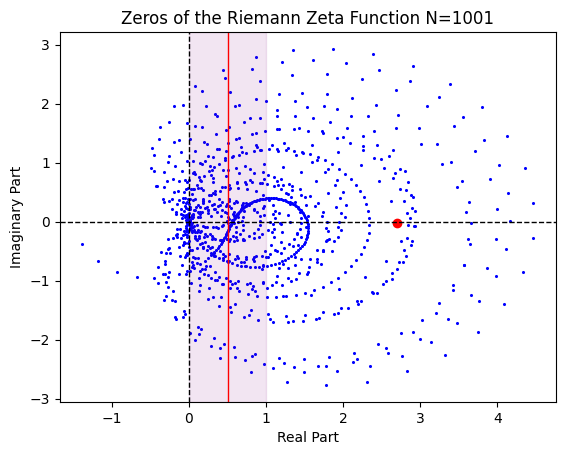

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


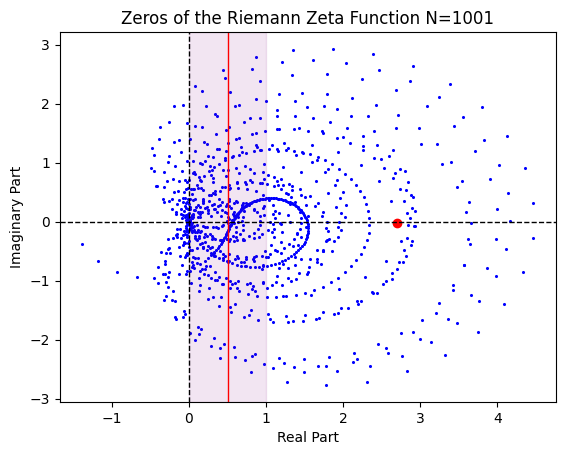

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


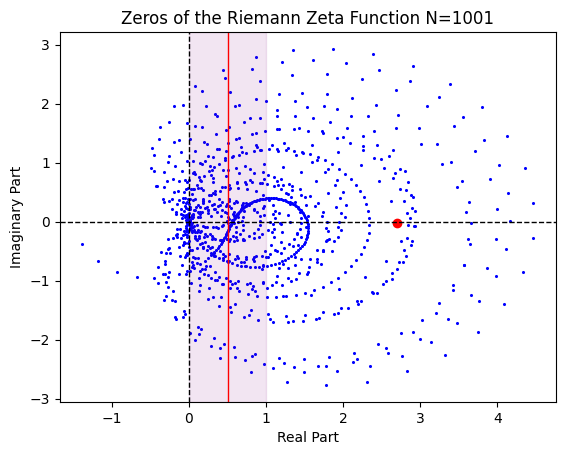

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


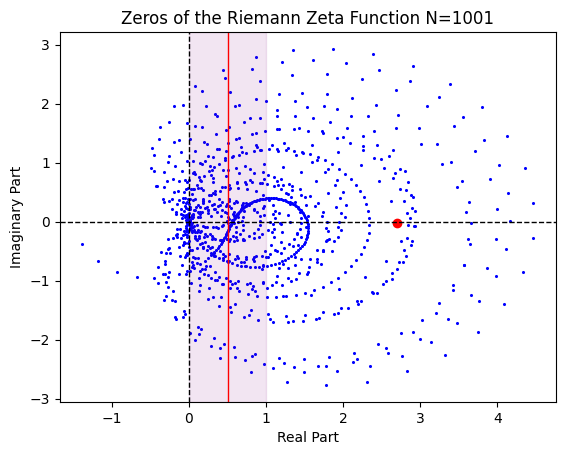

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


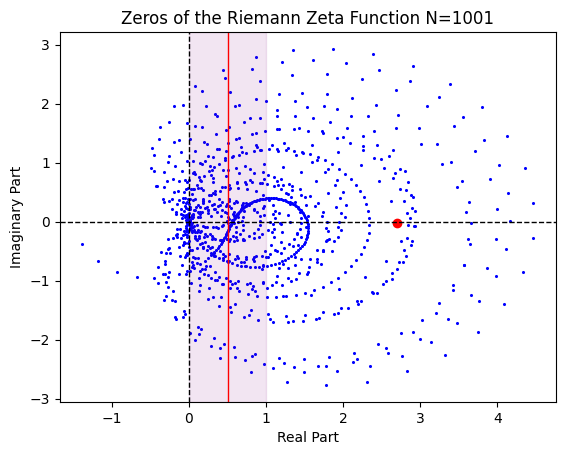

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


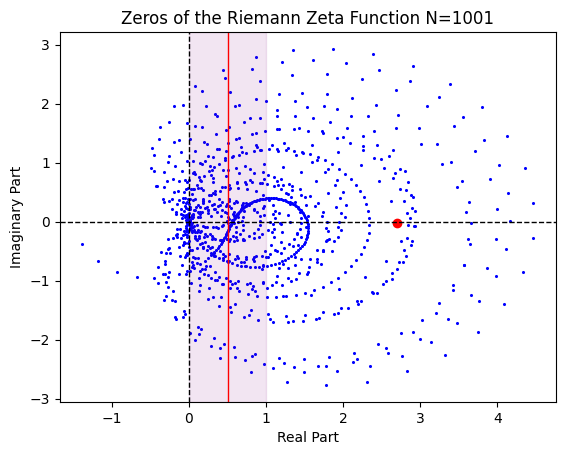

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


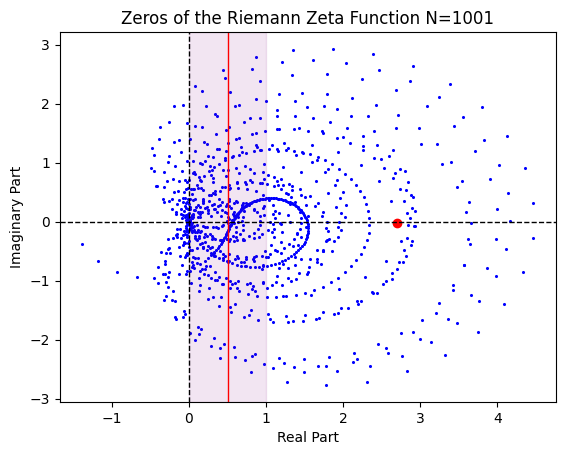

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


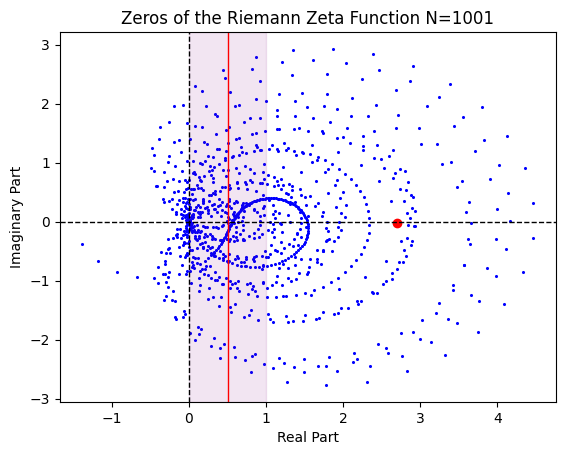

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


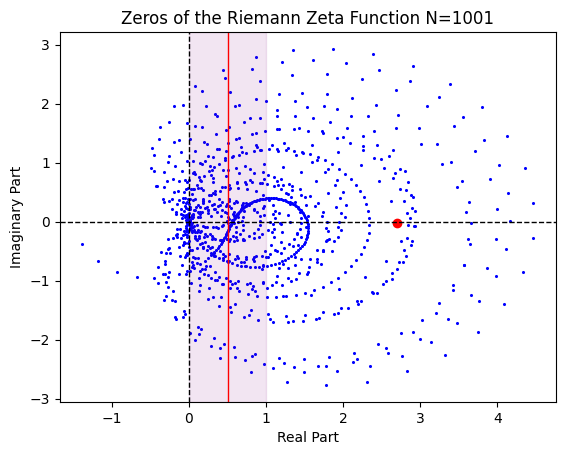

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


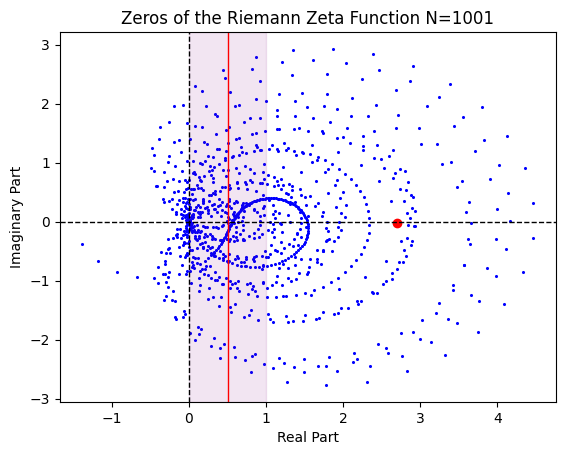

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


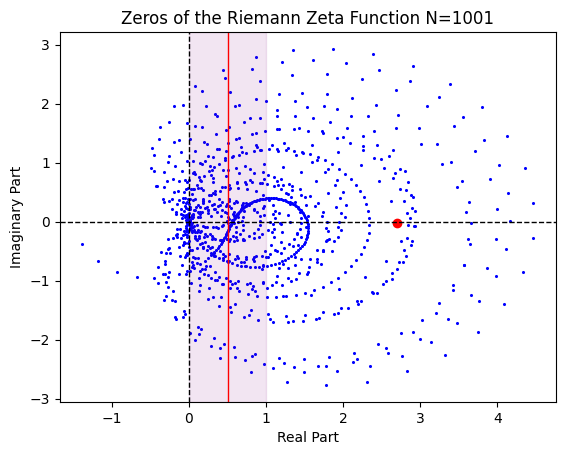

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


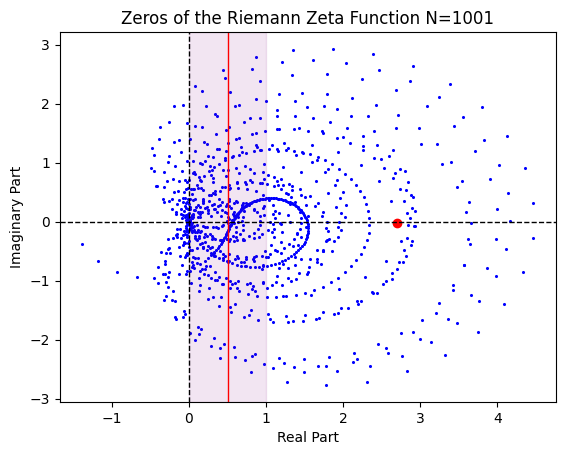

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


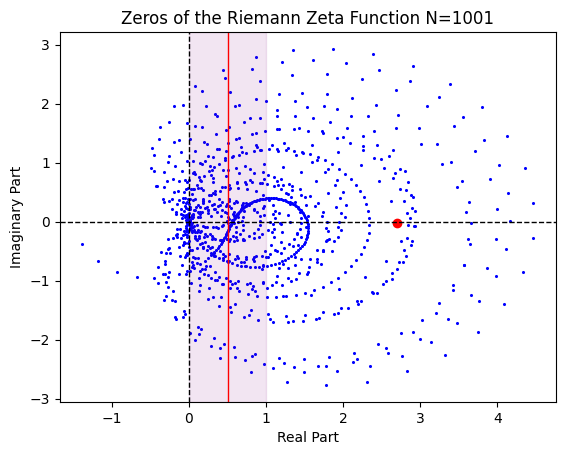

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


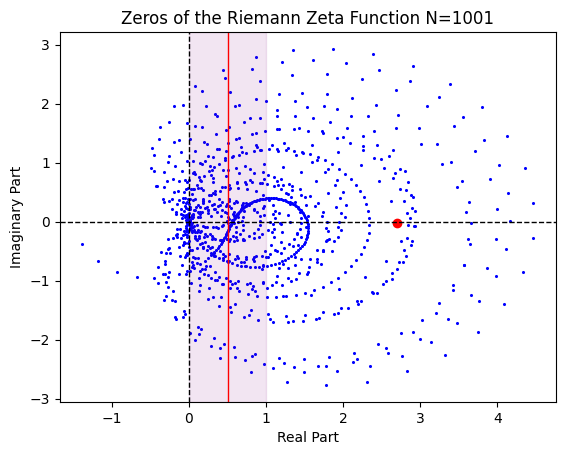

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


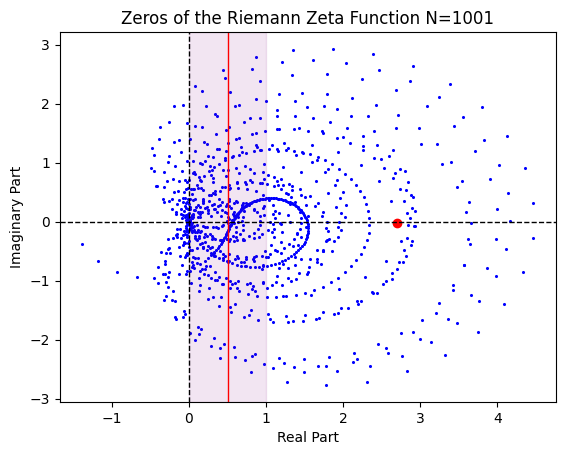

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


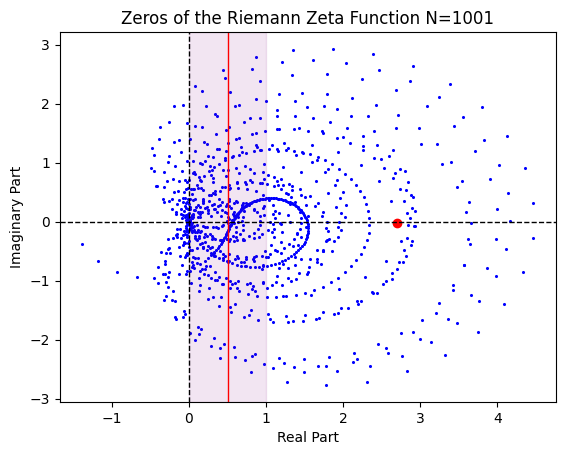

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


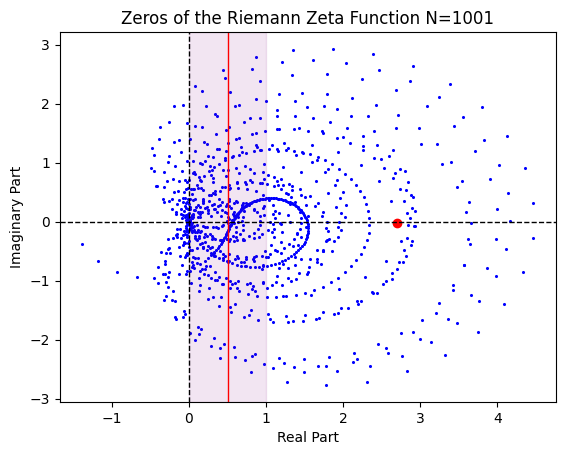

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


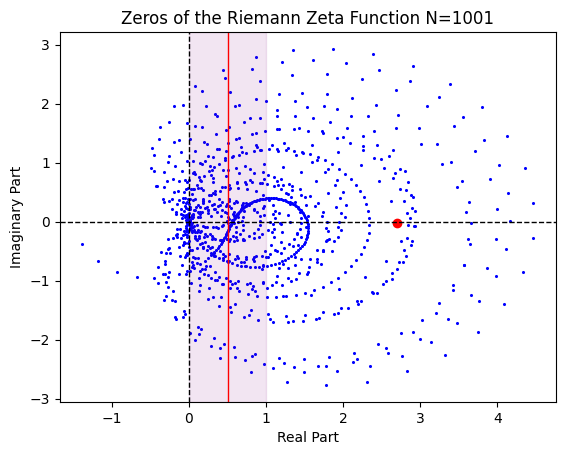

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


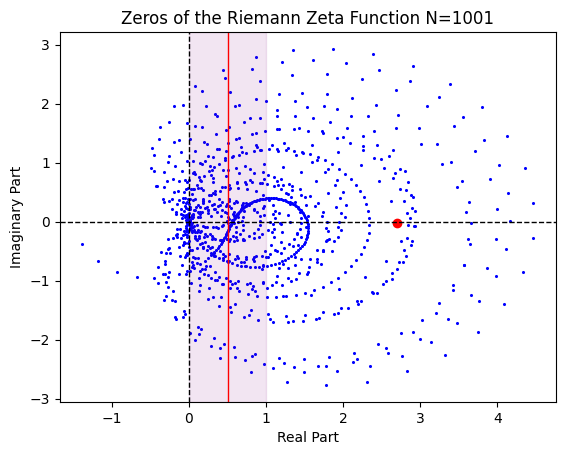

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


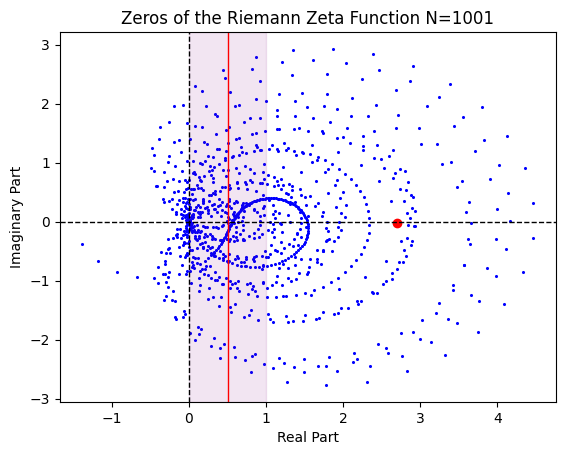

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


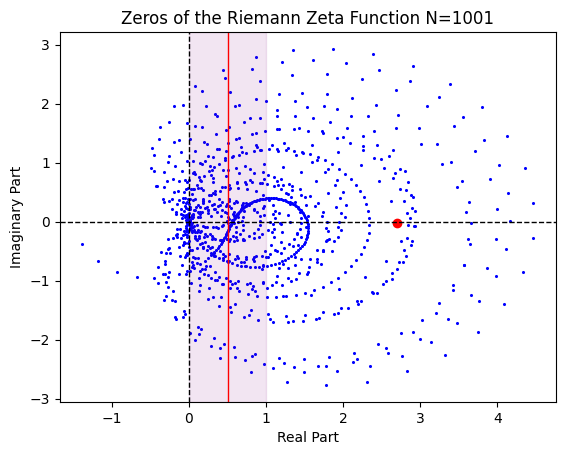

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


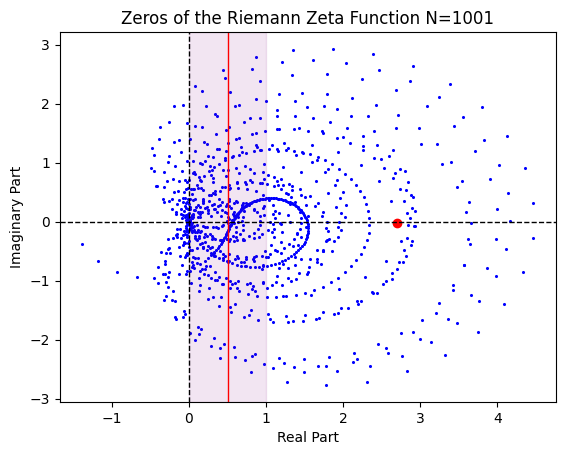

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


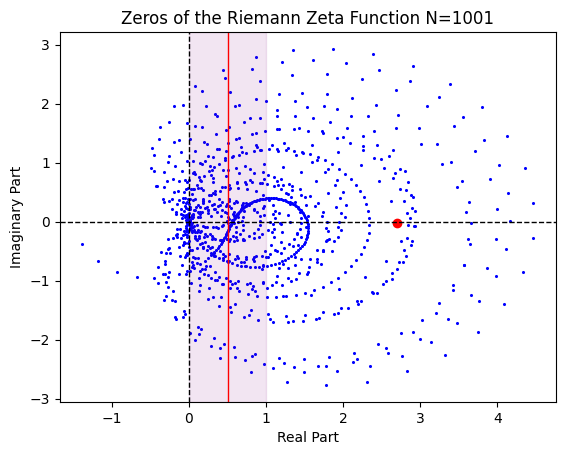

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


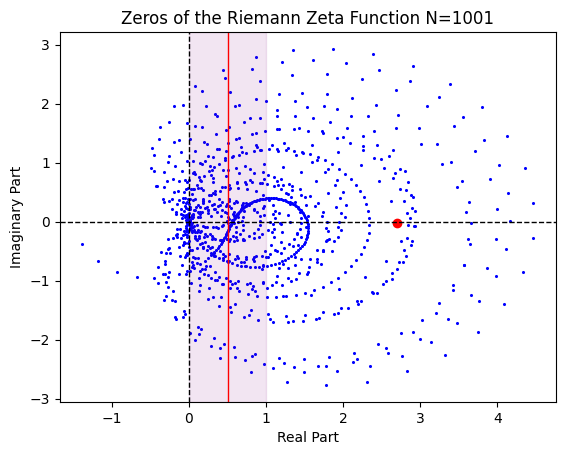

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


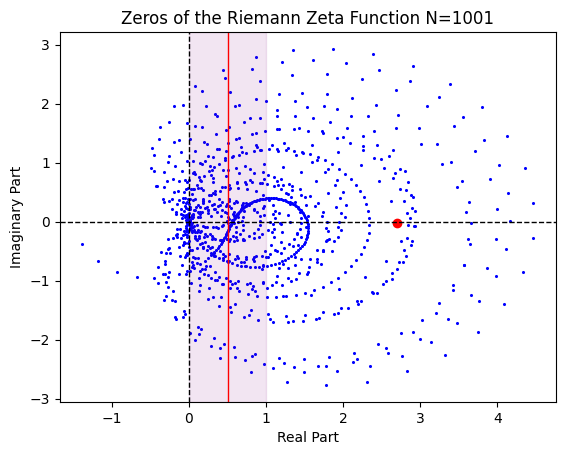

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


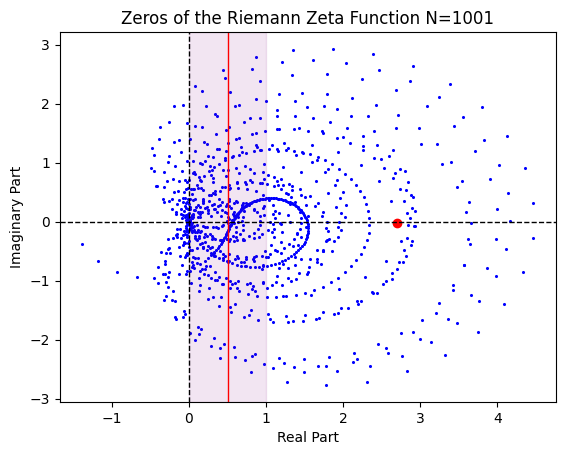

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


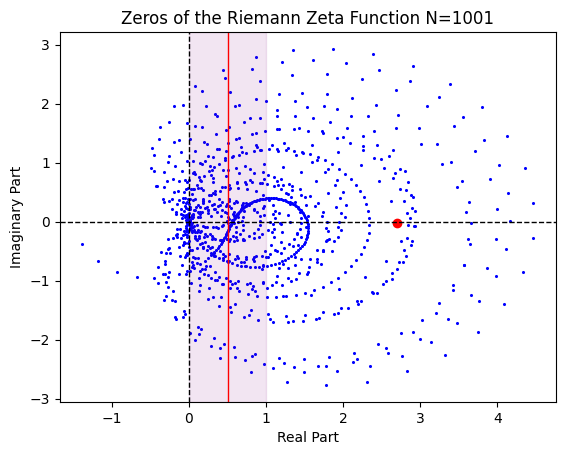

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


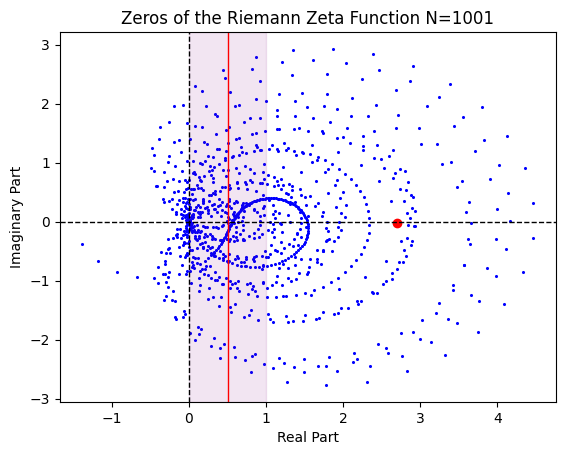

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


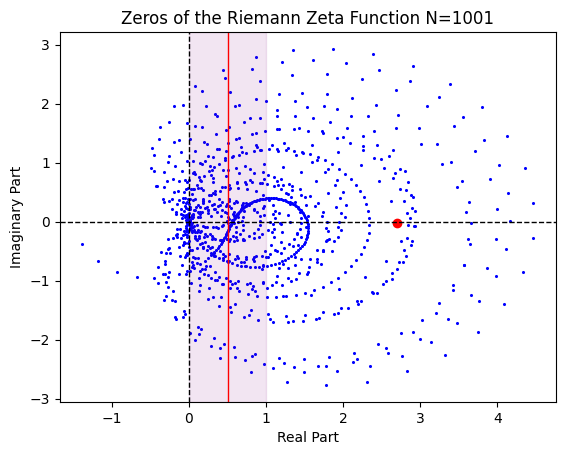

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


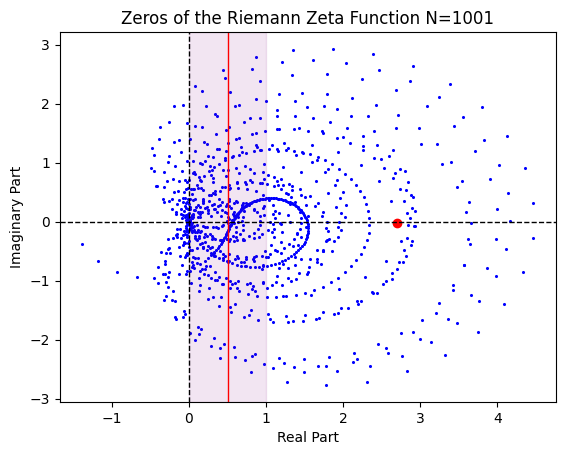

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


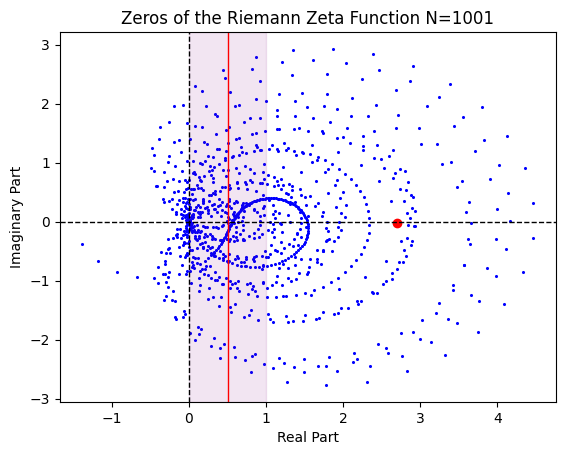

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


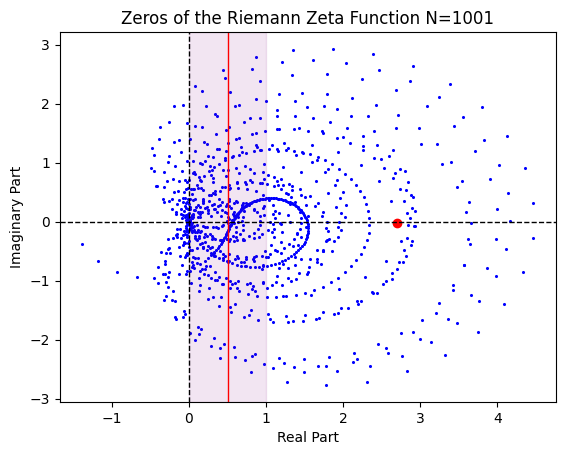

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


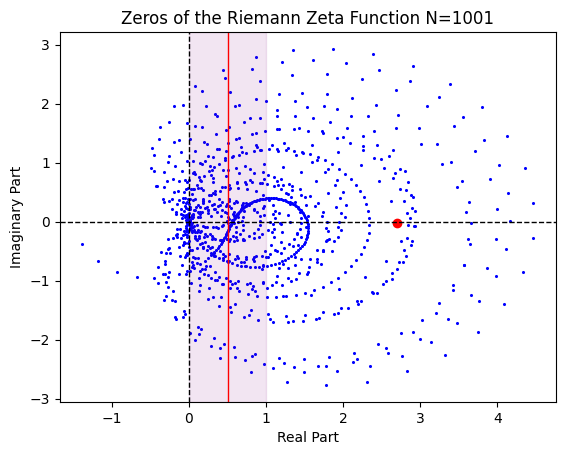

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


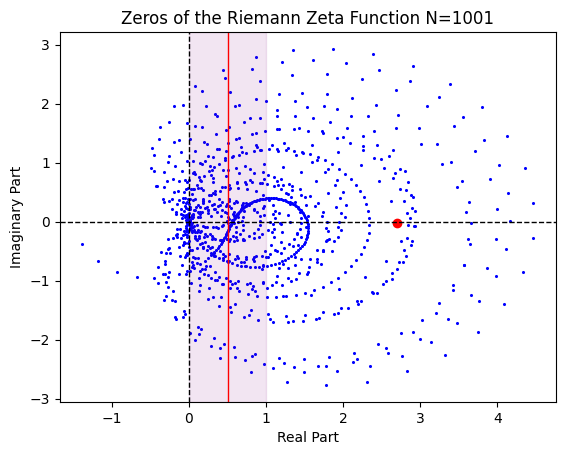

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


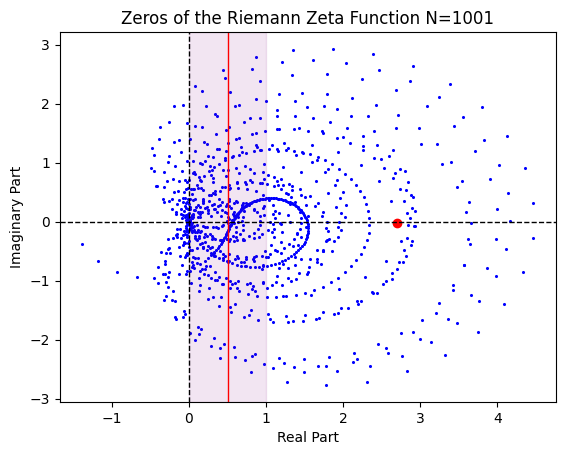

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


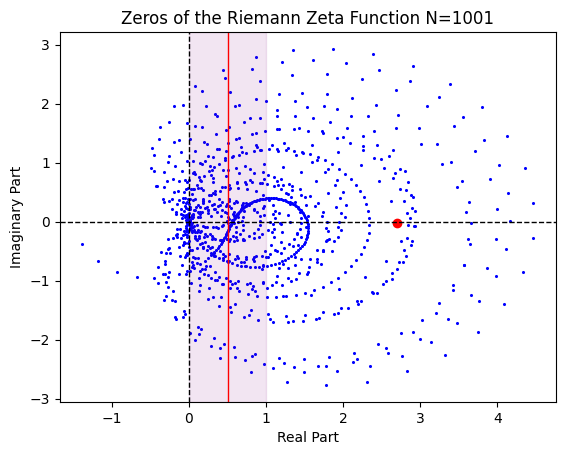

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


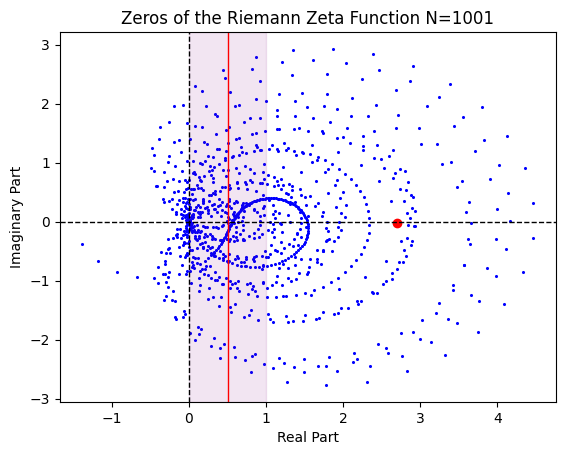

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


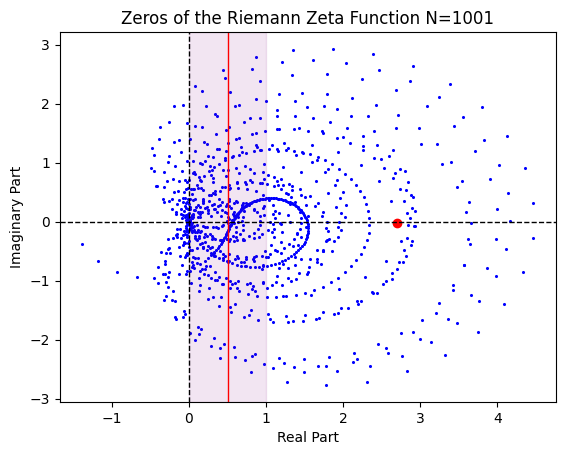

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


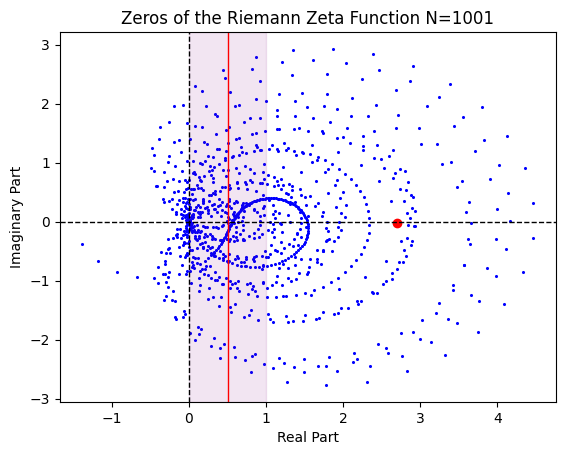

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


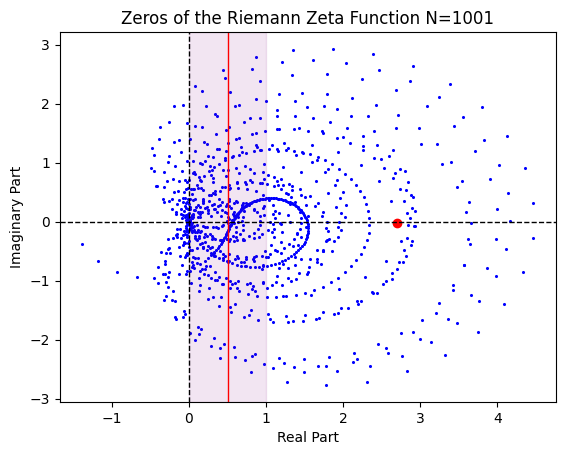

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


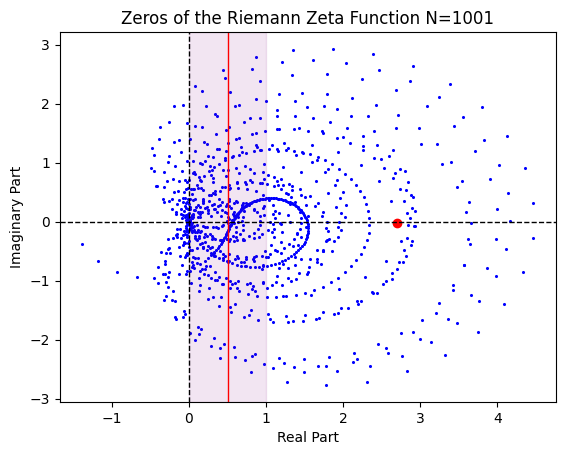

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


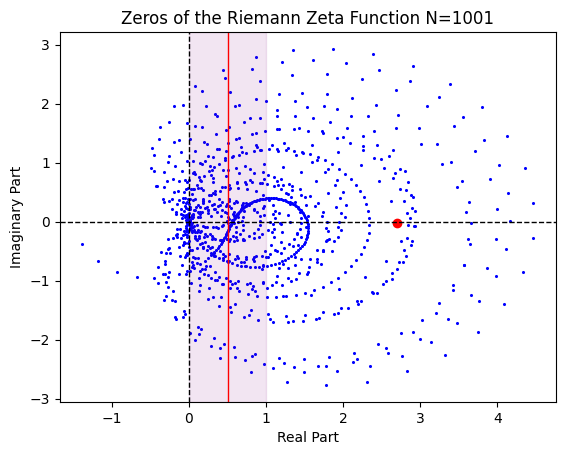

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


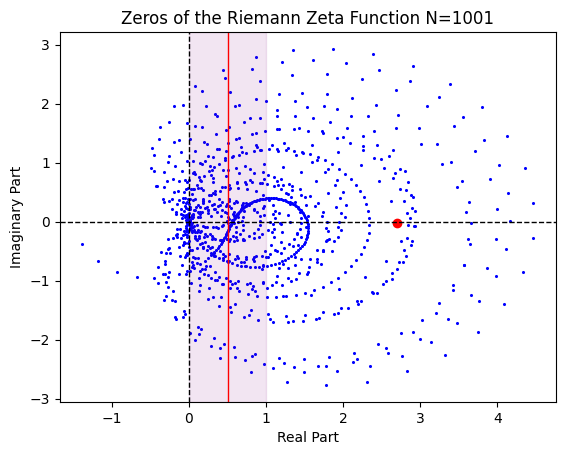

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


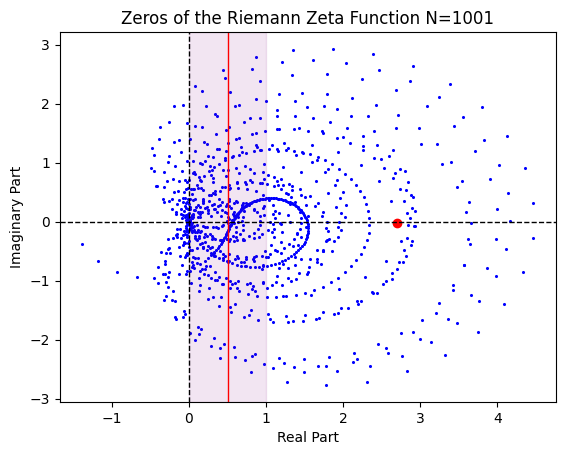

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


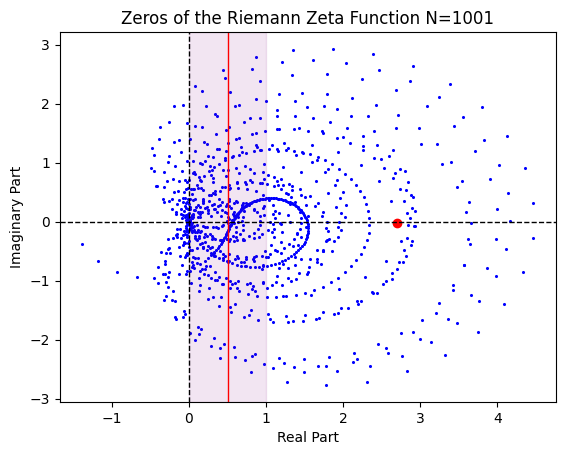

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


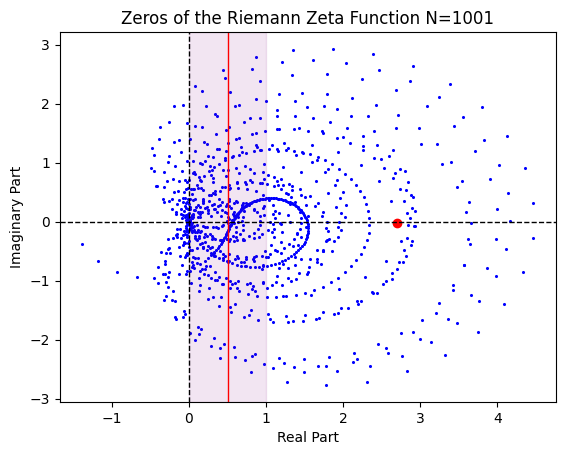

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


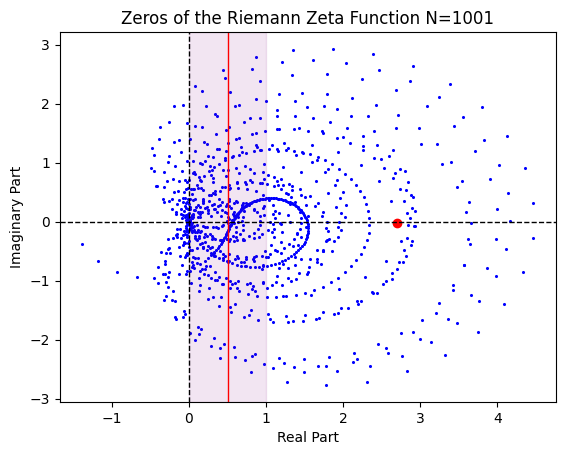

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


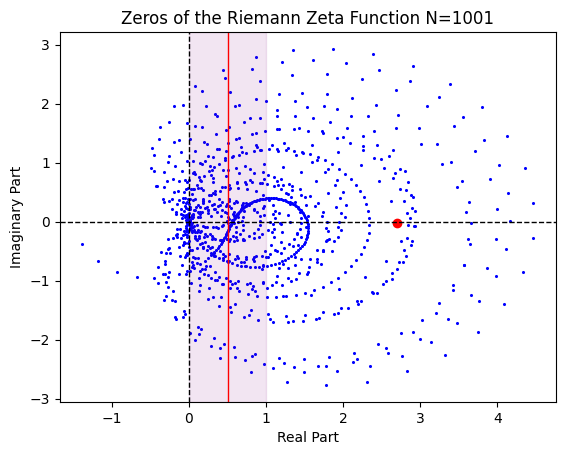

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


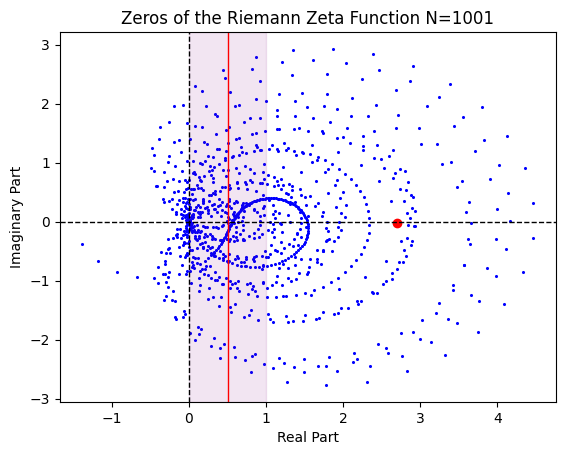

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


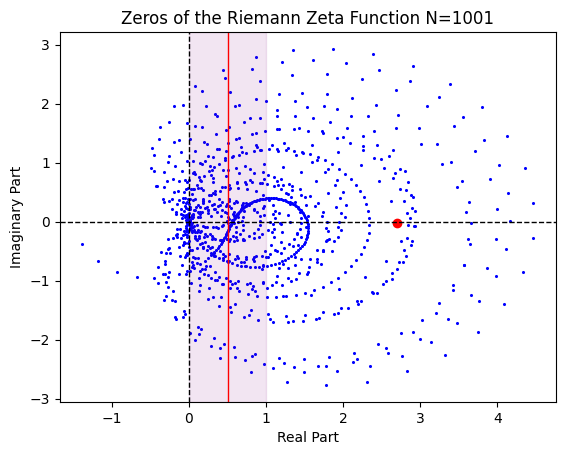

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


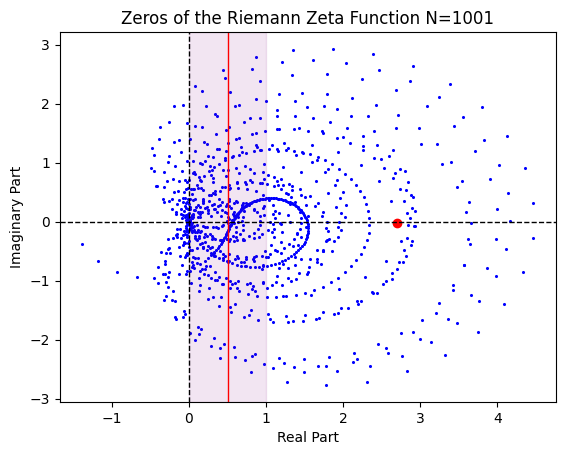

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


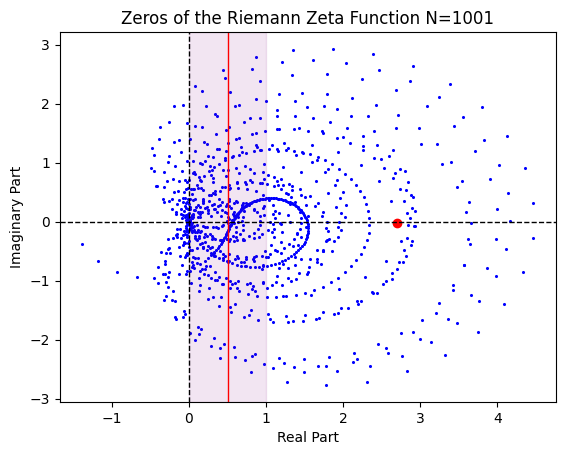

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


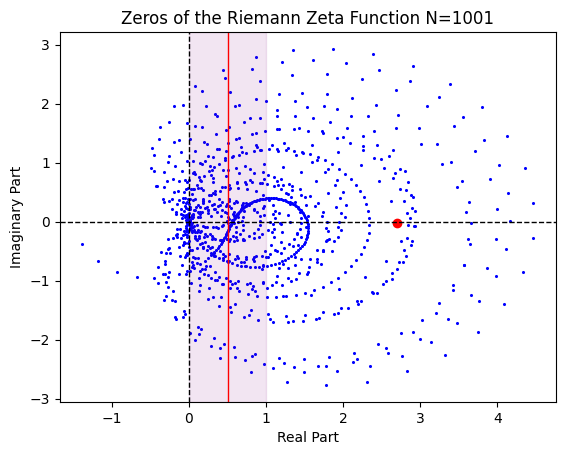

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


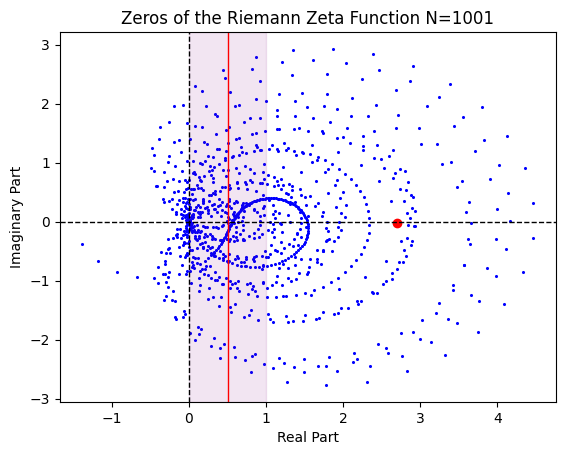

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


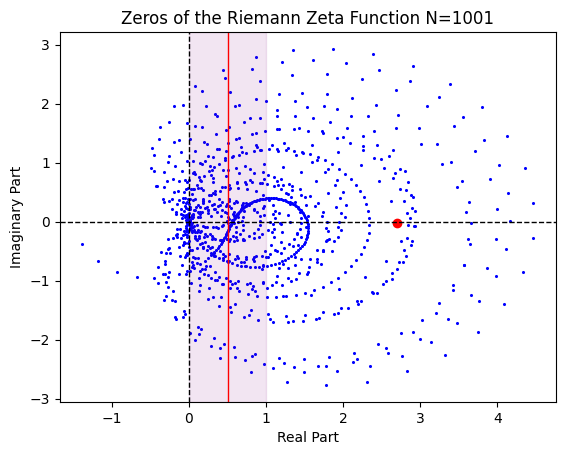

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


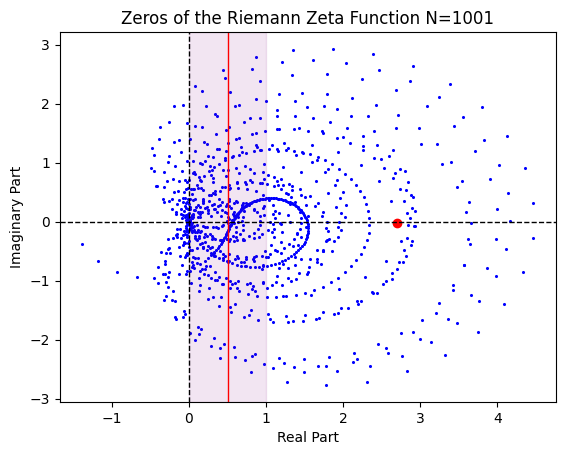

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


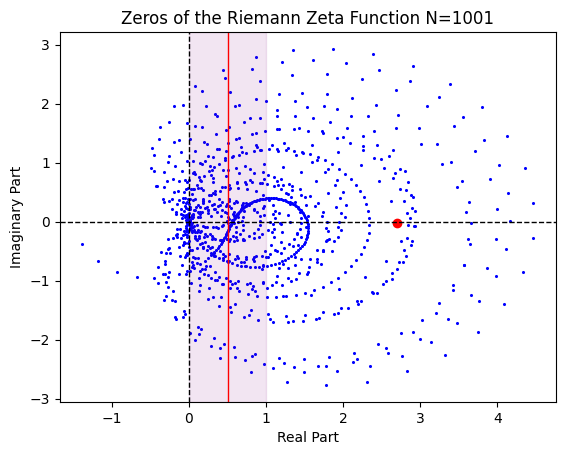

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


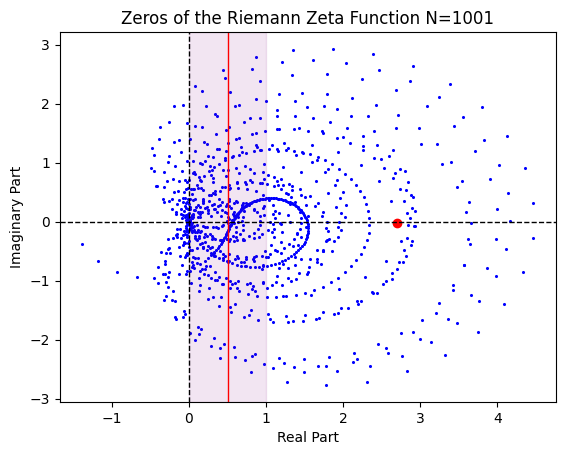

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


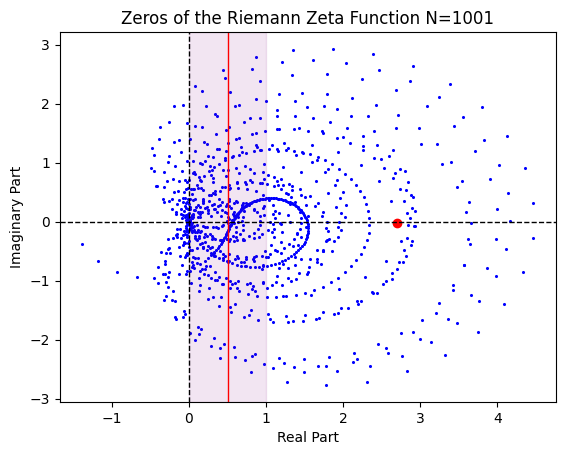

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


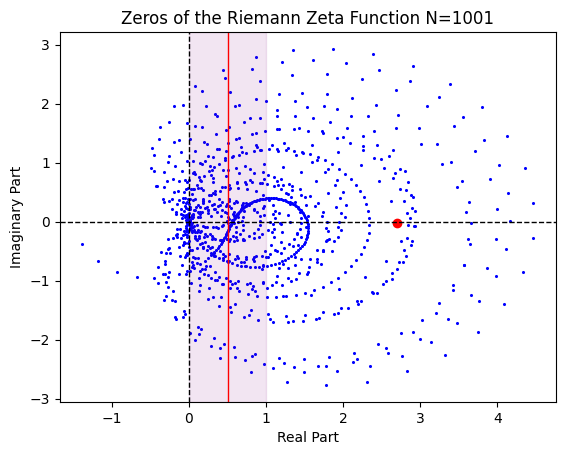

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


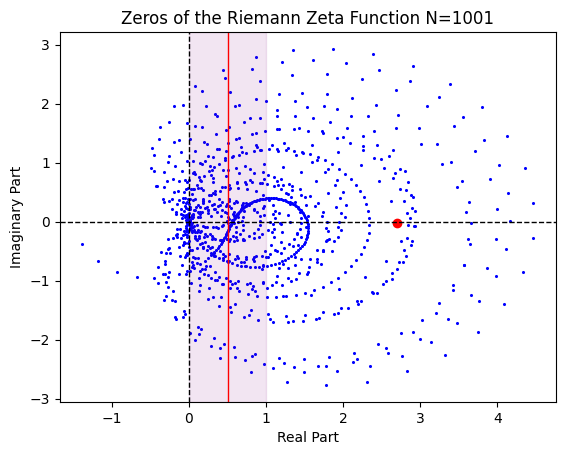

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


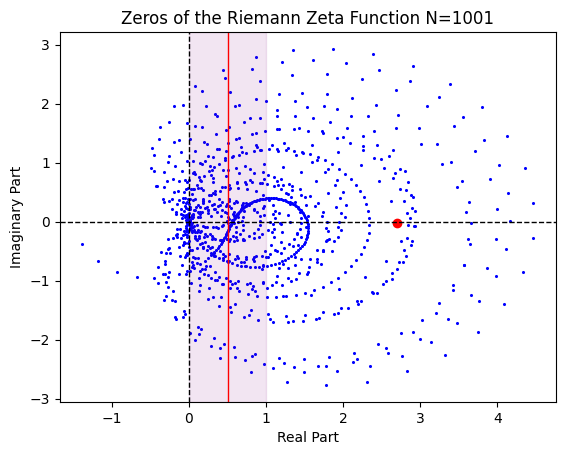

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


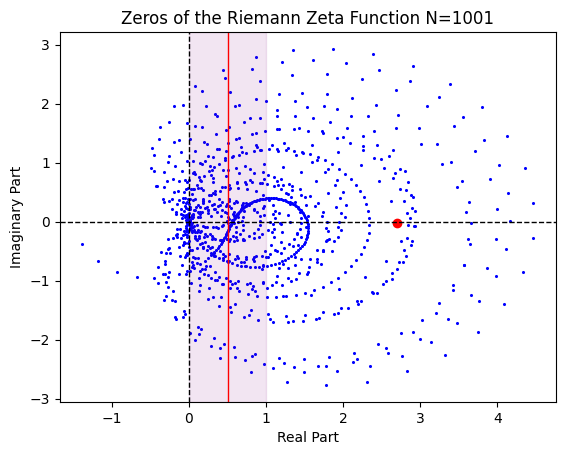

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


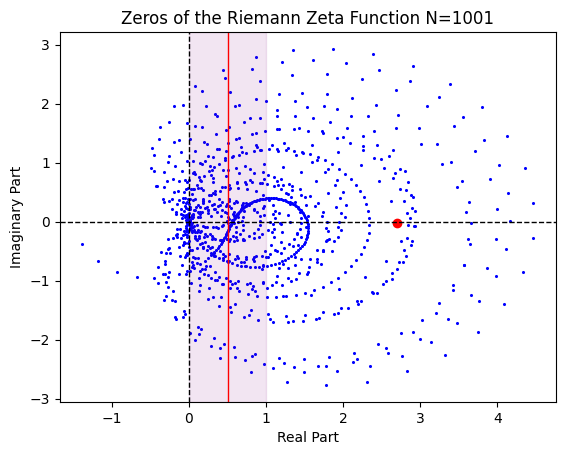

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


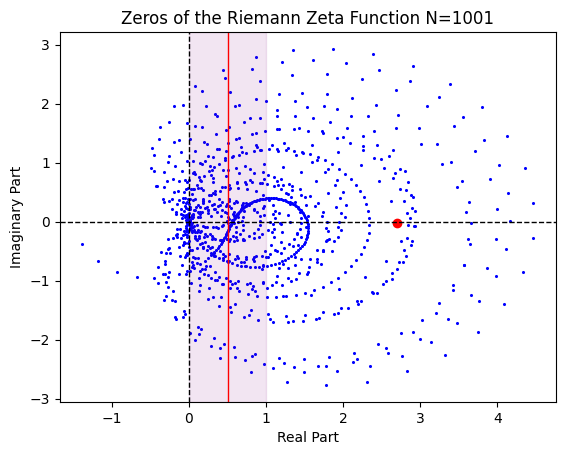

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


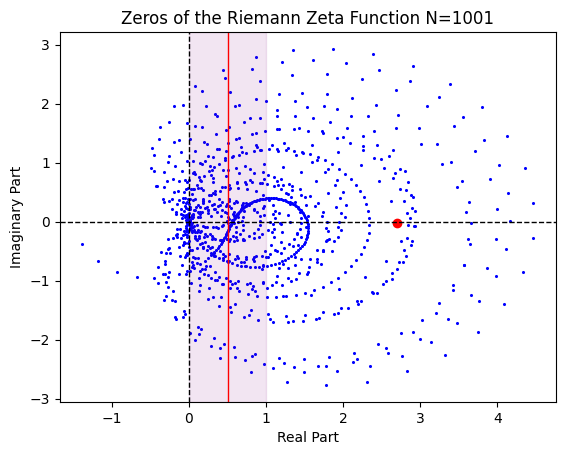

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


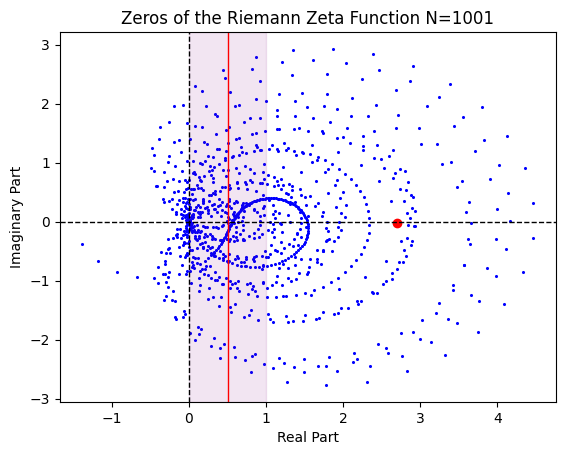

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


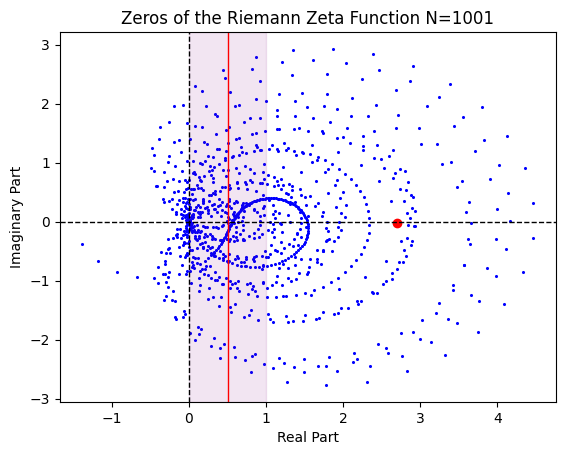

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


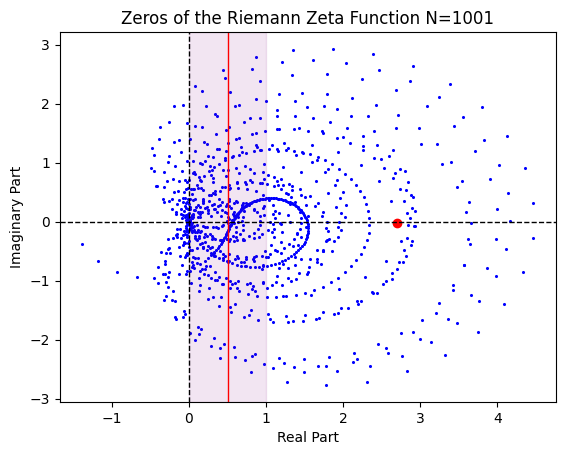

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


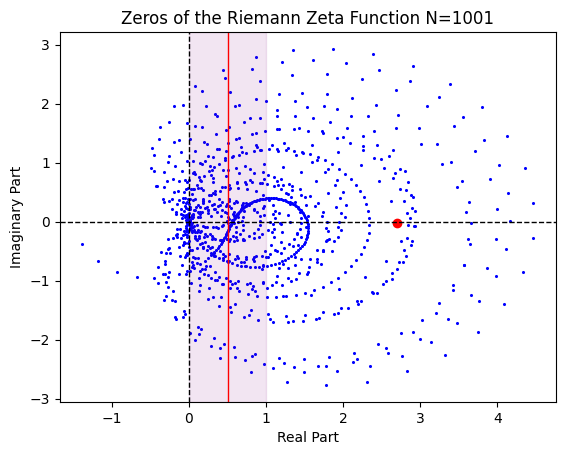

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


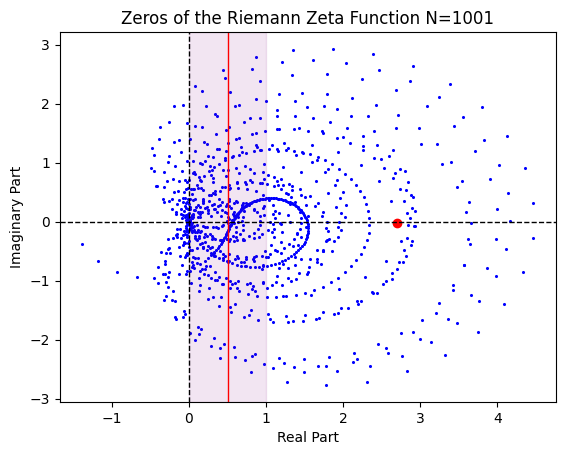

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


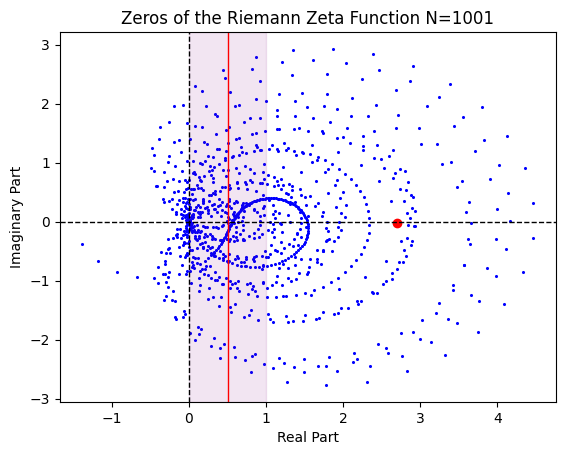

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


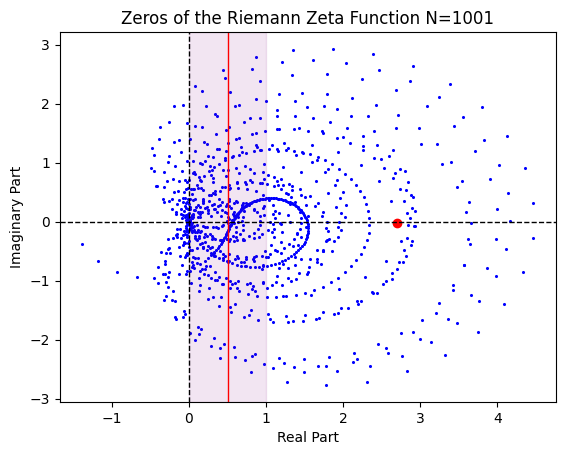

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


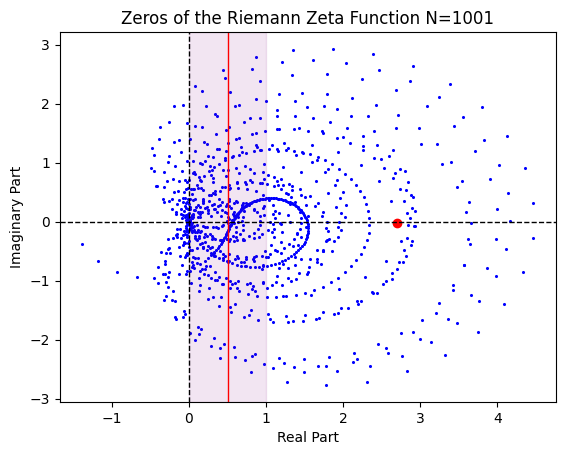

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


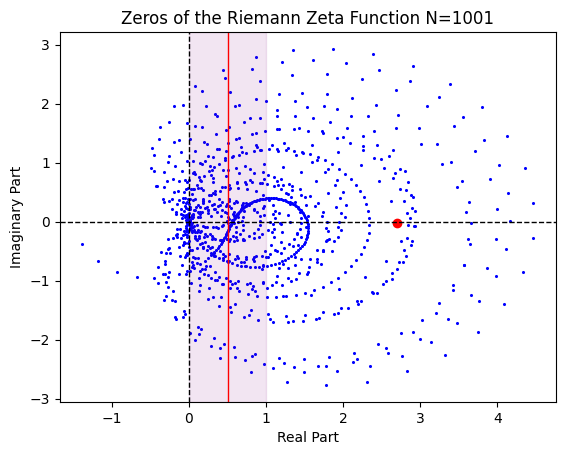

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


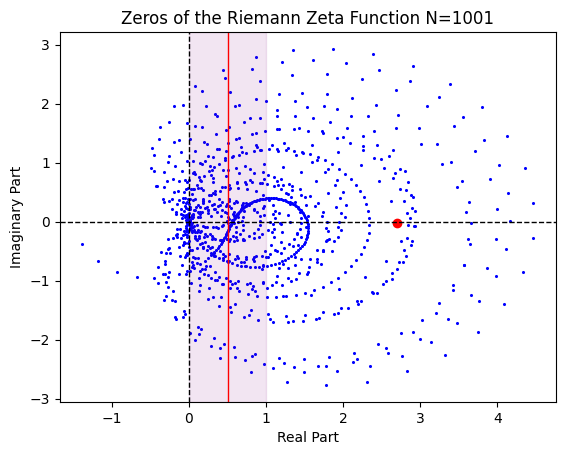

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


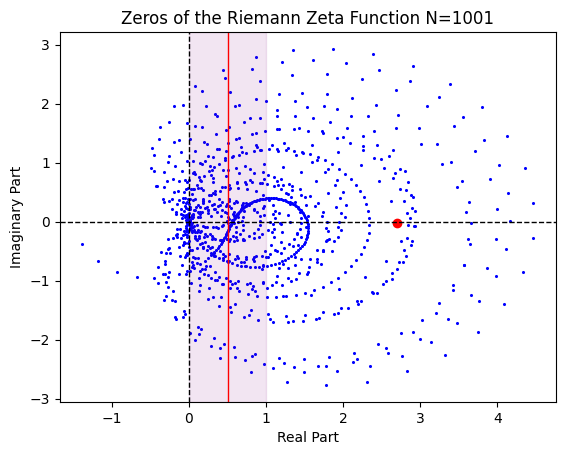

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


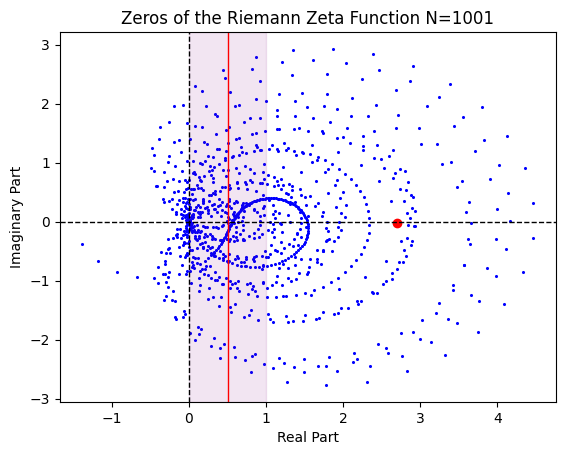

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


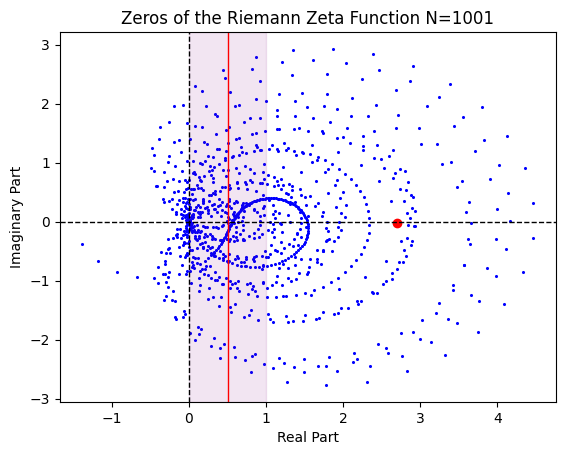

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


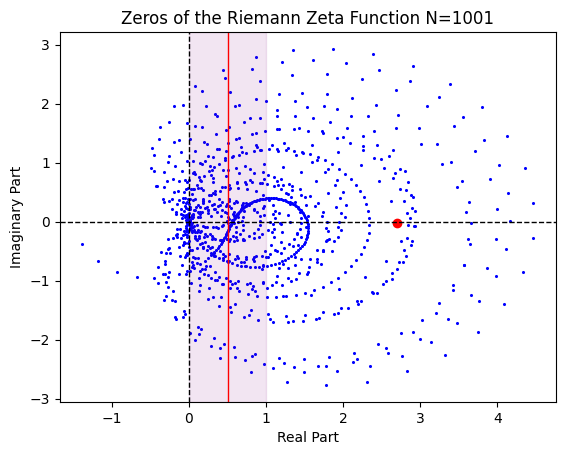

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


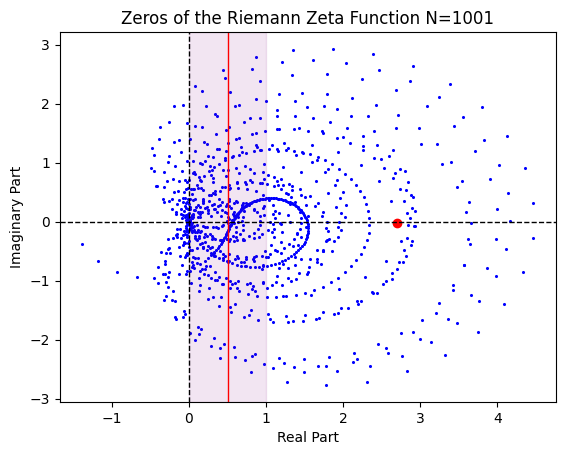

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


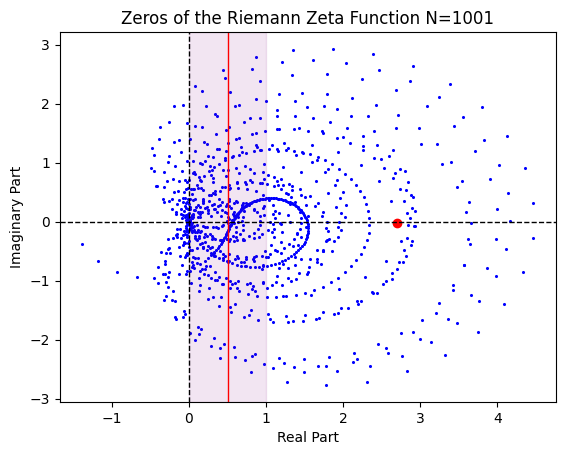

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


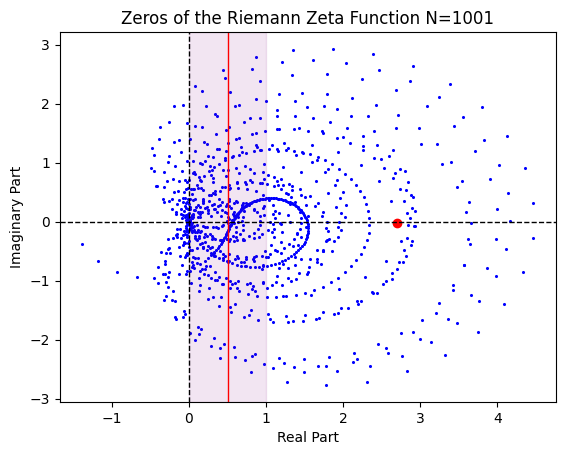

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


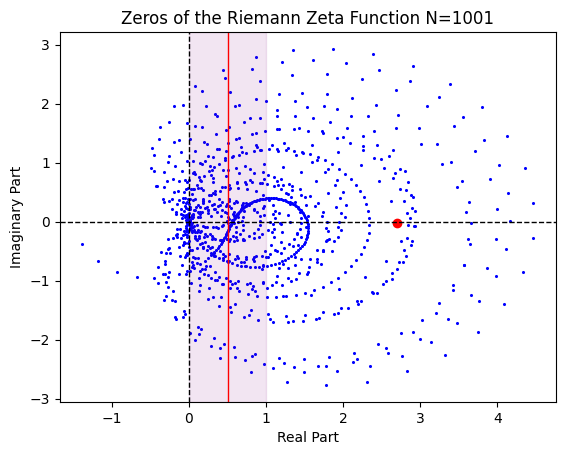

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


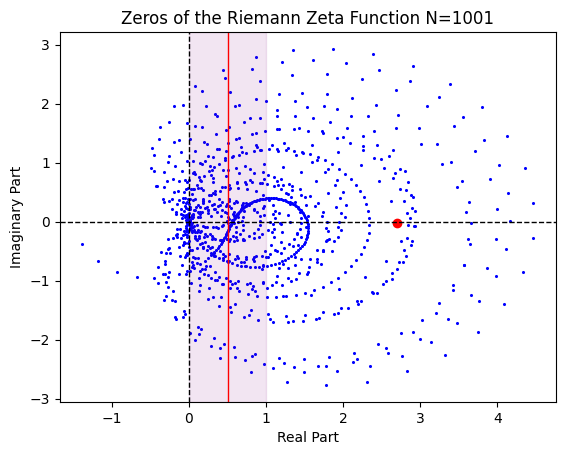

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


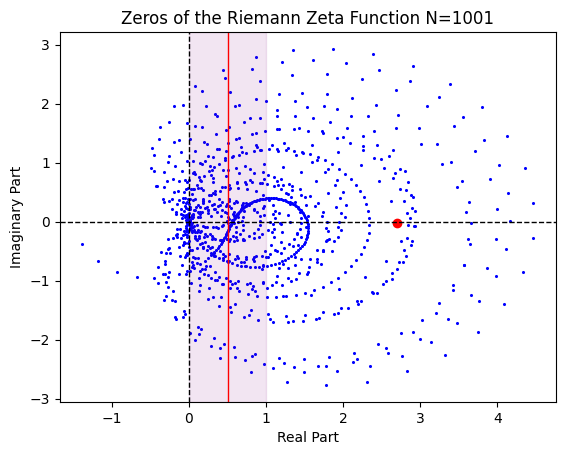

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


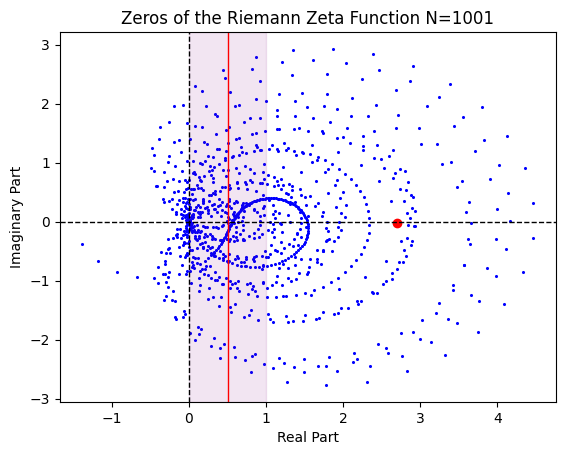

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


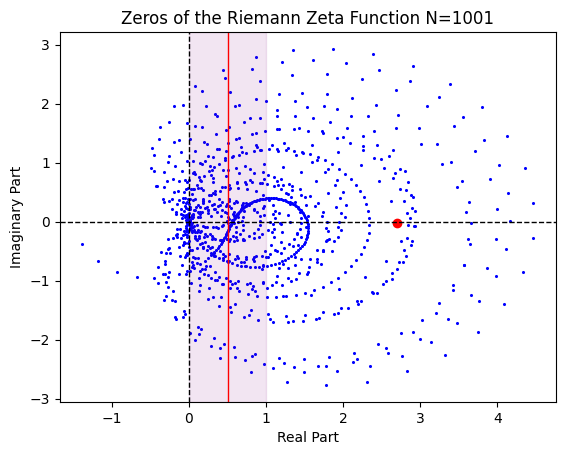

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


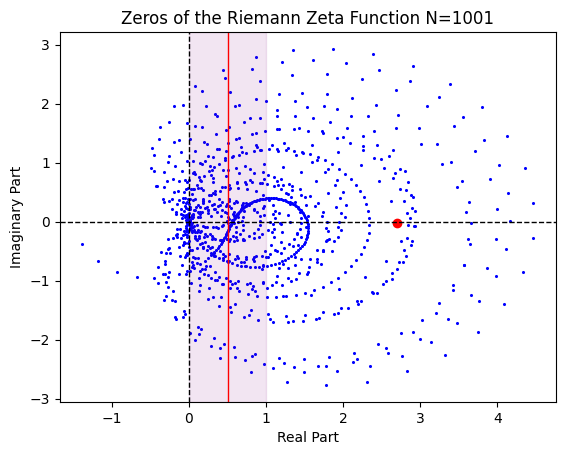

<ipython-input-23-71c181160b84>:89: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))


KeyboardInterrupt: ignored

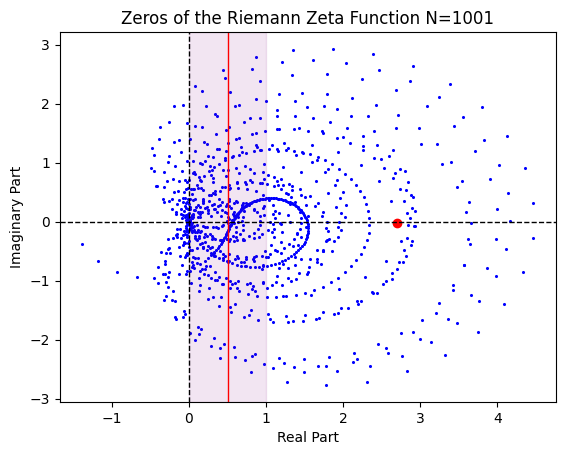

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpmath import *
import os
from google.colab import drive
import pandas as pd
from IPython.display import clear_output

# Mount Google Drive
drive.mount('/content/drive')

# Skapa en mapp i rotkatalogen
folder_path = "/content/drive/My Drive/Riemann-Zeta-Function"
os.makedirs(folder_path, exist_ok=True)

# Skapa en mapp för bilderna
image_folder = "/content/drive/My Drive/Riemann-Zeta-Function/riemann_zeta_zeros_frames"
os.makedirs(image_folder, exist_ok=True)

# Filväg för bildramarna
image_file_path = os.path.join(image_folder, 'riemann_zeta_zeros_frame_latest.png')

# Läs in det senaste värdet för N om filen finns
file_path = os.path.join(folder_path, 'riemann_zeta_zeros_table.csv')

# Läs in det senaste värdet från CSV-filen som en DataFrame med pandas
if os.path.exists(file_path) and os.path.getsize(file_path) > 0:
    # Läs in CSV-filen som en DataFrame med pandas
    df = pd.read_csv(file_path)

    # Hämta det senaste värdet av N
    N = df.shape[0]  # Antalet rader i DataFrame är det senaste värdet av N
else:
    df = pd.DataFrame(columns=['Real', 'Imaginary'])
    N = 0

# Set the number of continuous time steps
T = 100

# Calculate the time step size
if N == 0:
    N = 1

dt = 1.0 * T / N
tt = np.linspace(0.0, N * dt, N + 1000)

# Initialize the arrays to store the real and imaginary parts of the zeros
re_z = np.zeros(1000)
im_z = np.zeros(1000)

# Initialize the animation figure and axes
fig, ax = plt.subplots(figsize=(10, 10), frameon=False)

# Set the axes limits
ax.set_xlim([-2, 6])
ax.set_ylim([-3, 3])

# Remove the upper and right axes
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')

# Set the tick labels size
ax.tick_params(labelsize=16)

# Add a text label
plt.gcf().text(0.6, 0.15, '', fontsize=22)

# Print a message to the console
print('Starting the animation...')

# Start the animation loop
while True:
    # Clear the previous plot
    plt.clf()

    # Calculate the Riemann zeta function at each point in the time vector
    for i in range(N, min(N + 1000, len(tt))):
        # Create a copy of the z variable
        new_z = zeta(0.5 + tt[i] * j)

        # Append the real and imaginary parts of z to the re_z and im_z lists
        re_z[i % 1000] = float(new_z.real)
        im_z[i % 1000] = float(new_z.imag)

        # Uppdatera variabeln N
        N += 1

    # Lägg till nya värden i DataFrame
    df = df.append(pd.DataFrame({'Real': re_z, 'Imaginary': im_z}))

    # Plot the zeros with smaller blue dots
    plt.scatter(re_z, im_z, c='blue', marker='o', label='Zeros', s=1.5)

    # Markera punkter som ligger på linjen s = 1/2 + t * i
    t_value = 2 * tt[i] - 1
    if np.isclose(t_value, int(t_value)):
        plt.scatter(re_z[i % 1000], im_z[i % 1000], c='red', marker='o', label='Selected Zero')

    plt.xlabel('Real Part')
    plt.ylabel('Imaginary Part')
    plt.title(f'Zeros of the Riemann Zeta Function N={N}')

    # Add a horizontal line at x=0
    plt.axhline(y=0.0, color='black', linewidth=1, linestyle='--')

    # Add a vertical line at y=0
    plt.axvline(x=0.0, color='black', linewidth=1, linestyle='--')

    # Lägg till en lila markering för critical strip (mellan y=0 och y=1)
    plt.axvspan(1, 0, alpha=0.1, color='purple', label='Critical Strip')

    # Lägg till en röd linje för critical line (y=0.5)
    plt.axvline(x=0.5, color='red', linewidth=1, linestyle='-', label='Critical Line')

    # Spara animeringsramen innan du ritar på figuren
    plt.savefig(image_file_path)

    # Sleep for a short interval
    plt.pause(0.01)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Starting the animation...


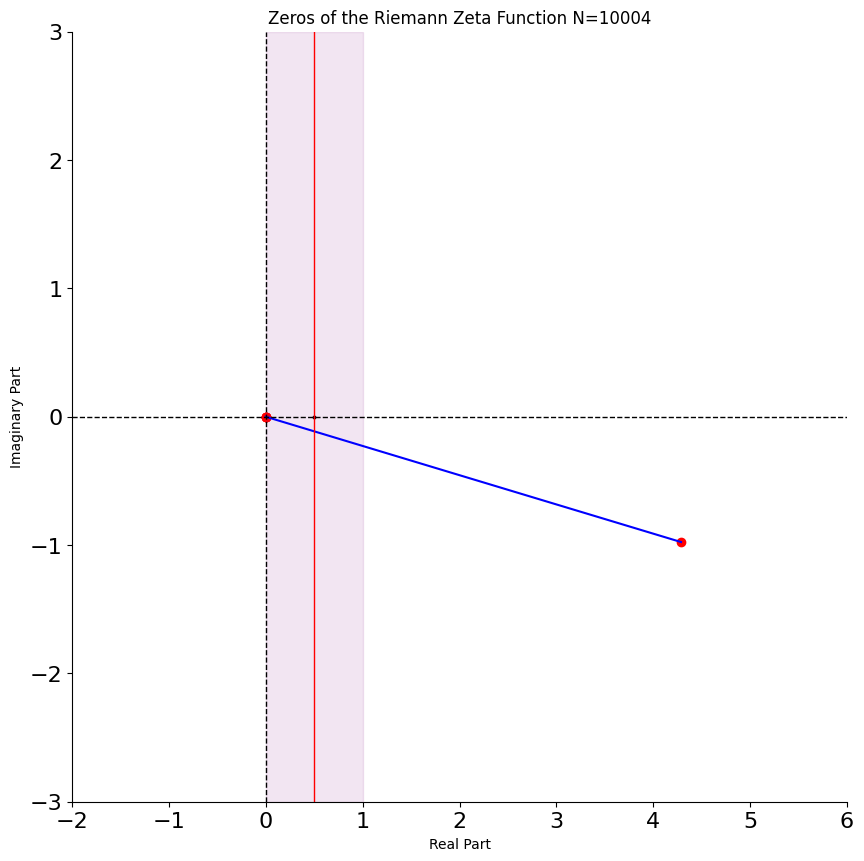

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpmath import *
import os
from google.colab import drive
import pandas as pd
import time
from IPython.display import clear_output

# Mount Google Drive
drive.mount('/content/drive')
time.sleep(2)

# Skapa en mapp i rotkatalogen
folder_path = "/content/drive/My Drive/Riemann-Zeta-Function"
os.makedirs(folder_path, exist_ok=True)

# Mapp för att lagra bildramarna
frames_folder_path = "/content/drive/My Drive/Riemann-Zeta-Function/riemann_zeta_zeros_frames"
os.makedirs(frames_folder_path, exist_ok=True)

# Filväg för CSV-filen
file_path = os.path.join(folder_path, 'riemann_zeta_zeros_table.csv')

# Läs in det senaste värdet för N om filen finns
if os.path.exists(file_path) and os.path.getsize(file_path) > 0:
    # Läs in CSV-filen som en DataFrame med pandas
    df = pd.read_csv(file_path)

    # Hämta det senaste värdet av N
    N = df.shape[0]  # Antalet rader i DataFrame är det senaste värdet av N
else:
    df = pd.DataFrame(columns=['Real', 'Imaginary'])
    N = 0

# Set the number of continuous time steps
T = 100

# Calculate the time step size
if N == 0:
    N = 1

dt = 1.0 * T / N
tt = np.linspace(0.0, N * dt, N + 1000)

# Initialize the arrays to store the real and imaginary parts of the zeros
re_z = np.zeros(1000)
im_z = np.zeros(1000)

# Initialize the animation figure and axes
fig, ax = plt.subplots(figsize=(10, 10), frameon=False)

# Set the axes limits
ax.set_xlim([-2, 6])
ax.set_ylim([-3, 3])

# Remove the upper and right axes
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')

# Set the tick labels size
ax.tick_params(labelsize=16)

# Print a message to the console
print('Starting the animation...')

# Lägg till en variabel för att hålla reda på den senaste inlästa bilden
latest_loaded_frame = -1

# Start the animation loop
while True:
    # Calculate the Riemann zeta function at each point in the time vector
    new_z = zeta(0.5 + tt[N] * j)

    # Append the real and imaginary parts of z to the re_z and im_z lists
    re_z[N % 1000] = float(new_z.real)
    im_z[N % 1000] = float(new_z.imag)

    # Lägg till nya värden i DataFrame
    # df = df.append(pd.DataFrame({'Real': [re_z[N % 1000]], 'Imaginary': [im_z[N % 1000]]}))
    # Lägg till nya värden i DataFrame
    new_df = pd.DataFrame({'Real': [re_z[N % 1000]], 'Imaginary': [im_z[N % 1000]]})
    df = pd.concat([df, new_df], ignore_index=True)

    # Plot the zeros with smaller blue dots
    # plt.scatter(re_z[:N % 1000], im_z[:N % 1000], c='blue', marker='o', label='Zeros', s=1.5)

    # Röda punkter
    plt.scatter(re_z[:N % 1000+1], im_z[:N % 1000+1], c='red', marker='o', label='Zeros (Points)')

    # Blå linje
    plt.plot(re_z[:N % 1000+1], im_z[:N % 1000+1], color='blue', label='Zeros (Line)')

    # Röd kryss för Real=0.5
    plt.scatter(0.5, 0, c='black', marker='x', label='Real=0.5', s=3.5)

    # Markera punkten som ligger på linjen s = 1/2 + t * i
    # t_value = 2 * tt[N] - 1
    # if np.isclose(t_value, int(t_value)):
    #     plt.scatter(re_z[N % 1000], im_z[N % 1000], c='red', marker='o', label='Selected Zero')

    # Röd markering vid Real-delen 0.5
    # plt.scatter(0.5, 0, c='red', marker='x', label='Real=0.5')

    plt.xlabel('Real Part')
    plt.ylabel('Imaginary Part')
    plt.title(f'Zeros of the Riemann Zeta Function N={N}')

    # Add a horizontal line at x=0
    plt.axhline(y=0.0, color='black', linewidth=1, linestyle='--')

    # Add a vertical line at y=0
    plt.axvline(x=0.0, color='black', linewidth=1, linestyle='--')

    # Lägg till en lila markering för critical strip (mellan y=0 och y=1)
    plt.axvspan(1, 0, alpha=0.1, color='purple', label='Critical Strip')

    # Lägg till en röd linje för critical line (y=0.5)
    plt.axvline(x=0.5, color='red', linewidth=1, linestyle='-', label='Critical Line')

    # # Spara plotten som bild
    # plt.savefig(os.path.join(folder_path, f'riemann_zeta_zeros_frame_{N}.png'))
    # Spara plotten som bild i undermappen "riemann_zeta_zeros_frames"
    # plt.savefig(os.path.join(frames_folder_path, f'riemann_zeta_zeros_frame_{N}.png'))

    # Spara plotten som bild i undermappen "riemann_zeta_zeros_frames"
    latest_frame_path = os.path.join(frames_folder_path, 'riemann_zeta_zeros_frame_latest.png')
    plt.savefig(latest_frame_path)

    # Visa plotten
    plt.show()

    # Sleep for a short interval
    time.sleep(0.01)

    # Visa plotten och rensa tidigare utmatning
    display(plt.gcf())
    #clear_output(wait=True)

    # Uppdatera variabeln N
    N += 1

    # Spara DataFrame till CSV-filen
    df.to_csv(file_path, index=False)

    # Uppdatera tt för att möjliggöra dynamisk utvidgning
    tt = np.linspace(0.0, N * dt, N + 1000)

    # Stoppa loopen efter ett visst antal iterationer (ändra vid behov)
    if N > 10000:
        break
